<a href="https://colab.research.google.com/github/RachelRamirez/CIFAR-10/blob/main/CollectionofTests/AllRuns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Last changed 11/11 13:09
Reminder to self, please save over AllRuns.ipynb in github/rr/cifar10/collectionoftests

Description:  batches are mixing well, but horrible accuracy for certain images, maybe thats a "good" test result?  About to pass all the groups through the augmentation, maybe 1 hour * 10 groups?  

Still need to do the CSV output

### Imports

In [ ]:
break # I don't want to accidentally restart my notebook so I have a break here. 
# I'm only working from the last part of the notebook where I import the results


#@title import libraries set time
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import copy
import os
import PIL
import PIL.Image
from tensorflow import keras 
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
# import keras.utils -- dont do this!! it causes problems, 
from tensorflow.keras.utils import to_categorical  #do this instead!!
import random
import sklearn
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import time
import pickle
from google.colab import files
import datetime # to display the current time hh:mm:ss



tic = time.time()  # Start the timer
initial_run = 0

AUTOTUNE = tf.data.experimental.AUTOTUNE
np.set_printoptions(precision=4)

#### Set Random Seeds

In [ ]:
#@title
seed = 42
random.seed(seed)
tf.random.set_seed(seed)
np.random.seed()  # https://stackoverflow.com/questions/11526975/set-random-seed-programwide-in-python
shuffle_seed = seed

# Possibly Need IMGAUG to set seed in ALbumentations
# GitHub Issue: https://github.com/albumentations-team/albumentations/issues/93
import imgaug
imgaug.seed(123)


## ------------------

Set Logic-Values


In [ ]:
run_model = False  #When Im looking at augmentations, I don't want to keep refitting a model, I want to just get the database of images loaded

Make Image Datasets

One of my biggest learning curves was learning how to load  the dataset with tdfs.load() and then filter on images by label.  

The second biggest was using the created model to make predictions on the test set.   

Current but "skipped" problem is trying to view misclassifeid images of results.


Another area of problems is rerunning when you've already specified a batch on your dataset creates another "batch" split so it can cause problems to rerun a cell that says how to define a dataset.  Unbatch may be needed first.    

### Load Dataset

In [ ]:
#@title

# A weird problem happened where it said the toronto website cant be reached, if that ever happens again make sure to go to SO for this advice https://stackoverflow.com/questions/36805640/this-error-while-downloading-datasets-valueerror-i-o-operation-on-closed-file

# How do I set IDs on: read_config.add_tfds_id = True
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True  ## This didnt update ReadConfig 

dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
x_test =  dataset["test"]
dataset  = dataset["train"]
assert isinstance(x_test, tf.data.Dataset)
#x_test = [(example.numpy(), label.numpy()) for example, label in x_test]
# once broken into numpy arrays, my model still doesn't handle it, it seems to be expecting a tensor
# So i think i have to break it into two tensors?  test_x, test_y?
# x_test[0][0]
# x_test[0][1]
# x_test = pd.DataFrame(x_test, columns=['example', 'label'])
# x_test = tf.data.Dataset.from_generator(lambda: x_test, (tf.int64, tf.int16))
# x_list = list(x_test.as_numpy_iterator())  # Crashes Google Colab!
# print(x_list[:5])


#  I got this from stack-overflow.  Need this code to define y_test, the labels of testset

def get_labels_from_tfdataset(tfdataset, batched=False):
    labels = list(map(lambda x: x[1], tfdataset)) # Get labels 
    if not batched:
        return tf.concat(labels, axis=0) # concat the list of batched labels
    return labels
y_test = get_labels_from_tfdataset(x_test)

# tfds.as_dataframe(dataset.take(5), info)  #does not display image ID :-( )

dataset_airplanes   = dataset.filter(lambda img, label: label == 0)
dataset_automobiles = dataset.filter(lambda img, label: label == 1)
dataset_birds       = dataset.filter(lambda img, label: label == 2)
dataset_cats        = dataset.filter(lambda img, label: label == 3)
dataset_deers       = dataset.filter(lambda img, label: label == 4)
dataset_dogs        = dataset.filter(lambda img, label: label == 5)
dataset_frogs       = dataset.filter(lambda img, label: label == 6)
dataset_horses      = dataset.filter(lambda img, label: label == 7)
dataset_ships       = dataset.filter(lambda img, label: label == 8)
dataset_trucks      = dataset.filter(lambda img, label: label == 9)

##  Ways to count the number of images in the sets:
print("There are ways to count and verify the number per training set which i have hidden because they are costly")
print("Entire Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset).numpy()) #   prints 50,000, correct
print("Entire Airplane Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset_airplanes).numpy()) #   prints -2 this is a "feature" in tf when a set takes too long to count
# print(dataset_airplanes.reduce(np.int64(0), lambda x,_ : x + 1).numpy()) #prints 5000, correct

##  This is a way of asserting that all the images have the same label in a set
# for img, label in dataset_dogs:
#   assert label == 5
 

There are ways to count and verify the number per training set which i have hidden because they are costly
Entire Training Dataset was originally cardinality: 50000
Entire Airplane Training Dataset was originally cardinality: -2


## Count CIFAR 10 Functions

In [ ]:
#@title 'count_cifar10_class' { form-width: "1px" }
# define a fuction to count the numbre of each class
# I'm not going to worry about it now, but if i had time to cleanup code I would 
# Try to use this type of if/zip structure  https://stackoverflow.com/questions/57784643/if-statement-and-zip



 
def count_cifar10_class(datasetpassed):
  # takes the datasetpassed and returns the number of each category as a ten-tupple
  num_airplanes, num_automobiles, num_birds, num_cats, num_deers = 0,0,0,0,0
  num_dogs, num_frogs, num_horses, num_ships, num_trucks= 0, 0, 0,0,0


  # print("Unbatched?" , check_if_unbatched(datasetpassed))
  # print("Take?", check_if_take(datasetpassed))
  # print("Unbatched or Take?", ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)))

  if ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)):
    if check_if_take(datasetpassed):
      datasetpassed = make_unbatched(datasetpassed)

    for img, label in datasetpassed:
      if label == 0:
        num_airplanes += 1

      if label == 1:
        num_automobiles += 1

      if label == 2:
        num_birds +=1

      if label == 3:
        num_cats +=1

      if label ==4: 
        num_deers += 1

      if label == 5:
        num_dogs += 1 

      if label == 6:
          num_frogs += 1

      if label == 7:
        num_horses += 1

      if label == 8:
        num_ships +=1 

      if label == 9: 
        num_trucks +=1
    
    return num_airplanes, num_automobiles, num_birds, num_cats, num_deers, num_dogs, num_frogs, num_horses, num_ships, num_trucks 
  # else if the dataset is not batched or if one batch from take is being passed, proceed to counting thing below 
  else:
    print(" ** Dataset is batched, please pass 1 batch at a time to cifar10 to see metrics ** ")



  




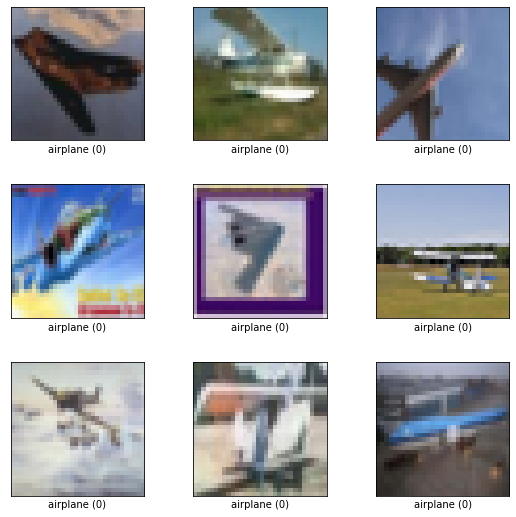

In [ ]:
#@title ShowExamplesofDatasetAirplanes
## Tfds.show_examples is a matplotlib funnction that only works on image ds's, and you have to pass it the "info" for some reason
fig = tfds.show_examples(dataset_airplanes, info)

How to display one picture of a dataset using `next(iter(dataset)`

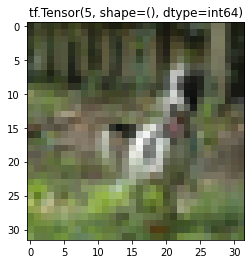

In [ ]:
#@title ShowExampleofOneIterations of DatasetDogs
# I wish I could display ID!!

img, label = next(iter(dataset_dogs))
plt.title(str(label))
plt.imshow(img)

#0x7f6e309eff10?


# Create validation set of 10,000 images

In [ ]:
#@title
# I want 10 un replicated samples from dataset_airplanes + dataset_automobiles... dataset_trucks.

# There are 5000 images of each Class 
# I want 10 equal sets A, B, C, D, ... J plus a validation set
# I want 10,000 total images in the validation set with 1000 of each class
# and I want 10 sets of training images  4000 total images, so 400 images in each class

N = 1000
dataset_airplanes_val   = dataset_airplanes.take(N)
dataset_automobiles_val  = dataset_automobiles.take(N)
dataset_birds_val       = dataset_birds.take(N)  
dataset_cats_val        = dataset_cats.take(N)
dataset_deers_val       = dataset_deers.take(N)
dataset_dogs_val        = dataset_dogs.take(N)
dataset_frogs_val       = dataset_frogs.take(N)
dataset_horses_val      = dataset_horses.take(N)
dataset_ships_val       = dataset_ships.take(N)
dataset_trucks_val      = dataset_trucks.take(N)


# Make sure to skip the next 1000 images in each data set before making training set
dataset_airplanes   = dataset_airplanes.skip(N)
dataset_automobiles  = dataset_automobiles.skip(N)
dataset_birds      = dataset_birds.skip(N)  
dataset_cats        = dataset_cats.skip(N)
dataset_deers       = dataset_deers.skip(N)
dataset_dogs        = dataset_dogs.skip(N)
dataset_frogs       = dataset_frogs.skip(N)
dataset_horses      = dataset_horses.skip(N)
dataset_ships       = dataset_ships.skip(N)
dataset_trucks      = dataset_trucks.skip(N)

# # Check that remaining dataset does not have validation data
# fig = tfds.show_examples(dataset_ships, info)
# fig = tfds.show_examples(dataset_ships_val, info)
# # I checked and they dont.


# NOW, How do I combine my val sets?

# Hint1 its not this... 
# val = dataset_airplanes_val + dataset_automobile_val + dataset_birds_val

# #  Hint2 its also not this implementation of zip because the info file doesn't match it
# val = tf.data.Dataset.zip((dataset_airplanes_val,
#                     dataset_automobile_val,
#                     dataset_birds_val,
#                     dataset_cats_val,
#                     dataset_deers_val,
#                     dataset_dogs_val,
#                     dataset_frogs_val,
#                     dataset_horses_val,
#                     dataset_ships_val,
#                     dataset_trucks_val ))
 
# fig = tfds.show_examples(val, info)   # Returns a warning that the info file is not compatible


# is it concatenate? YESSSSSSSSSSSSSSSSSSSSSS
val = dataset_airplanes_val.concatenate(dataset_automobiles_val)
# This is how I checked that it worked
# fig = tfds.show_examples(val.skip(999), info)    # shows 1 airplane and then 8 automobiles

val = val.concatenate(dataset_birds_val)
val = val.concatenate(dataset_cats_val)
val = val.concatenate(dataset_deers_val)
val = val.concatenate(dataset_dogs_val)
val = val.concatenate(dataset_frogs_val)
val = val.concatenate(dataset_horses_val)
val = val.concatenate(dataset_ships_val)
val = val.concatenate(dataset_trucks_val)
  
# print(val.reduce(np.int32(0), lambda x,_ : x + 1))  # this shows 10000! Thank goodness! :-)



# Create smaller groups of each CIFAR Class sets (set Shard)

After removing the 10,000 validation set from the training-data, the remaining set has 40,000 images, 4000 images of each class.  To create smaller training-datasets of similar sizes, shard the dataset into equal pieces.

For the initial days of testing I decided on **250 images** per class for my first couple runs, which equates to 16 shards (40,000/16 = 250) .  When I wanted to study what was going on more beneath the hood for my augmentations, I decided to make the training set even more tiny so I could view all the images per training set I decided to try 1 image per class so I could easily view all the images augmeted and not augmented.  This meant I needed **4000 shards!** for troubleshooting.



In [ ]:
SHARDS=16

#### Airplanes (airplanes_A, ... airplanes_P)

In [ ]:
#@title
# https://www.tensorflow.org/api_docs/python/tf/data/Dataset#shard

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_airplanes.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
airplanes_A = dataset_airplanes.shard(num_shards=SHARDS, index = 0)
airplanes_B = dataset_airplanes.shard(num_shards=SHARDS, index = 1)
airplanes_C = dataset_airplanes.shard(num_shards=SHARDS, index = 2)
airplanes_D = dataset_airplanes.shard(num_shards=SHARDS, index = 3)
airplanes_E = dataset_airplanes.shard(num_shards=SHARDS, index = 4)
airplanes_F = dataset_airplanes.shard(num_shards=SHARDS, index = 5)
airplanes_G = dataset_airplanes.shard(num_shards=SHARDS, index = 6)
airplanes_H = dataset_airplanes.shard(num_shards=SHARDS, index = 7)
airplanes_I = dataset_airplanes.shard(num_shards=SHARDS, index = 8)
airplanes_J = dataset_airplanes.shard(num_shards=SHARDS, index = 9)
airplanes_K = dataset_airplanes.shard(num_shards=SHARDS, index = 10)
airplanes_L = dataset_airplanes.shard(num_shards=SHARDS, index = 11)
airplanes_M = dataset_airplanes.shard(num_shards=SHARDS, index = 12)
airplanes_N = dataset_airplanes.shard(num_shards=SHARDS, index = 13)
airplanes_O = dataset_airplanes.shard(num_shards=SHARDS, index = 14)
airplanes_P = dataset_airplanes.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_M.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


#### Automobiles

In [ ]:
#@title
# dataset_automobile

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_automobile.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
automobiles_A = dataset_automobiles.shard(num_shards=SHARDS, index = 0)
automobiles_B = dataset_automobiles.shard(num_shards=SHARDS, index = 1)
automobiles_C = dataset_automobiles.shard(num_shards=SHARDS, index = 2)
automobiles_D = dataset_automobiles.shard(num_shards=SHARDS, index = 3)
automobiles_E = dataset_automobiles.shard(num_shards=SHARDS, index = 4)
automobiles_F = dataset_automobiles.shard(num_shards=SHARDS, index = 5)
automobiles_G = dataset_automobiles.shard(num_shards=SHARDS, index = 6)
automobiles_H = dataset_automobiles.shard(num_shards=SHARDS, index = 7)
automobiles_I = dataset_automobiles.shard(num_shards=SHARDS, index = 8)
automobiles_J = dataset_automobiles.shard(num_shards=SHARDS, index = 9)
automobiles_K = dataset_automobiles.shard(num_shards=SHARDS, index = 10)
automobiles_L = dataset_automobiles.shard(num_shards=SHARDS, index = 11)
automobiles_M = dataset_automobiles.shard(num_shards=SHARDS, index = 12)
automobiles_N = dataset_automobiles.shard(num_shards=SHARDS, index = 13)
automobiles_O = dataset_automobiles.shard(num_shards=SHARDS, index = 14)
automobiles_P = dataset_automobiles.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Birds

In [ ]:
#@title
# dataset_birds

# Shard each of the remaining 10 datasets into 16 smaller groups
birds_A = dataset_birds.shard(num_shards=SHARDS, index = 0)
birds_B = dataset_birds.shard(num_shards=SHARDS, index = 1)
birds_C = dataset_birds.shard(num_shards=SHARDS, index = 2)
birds_D = dataset_birds.shard(num_shards=SHARDS, index = 3)
birds_E = dataset_birds.shard(num_shards=SHARDS, index = 4)
birds_F = dataset_birds.shard(num_shards=SHARDS, index = 5)
birds_G = dataset_birds.shard(num_shards=SHARDS, index = 6)
birds_H = dataset_birds.shard(num_shards=SHARDS, index = 7)
birds_I = dataset_birds.shard(num_shards=SHARDS, index = 8)
birds_J = dataset_birds.shard(num_shards=SHARDS, index = 9)
birds_K = dataset_birds.shard(num_shards=SHARDS, index = 10)
birds_L = dataset_birds.shard(num_shards=SHARDS, index = 11)
birds_M = dataset_birds.shard(num_shards=SHARDS, index = 12)
birds_N = dataset_birds.shard(num_shards=SHARDS, index = 13)
birds_O = dataset_birds.shard(num_shards=SHARDS, index = 14)
birds_P = dataset_birds.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Cats

In [ ]:
#@title
# dataset_cats

# Shard each of the remaining 10 datasets into 16 smaller groups
cats_A = dataset_cats.shard(num_shards=SHARDS, index = 0)
cats_B = dataset_cats.shard(num_shards=SHARDS, index = 1)
cats_C = dataset_cats.shard(num_shards=SHARDS, index = 2)
cats_D = dataset_cats.shard(num_shards=SHARDS, index = 3)
cats_E = dataset_cats.shard(num_shards=SHARDS, index = 4)
cats_F = dataset_cats.shard(num_shards=SHARDS, index = 5)
cats_G = dataset_cats.shard(num_shards=SHARDS, index = 6)
cats_H = dataset_cats.shard(num_shards=SHARDS, index = 7)
cats_I = dataset_cats.shard(num_shards=SHARDS, index = 8)
cats_J = dataset_cats.shard(num_shards=SHARDS, index = 9)
cats_K = dataset_cats.shard(num_shards=SHARDS, index = 10)
cats_L = dataset_cats.shard(num_shards=SHARDS, index = 11)
cats_M = dataset_cats.shard(num_shards=SHARDS, index = 12)
cats_N = dataset_cats.shard(num_shards=SHARDS, index = 13)
cats_O = dataset_cats.shard(num_shards=SHARDS, index = 14)
cats_P = dataset_cats.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(cats_P.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Deer(s)

In [ ]:
#@title
# dataset_deers
# Shard each of the remaining 10 datasets into 16 smaller groups
deers_A = dataset_deers.shard(num_shards=SHARDS, index = 0)
deers_B = dataset_deers.shard(num_shards=SHARDS, index = 1)
deers_C = dataset_deers.shard(num_shards=SHARDS, index = 2)
deers_D = dataset_deers.shard(num_shards=SHARDS, index = 3)
deers_E = dataset_deers.shard(num_shards=SHARDS, index = 4)
deers_F = dataset_deers.shard(num_shards=SHARDS, index = 5)
deers_G = dataset_deers.shard(num_shards=SHARDS, index = 6)
deers_H = dataset_deers.shard(num_shards=SHARDS, index = 7)
deers_I = dataset_deers.shard(num_shards=SHARDS, index = 8)
deers_J = dataset_deers.shard(num_shards=SHARDS, index = 9)
deers_K = dataset_deers.shard(num_shards=SHARDS, index = 10)
deers_L = dataset_deers.shard(num_shards=SHARDS, index = 11)
deers_M = dataset_deers.shard(num_shards=SHARDS, index = 12)
deers_N = dataset_deers.shard(num_shards=SHARDS, index = 13)
deers_O = dataset_deers.shard(num_shards=SHARDS, index = 14)
deers_P = dataset_deers.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(deers_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

In [ ]:
#@title


In [ ]:
#@title


#### Dogs

In [ ]:
#@title
# dataset_dogs
# Shard each of the remaining 10 datasets into 16 smaller groups
dogs_A = dataset_dogs.shard(num_shards=SHARDS, index = 0)
dogs_B = dataset_dogs.shard(num_shards=SHARDS, index = 1)
dogs_C = dataset_dogs.shard(num_shards=SHARDS, index = 2)
dogs_D = dataset_dogs.shard(num_shards=SHARDS, index = 3)
dogs_E = dataset_dogs.shard(num_shards=SHARDS, index = 4)
dogs_F = dataset_dogs.shard(num_shards=SHARDS, index = 5)
dogs_G = dataset_dogs.shard(num_shards=SHARDS, index = 6)
dogs_H = dataset_dogs.shard(num_shards=SHARDS, index = 7)
dogs_I = dataset_dogs.shard(num_shards=SHARDS, index = 8)
dogs_J = dataset_dogs.shard(num_shards=SHARDS, index = 9)
dogs_K = dataset_dogs.shard(num_shards=SHARDS, index = 10)
dogs_L = dataset_dogs.shard(num_shards=SHARDS, index = 11)
dogs_M = dataset_dogs.shard(num_shards=SHARDS, index = 12)
dogs_N = dataset_dogs.shard(num_shards=SHARDS, index = 13)
dogs_O = dataset_dogs.shard(num_shards=SHARDS, index = 14)
dogs_P = dataset_dogs.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(dogs_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


#### Frogs

In [ ]:
#@title
# dataset_frogs
# Shard each of the remaining 10 datasets into 16 smaller groups
frogs_A = dataset_frogs.shard(num_shards=SHARDS, index = 0)
frogs_B = dataset_frogs.shard(num_shards=SHARDS, index = 1)
frogs_C = dataset_frogs.shard(num_shards=SHARDS, index = 2)
frogs_D = dataset_frogs.shard(num_shards=SHARDS, index = 3)
frogs_E = dataset_frogs.shard(num_shards=SHARDS, index = 4)
frogs_F = dataset_frogs.shard(num_shards=SHARDS, index = 5)
frogs_G = dataset_frogs.shard(num_shards=SHARDS, index = 6)
frogs_H = dataset_frogs.shard(num_shards=SHARDS, index = 7)
frogs_I = dataset_frogs.shard(num_shards=SHARDS, index = 8)
frogs_J = dataset_frogs.shard(num_shards=SHARDS, index = 9)
frogs_K = dataset_frogs.shard(num_shards=SHARDS, index = 10)
frogs_L = dataset_frogs.shard(num_shards=SHARDS, index = 11)
frogs_M = dataset_frogs.shard(num_shards=SHARDS, index = 12)
frogs_N = dataset_frogs.shard(num_shards=SHARDS, index = 13)
frogs_O = dataset_frogs.shard(num_shards=SHARDS, index = 14)
frogs_P = dataset_frogs.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(frogs_A.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Horses

In [ ]:
#@title
# dataset_horses
# Shard each of the remaining 10 datasets into 16 smaller groups
horses_A = dataset_horses.shard(num_shards=SHARDS, index = 0)
horses_B = dataset_horses.shard(num_shards=SHARDS, index = 1)
horses_C = dataset_horses.shard(num_shards=SHARDS, index = 2)
horses_D = dataset_horses.shard(num_shards=SHARDS, index = 3)
horses_E = dataset_horses.shard(num_shards=SHARDS, index = 4)
horses_F = dataset_horses.shard(num_shards=SHARDS, index = 5)
horses_G = dataset_horses.shard(num_shards=SHARDS, index = 6)
horses_H = dataset_horses.shard(num_shards=SHARDS, index = 7)
horses_I = dataset_horses.shard(num_shards=SHARDS, index = 8)
horses_J = dataset_horses.shard(num_shards=SHARDS, index = 9)
horses_K = dataset_horses.shard(num_shards=SHARDS, index = 10)
horses_L = dataset_horses.shard(num_shards=SHARDS, index = 11)
horses_M = dataset_horses.shard(num_shards=SHARDS, index = 12)
horses_N = dataset_horses.shard(num_shards=SHARDS, index = 13)
horses_O = dataset_horses.shard(num_shards=SHARDS, index = 14)
horses_P = dataset_horses.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(horses_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Ships

In [ ]:
#@title
# dataset_ships
# Shard each of the remaining 10 datasets into 16 smaller groups
ships_A = dataset_ships.shard(num_shards=SHARDS, index = 0)
ships_B = dataset_ships.shard(num_shards=SHARDS, index = 1)
ships_C = dataset_ships.shard(num_shards=SHARDS, index = 2)
ships_D = dataset_ships.shard(num_shards=SHARDS, index = 3)
ships_E = dataset_ships.shard(num_shards=SHARDS, index = 4)
ships_F = dataset_ships.shard(num_shards=SHARDS, index = 5)
ships_G = dataset_ships.shard(num_shards=SHARDS, index = 6)
ships_H = dataset_ships.shard(num_shards=SHARDS, index = 7)
ships_I = dataset_ships.shard(num_shards=SHARDS, index = 8)
ships_J = dataset_ships.shard(num_shards=SHARDS, index = 9)
ships_K = dataset_ships.shard(num_shards=SHARDS, index = 10)
ships_L = dataset_ships.shard(num_shards=SHARDS, index = 11)
ships_M = dataset_ships.shard(num_shards=SHARDS, index = 12)
ships_N = dataset_ships.shard(num_shards=SHARDS, index = 13)
ships_O = dataset_ships.shard(num_shards=SHARDS, index = 14)
ships_P = dataset_ships.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(ships_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Trucks


In [ ]:
#@title
# dataset_trucks
# Shard each of the remaining 10 datasets into 16 smaller groups
trucks_A = dataset_trucks.shard(num_shards=SHARDS, index = 0)
trucks_B = dataset_trucks.shard(num_shards=SHARDS, index = 1)
trucks_C = dataset_trucks.shard(num_shards=SHARDS, index = 2)
trucks_D = dataset_trucks.shard(num_shards=SHARDS, index = 3)
trucks_E = dataset_trucks.shard(num_shards=SHARDS, index = 4)
trucks_F = dataset_trucks.shard(num_shards=SHARDS, index = 5)
trucks_G = dataset_trucks.shard(num_shards=SHARDS, index = 6)
trucks_H = dataset_trucks.shard(num_shards=SHARDS, index = 7)
trucks_I = dataset_trucks.shard(num_shards=SHARDS, index = 8)
trucks_J = dataset_trucks.shard(num_shards=SHARDS, index = 9)
trucks_K = dataset_trucks.shard(num_shards=SHARDS, index = 10)
trucks_L = dataset_trucks.shard(num_shards=SHARDS, index = 11)
trucks_M = dataset_trucks.shard(num_shards=SHARDS, index = 12)
trucks_N = dataset_trucks.shard(num_shards=SHARDS, index = 13)
trucks_O = dataset_trucks.shard(num_shards=SHARDS, index = 14)
trucks_P = dataset_trucks.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(trucks_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


# Concatenate the smaller CIFAR classes sets into 10 independent small  training Groups: 

This is the `train_A`, `train_B`, `train_C`... `train_J`  datasets of 1 image each class, 10 images total, currently ao 11/10/21. and will be updated to  whatever the current SHARD is later

#### Group A  (train_A)

In [ ]:
#@title
# {A}
X = birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A
train_A = airplanes_A.concatenate(automobiles_A)

for i in list(X):
  train_A = train_A.concatenate(i) 

print(train_A.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

tf.Tensor(2500, shape=(), dtype=int32)


#### Group B

In [ ]:
#@title
# {B}
X = birds_B, cats_B, deers_B, dogs_B, frogs_B, horses_B, ships_B, trucks_B
train_B = airplanes_B.concatenate(automobiles_B)

for i in list(X):
  train_B = train_B.concatenate(i)

# print(train_B.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group C

In [ ]:
#@title
# {C}
X = birds_C, cats_C, deers_C, dogs_C, frogs_C, horses_C, ships_C, trucks_C
train_C = airplanes_C.concatenate(automobiles_C)

for i in list(X):
  train_C = train_C.concatenate(i)

# print(train_C.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group D

In [ ]:
#@title
# {D}
X = birds_D, cats_D, deers_D, dogs_D, frogs_D, horses_D, ships_D, trucks_D
train_D = airplanes_D.concatenate(automobiles_D)

for i in list(X):
  train_D = train_D.concatenate(i)

# print(train_D.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group E

In [ ]:
#@title
# {E}
X = birds_E, cats_E, deers_E, dogs_E, frogs_E, horses_E, ships_E, trucks_E
train_E = airplanes_E.concatenate(automobiles_E)

for i in list(X):
  train_E = train_E.concatenate(i)

# print(train_E.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group F

In [ ]:
#@title
# {F}
X = birds_F, cats_F, deers_F, dogs_F, frogs_F, horses_F, ships_F, trucks_F
train_F = airplanes_F.concatenate(automobiles_F)

for i in list(X):
  train_F = train_F.concatenate(i)

# print(train_F.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group G

In [ ]:
#@title
# {G}
X = birds_G, cats_G, deers_G, dogs_G, frogs_G, horses_G, ships_G, trucks_G
train_G = airplanes_G.concatenate(automobiles_G)

for i in list(X):
  train_G = train_G.concatenate(i)

# print(train_G.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group H

In [ ]:
#@title
# {H}
X = birds_H, cats_H, deers_H, dogs_H, frogs_H, horses_H, ships_H, trucks_H
train_H = airplanes_H.concatenate(automobiles_H)

for i in list(X):
  train_H = train_H.concatenate(i)

# print(train_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group I

In [ ]:
#@title
# {I}
X = birds_I, cats_I, deers_I, dogs_I, frogs_I, horses_I, ships_I, trucks_I
train_I = airplanes_I.concatenate(automobiles_I)

for i in list(X):
  train_I = train_I.concatenate(i)

# print(train_I.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group J

In [ ]:
#@title
# {J}
X = birds_J, cats_J, deers_J, dogs_J, frogs_J, horses_J, ships_J, trucks_J
train_J = airplanes_J.concatenate(automobiles_J)

for i in list(X):
  train_J = train_J.concatenate(i)

# print(train_J.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

Testing out whether I can see IDs again...

I added some code before the lines to load dataset, they are as follows#
from https://www.tensorflow.org/datasets/api_docs/python/tfds/load#args
and https://www.tensorflow.org/datasets/determinism



> read_config code added


```
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True
dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
```


I want to make sure the rest of my scripts run fine before any more tinkering!

In [ ]:
# # I believe I need to define the shuffle number for the Train_A set by using the total number of images in it, not just an arbitrarily large number?
# # count = count_images(train_A)
# # unbatch_train_A = (tf.data.Dataset.unbatch(train_A))
# # count = count_images(unbatch_train_A)

# #this changes everytime i run it

# # for id, img, label in unbatch_train_A:
# #   print(label)  # this appears to be the labels of the image in unbatchtrain_A (7, 6, 4, 2, 1, 3, 9, 5, 8, 0)
# #   #print(img)  # these are each of the images 32*32*3
# #   print(id)
 
# tfds.as_dataframe(dataset.take(5), info)  #it doesn't look like IDS is being returned in info

# print(info)


### Adding Batches, Buffers, Shuffles and Caches to Val, Test, and Train_A

The following is necessary to run the datasets through the CNN models  Do not run the following more than once because it'll try to make an additional "batch" dimension in your datasets

The result of running `print(info)`:

> CIFAR10 Info
```
tfds.core.DatasetInfo(    
    name='cifar10',
    version=3.0.2,    
    description='The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images.',   
    homepage='https://www.cs.toronto.edu/~kriz/cifar.html',   
    features=FeaturesDict({   
        'id': Text(shape=(), dtype=tf.string),   
        'image': Image(shape=(32, 32, 3), dtype=tf.uint8),   
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),   
    }),   
    total_num_examples=60000,   
    splits={   
        'test': 10000,   
        'train': 50000,   
    },   
    supervised_keys=('image', 'label'),   
    citation="""@TECHREPORT{Krizhevsky09learningmultiple,   
        author = {Alex Krizhevsky},   
        title = {Learning multiple layers of features from tiny images},   
        institution = {},  
        year = {2009}   
    }""",   
    redistribution_info=,   
)
```
 




In [ ]:
#@title

train_A_shuffle_num = 2500
tran_A_batch_num    = 100

if initial_run == 0: 
    
  # AUTOTUNE = tf.data.AUTOTUNE # results in -1 which i think is code for the whole database
  train_A = train_A.cache().prefetch(buffer_size=AUTOTUNE)
  train_A = train_A.shuffle(train_A_shuffle_num, reshuffle_each_iteration=False)  #, seed=seed)
  train_A = train_A.batch(tran_A_batch_num)  

  val = val.cache().prefetch(buffer_size=AUTOTUNE)
  val = val.batch(100)

  x_test = x_test.cache().prefetch(AUTOTUNE)
  x_test = x_test.batch(500)

else:
  pass

initial_run = initial_run+1

#### Time required to create datasets:  

In [ ]:

toc = time.time()  
print(f"Made datasets in {toc - tic:0.4f} seconds")
!mkdir -p saved_model


Made datasets in 23.6159 seconds


Get min-max values of dataset to see whata the range is

In [ ]:

def get_min_max(tfdata, text):
  print(str(text), "is ", tfdata)
  image, _ = next(iter(tfdata))
  print("test")
  print(np.min(image[0]), np.max(image[0]), "\n")


# I've decided to hide the following code, which was merely to let me see what the range of the pixel values were, and it was usually around 2-253 or so
# get_min_max(train_A, "train_A")
# get_min_max(x_test, "x_test")
# get_min_max(val, "val")



# Build CNN 

## Train the model function :


In [ ]:
#@title Make a Vanilla CNN Function { form-width: "20px" }
# Make a Vanilla CNN
# One thing I'd like to add is residual connections, as Cholet mentions that is a standard practice in computer vision


def makemodel(DROPOUT):  #returns model
  num_classes = 10
  input_shape = (32, 32, 3)

  # For Reference these are the defaults
  # kernel_initializer="glorot_uniform",
  # bias_initializer="zeros",
  # padding="valid",  #valid = no padding
  # kernel_regularizer=None,
  # bias_regularizer=None,
  # activity_regularizer=None,

  initializer = tf.keras.initializers.HeUniform(seed)  #this alows the model to start from the same weights each time

  model = tf.keras.Sequential(
  [
      #keras.Input(),
      tf.keras.Input(shape=input_shape),

      layers.experimental.preprocessing.Rescaling(1./255),
      #data_augmentation,   
      layers.Conv2D(32, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer1"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool1"),
      layers.BatchNormalization(name="BN1"),
   
      layers.Conv2D(64, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer2"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool2"),
      layers.BatchNormalization(name="BN2"),
   
      layers.Conv2D(128, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer3"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool3"),
      layers.BatchNormalization(name="BN3"),
   
      layers.Flatten(),
      layers.Dropout(DROPOUT),
      layers.Dense(512, activation="relu", kernel_initializer=initializer),
      layers.Dropout(DROPOUT),
      layers.Dense(num_classes, activation="softmax")

  ])


  model.compile(
    optimizer='adam',
    loss=tf.losses.SparseCategoricalCrossentropy(),
    metrics=['accuracy'])  #changed, added to val_accuracy
  
  print(" ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ ")
  print("Dropout:  ", DROPOUT)
  model.save_weights('saved_model/blank_model')  # Enables a fresh-restart between runs
  model.load_weights('saved_model/blank_model')

  return model

# -----------------------------------------

# I need to understand tf.function better 
# @tf.function

def trainmodel(MODEL, TRAININGDATA):   # returns TRAINEDMODEL

  history = MODEL.fit(
    TRAININGDATA,
    validation_data=(val),
    epochs=100,
    callbacks = keras.callbacks.EarlyStopping(monitor= 'val_loss', patience=15, restore_best_weights=True), 
    verbose=0 # 
  )

  #I've entered show plot-loss twice to force another plot to move down the screen
  #this code would be improved if i could simply make this appear under /
  # the view_images command that displays 10 to 20 images


  # # summarize history for loss
  # x = 0
  # y = 0
  # plt.plot(x)
  # plt.plot(y)
  # plt.show()
 

  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()

  val_acc_array = history.history['val_accuracy']
  val_loss_array = history.history['val_loss']

  n_epochs_best = np.argmax(val_acc_array)
  n_epochs_bestloss = np.argmin(val_loss_array)
  print("Early-Stop is on Val-Loss with patience = 15")

  
  
  print("Early Stop Epoch was: ", n_epochs_bestloss, "when  Val Loss was: ", np.min(val_loss_array), ", and Val Acc happened to be", val_acc_array[n_epochs_bestloss])
  print("Additionally, the best val acc epoch happened to be ", n_epochs_best, "when val acc was: ",  val_acc_array[n_epochs_best], "and Val Loss happened to be ",  val_loss_array[n_epochs_best] )
  if (n_epochs_bestloss > 90) or (n_epochs_best >90 ) :
    print("This is a pretty high epoch number! ********************************")

  # model.save('saved_model/my_model')




  return MODEL



# Transition to Augmentations


In [ ]:
#@title Augmentations Timer

start_augmentations = time.time()

## Prepare the Google Colab environment for Albumentations



#### Install the latest version of Albumentations

Google Colab has an outdated version of Albumentations so we will install the latest stable version from PyPi.

In [ ]:
#@title  instal augmentations
# !pip install -q -U albumentations
# !echo "$(pip freeze | grep albumentations) is successfully installed"

!pip install -U git+https://github.com/albumentations-team/albumentations -q
# necessary imports
from functools import partial
import albumentations as A
import cv2 as cv2

import tensorflow as tf
AUTOTUNE = tf.data.experimental.AUTOTUNE


## Define Augmentation Factors' Order and Levels

The following are 21 factors: 20 data-augmentation techniques and one regularization factor "*Dropout*" Percent Level, to compare with.  The order is what seemed to give each factor the most opportunity to add to the image, and more "destructive" factors were ordered later, like "ToGray" and Crop or ZoomIn since they take away image data permanently.  Zoom Out was order 11 because I wanted to make sure noise, blur, zoom, sharpen, contrast, did not have a over-magnified effect if after ZoomOut.  FlipHorizontal and FlipVertical are at the bottom not because they are destructive, but because I wanted to keep the categorical variables grouped as much as possible for consistent coding practices.

|Order | Factors | Role | Low | High |
| -: | :- | :-: | :-: | :-: |
1|*dropout*|Continuous|0.4  |0.6
2|shiftX|Continuous|0 | 0.1
3|shiftY|Continuous|0|  0.1
4|noise|Continuous|0  |24
5|blur|Continuous|0 | 7**
6|sharpen|Continuous|0 | 0.1
7|contrast|Continuous|0 | 0.2
8|brighten|Continuous|0|  0.2
9|darken (negative brightness)|Continuous|0 | -0.2 *
10|gamma|Continuous|100|  120
11|zoomOut (negative zoomin) |Continuous| 0 | -0.16*
12|rotate|Continuous|0|  14
13|crop|Continuous|32* | 24*
14|zoomin|Continuous|0  |0.16
15|flipH|Categorical|0 | 1
16|flipV|Categorical|0 | 1
17|fancyPCA|Categorical|0 | 1
18|equalize|Categorical|0 | 1
19|channelShuffle|Categorical|0 | 1
20|elasticTransform|Categorical|0 | 1
21|togray|Categorical|0 | 1

* Values with asterisks are for emphasis since they seem counterintuitive

** Blur values can only be odd so a center point will be rounded down from 3.5 to 3 - four center points were changed

A 50-run definitive screening design with 2 blocks is used to see which main effects are most important.  The JMP Metrics for this design are below:

 | Definitive Screening Design Diagnostics  | | 
| --- | --- | 
 | D Efficiency| 92.46019| 
| G Efficiency | 81.68744 | 
| A Efficiency | 91.32396 | 
| Average Variance of Prediction	 | 0.298038 |


## Define Randomized Definitive Screening Design 

**Block 1**
 
 xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
1|1|0.4|0.1|0|24|7|0.1|0.2|0.2|-0.2|100|-0.08|14|24|0.16|1|1|0|1|0|1|0
2|1|0.4|0.1|0|24|7|0|0|0|0|100|-0.16|0|32|0|1|1|1|1|1|1|0
3|1|0.5|0|0|24|7|0.1|0|0.2|-0.2|100|-0.16|14|32|0.16|0|0|0|0|1|0|1
4|1|0.4|0|0.1|24|3|0.1|0|0|-0.2|100|0|0|32|0|1|1|0|0|0|1|1
5|1|0.6|0|0|0|0|0|0.2|0.2|-0.2|100|0|0|32|0.16|1|1|1|0|1|0|0
6|1|0.6|0.1|0|24|0|0.1|0.2|0|-0.2|120|-0.16|0|24|0.08|1|0|1|0|0|1|1
7|1|0.4|0|0|0|7|0|0.2|0.2|0|120|0|7|24|0|0|1|0|0|0|1|1
8|1|0.4|0.1|0.1|0|0|0.1|0.2|0.2|-0.2|100|0|0|32|0|0|0|1|1|1|1|1
9|1|0.6|0|0|24|7|0|0|0|0|120|-0.16|14|24|0.16|1|1|0|0|0|0|0
10|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|0|0|0|0|0|0|0
11|1|0.4|0|0|24|7|0.1|0.2|0.1|-0.2|120|0|0|24|0|0|0|1|1|1|0|0
12|1|0.4|0.1|0.1|24|0|0|0.2|0.2|-0.2|120|-0.16|0|32|0.16|0|1|0|1|0|0|0
13|1|0.6|0|0|0|7|0.1|0|0|0|100|0|14|24|0|1|0|1|0|1|1|1
14|1|0.6|0.05|0.1|24|7|0.1|0.2|0.2|0|120|0|14|32|0.16|1|1|1|1|1|1|1
15|1|0.4|0|0|0|7|0|0|0.2|-0.2|120|-0.16|0|32|0.16|1|0|1|1|0|1|1
16|1|0.4|0.05|0|0|0|0|0|0|-0.2|100|-0.16|0|24|0|0|0|0|0|0|0|0
17|1|0.4|0.1|0.1|24|7|0.1|0|0|0|120|-0.16|14|24|0|0|0|0|1|0|1|1
18|1|0.6|0.1|0.1|24|0|0.1|0|0|-0.2|100|-0.16|7|32|0.16|1|0|1|1|1|0|0
19|1|0.6|0|0.1|0|0|0|0|0|0|120|-0.08|0|32|0|0|0|1|0|1|0|1
20|1|0.6|0|0.1|0|0|0.1|0.2|0.2|-0.2|120|0|14|24|0.16|0|0|0|0|0|0|1
21|1|0.6|0.1|0.1|0|0|0|0|0.1|0|100|-0.16|14|32|0.16|1|1|0|0|0|1|1
22|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|1|1|1|1|1|1|1
23|1|0.6|0.1|0.1|24|0|0.1|0.2|0|0|100|0|14|24|0|0|1|0|0|1|0|0
24|1|0.6|0.1|0|0|3|0|0.2|0.2|0|120|-0.16|14|24|0.16|0|0|1|1|1|0|0
25|1|0.5|0.1|0.1|0|0|0|0.2|0|0|120|0|0|24|0|1|1|1|1|0|1|0
26|1|0.4|0|0.1|0|7|0|0|0.2|0|100|0|14|32|0.08|0|1|0|1|1|0|0


**Block 2**

xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
27|2|0.6|0.1|0|12|6|0.1|0.2|0.2|0|100|-0.16|0|32|0|0|1|1|0|0|0|1
28|2|0.6|0.1|0|0|6|0|0.2|0|-0.2|100|0|14|32|0|1|0|0|1|0|0|1
29|2|0.4|0|0|24|0|0.05|0.2|0|0|100|0|14|32|0.16|0|0|1|0|0|1|0
30|2|0.6|0.1|0|24|0|0|0|0.2|0|100|0|0|24|0.16|0|0|0|1|1|1|1
31|2|0.6|0|0.1|24|6|0|0.2|0.2|-0.1|100|-0.16|0|24|0|1|0|0|0|1|1|0
32|2|0.6|0|0.1|24|6|0|0.1|0|-0.2|100|0|0|24|0.16|0|1|1|1|0|0|1
33|2|0.4|0.1|0.1|0|6|0|0.2|0|-0.2|100|-0.16|14|24|0.16|0|1|1|0|1|1|1
34|2|0.4|0|0.1|0|6|0.1|0.2|0|-0.2|120|-0.16|14|32|0|1|1|1|0|0|0|0
35|2|0.4|0.1|0.05|24|6|0|0.2|0|0|120|0|0|32|0.16|1|0|0|0|1|0|1
36|2|0.6|0|0|24|0|0.1|0|0.2|0|120|0|0|32|0|1|0|0|1|0|0|0
37|2|0.6|0.1|0.1|24|6|0|0|0.2|-0.2|120|0|14|32|0|0|0|1|0|0|1|0
38|2|0.6|0|0.1|0|6|0.1|0.2|0|0|110|-0.16|0|32|0.16|0|0|0|1|0|1|0
39|2|0.6|0|0.05|0|0|0.1|0|0.2|-0.2|100|-0.16|14|24|0|0|1|1|1|0|1|0
40|2|0.4|0|0.1|12|0|0|0|0|-0.2|120|0|14|24|0.16|1|0|0|1|1|1|0
41|2|0.6|0.1|0.1|0|6|0.05|0|0.2|-0.2|120|-0.16|0|24|0|1|1|0|1|1|0|1
42|2|0.4|0|0.1|24|0|0.1|0|0.2|0|120|-0.16|0|24|0.16|0|1|1|0|1|1|0
43|2|0.4|0.1|0|0|0|0.1|0.1|0.2|0|120|-0.16|14|32|0|1|0|0|0|1|1|0
44|2|0.4|0|0|0|0|0.1|0.2|0|0|100|-0.16|0|24|0.16|1|1|0|1|1|0|1
45|2|0.4|0.1|0|0|0|0.1|0|0|-0.1|120|0|14|32|0.16|0|1|1|1|0|0|1
46|2|0.4|0.1|0.1|0|6|0.1|0|0.2|0|100|0|0|24|0.16|1|0|1|0|0|0|0
47|2|0.4|0|0.1|24|0|0|0.2|0.2|0|100|-0.16|14|28|0|1|0|1|1|0|0|1
48|2|0.4|0.1|0|24|0|0|0|0.2|-0.2|110|0|14|24|0|1|1|1|0|1|0|1
49|2|0.6|0.1|0|0|6|0.1|0|0|-0.2|120|0|0|28|0.16|0|1|0|0|1|1|0
50|2|0.6|0|0|24|0|0|0.2|0|-0.2|120|-0.16|14|32|0|0|1|0|1|1|1|1

## Create Experimental Run Order DataFrame

In [ ]:
#@title create run dataframe 
ls_all_factors = ['xRun', 'Block', 'dropout', 'shiftX', 'shiftY', 'noise', 'blur', 'sharpen', 'contrast', 'brighten', 'darken', 'gamma', 'zoomOut', 'rotate', 'crop', 'zoomin', 'flipH', 'flipV', 'fancyPCA', 'equalize', 'channelShuffle', 'elasticTransform', 'togray']

#because i added a do-nothing run, the runs really do start at index zero now, so i have delete some lines in  my for loops about run=run+1


df_experimentalruns = pd.DataFrame(	[
[0, 1, 0.5, 0, 0, 0, 0, 0, 0, 0, 0.0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], # do nothing run, watch out for mild Gamma effect
[1, 1, 0.6, 0, 0, 24, 7, 0, 0, 0, 0.2, 120, 0, 14, 0, 0.16, 1, 1, 0, 0, 0, 0, 0],
[2, 1, 0.6, 0.1, 0, 0, 3, 0, 0.2, 0.2, 0.2, 120, 0, 14, 0, 0.16, 0, 0, 1, 1, 1, 0, 0],
[3, 1, 0.4, 0.1, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0, 0, 0, 1, 1, 1, 1, 1],
[4, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 1, 1, 1, 1, 1, 1, 1],
[5, 1, 0.4, 0, 0.1, 0, 7, 0, 0, 0.2, 0.2, 100, 0.16, 14, 8, 0.08, 0, 1, 0, 1, 1, 0, 0],
[6, 1, 0.4, 0.1, 0.1, 24, 7, 0.1, 0, 0, 0.2, 120, 0, 14, 0, 0, 0, 0, 0, 1, 0, 1, 1],
[7, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0, 0, 0, 100, 0, 7, 8, 0.16, 1, 0, 1, 1, 1, 0, 0],
[8, 1, 0.4, 0.1, 0, 24, 7, 0, 0, 0, 0.2, 100, 0, 0, 8, 0, 1, 1, 1, 1, 1, 1, 0],
[9, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 0, 0, 0, 0, 0, 0, 0],
[10, 1, 0.5, 0, 0, 24, 7, 0.1, 0, 0.2, 0, 100, 0, 14, 8, 0.16, 0, 0, 0, 0, 1, 0, 1],
[11, 1, 0.6, 0, 0, 0, 7, 0.1, 0, 0, 0.2, 100, 0.16, 14, 0, 0, 1, 0, 1, 0, 1, 1, 1],
[12, 1, 0.4, 0.1, 0, 24, 7, 0.1, 0.2, 0.2, 0, 100, 0.08, 14, 0, 0.16, 1, 1, 0, 1, 0, 1, 0],
[13, 1, 0.6, 0, 0.1, 0, 0, 0, 0, 0, 0.2, 120, 0.08, 0, 8, 0, 0, 0, 1, 0, 1, 0, 1],
[14, 1, 0.4, 0.05, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
[15, 1, 0.6, 0.05, 0.1, 24, 7, 0.1, 0.2, 0.2, 0.2, 120, 0.16, 14, 8, 0.16, 1, 1, 1, 1, 1, 1, 1],
[16, 1, 0.4, 0, 0.1, 24, 3, 0.1, 0, 0, 0, 100, 0.16, 0, 8, 0, 1, 1, 0, 0, 0, 1, 1],
[17, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0.2, 0, 0.2, 100, 0.16, 14, 0, 0, 0, 1, 0, 0, 1, 0, 0],
[18, 1, 0.4, 0, 0, 24, 7, 0.1, 0.2, 0.1, 0, 120, 0.16, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
[19, 1, 0.6, 0, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 120, 0.16, 14, 0, 0.16, 0, 0, 0, 0, 0, 0, 1],
[20, 1, 0.6, 0, 0, 0, 0, 0, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0.16, 1, 1, 1, 0, 1, 0, 0],
[21, 1, 0.6, 0.1, 0.1, 0, 0, 0, 0, 0.1, 0.2, 100, 0, 14, 8, 0.16, 1, 1, 0, 0, 0, 1, 1],
[22, 1, 0.4, 0, 0, 0, 7, 0, 0, 0.2, 0, 120, 0, 0, 8, 0.16, 1, 0, 1, 1, 0, 1, 1],
[23, 1, 0.6, 0.1, 0, 24, 0, 0.1, 0.2, 0, 0, 120, 0, 0, 0, 0.08, 1, 0, 1, 0, 0, 1, 1],
[24, 1, 0.4, 0, 0, 0, 7, 0, 0.2, 0.2, 0.2, 120, 0.16, 7, 0, 0, 0, 1, 0, 0, 0, 1, 1],
[25, 1, 0.5, 0.1, 0.1, 0, 0, 0, 0.2, 0, 0.2, 120, 0.16, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0],
[26, 1, 0.4, 0.1, 0.1, 24, 0, 0, 0.2, 0.2, 0, 120, 0, 0, 8, 0.16, 0, 1, 0, 1, 0, 0, 0],
[27, 2, 0.6, 0, 0.1, 24, 7, 0, 0.1, 0, 0, 100, 0.16, 0, 0, 0.16, 0, 1, 1, 1, 0, 0, 1],
[28, 2, 0.6, 0.1, 0, 0, 7, 0.1, 0, 0, 0, 120, 0.16, 0, 4, 0.16, 0, 1, 0, 0, 1, 1, 0],
[29, 2, 0.4, 0, 0.1, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0, 0, 0, 0.16, 0, 1, 1, 0, 1, 1, 0],
[30, 2, 0.4, 0, 0, 24, 0, 0.05, 0.2, 0, 0.2, 100, 0.16, 14, 8, 0.16, 0, 0, 1, 0, 0, 1, 0],
[31, 2, 0.6, 0.1, 0.1, 24, 7, 0, 0, 0.2, 0, 120, 0.16, 14, 8, 0, 0, 0, 1, 0, 0, 1, 0],
[32, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0, 0, 0.1, 120, 0.16, 14, 8, 0.16, 0, 1, 1, 1, 0, 0, 1],
[33, 2, 0.6, 0, 0, 24, 0, 0, 0.2, 0, 0, 120, 0, 14, 8, 0, 0, 1, 0, 1, 1, 1, 1],
[34, 2, 0.6, 0, 0, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0.16, 0, 8, 0, 1, 0, 0, 1, 0, 0, 0],
[35, 2, 0.4, 0, 0.1, 12, 0, 0, 0, 0, 0, 120, 0.16, 14, 0, 0.16, 1, 0, 0, 1, 1, 1, 0],
[36, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0.1, 0.2, 0.2, 120, 0, 14, 8, 0, 1, 0, 0, 0, 1, 1, 0],
[37, 2, 0.6, 0.1, 0.1, 0, 7, 0.05, 0, 0.2, 0, 120, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1],
[38, 2, 0.6, 0, 0.1, 24, 7, 0, 0.2, 0.2, 0.1, 100, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0],
[39, 2, 0.4, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0, 120, 0, 14, 8, 0, 1, 1, 1, 0, 0, 0, 0],
[40, 2, 0.4, 0, 0.1, 24, 0, 0, 0.2, 0.2, 0.2, 100, 0, 14, 4, 0, 1, 0, 1, 1, 0, 0, 1],
[41, 2, 0.6, 0.1, 0, 0, 7, 0, 0.2, 0, 0, 100, 0.16, 14, 8, 0, 1, 0, 0, 1, 0, 0, 1],
[42, 2, 0.4, 0.1, 0.1, 0, 7, 0.1, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 1, 0, 1, 0, 0, 0, 0],
[43, 2, 0.4, 0.1, 0.1, 0, 7, 0, 0.2, 0, 0, 100, 0, 14, 0, 0.16, 0, 1, 1, 0, 1, 1, 1],
[44, 2, 0.4, 0.1, 0, 24, 0, 0, 0, 0.2, 0, 110, 0.16, 14, 0, 0, 1, 1, 1, 0, 1, 0, 1],
[45, 2, 0.4, 0, 0, 0, 0, 0.1, 0.2, 0, 0.2, 100, 0, 0, 0, 0.16, 1, 1, 0, 1, 1, 0, 1],
[46, 2, 0.6, 0.1, 0, 24, 0, 0, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 0, 0, 0, 1, 1, 1, 1],
[47, 2, 0.4, 0.1, 0.05, 24, 7, 0, 0.2, 0, 0.2, 120, 0.16, 0, 8, 0.16, 1, 0, 0, 0, 1, 0, 1],
[48, 2, 0.6, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0.2, 110, 0, 0, 8, 0.16, 0, 0, 0, 1, 0, 1, 0],
[49, 2, 0.6, 0.1, 0, 12, 7, 0.1, 0.2, 0.2, 0.2, 100, 0, 0, 8, 0, 0, 1, 1, 0, 0, 0, 1],
[50, 2, 0.6, 0, 0.05, 0, 0, 0.1, 0, 0.2, 0, 100, 0, 14, 0, 0, 0, 1, 1, 1, 0, 1, 0]
],

index=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50], 
columns = ls_all_factors)
	
# I had to make some changes to shift x and y values

df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.1,"shiftX"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.05,"shiftX"] = 0.0625  #this is 2/32
df_experimentalruns["shiftX"]

df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.1,"shiftY"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.05,"shiftY"] = 0.0625  #this is 2/32  

#  Sigh of RELIEF.  Changing the percentage to "divisible" values of 32 made it so that theres no blur happening in the pictures, yay! 

## View images from the dataset function (view_image(ds))

In [ ]:
#@title Check_If_Batched function { form-width: "20px" }
def check_if_unbatched(ds):
  if (ds.__class__.__name__ !='BatchDataset') and (ds._input_dataset.__class__.__name__ != 'BatchDataset') and (ds._input_dataset._input_dataset.__class__.__name__ !='BatchDataset'):
     return True
  else:
    return False

def check_if_batched(ds):
  if (ds.__class__.__name__ =='BatchDataset') or (ds._input_dataset.__class__.__name__ == 'BatchDataset') or (ds._input_dataset._input_dataset.__class__.__name__ =='BatchDataset') :
     # the above statement will evaluate to True if three subsets of the original ds are not batched
      return True
  else:
    return False

def check_if_take(ds):
  if  (ds.__class__.__name__ =='TakeDataset'):
    return True
  else:
    return False



def make_batched(ds, batchnum):
  if (ds.__class__.__name__ !='BatchDataset') and (ds._input_dataset.__class__.__name__ != 'BatchDataset') and (ds._input_dataset._input_dataset.__class__.__name__ !='BatchDataset'):
    # the above statement will evaluate to True if three subsets of the original ds are not batched
      return ds.batch(batchnum)
  else:
    return ds

def make_unbatched(ds):
  if (ds.__class__.__name__ =='BatchDataset') or (ds._input_dataset.__class__.__name__ == 'BatchDataset') or (ds._input_dataset._input_dataset.__class__.__name__ =='BatchDataset'):
        # the above statement will evaluate to True if any of the three subsets are batched
      return unbatch_ds(ds)
  else:
    return ds



********************            10 Training Images from Group A            ********************


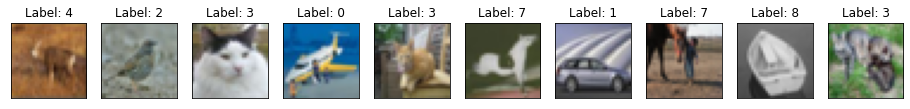

********************            10 Validation Images            ********************


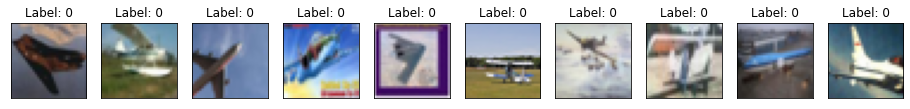

********************            10 Test Images            ********************


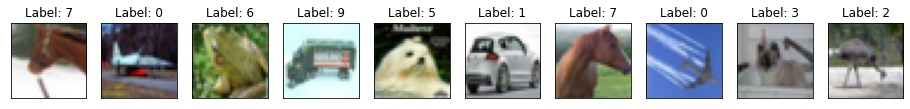

In [ ]:
#@view_image(ds)
def view_image(ds, opttext = "", batch = 10):
# this function takes the dataset and automatically displays 10 figures
# the dataset has to be batches to see the images
  ds  = make_batched(ds, batch)

  image, label = next(iter(ds)) # extract 1 batch from the dataset
  image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
  label = label.numpy()   
  

  fig = plt.figure(figsize=(16, 16))
  for i in range(10):
    if i == 1:
        print("*"*20, " "*10, opttext, " "*10,  "*"*20)
    ax = fig.add_subplot(1, 10, i+1, xticks=[], yticks=[])
    ax.imshow(image[i])
    ax.set_title(f"Label: {label[i]}")
    if i == 9:
      plt.pause(0.05)  # heck yea
      


view_image(train_A, opttext = "10 Training Images from Group A")
view_image(val, opttext = "10 Validation Images")
view_image(x_test, opttext = "10 Test Images")


To integrate `albumentations` into our tensorflow pipeline we can create two functions :  
- Pipeline to apply `augmentation`.
- a function that calls the above function and pass in our data through the pipeline.
We can then wrap our 2nd Function under `tf.numpy_function` .

### Define Albumentations "Transform" Augmentation Functions (transforms = Compose([ ... ])   ) 

In [ ]:
#@title def augmentfunction(df_experimentalruns, run): { form-width: "20px" }
IMG_SIZE = 32

def augmentfunction(df_experimentalruns, run):
    
  # Instantiate augments

  cat_probability = 1
  cont_probability = 1
  random.seed(42)

  # Assign Continuous Factors Levels by Run -------------------------

  shift_limit_x_left =  df_experimentalruns.loc[run,"shiftX"]
  shift_limit_x_right = df_experimentalruns.loc[run,"shiftX"]  
  assert shift_limit_x_right >= shift_limit_x_left
  assert shift_limit_x_right <= 1  #more than one is damaging
  print("Shift X:  (", shift_limit_x_left, ",", shift_limit_x_right, ") or (",-shift_limit_x_right, ",", -shift_limit_x_left, ")" )

  shift_limit_y_left = df_experimentalruns.loc[run,"shiftY"]
  shift_limit_y_right = df_experimentalruns.loc[run,"shiftY"]  
  assert shift_limit_y_right >= shift_limit_y_left
  assert shift_limit_y_right < 1  #more than one is damaging
  print("Shift Y:  (", shift_limit_y_left, ",", shift_limit_y_right, ")or (", -shift_limit_y_right, ",", -shift_limit_y_left, ")")


  gamma_left =  df_experimentalruns.loc[run,"gamma"]     
  gamma_right = df_experimentalruns.loc[run,"gamma"]  
  assert gamma_right >= gamma_left
  print("Gamma:    (", gamma_left, ",", gamma_right, ")")

  zoom_out_left = -df_experimentalruns.loc[run,"zoomOut"]  
  zoom_out_right = -df_experimentalruns.loc[run,"zoomOut"] 
  assert zoom_out_right >= zoom_out_left
  print("ZoomOut:  (", zoom_out_left, ",", zoom_out_right, ")")


  zoom_in_left = df_experimentalruns.loc[run,"zoomin"]
  zoom_in_right = df_experimentalruns.loc[run,"zoomin"]
  assert zoom_in_right >= zoom_in_left
  assert zoom_in_right < 1.0
  print("ZoomIn:   (", zoom_in_left, ",", zoom_in_right, ")")



  noise_left = df_experimentalruns.loc[run,"noise"]             # df_factors["Noise"][df_experimentalruns.loc[run,"Noise"]])
  noise_right = df_experimentalruns.loc[run,"noise"]         #  need to change noise to larger number
  assert noise_right >= noise_left
  print("Noise:    (", noise_left, ",", noise_right, ")")


  ## Is blur of 7 too high? :-\ 
  if df_experimentalruns.loc[run,"blur"] == 0:
    blur_probability = 0
    # print("blur is 0")
    blur_left = 0
    blur_right = 0+1
  else:
    # print("blur is not 0")
    blur_probability = 1
    blur_left = df_experimentalruns.loc[run,"blur"]
    blur_right = df_experimentalruns.loc[run,"blur"]
  assert blur_right >= blur_left
  assert blur_right > 0  # must be an integer  #I can't see a dfference using 7 and 9!
  print("blur:     (", blur_left, ",", blur_right, ")")


  # Need to add Sharp to the menu of options
  sharp_left = df_experimentalruns.loc[run,"sharpen"]
  sharp_right = df_experimentalruns.loc[run,"sharpen"]
  assert sharp_right >= sharp_left
  print("sharp:    (", sharp_left, ",", sharp_right, ")")


  contrast_limit_left = df_experimentalruns.loc[run,"contrast"]
  contrast_limit_right = df_experimentalruns.loc[run,"contrast"]
  assert contrast_limit_right >= contrast_limit_left
  print("Contrast: (", contrast_limit_left, ",", contrast_limit_right, ")")


  brightness_limit_left = df_experimentalruns.loc[run,"brighten"]
  brightness_limit_right = df_experimentalruns.loc[run,"brighten"] 
  assert brightness_limit_right >= brightness_limit_left
  print("Bright:   (", brightness_limit_left, ",", brightness_limit_right, ")")

  darkness_limit_left = -df_experimentalruns.loc[run,"darken"] 
  darkness_limit_right = -df_experimentalruns.loc[run,"darken"]
  assert darkness_limit_right >= darkness_limit_left
  print("Darken:   (", darkness_limit_left, ",", darkness_limit_right, ")")


  rotate_left  = df_experimentalruns.loc[run,"rotate"]
  rotate_right = df_experimentalruns.loc[run,"rotate"]
  assert rotate_right >= rotate_left
  print("Rotate:   (", rotate_left, ",", rotate_right, ") or (",-rotate_right, ",", -rotate_left, ")" )


  crop_value = 32-df_experimentalruns.loc[run,"crop"]


  # Assign Categorical Factors Probabilities to make "on" or "off" -------------------------
  pHorizontalFlip =   df_experimentalruns.loc[run,"flipH"]
  print("pHorizontalFlip:   ", pHorizontalFlip)

  pVerticalFlip =     df_experimentalruns.loc[run,"flipV"]
  print("pVerticalFlip:     ", pVerticalFlip)

  pEqualize =          df_experimentalruns.loc[run,"equalize"]
  print("pEqualize:         ", pEqualize)

  pFancyPCA =          df_experimentalruns.loc[run,"fancyPCA"]
  print("pFancyPCA:         ", pFancyPCA)

  pChannelShuffle =   df_experimentalruns.loc[run,"channelShuffle"]
  print("pChannelShuffle:   ", pChannelShuffle)

  pElasticTransform =  df_experimentalruns.loc[run,"elasticTransform"]
  print("pElasticTransform: ", pElasticTransform)

  pToGray =            df_experimentalruns.loc[run,"togray"]
  print("pToGray:           ", pToGray)

  background_value = 0


  print(" ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ \n\n")


  #transforms = A.Compose([
  list_of_transforms = [


      #1. Shift Horizontally Right or Shift Horizontally Left
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(shift_limit_x_left,shift_limit_x_right), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),    
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(-shift_limit_x_right,-shift_limit_x_left), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p=cont_probability),
      
      
      # 2 Shift VERTICALLY  up or down 
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(shift_limit_y_left,shift_limit_y_right), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),   
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(-shift_limit_y_right, -shift_limit_y_left), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p =cont_probability),
      
      #3 NOISE ---------------------------------
      A.transforms.GaussNoise(var_limit=(noise_left,noise_right), p=cont_probability),  

      #4 BLUR
      A.transforms.GaussianBlur(blur_limit=(blur_left,blur_right), sigma_limit=(0.5,0.05), p=blur_probability),  #Blur
      
      #5 Sharpen 
      A.transforms.Sharpen(alpha=(sharp_left,sharp_right), lightness=(0.0, 0.0), p=cont_probability),  #AntiBlur keep lightness constant at 0?
        
      #6 Contrast
      A.transforms.RandomBrightnessContrast(brightness_limit=(0,0), contrast_limit=(contrast_limit_left,contrast_limit_right), p=cont_probability),       

      #7 Brightness
      A.transforms.RandomBrightnessContrast(brightness_limit=(brightness_limit_left,brightness_limit_right), contrast_limit=(0,0), p=cont_probability),      
      
      #8 Darkness
      A.transforms.RandomBrightnessContrast(brightness_limit=(darkness_limit_left,darkness_limit_right), contrast_limit=(0,0), p=cont_probability),  #darkness

      #9 GAMMA
      # A.transforms.RandomGamma(gamma_limit=(gamma_left,gamma_right), p=cont_probability),  
      

      #10 Zoom Out
      A.geometric.ShiftScaleRotate(rotate_limit=0,  shift_limit_y=0, shift_limit_x=0, scale_limit=(zoom_out_left,zoom_out_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),    #Zoom Out safe: scale_limit=(-0.15,-0.1)

      #11  Rotate CW or CCW
      A.OneOf([
                    A.geometric.SafeRotate(limit=(rotate_left,rotate_right), border_mode=cv2.BORDER_CONSTANT, value=background_value),
                    A.geometric.SafeRotate(limit=(-rotate_right,-rotate_left), border_mode=cv2.BORDER_CONSTANT, value=background_value)], p=1),
      
      #12  Crop then Pad
      A.crops.transforms.CenterCrop(height=crop_value, width=crop_value,  p=cont_probability),       # Crop 24,24 is the extreme
      A.transforms.PadIfNeeded(min_height=32, min_width=32,  border_mode=cv2.BORDER_CONSTANT, value=background_value, p=1),

      # 13 ZoomIn
      A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, shift_limit_x=0,
                                    scale_limit=(zoom_in_left,zoom_in_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),  

      # 14 FlipH
      A.HorizontalFlip(p=pHorizontalFlip),
      
      # 15 FlipVert
      A.VerticalFlip(p=pVerticalFlip),
      
      #16 FANCY PCA
      A.transforms.FancyPCA(alpha=0.1, p=pFancyPCA),                    # FancyPCA Amount to perturn eigenvalues not Categorical
      
      #17 Elastic Transform
      A.geometric.ElasticTransform(alpha=0.1, sigma=0.001, alpha_affine=0.001, 
                                    same_dxdy=True, border_mode=cv2.BORDER_CONSTANT, 
                                    value=background_value, p=pElasticTransform),    #Seems more like a blur than a transform?
      
      # #Resize to 32x32 for crop
      # A.geometric.Resize(height=32, width=32, p=1),

      #18 Histogram Equalizer
      A.transforms.Equalize(p=pEqualize),  

      #19 CHANNELSHUFFLE
      A.transforms.ChannelShuffle(p=pChannelShuffle),  #this is prob going to ruin accuracy


      #20 Turn Everything Gray
      A.transforms.ToGray(p=pToGray)

    ] 
    
  return list_of_transforms

global no_transforms 

no_transforms = A.Compose([
         A.transforms.NoOp()
])

### Define another function "Augment_Function" to push images throguh list of "Transforms" to create augmented images

In [ ]:
#@title aug_fn

#this function is being referenced a lot

def aug_fn(image, img_size ):
    data = {"image":image}
    
    aug_data = transforms(**data)
    
    aug_img = aug_data["image"]
    # aug_img = tf.cast(aug_img/255.0, tf.float32)
    # aug_img = tf.cast(aug_img/1.0, tf.float32)    #attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)

    return aug_img

def no_aug_fn(image, img_size):
    data = {"image":image}

    aug_data = no_transforms(**data)

    aug_img = aug_data["image"]
    # aug_img = tf.cast(img/255.0, tf.float32)  
    # aug_img = tf.cast(img/1.0, tf.float32)      #new attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)
    return aug_img

#### Define Process_Data function to returns augmented image andlabel

In [ ]:
#@title process_data { form-width: "20px" }
def process_data(image, label, img_size,):
    aug_img = tf.numpy_function(func=aug_fn, inp=[image, img_size], Tout=tf.float32)  # was tf.float32
    return aug_img, label


def no_process_data(image, label, img_size,):
    no_aug_img = tf.numpy_function(func=no_aug_fn, inp=[image, img_size], Tout=tf.float32)   # was tf.float32
    return no_aug_img, label
    

#### Restoring dataset shapes. 
The datasets loses its shape after applying a tf.numpy_function, so this is necessary for the sequential model and when inheriting from the model class.

In [ ]:
#@title set_shapes
def set_shapes(img, label, img_shape=(IMG_SIZE,IMG_SIZE,3)):
    img.set_shape(img_shape)
    label.set_shape([])
    return img, label

`Note`: 
Some `API's` of `tensorflow.keras.Model` might not work, if you dont map the dataset with the set_shapes function.

## Create New Training Group Data by Merging Un-Augmented with Augmented Data


In [ ]:
#@title def unbatch + augment_data

def unbatch_ds(batchedDataset):
  unbatch_ds = (tf.data.Dataset.unbatch(batchedDataset))
  return unbatch_ds


# unbatch_train_A = make_unbatched(train_A)

#as of 11/11/21 a 0521 added transforms to try to make my run_through_runs 
#   function pass the transforms to the augment functions

def augment_data(dataset, process, dataset_text=""):
  dataset_new = dataset.map(partial(process, img_size=IMG_SIZE,))
  dataset_new = dataset_new.map(set_shapes)
  # dataset_new = dataset_new.batch(batchsize)
  # get_min_max(dataset,      text= dataset_text)
  # get_min_max(dataset_new,  text=str("New" + dataset_text))
  return dataset_new



In [ ]:
#@title
# #@title View No Augmentation Dataset { form-width: "20%" }
# train_A_noalb = augment_data(dataset = unbatch_train_A, 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "train_A_noalb")

# #@title View No Augmentation Dataset { form-width: "20%" }
# train_B_noalb = augment_data(dataset = make_unbatched(train_B), 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "train_A_noalb")
# pretty_display_of_dataset(train_B_noalb)


In [ ]:
#@title def PrettyViewofData Function { form-width: "30px" }
def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = ""):
  view_image(ds, dstitle)  #defaults to batch size 10 
  num = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 25, but 25*100batches = 2500
  
  if check_if_batched(ds):
    print("Total: ", num, " batches in this dataset: \n\n\n", opttext )

    if num > 5:
      num = 5
      print("Showing first 10 images of the first five batches")
    
    batch1 = ds.take(1)
    
    view_image(batch1, str("Batch1 of "+dstitle)) 
    print("Batch ",1, "Class Count:", count_cifar10_class(batch1), "\n")  

    for i in range(2,num+1):      
      batch2 = ds.skip(i-1).take(1)
     
      name_of_batch = str("Batch" + str(i)+" of "+ dstitle)
      view_image(batch2, name_of_batch )   
      print("Batch ", i, "Class Count:", count_cifar10_class(batch2), "\n")
      # do I need to clear out batch2 here?

  else:
    print("Total: ", num, " images in this dataset", opttext )
    print("Total Class Count:", count_cifar10_class(ds), "\n")

  
  print("**********************************************************************************************")

# pretty_display_of_dataset(train_A, "Train_A")  



#### View_Num_Images Function, default num = 20

In [ ]:
#@title
def view_num_images(ds, num = 20):

  ds = make_batched(ds, batchnum = num)

  image, label = next(iter(ds)) # extract 1 batch from the dataset
  image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
  label = label.numpy()   
  
  fig = plt.figure(figsize=(10, 10))

  for i in range(num):
      ax = fig.add_subplot(1, num, i+1, xticks=[], yticks=[])
      ax.imshow(image[i])
      ax.set_title(f"Lbl: {label[i]}")
      

In [ ]:
#@title show_confusion_matrix_wo_diagonal { form-width: "2px" }
def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES, run=999):
    """Compute confusion matrix without diagonal."""
    confusion = sklearn.metrics.confusion_matrix(test_labels, predictions,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

    confusion_matrix_wo_diagonal= np.array(confusion)-np.identity(confusion.shape[0])*np.diag(confusion)

    axis_labels = CLASSES

    ax = sns.heatmap(
        confusion_matrix_wo_diagonal, xticklabels=axis_labels, yticklabels=axis_labels, 
        cmap='Blues', annot=True, square=True, fmt='.0f', cbar = False)

    plt.title(str("Confusion Matrix without Diagonal of Run " + str(run)))
    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.show()
    print("Summing down the rows, for Predictions of each Class that were wrong: ", confusion_matrix_wo_diagonal.sum(axis=0))

    # for i in range(10):
    print("For example, the model predicted a  label 4 (deer) on a true  ", np.argmax(confusion_matrix_wo_diagonal[:,4])," a total of ", max(confusion_matrix_wo_diagonal[:,4]), "times")

    print("Summing across the columns, for total number of that True Class misidentified: ", confusion_matrix_wo_diagonal.sum(axis=1))
    
    print("For example, the model misclassified true 4's (deer) as label  ", np.argmax(confusion_matrix_wo_diagonal[4,:]), CLASSES[np.argmax(confusion_matrix_wo_diagonal[4,:])], " a total of ", max(confusion_matrix_wo_diagonal[4,:]), "times")





In [ ]:
#@title define CLASSES
# The augmented data returns floats between 0 and 1
# The unaugmented data is integers uint8 between 0 and 255 
CLASSES = info.features['label'].names

# This may help me one day with trying to get into the ID of each batch/mislabelled image
# info.features['id']


## Function that creates the dataset when the two datasets are combined.

I need to examine this further since my understanding of reshuffle_each_iteration True versus False and the other parameters in .shuffle and its relation with other variables is sometimes shaky.  Also Prefetch and Cache, how does that effect batch order?

This was my original code when running allRuns successfully the first time.  
 


```
Review my Code:  
def cache_prefetch_group(train_tf, SHUFFLE=5000, batch = 0, SEED = 42):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=False)  # I took out seed=seed to get variety with each reshuffle
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    return train_tf 
```



In [ ]:
#@title cache_prefetch_group(train_tf, shuffle=5000, batch =0, SEED = 42) { form-width: "4px" }

def cache_prefetch_group(train_tf, SHUFFLE=5000, batch = 0, SEED = 42):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=False)  # I took out seed=seed to get variety with each reshuffle
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    return train_tf 


#### Make Sortedd Test Accuracy Dictionary  Functions

In [ ]:
#@title make_accuracy_dictionary(cm_norm)
# define function to print out all the labels amd accuracies on the diagonal of the confusion matrix
def make_accuracy_dictionary(cm_norm):
  dictionary = {}
  for i in range(10):
    dictionary[CLASSES[i]] = cm_norm[i,i]
    
  # sort the values - ty SO https://stackoverflow.com/questions/613183/how-do-i-sort-a-dictionary-by-value/613218#613218
  for w in sorted(dictionary, key=dictionary.get, reverse=True):
    print(w, dictionary[w])
  return dictionary 


# define function to print out all the labels amd accuracies on the off diagonal of the confusion matrix
# to indicate the most common mistakes:

# def make_misclassification_dictionary(cm):
#   dictionary = {}

#   for i in range(10):
#     dictionary_cm_diagonal_labels[CLASSES[i]] = cm_norm[i,i]
    
#   # sort the values - ty SO https://stackoverflow.com/questions/613183/how-do-i-sort-a-dictionary-by-value/613218#613218
#   for w in sorted(dictionary_cm_diagonal_labels, key=dictionary_cm_diagonal_labels.get, reverse=True):
#     print(w, dictionary_cm_diagonal_labels[w])
#   return dictionary_cm_diagonal_labels 

# Run, Model, Test, Capture all 50 Designed Runs

In [ ]:
#@title how to show type of dataset
## This is code found on SO to see whether the dataset is batched or not
#  
# train_A_alb.batch(num_alb).__class__.__name__

# new_train_A = new_train_A.batch(10)

# new_train_A._input_dataset.__class__.__name__

# new_train_A = (tf.data.Dataset.unbatch(new_train_A))

In [ ]:
def count_images(ds, opttext = ""):
  # The number of images present in the new train_A_alb set is equal to the original set
  num_images = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 10 bc no batches
  print(" There are ** ", num_images, "** total images in " ,  opttext)
  return num_images

Original Working Code for Train_A before it became a function:

In [ ]:
#@title old code for just Train_A
 
# # ---------------------------------------------------------------------------
# # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
# # ----------------------------------------------------------------------------
# Group_A_Runs = {}   #dictionary

# # Group_A_Runs[run] = {'TestAccuracy': 0}


# # ---------------------------------------------------------------------------
# # When in troubleshooting or refining/code mode, I only run 5 experimental runs but
# # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
# # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
# # ----------------------------------------------------------------------------

# ENDRUNS = 51
# # assert ENDRUNS == 50

# for run in range(0,ENDRUNS): 

#   # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
#   print("\n", (str(run) + " ")*50)
#   print("\n   Begin Run: ", run)
#   print("\n", (str(run) + " ")*50)
  

#   #Use my vanilla CNN model function to build a  model with a certain dropout level
#   model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

# # ------------------------------------
# # Create Run-Specific Transformations 
# # ------------------------------------

#   # build  Albumentations list of transformations by passing each run's required parameters 
#   list_of_transforms = augmentfunction( df_experimentalruns, run )

#   # pass the list of transforms to Albumentations Compose function
#   transforms = A.Compose(transforms = list_of_transforms)
  
# # ------------------------------------
# # Create Augmented Dataset train_A_alb 
# # ------------------------------------
  
#   # Augment the unbatched Training_Group_A through the Process_Data Function to create train_A_alb (albu = albumentations/augmentations)
#   train_A_alb = augment_data(dataset = unbatch_train_A, process= process_data, dataset_text = "Augmented Dataset")
  
# # ------------------------------------
# # Print the number of total images in each unbatched dataset train_A_alb, and train_A_noalb 
# # -----------------------------------

#   # The number of images present in the new train_A_alb set is equal to the original set
#   # num_alb = count_images(train_A_alb, opttext="Augmented-train-a, before batching")
#   # print("Train_A_Alb has class count:", count_cifar10_class(train_A_alb))
#   # pretty_display_of_dataset(train_A_noalb, "Train Set A - NO Augmentations", opttext = "before batching")


#   # The number of images present in the new train_A_alb set is equal to the original set
#   # count_images(train_A_noalb, "Not-Augmented Train_A, before batching")
#   # print("Train_A_No_Augmentations has class count:", count_cifar10_class(train_A_noalb))
#   # pretty_display_of_dataset(train_A_alb, "Train Set A - Augmentations", opttext = "before batching")


#   # ------------------------------------
#   # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
#   # ------------------------------------
#   new_train_A = train_A_noalb.concatenate(train_A_alb)
#   # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
#   #pretty_display_of_dataset(new_train_A, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

# # ------------------------------------
# # Batch Consolidated Dataset  
# # ------------------------------------
#   new_train_A_batch = 250 
#   tot_new_train_A = 5000 # should be 250*10*2 = 5000

#   new_train_A = cache_prefetch_group(new_train_A,  SHUFFLE=tot_new_train_A, batch=new_train_A_batch, SEED = seed)

# # ------------------------------------
# # Send Consolidated Dataset through Model & View Model Training Statistics Output 
# # ------------------------------------
#   # take the created model from passing dropout, and pass the training data through it
#   modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_train_A)

# # ------------------------------------
# # See pictures that were sent through model, up to five batches
# # ------------------------------------
#   pretty_display_of_dataset(ds= new_train_A, dstitle="New Training Set A", opttext= "after Shuffling and Batching") 


# # ------------------------------------
# # Test Statistics for Model 
# # ------------------------------------
#   # Retrieve the TEst Loss and Accuracy after training is complete
#   loss, acc = modeltrained.evaluate(x_test, verbose=0) 
#   print("TestLoss: ", loss, " TestAcc:", acc)



# # ------------------------------------
# # Get Predictions from Test Set to use in Confusion Matrix
# # ------------------------------------

#   #Get the predictions of Y_hat from passing X_Test into the model
#   y_pred = modeltrained.predict(x_test)

#   # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
#   y_pred_1hot = np.argmax(y_pred, axis=1)
#   cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
#   cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
#   # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
#   make_accuracy_dictionary(cm_norm)

#   # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
#   # show_confusion_matrix(y_test, y_pred_1hot, CLASSES = CLASSES)

# # ------------------------------------
# # Save every 10 runs and final file
# # ------------------------------------
#   Group_A_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}
  
#   if run != 0:
#     if run == 50:      
# # ------------------------------------
# # Save  final file
# # ------------------------------------  
#       with open('runs_groupA_final.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA_final.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Final Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA_final.pkl ")
# # ------------------------------------
# # Save  intermittent files
# # ------------------------------------  

#     if run%12 == 0:  #When i =12,24,36, save/download file
#       with open('runs_groupA.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA.pkl ")

 

### Defining all the no_augmentation groups before model-building-and-testing

In [ ]:
#@title define all groups no_augmentations

# I am having trouble defining no_augmentation datasets inside the for-loop so i decided to define them outside the for-loop
# ------------------------------------
# Create Non-Augmented Dataset train_A_noalb 
# ------------------------------------
# until i figure out a better way , this is my way of ensuring that the unaugmented dataset is compatible datatype with that augmented one
def make_noalb(ds, dstitle):
  train_X_noalb = augment_data(dataset = make_unbatched(ds), process= no_process_data, dataset_text = str("TrainingGroup" + dstitle+ "NotAugmented"),)
  return train_X_noalb

# train_B_noalb = augment_data(dataset = make_unbatched(train_B), process= no_process_data, dataset_text = "Train_BNotAugmented",  passtransforms=no_transforms)
# print("train_B_noalb created")
# pretty_display_of_dataset(train_B_noalb, "noAugmentations") 



train_A_noalb = make_noalb(train_A, "A")
train_B_noalb = make_noalb(train_B, "B")

train_C_noalb = make_noalb(train_C, "C")
train_D_noalb = make_noalb(train_D, "D")

train_E_noalb = make_noalb(train_E, "E")
train_F_noalb = make_noalb(train_F, "F")

train_G_noalb = make_noalb(train_G, "G")
train_H_noalb = make_noalb(train_H, "H")

train_I_noalb = make_noalb(train_I, "I")
train_J_noalb = make_noalb(train_J, "J")

In [ ]:
#@title The Mother of All Code
def run_through_runs(ds, ds_noalb, dstitle = "X", showpictures=True):
  filename = "runs_Group" + dstitle
  print("filename will be: ", filename, ".pkl")
  originalfilename = filename
  # ---------------------------------------------------------------------------
  # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
  # ----------------------------------------------------------------------------
  Group_X_Runs = {}   #dictionary
  # Group_X_Runs[run] = {'TestAccuracy': 0}


  # ---------------------------------------------------------------------------
  # For Loop of Runs
  # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
  # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
  # ----------------------------------------------------------------------------

  ENDRUNS = 51
  # assert ENDRUNS == 51

  for run in range(0,51): 
    filename = originalfilename  #reset so you dont get Downloading "runs_GroupA.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl"


    # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
    print("\n", (str(run) + " ")*50)
    print("\n   Begin Run: ", run)
    print("\n", (str(run) + " ")*50, "\n")
    

    #Use my vanilla CNN model function to build a  model with a certain dropout level
    model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

    # ------------------------------------
    # Create Run-Specific Transformations 
    # ------------------------------------

    # build  Albumentations list of transformations by passing each run's required parameters 
    list_of_transforms = augmentfunction( df_experimentalruns, run )

    # pass the list of transforms to Albumentations Compose function
    global transforms 
    transforms = A.Compose(list_of_transforms)

    
    # ------------------------------------
    # Create Augmented Dataset train_A_alb 
    # ------------------------------------
    
    # Augment the unbatched Training_Group_A through the Process_Data Function to create train_A_alb (albu = albumentations/augmentations)
    train_X_alb = augment_data(dataset = ds, process= process_data, dataset_text = "Augmented Dataset", )
    # print("train_X_alb created")
    # pretty_display_of_dataset(train_X_alb, "Augmentations")

    # # ------------------------------------
    # # Create Non-Augmented Dataset train_A_noalb 
    # # ------------------------------------
    # # until i figure out a better way , this is my way of ensuring that the unaugmented dataset is compatible datatype with that augmented one

    # train_X_noalb = augment_data(dataset = ds, 
    #                          process= no_process_data,
    #                         #  batchsize=100,
    #                          dataset_text = str(dstitle+"NotAugmented"), passtransforms=no_transforms)
    # print("train_X_noalb created")
    # pretty_display_of_dataset(train_X_noalb, "noAugmentations") 


    # ------------------------------------
    # Print the number of total images in each unbatched dataset train_A_alb, and train_A_noalb 
    # -----------------------------------
    # removed because counting the items in a dataset is insanely time-expensive, unfortunately



    # ------------------------------------
    # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
    # ------------------------------------

    new_train_X = ds_noalb.concatenate(train_X_alb)
    # print("new_train_X created")
    # print(new_train_X)
    # pretty_display_of_dataset(new_train_X, "newTrainX") 

    # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
    #pretty_display_of_dataset(new_train_A, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

    # ------------------------------------
    # Batch Consolidated Dataset  
    # ------------------------------------
    new_train_X_batch = 250 
    tot_new_train_X = 5000 # should be 250*10*2 = 5000

    new_train_X= cache_prefetch_group(new_train_X,  SHUFFLE=tot_new_train_X, batch=new_train_X_batch, SEED = seed)
    # print("new_train_X batched")
    # ------------------------------------
    # Send Consolidated Dataset through Model & View Model Training Statistics Output 
    # ------------------------------------
    # take the created model from passing dropout, and pass the training data through it
    print("Training Model... ")
    modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_train_X)

    # ------------------------------------
    # See pictures that were sent through model, up to five batches
    # ------------------------------------
    if showpictures == True:
      pretty_display_of_dataset(new_train_X, dstitle, ) 


    # ------------------------------------
    # Test Statistics for Model 
    # ------------------------------------
    # Retrieve the TEst Loss and Accuracy after training is complete
    loss, acc = modeltrained.evaluate(x_test, verbose=0) 
    print("TestLoss: ", loss, " TestAcc:", acc)



    # ------------------------------------
    # Get Predictions from Test Set to use in Confusion Matrix
    # ------------------------------------

    #Get the predictions of Y_hat from passing X_Test into the model
    y_pred = modeltrained.predict(x_test)

    # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
    y_pred_1hot = np.argmax(y_pred, axis=1)
    cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
    cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
    # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
    make_accuracy_dictionary(cm_norm)

    # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
    #def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES):
    show_confusion_matrix_wo_diagonal(y_test, y_pred_1hot, CLASSES = CLASSES, run=run)

    # ------------------------------------
    # Save every 10 runs and final file
    # ------------------------------------
    Group_X_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}
    
    

    # I cannot figure out why it downloads my files twice
    if run != 0:

      if run == 50: 
        # print("run == 50 is true")    
        filename = originalfilename + "_final.pkl"   
        with open(filename, 'wb') as fid:
          pickle.dump(Group_X_Runs, fid)
          files.download(filename)
          
          timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
          print("Final Download attempted : ", timetoprint, " (subtract ~5-hours for local Hour), and file is called ", filename)

        # end write
      # end if
      # if run != 50:
      #   # ------------------------------------
      #   # Save  intermittent files
      #   # ------------------------------------  
      #   if run%14 == 0:  #When i save/download file  14 28 42 
      #     filename = str(originalfilename + ".pkl")
      #     with open(filename, 'wb') as fid:
      #       pickle.dump(Group_X_Runs, fid)
      #       files.download(filename)
            
      #       timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
      #       print("Download attempted : ", timetoprint, " (subtract ~5-hours for local Hour), and file is called",  filename)
          #
        #
      #
    
 

# All Results

In [ ]:
run_through_runs(ds=make_unbatched(train_A), ds_noalb=train_A_noalb, dstitle="A" , showpictures= True)  #Even though I ran this before, I'm curious if the images and augmentations are repeatable

Group B: 51 Run Results

filename will be:  runs_GroupB .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


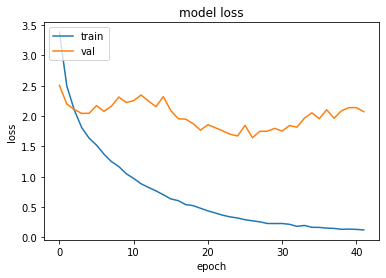

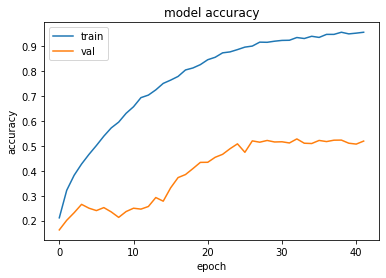

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.6435271501541138 , and Val Acc happened to be 0.5202000141143799
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5281000137329102 and Val Loss happened to be  1.8174715042114258
TestLoss:  1.618311882019043  TestAcc: 0.5184000134468079
frog 0.77
ship 0.683
truck 0.583
airplane 0.551
horse 0.546
deer 0.541
automobile 0.506
dog 0.494
cat 0.319
bird 0.191


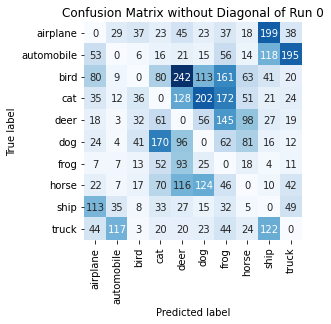

Summing down the rows, for Predictions of each Class that were wrong:  [396. 223. 193. 525. 788. 596. 755. 372. 558. 410.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  242.0 times
Summing across the columns, for total number of that True Class misidentified:  [449. 494. 809. 681. 459. 506. 230. 454. 317. 417.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  145.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0

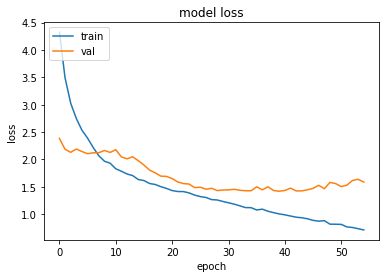

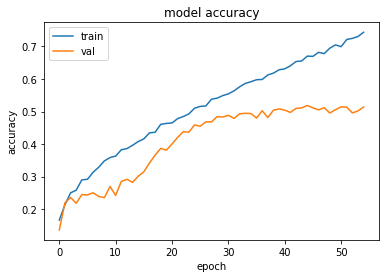

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.4179928302764893 , and Val Acc happened to be 0.5080999732017517
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5184999704360962 and Val Loss happened to be  1.4432311058044434
TestLoss:  1.4054394960403442  TestAcc: 0.5030999779701233
frog 0.78
automobile 0.64
airplane 0.602
truck 0.585
ship 0.55
horse 0.477
dog 0.456
deer 0.404
bird 0.306
cat 0.231


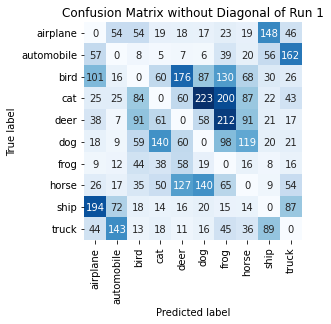

Summing down the rows, for Predictions of each Class that were wrong:  [512. 355. 406. 405. 533. 586. 827. 470. 403. 472.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [398. 360. 694. 769. 596. 544. 220. 523. 450. 415.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  212.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0

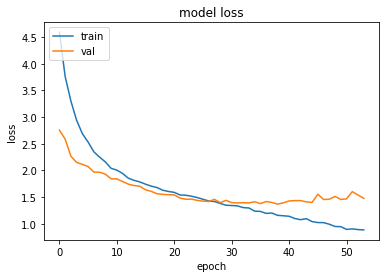

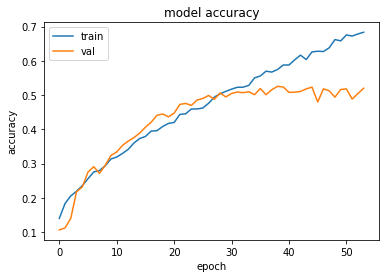

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3676677942276 , and Val Acc happened to be 0.525600016117096
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.525600016117096 and Val Loss happened to be  1.3676677942276
TestLoss:  1.3365837335586548  TestAcc: 0.5200999975204468
frog 0.759
truck 0.633
ship 0.625
airplane 0.559
automobile 0.557
horse 0.526
dog 0.516
deer 0.446
bird 0.313
cat 0.267


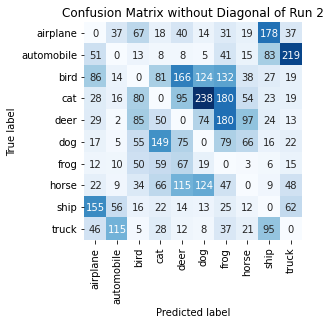

Summing down the rows, for Predictions of each Class that were wrong:  [446. 264. 405. 481. 592. 619. 752. 325. 461. 454.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  166.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 443. 687. 733. 554. 484. 241. 474. 375. 367.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  180.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brigh

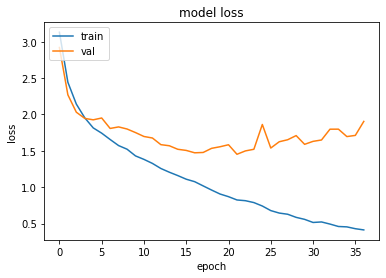

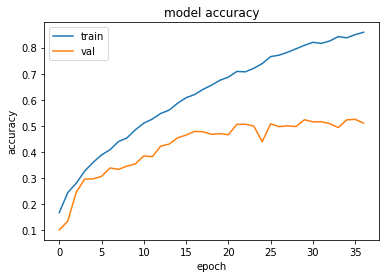

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4525691270828247 , and Val Acc happened to be 0.5059999823570251
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5250999927520752 and Val Loss happened to be  1.7121752500534058
TestLoss:  1.417755126953125  TestAcc: 0.5023999810218811
ship 0.734
truck 0.65
frog 0.634
deer 0.631
horse 0.566
automobile 0.494
dog 0.394
airplane 0.393
cat 0.276
bird 0.252


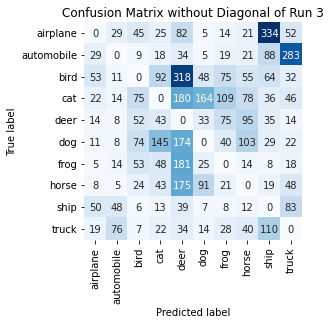

Summing down the rows, for Predictions of each Class that were wrong:  [ 211.  213.  345.  449. 1217.  392.  389.  439.  723.  598.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  318.0 times
Summing across the columns, for total number of that True Class misidentified:  [607. 506. 748. 724. 369. 606. 366. 434. 266. 350.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  95.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

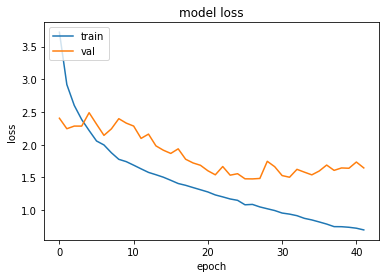

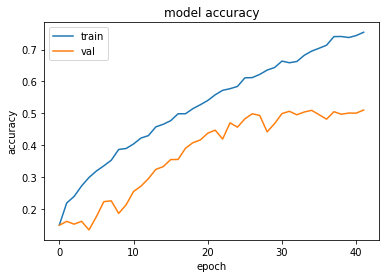

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.4762606620788574 , and Val Acc happened to be 0.4984999895095825
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.510200023651123 and Val Loss happened to be  1.644136667251587
TestLoss:  1.4397257566452026  TestAcc: 0.5023000240325928
frog 0.759
ship 0.734
truck 0.672
deer 0.536
airplane 0.526
automobile 0.496
horse 0.49
dog 0.377
bird 0.277
cat 0.156


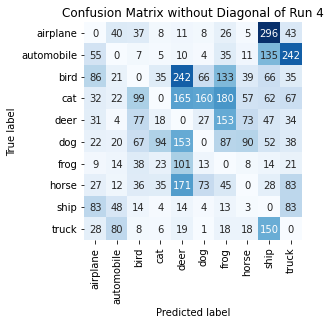

Summing down the rows, for Predictions of each Class that were wrong:  [373. 261. 383. 228. 886. 356. 690. 304. 850. 646.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  242.0 times
Summing across the columns, for total number of that True Class misidentified:  [474. 504. 723. 844. 464. 623. 241. 510. 266. 328.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  153.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

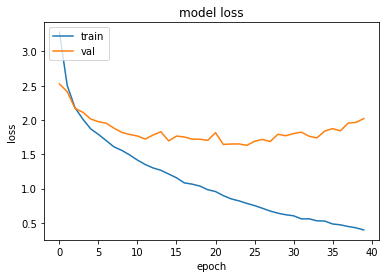

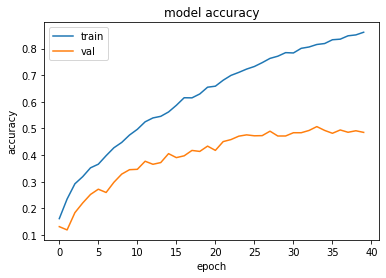

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.63036048412323 , and Val Acc happened to be 0.4758000075817108
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5067999958992004 and Val Loss happened to be  1.7398760318756104
TestLoss:  1.5831717252731323  TestAcc: 0.48539999127388
truck 0.738
frog 0.712
ship 0.643
deer 0.487
dog 0.477
horse 0.467
cat 0.43
automobile 0.421
airplane 0.349
bird 0.13


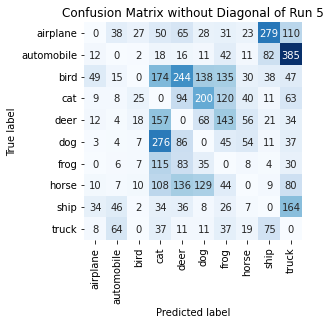

Summing down the rows, for Predictions of each Class that were wrong:  [137. 192.  98. 969. 771. 628. 623. 248. 530. 950.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  244.0 times
Summing across the columns, for total number of that True Class misidentified:  [651. 579. 870. 570. 513. 523. 288. 533. 357. 262.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  157.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Bright

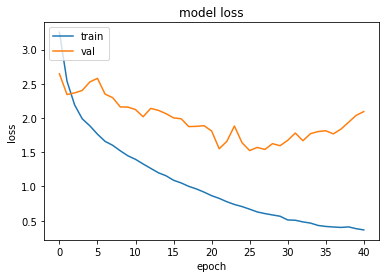

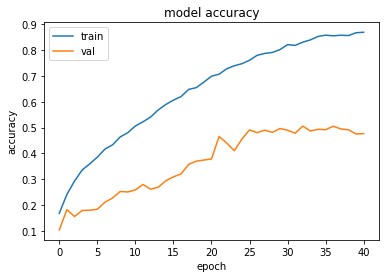

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5244451761245728 , and Val Acc happened to be 0.491100013256073
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5055999755859375 and Val Loss happened to be  1.668123483657837
TestLoss:  1.4839911460876465  TestAcc: 0.5105000138282776
ship 0.705
frog 0.67
automobile 0.559
horse 0.557
dog 0.523
airplane 0.518
deer 0.45
truck 0.433
bird 0.404
cat 0.286


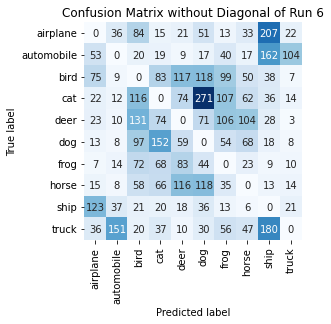

Summing down the rows, for Predictions of each Class that were wrong:  [367. 285. 619. 534. 507. 756. 523. 410. 691. 203.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  117.0 times
Summing across the columns, for total number of that True Class misidentified:  [482. 441. 596. 714. 550. 477. 330. 443. 295. 567.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  131.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Bri

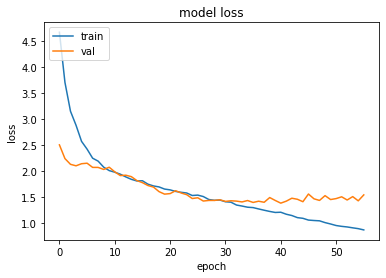

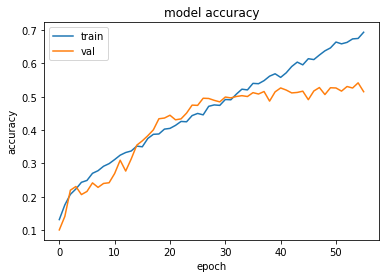

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3811503648757935 , and Val Acc happened to be 0.5263000130653381
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.5415999889373779 and Val Loss happened to be  1.425919771194458
TestLoss:  1.3446718454360962  TestAcc: 0.5199999809265137
frog 0.695
ship 0.686
automobile 0.631
horse 0.618
truck 0.538
deer 0.532
dog 0.517
airplane 0.4
bird 0.313
cat 0.27


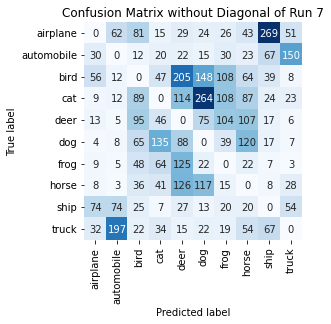

Summing down the rows, for Predictions of each Class that were wrong:  [235. 378. 473. 409. 751. 700. 469. 540. 515. 330.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  205.0 times
Summing across the columns, for total number of that True Class misidentified:  [600. 369. 687. 730. 468. 483. 305. 382. 314. 462.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  107.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 

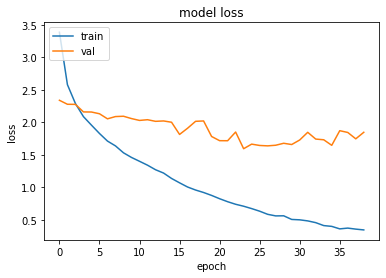

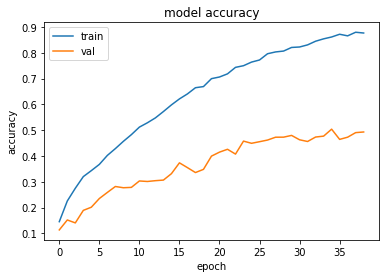

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5933499336242676 , and Val Acc happened to be 0.4577000141143799
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5040000081062317 and Val Loss happened to be  1.645692229270935
TestLoss:  1.5542755126953125  TestAcc: 0.4738999903202057
frog 0.847
truck 0.576
airplane 0.546
ship 0.539
deer 0.518
horse 0.505
automobile 0.362
dog 0.311
bird 0.271
cat 0.264


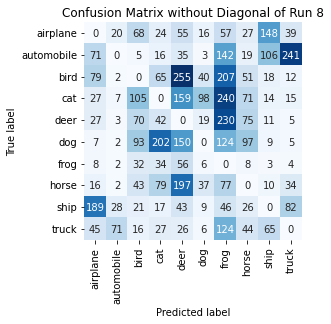

Summing down the rows, for Predictions of each Class that were wrong:  [ 469.  137.  453.  506.  976.  234. 1247.  418.  384.  437.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  255.0 times
Summing across the columns, for total number of that True Class misidentified:  [454. 638. 729. 736. 482. 689. 153. 495. 461. 424.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  230.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

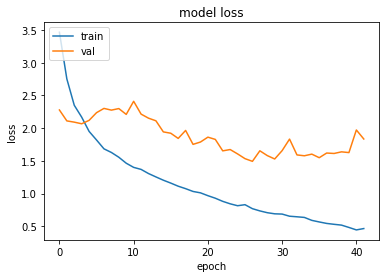

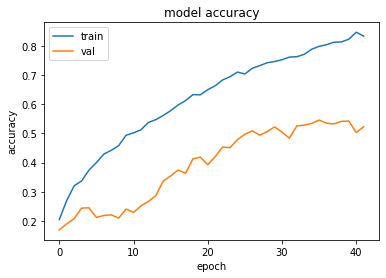

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.4929412603378296 , and Val Acc happened to be 0.5087000131607056
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5455999970436096 and Val Loss happened to be  1.5484713315963745
TestLoss:  1.4545522928237915  TestAcc: 0.5214999914169312
frog 0.872
ship 0.787
automobile 0.626
truck 0.593
horse 0.498
airplane 0.466
deer 0.449
dog 0.338
cat 0.333
bird 0.253


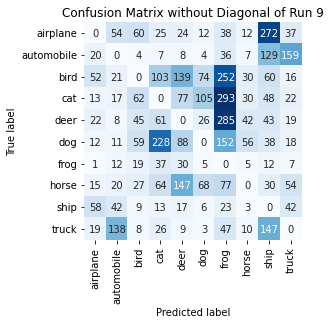

Summing down the rows, for Predictions of each Class that were wrong:  [ 212.  323.  293.  564.  539.  303. 1203.  195.  779.  374.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [534. 374. 747. 667. 551. 662. 128. 502. 213. 407.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  285.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

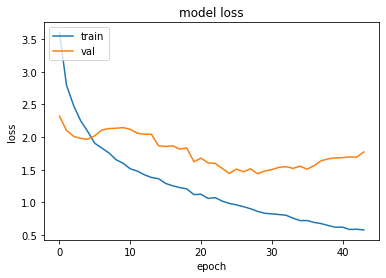

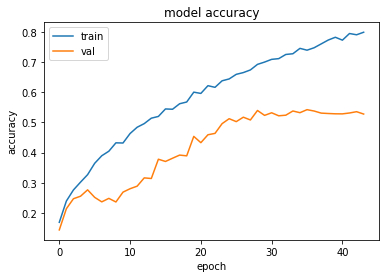

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.4373259544372559 , and Val Acc happened to be 0.5393000245094299
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5419999957084656 and Val Loss happened to be  1.5077850818634033
TestLoss:  1.4048912525177002  TestAcc: 0.5367000102996826
frog 0.777
ship 0.661
truck 0.65
automobile 0.646
horse 0.549
dog 0.522
airplane 0.494
deer 0.437
cat 0.342
bird 0.289


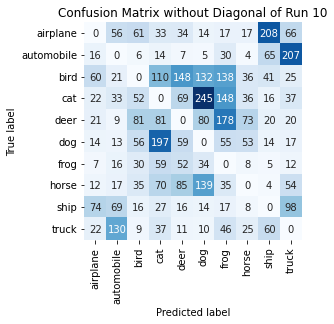

Summing down the rows, for Predictions of each Class that were wrong:  [248. 364. 346. 628. 481. 673. 664. 260. 433. 536.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  148.0 times
Summing across the columns, for total number of that True Class misidentified:  [506. 354. 711. 658. 563. 478. 223. 451. 339. 350.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  178.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

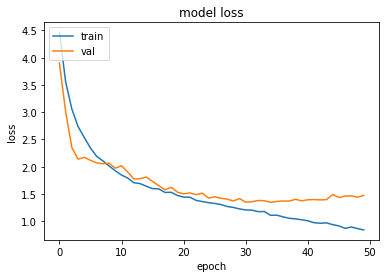

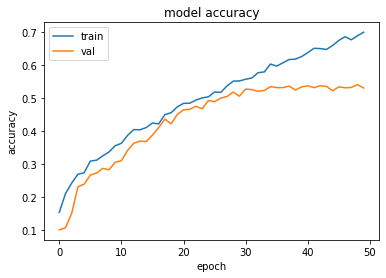

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3463729619979858 , and Val Acc happened to be 0.5347999930381775
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5410000085830688 and Val Loss happened to be  1.4408619403839111
TestLoss:  1.3136976957321167  TestAcc: 0.5400000214576721
frog 0.702
automobile 0.676
horse 0.656
ship 0.646
truck 0.619
airplane 0.558
dog 0.528
deer 0.46
cat 0.285
bird 0.27


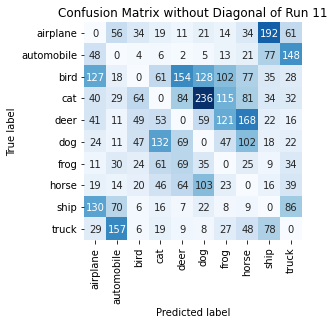

Summing down the rows, for Predictions of each Class that were wrong:  [469. 396. 254. 413. 469. 617. 470. 565. 481. 466.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  154.0 times
Summing across the columns, for total number of that True Class misidentified:  [442. 324. 730. 715. 540. 472. 298. 344. 354. 381.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  168.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16

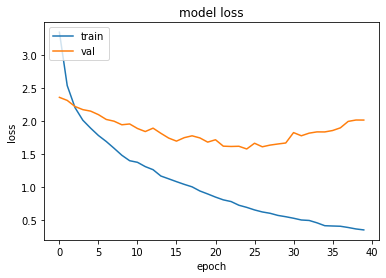

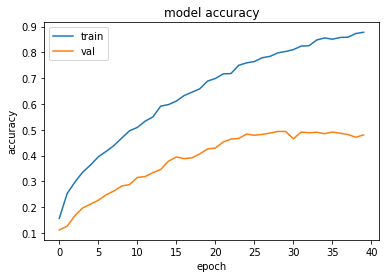

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5758225917816162 , and Val Acc happened to be 0.4830999970436096
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.4932999908924103 and Val Loss happened to be  1.651413917541504
TestLoss:  1.5587480068206787  TestAcc: 0.49050000309944153
automobile 0.675
frog 0.657
ship 0.609
truck 0.558
deer 0.537
horse 0.519
airplane 0.438
dog 0.406
cat 0.295
bird 0.211


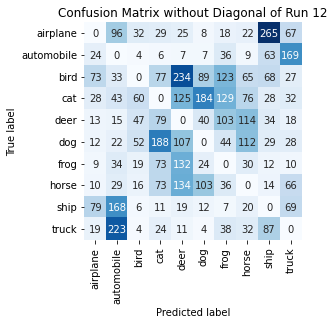

Summing down the rows, for Predictions of each Class that were wrong:  [267. 663. 240. 560. 794. 471. 534. 480. 600. 486.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  234.0 times
Summing across the columns, for total number of that True Class misidentified:  [562. 325. 789. 705. 463. 594. 343. 481. 391. 442.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  114.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.0 , 0.0 )

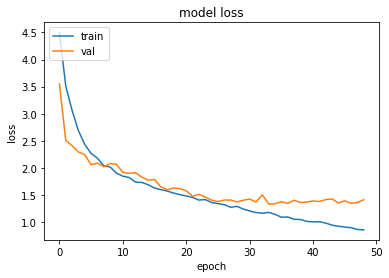

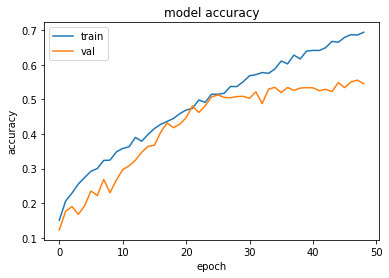

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3329389095306396 , and Val Acc happened to be 0.5296000242233276
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5555999875068665 and Val Loss happened to be  1.3594019412994385
TestLoss:  1.2923624515533447  TestAcc: 0.5314000248908997
ship 0.737
automobile 0.693
frog 0.684
dog 0.626
horse 0.591
truck 0.541
airplane 0.459
deer 0.358
cat 0.331
bird 0.294


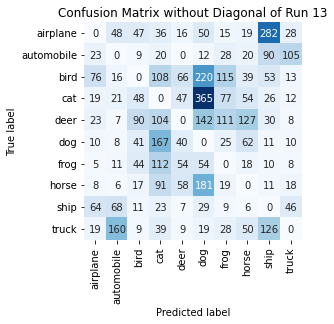

Summing down the rows, for Predictions of each Class that were wrong:  [ 247.  345.  316.  700.  297. 1072.  427.  395.  639.  248.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  66.0 times
Summing across the columns, for total number of that True Class misidentified:  [541. 307. 706. 669. 642. 374. 316. 409. 263. 459.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  142.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.

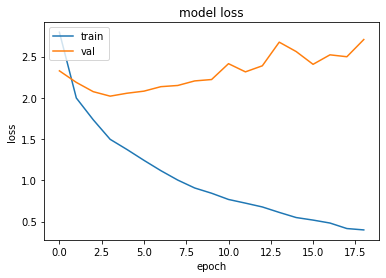

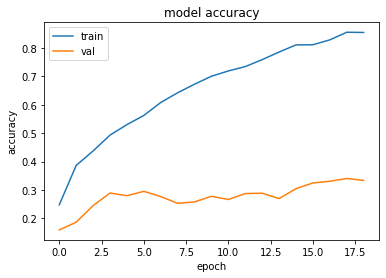

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.0204997062683105 , and Val Acc happened to be 0.28929999470710754
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.34040001034736633 and Val Loss happened to be  2.498487710952759
TestLoss:  2.011979579925537  TestAcc: 0.29190000891685486
ship 0.652
dog 0.509
airplane 0.369
cat 0.331
horse 0.318
deer 0.286
frog 0.232
bird 0.185
automobile 0.026
truck 0.011


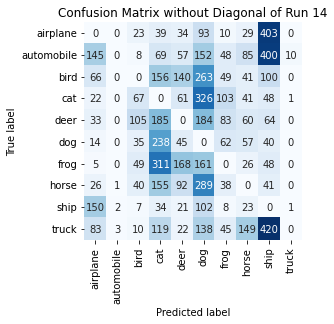

Summing down the rows, for Predictions of each Class that were wrong:  [ 544.    6.  344. 1306.  640. 1708.  446.  511. 1564.   12.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  168.0 times
Summing across the columns, for total number of that True Class misidentified:  [631. 974. 815. 669. 714. 491. 768. 682. 348. 989.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  185.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

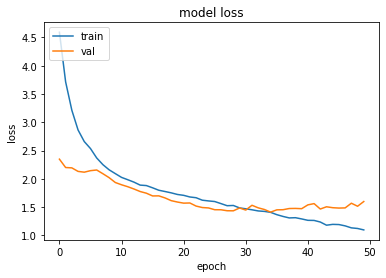

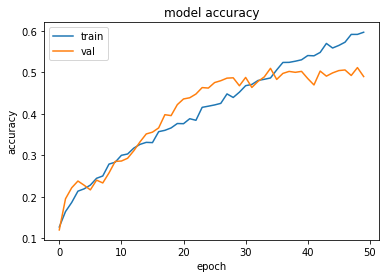

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4112917184829712 , and Val Acc happened to be 0.5099999904632568
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5117999911308289 and Val Loss happened to be  1.515171766281128
TestLoss:  1.3717669248580933  TestAcc: 0.5138999819755554
frog 0.683
ship 0.648
automobile 0.594
truck 0.574
horse 0.534
airplane 0.518
dog 0.499
deer 0.462
cat 0.317
bird 0.31


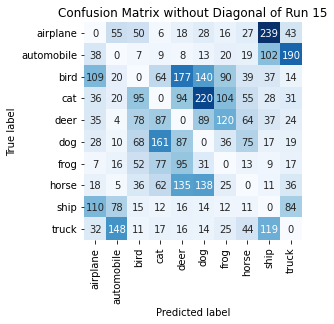

Summing down the rows, for Predictions of each Class that were wrong:  [413. 356. 412. 495. 646. 687. 448. 347. 599. 458.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  177.0 times
Summing across the columns, for total number of that True Class misidentified:  [482. 406. 690. 683. 538. 501. 317. 466. 352. 426.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  120.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


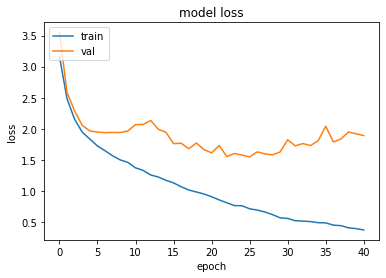

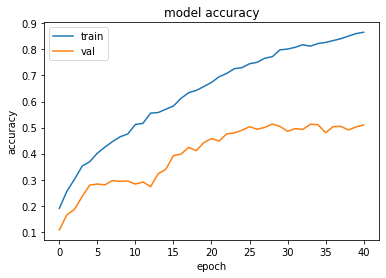

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5499005317687988 , and Val Acc happened to be 0.5034999847412109
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5135999917984009 and Val Loss happened to be  1.5825480222702026
TestLoss:  1.5149894952774048  TestAcc: 0.4991999864578247
frog 0.795
ship 0.684
truck 0.644
automobile 0.56
deer 0.55
horse 0.429
dog 0.404
airplane 0.383
cat 0.294
bird 0.249


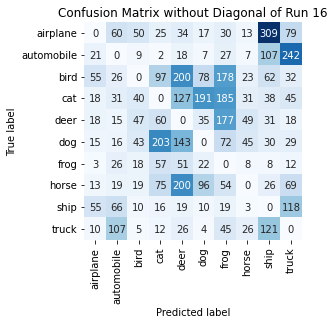

Summing down the rows, for Predictions of each Class that were wrong:  [208. 366. 241. 547. 818. 460. 787. 205. 732. 644.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  200.0 times
Summing across the columns, for total number of that True Class misidentified:  [617. 440. 751. 706. 450. 596. 205. 571. 316. 356.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  177.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

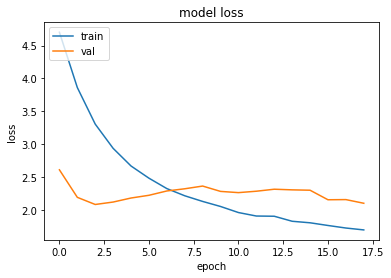

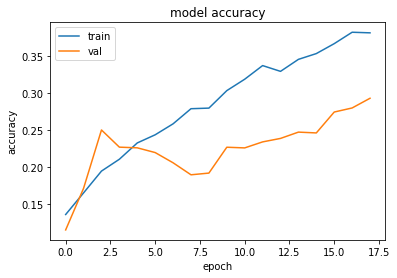

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.080923318862915 , and Val Acc happened to be 0.2498999983072281
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.29269999265670776 and Val Loss happened to be  2.099444627761841
TestLoss:  2.0754857063293457  TestAcc: 0.24650000035762787
dog 0.576
ship 0.548
deer 0.401
airplane 0.339
cat 0.319
horse 0.157
frog 0.093
truck 0.019
automobile 0.009
bird 0.004


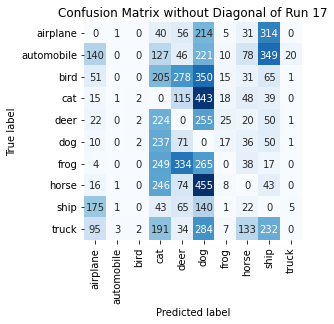

Summing down the rows, for Predictions of each Class that were wrong:  [ 528.    7.    8. 1562. 1073. 2627.  106.  437. 1159.   28.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  334.0 times
Summing across the columns, for total number of that True Class misidentified:  [661. 991. 996. 681. 599. 424. 907. 843. 452. 981.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  255.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )

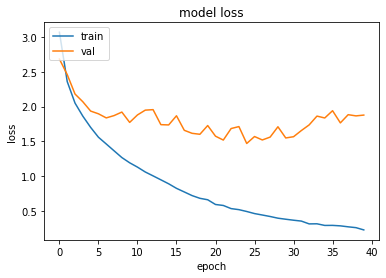

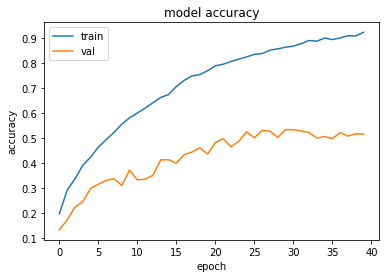

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.4692720174789429 , and Val Acc happened to be 0.525600016117096
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5342000126838684 and Val Loss happened to be  1.5487312078475952
TestLoss:  1.4605302810668945  TestAcc: 0.522599995136261
frog 0.709
airplane 0.626
deer 0.606
automobile 0.591
ship 0.583
horse 0.556
truck 0.554
dog 0.45
bird 0.278
cat 0.273


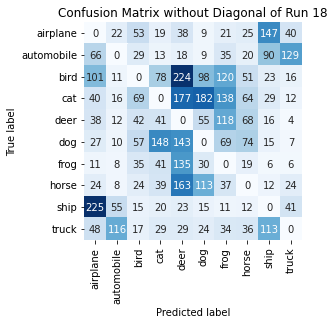

Summing down the rows, for Predictions of each Class that were wrong:  [580. 258. 341. 428. 950. 535. 583. 369. 451. 279.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  224.0 times
Summing across the columns, for total number of that True Class misidentified:  [374. 409. 722. 727. 394. 550. 291. 444. 417. 446.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  118.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

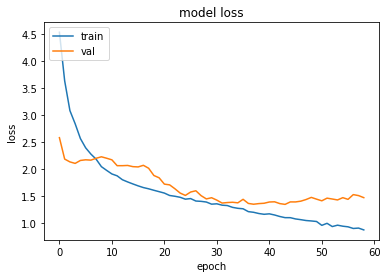

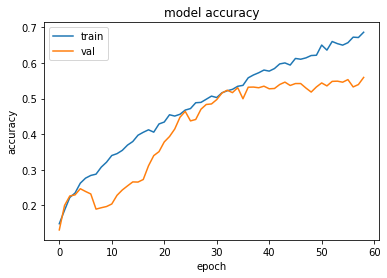

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.3475723266601562 , and Val Acc happened to be 0.5462999939918518
Additionally, the best val acc epoch happened to be  58 when val acc was:  0.559499979019165 and Val Loss happened to be  1.4719430208206177
TestLoss:  1.313090205192566  TestAcc: 0.550000011920929
frog 0.778
ship 0.738
automobile 0.675
truck 0.637
airplane 0.524
horse 0.511
deer 0.487
dog 0.458
bird 0.387
cat 0.305


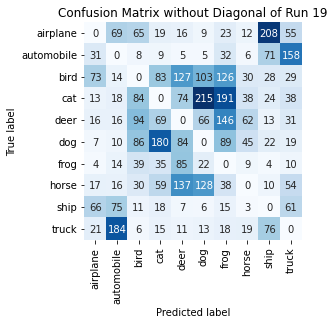

Summing down the rows, for Predictions of each Class that were wrong:  [248. 416. 423. 487. 546. 567. 678. 224. 456. 455.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  137.0 times
Summing across the columns, for total number of that True Class misidentified:  [476. 325. 613. 695. 513. 542. 222. 489. 262. 363.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  146.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

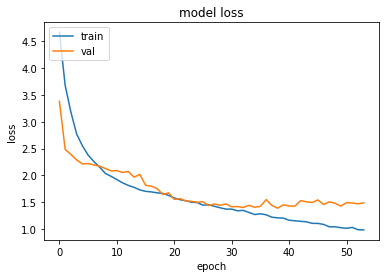

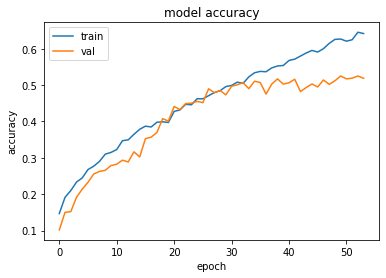

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3884211778640747 , and Val Acc happened to be 0.5170999765396118
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5249999761581421 and Val Loss happened to be  1.4275470972061157
TestLoss:  1.3529424667358398  TestAcc: 0.5199999809265137
frog 0.745
automobile 0.697
ship 0.619
truck 0.594
horse 0.547
dog 0.505
airplane 0.47
deer 0.461
bird 0.297
cat 0.265


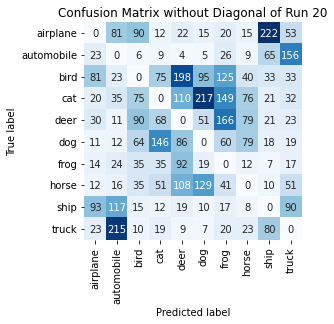

Summing down the rows, for Predictions of each Class that were wrong:  [307. 534. 420. 427. 648. 548. 624. 341. 477. 474.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  198.0 times
Summing across the columns, for total number of that True Class misidentified:  [530. 303. 703. 735. 539. 495. 255. 453. 381. 406.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  166.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

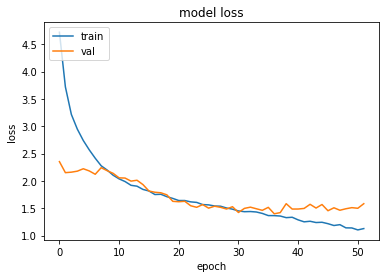

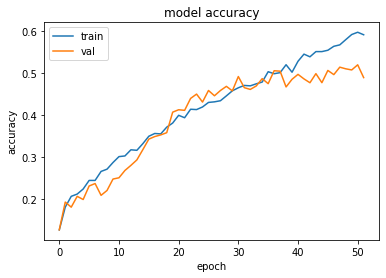

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3975839614868164 , and Val Acc happened to be 0.505299985408783
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5194000005722046 and Val Loss happened to be  1.4986753463745117
TestLoss:  1.361574649810791  TestAcc: 0.5120000243186951
frog 0.738
automobile 0.696
ship 0.647
horse 0.533
dog 0.531
truck 0.51
deer 0.463
airplane 0.456
bird 0.277
cat 0.269


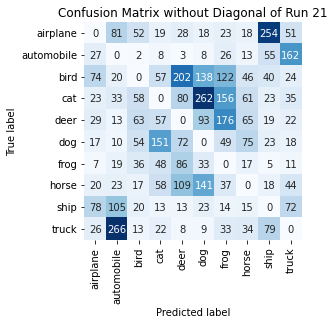

Summing down the rows, for Predictions of each Class that were wrong:  [301. 570. 315. 433. 601. 725. 636. 344. 516. 439.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [544. 304. 723. 731. 537. 469. 262. 467. 353. 490.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  176.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

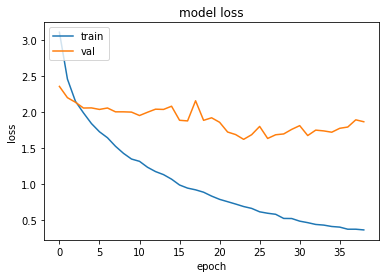

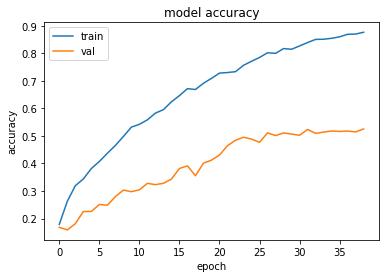

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6206579208374023 , and Val Acc happened to be 0.49549999833106995
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5254999995231628 and Val Loss happened to be  1.8661497831344604
TestLoss:  1.5723463296890259  TestAcc: 0.49799999594688416
frog 0.913
ship 0.692
truck 0.622
airplane 0.568
automobile 0.486
horse 0.45
deer 0.442
dog 0.386
bird 0.26
cat 0.161


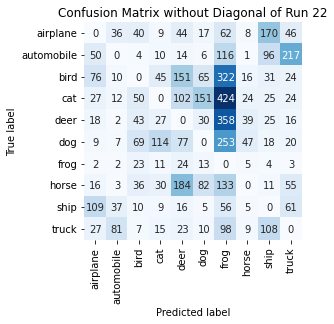

Summing down the rows, for Predictions of each Class that were wrong:  [ 334.  190.  282.  270.  635.  379. 1822.  154.  488.  466.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [432. 514. 740. 839. 558. 614.  87. 550. 308. 378.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  358.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08

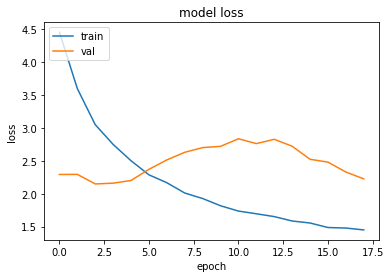

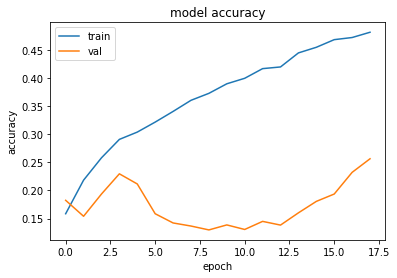

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.1477479934692383 , and Val Acc happened to be 0.19370000064373016
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.2565000057220459 and Val Loss happened to be  2.224597930908203
TestLoss:  2.1381614208221436  TestAcc: 0.19480000436306
dog 0.765
airplane 0.37
deer 0.263
cat 0.228
frog 0.122
ship 0.106
horse 0.067
bird 0.012
automobile 0.009
truck 0.006


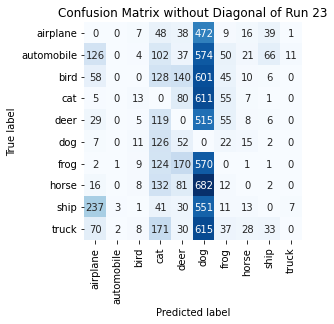

Summing down the rows, for Predictions of each Class that were wrong:  [ 550.    6.   66.  991.  658. 5191.  296.  119.  156.   19.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [630. 991. 988. 772. 737. 235. 878. 933. 894. 994.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  515.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )

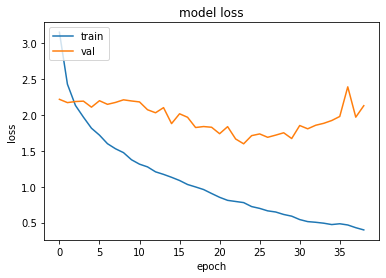

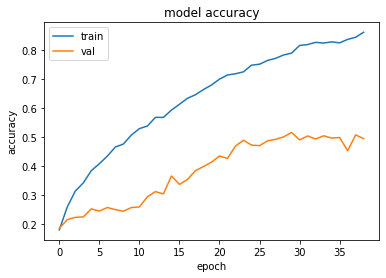

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5989716053009033 , and Val Acc happened to be 0.4896000027656555
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5164999961853027 and Val Loss happened to be  1.6726535558700562
TestLoss:  1.5484163761138916  TestAcc: 0.498199999332428
frog 0.718
ship 0.668
deer 0.583
truck 0.581
automobile 0.503
dog 0.471
horse 0.437
airplane 0.416
cat 0.404
bird 0.201


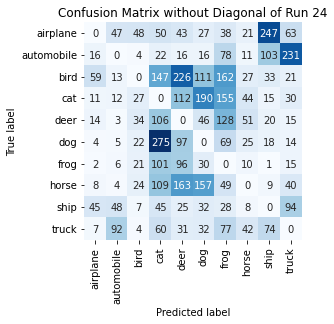

Summing down the rows, for Predictions of each Class that were wrong:  [166. 230. 191. 915. 809. 641. 784. 239. 520. 523.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  226.0 times
Summing across the columns, for total number of that True Class misidentified:  [584. 497. 799. 596. 417. 529. 282. 563. 332. 419.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  128.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

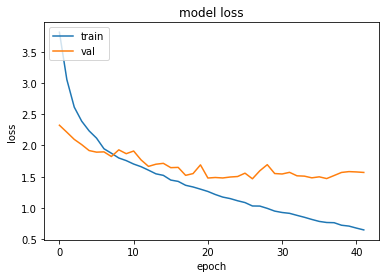

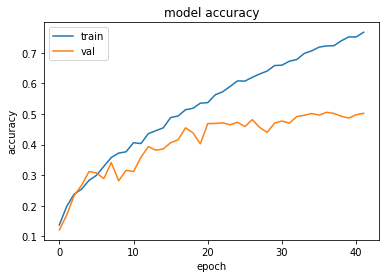

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.4661675691604614 , and Val Acc happened to be 0.4814000129699707
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5055000185966492 and Val Loss happened to be  1.4695771932601929
TestLoss:  1.4320800304412842  TestAcc: 0.492900013923645
frog 0.807
ship 0.644
automobile 0.615
truck 0.495
dog 0.494
horse 0.463
airplane 0.455
deer 0.455
cat 0.265
bird 0.236


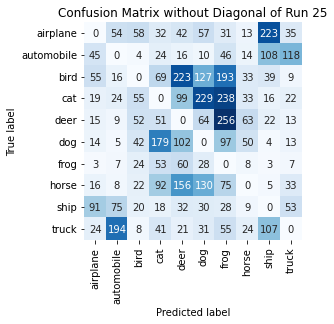

Summing down the rows, for Predictions of each Class that were wrong:  [ 282.  392.  285.  559.  751.  706. 1019.  247.  527.  303.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  223.0 times
Summing across the columns, for total number of that True Class misidentified:  [545. 385. 764. 735. 545. 506. 193. 537. 356. 505.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  256.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

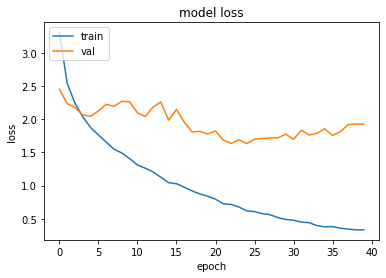

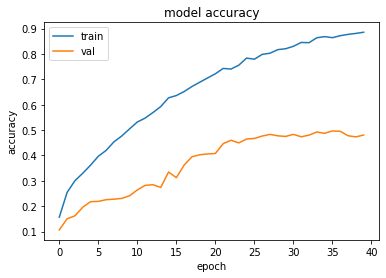

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6335397958755493 , and Val Acc happened to be 0.46470001339912415
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.4964999854564667 and Val Loss happened to be  1.756805419921875
TestLoss:  1.5915966033935547  TestAcc: 0.47380000352859497
frog 0.797
ship 0.644
deer 0.599
airplane 0.563
horse 0.482
automobile 0.471
truck 0.466
dog 0.294
bird 0.224
cat 0.198


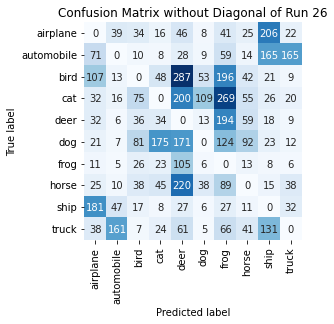

Summing down the rows, for Predictions of each Class that were wrong:  [ 518.  304.  324.  381. 1145.  247. 1065.  352.  613.  313.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  287.0 times
Summing across the columns, for total number of that True Class misidentified:  [437. 529. 776. 802. 401. 706. 203. 518. 356. 534.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  194.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

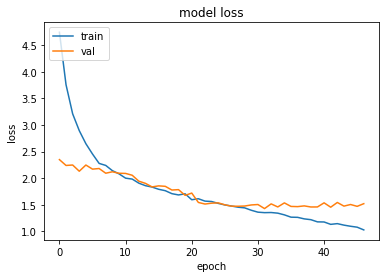

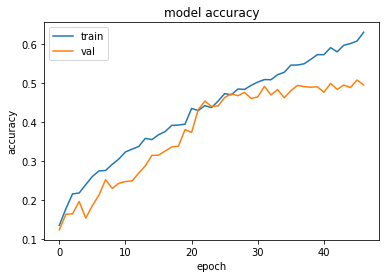

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.4273873567581177 , and Val Acc happened to be 0.4909999966621399
Additionally, the best val acc epoch happened to be  45 when val acc was:  0.5072000026702881 and Val Loss happened to be  1.4694712162017822
TestLoss:  1.403059720993042  TestAcc: 0.4943999946117401
ship 0.657
frog 0.651
truck 0.63
horse 0.562
automobile 0.559
dog 0.529
deer 0.506
airplane 0.374
bird 0.285
cat 0.191


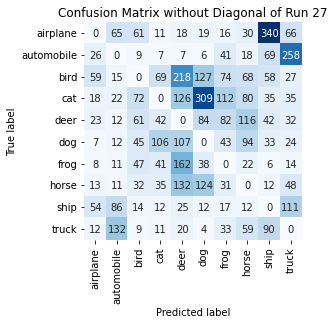

Summing down the rows, for Predictions of each Class that were wrong:  [220. 366. 350. 334. 815. 723. 449. 499. 685. 615.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  218.0 times
Summing across the columns, for total number of that True Class misidentified:  [626. 441. 715. 809. 494. 471. 349. 438. 343. 370.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  116.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

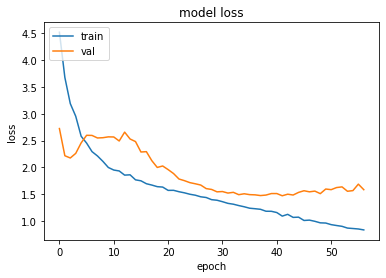

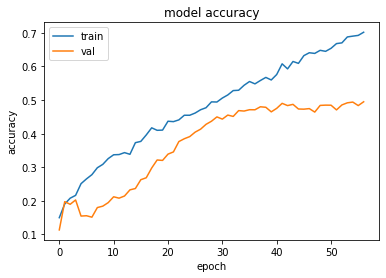

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.4711977243423462 , and Val Acc happened to be 0.490200012922287
Additionally, the best val acc epoch happened to be  56 when val acc was:  0.4948999881744385 and Val Loss happened to be  1.584574818611145
TestLoss:  1.4334022998809814  TestAcc: 0.49079999327659607
frog 0.673
automobile 0.597
truck 0.584
horse 0.535
dog 0.529
airplane 0.516
ship 0.514
deer 0.492
bird 0.254
cat 0.214


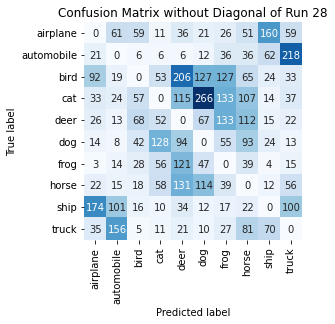

Summing down the rows, for Predictions of each Class that were wrong:  [420. 411. 299. 385. 764. 676. 593. 606. 385. 553.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  206.0 times
Summing across the columns, for total number of that True Class misidentified:  [484. 403. 746. 786. 508. 471. 327. 465. 486. 416.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  133.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


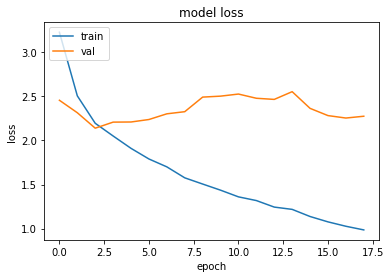

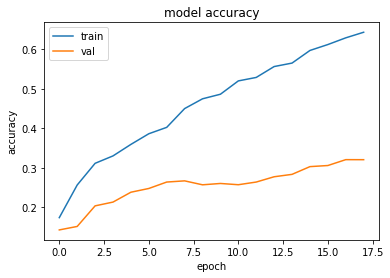

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.1390957832336426 , and Val Acc happened to be 0.20329999923706055
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.320499986410141 and Val Loss happened to be  2.2541563510894775
TestLoss:  2.129251480102539  TestAcc: 0.2054000049829483
dog 0.803
airplane 0.331
horse 0.24
ship 0.225
frog 0.178
bird 0.137
deer 0.111
cat 0.019
automobile 0.008
truck 0.002


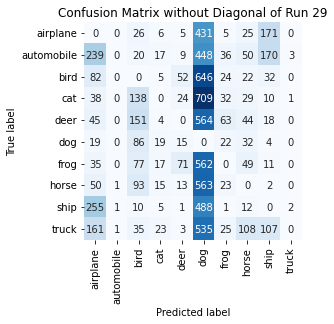

Summing down the rows, for Predictions of each Class that were wrong:  [9.240e+02 3.000e+00 6.360e+02 1.110e+02 1.930e+02 4.946e+03 2.310e+02
 3.710e+02 5.250e+02 6.000e+00]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  71.0 times
Summing across the columns, for total number of that True Class misidentified:  [669. 992. 863. 981. 889. 197. 822. 760. 775. 998.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  564.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  (

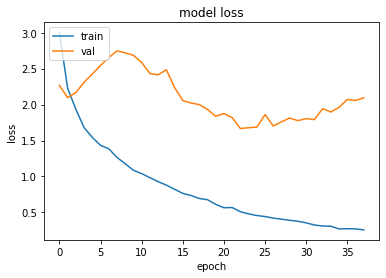

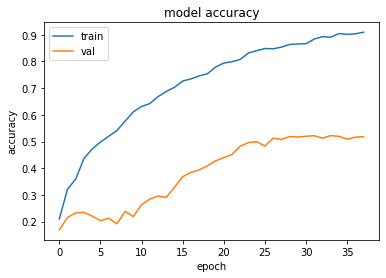

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.667054295539856 , and Val Acc happened to be 0.4828000068664551
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5223000049591064 and Val Loss happened to be  1.8964020013809204
TestLoss:  1.6114139556884766  TestAcc: 0.4948999881744385
frog 0.756
airplane 0.657
deer 0.601
ship 0.548
truck 0.468
horse 0.466
automobile 0.452
dog 0.417
bird 0.316
cat 0.268


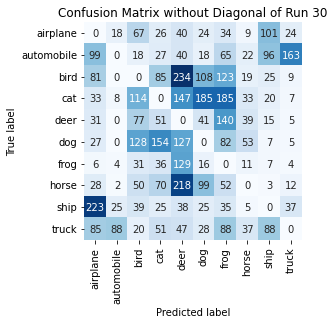

Summing down the rows, for Predictions of each Class that were wrong:  [ 613.  145.  544.  525. 1020.  544.  804.  228.  362.  266.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  234.0 times
Summing across the columns, for total number of that True Class misidentified:  [343. 548. 684. 732. 399. 583. 244. 534. 452. 532.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  140.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

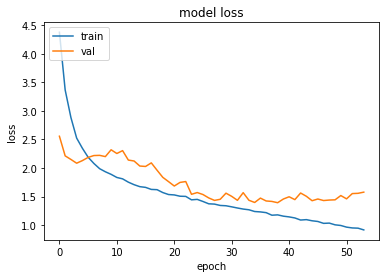

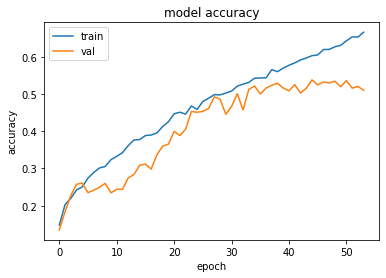

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3916264772415161 , and Val Acc happened to be 0.5286999940872192
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5378000140190125 and Val Loss happened to be  1.4264963865280151
TestLoss:  1.3523043394088745  TestAcc: 0.5227000117301941
truck 0.729
ship 0.691
frog 0.668
horse 0.582
automobile 0.545
deer 0.452
dog 0.439
bird 0.392
airplane 0.379
cat 0.35


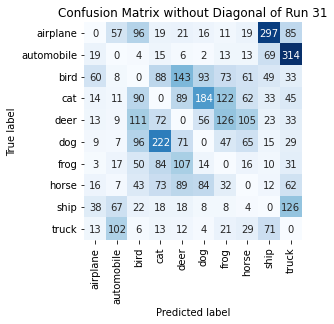

Summing down the rows, for Predictions of each Class that were wrong:  [185. 285. 518. 604. 556. 461. 453. 374. 579. 758.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  143.0 times
Summing across the columns, for total number of that True Class misidentified:  [621. 455. 608. 650. 548. 561. 332. 418. 309. 271.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  126.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

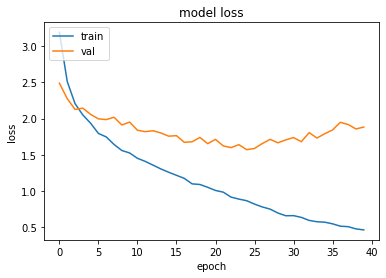

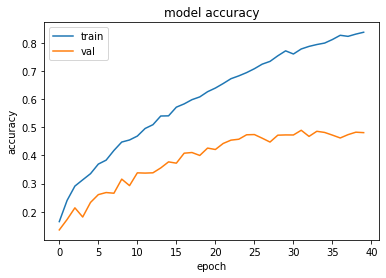

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5693950653076172 , and Val Acc happened to be 0.4731999933719635
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.48919999599456787 and Val Loss happened to be  1.680586576461792
TestLoss:  1.5416816473007202  TestAcc: 0.47940000891685486
ship 0.7
frog 0.629
deer 0.543
truck 0.525
horse 0.502
automobile 0.473
airplane 0.437
bird 0.374
dog 0.374
cat 0.237


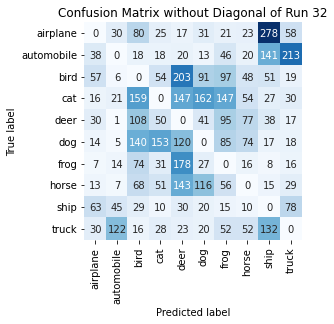

Summing down the rows, for Predictions of each Class that were wrong:  [268. 251. 692. 420. 881. 521. 614. 374. 707. 478.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  203.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 527. 626. 763. 457. 626. 371. 498. 300. 475.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  108.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    

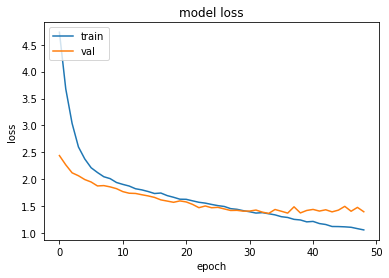

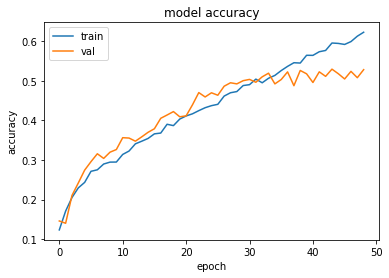

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3662256002426147 , and Val Acc happened to be 0.5192000269889832
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5293999910354614 and Val Loss happened to be  1.395185112953186
TestLoss:  1.3341478109359741  TestAcc: 0.5246000289916992
ship 0.665
frog 0.659
automobile 0.647
truck 0.581
airplane 0.566
dog 0.557
horse 0.489
deer 0.398
bird 0.356
cat 0.328


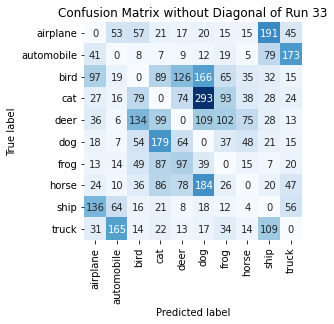

Summing down the rows, for Predictions of each Class that were wrong:  [423. 354. 447. 611. 486. 858. 403. 249. 515. 408.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  126.0 times
Summing across the columns, for total number of that True Class misidentified:  [434. 353. 644. 672. 602. 443. 341. 511. 335. 419.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  134.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

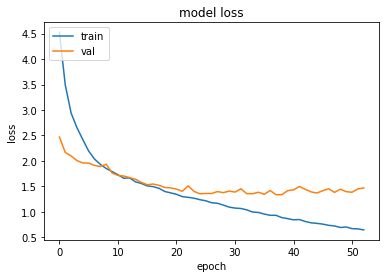

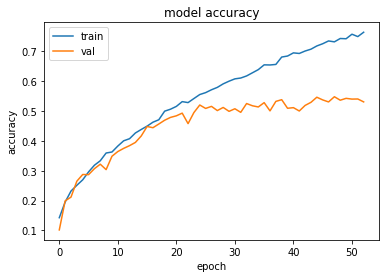

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3366419076919556 , and Val Acc happened to be 0.5325999855995178
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5482000112533569 and Val Loss happened to be  1.3830084800720215
TestLoss:  1.3174760341644287  TestAcc: 0.5339999794960022
automobile 0.767
horse 0.685
frog 0.682
ship 0.63
deer 0.603
truck 0.588
airplane 0.511
dog 0.455
cat 0.287
bird 0.132


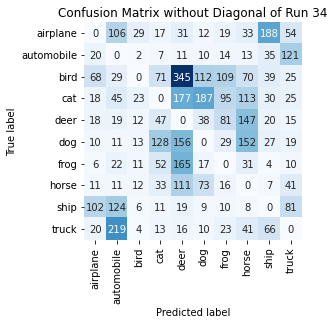

Summing down the rows, for Predictions of each Class that were wrong:  [ 273.  586.  112.  379. 1031.  468.  396.  608.  416.  391.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  345.0 times
Summing across the columns, for total number of that True Class misidentified:  [489. 233. 868. 713. 397. 545. 318. 315. 370. 412.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  147.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0

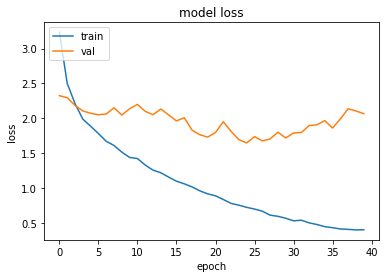

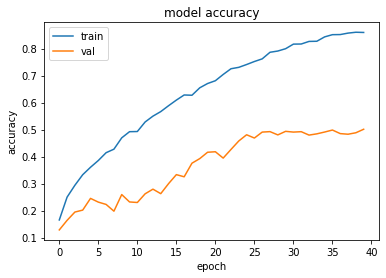

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6468615531921387 , and Val Acc happened to be 0.48100000619888306
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5013999938964844 and Val Loss happened to be  2.0664188861846924
TestLoss:  1.609929084777832  TestAcc: 0.4860999882221222
frog 0.793
ship 0.705
deer 0.608
truck 0.567
automobile 0.513
horse 0.484
dog 0.421
airplane 0.374
cat 0.25
bird 0.146


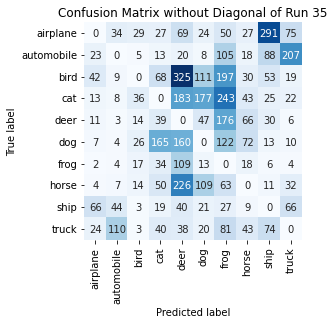

Summing down the rows, for Predictions of each Class that were wrong:  [ 192.  223.  147.  455. 1170.  530. 1064.  326.  591.  441.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  325.0 times
Summing across the columns, for total number of that True Class misidentified:  [626. 487. 854. 750. 392. 579. 207. 516. 295. 433.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  176.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

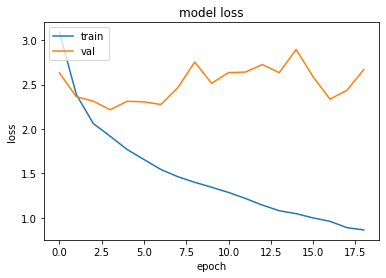

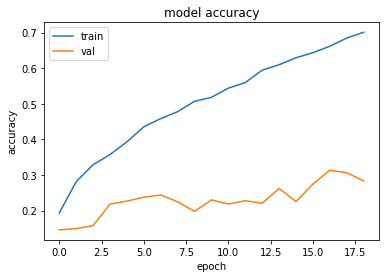

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.216834545135498 , and Val Acc happened to be 0.21809999644756317
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.313400000333786 and Val Loss happened to be  2.3360352516174316
TestLoss:  2.2034549713134766  TestAcc: 0.21860000491142273
dog 0.465
deer 0.359
frog 0.335
bird 0.294
cat 0.269
airplane 0.177
horse 0.159
ship 0.117
automobile 0.01
truck 0.001


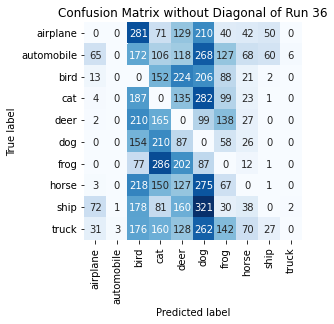

Summing down the rows, for Predictions of each Class that were wrong:  [ 190.    4. 1653. 1381. 1310. 2010.  789.  327.  142.    8.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  224.0 times
Summing across the columns, for total number of that True Class misidentified:  [823. 990. 706. 731. 641. 535. 665. 841. 883. 999.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  210.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

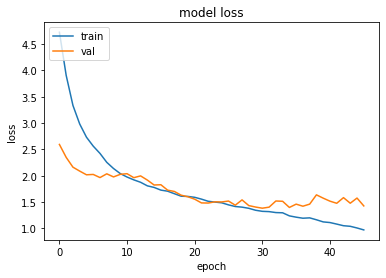

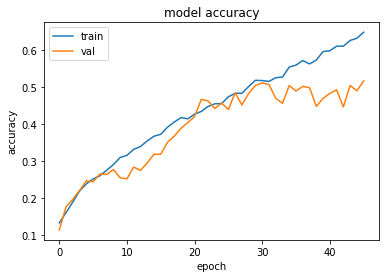

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.3828907012939453 , and Val Acc happened to be 0.5116999745368958
Additionally, the best val acc epoch happened to be  45 when val acc was:  0.5170999765396118 and Val Loss happened to be  1.4261723756790161
TestLoss:  1.3595669269561768  TestAcc: 0.5166000127792358
frog 0.701
automobile 0.645
truck 0.628
ship 0.593
horse 0.556
airplane 0.531
deer 0.531
dog 0.497
bird 0.331
cat 0.153


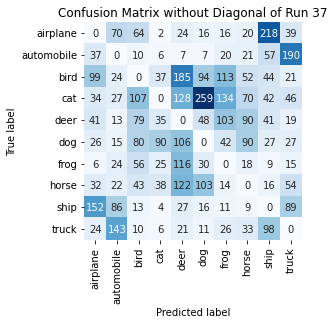

Summing down the rows, for Predictions of each Class that were wrong:  [451. 424. 462. 243. 736. 584. 479. 403. 552. 500.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  185.0 times
Summing across the columns, for total number of that True Class misidentified:  [469. 355. 669. 847. 469. 503. 299. 444. 407. 372.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  103.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

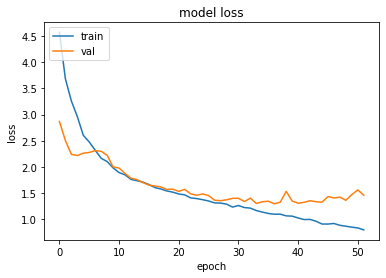

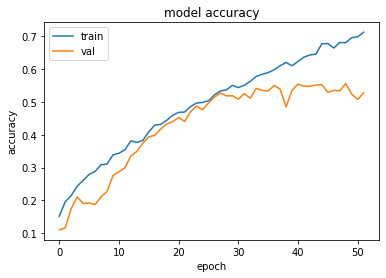

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.2969272136688232 , and Val Acc happened to be 0.5498999953269958
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5557000041007996 and Val Loss happened to be  1.3633143901824951
TestLoss:  1.2610609531402588  TestAcc: 0.5515999794006348
frog 0.711
automobile 0.698
airplane 0.62
ship 0.605
truck 0.593
horse 0.543
dog 0.535
deer 0.524
bird 0.357
cat 0.33


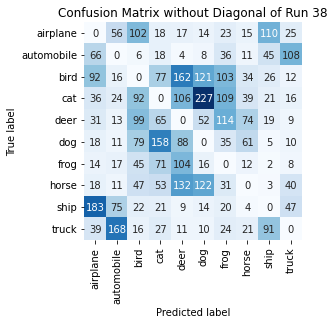

Summing down the rows, for Predictions of each Class that were wrong:  [497. 391. 508. 508. 633. 584. 495. 271. 322. 275.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  162.0 times
Summing across the columns, for total number of that True Class misidentified:  [380. 302. 643. 670. 476. 465. 289. 457. 395. 407.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  114.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

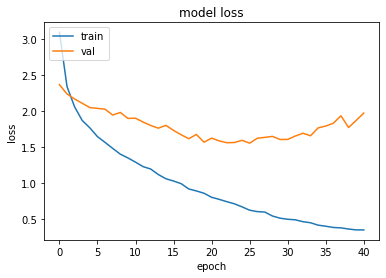

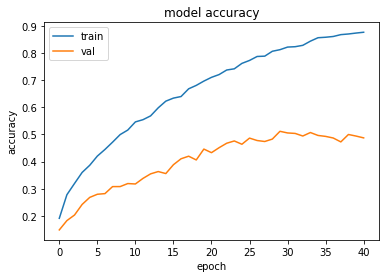

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5557606220245361 , and Val Acc happened to be 0.4864000082015991
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5113999843597412 and Val Loss happened to be  1.607222080230713
TestLoss:  1.5186976194381714  TestAcc: 0.4900999963283539
deer 0.66
ship 0.577
frog 0.576
automobile 0.526
airplane 0.515
dog 0.486
horse 0.468
truck 0.458
cat 0.319
bird 0.316


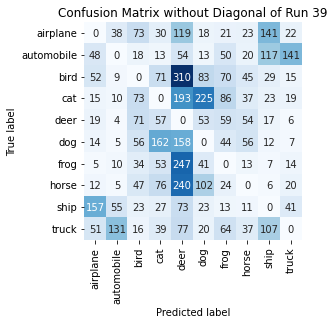

Summing down the rows, for Predictions of each Class that were wrong:  [ 373.  267.  411.  528. 1471.  578.  431.  296.  459.  285.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  310.0 times
Summing across the columns, for total number of that True Class misidentified:  [485. 474. 684. 681. 340. 514. 424. 532. 423. 542.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  71.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 ,

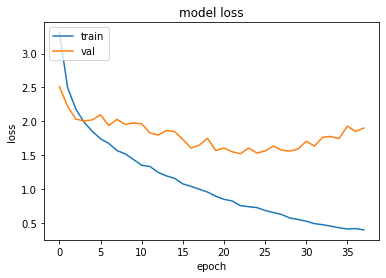

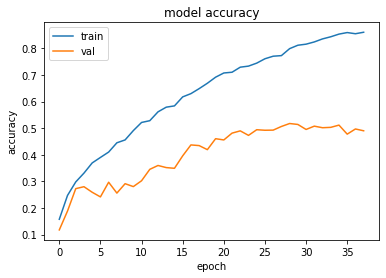

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5213395357131958 , and Val Acc happened to be 0.48980000615119934
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5174000263214111 and Val Loss happened to be  1.5600030422210693
TestLoss:  1.4773523807525635  TestAcc: 0.498199999332428
ship 0.687
frog 0.682
horse 0.621
deer 0.61
truck 0.52
automobile 0.518
airplane 0.44
bird 0.425
dog 0.265
cat 0.214


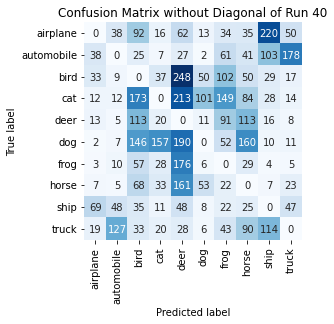

Summing down the rows, for Predictions of each Class that were wrong:  [ 196.  261.  742.  329. 1153.  250.  576.  627.  531.  353.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  248.0 times
Summing across the columns, for total number of that True Class misidentified:  [560. 482. 575. 786. 390. 735. 318. 379. 313. 480.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  113.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

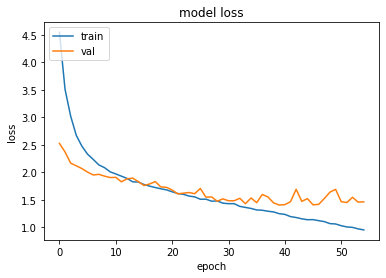

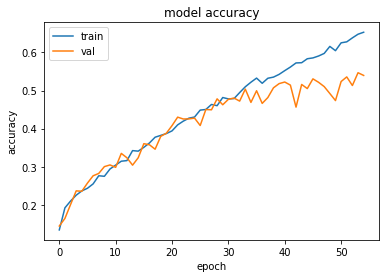

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.4042187929153442 , and Val Acc happened to be 0.5181000232696533
Additionally, the best val acc epoch happened to be  53 when val acc was:  0.5467000007629395 and Val Loss happened to be  1.457824945449829
TestLoss:  1.3532471656799316  TestAcc: 0.5223000049591064
frog 0.838
truck 0.675
ship 0.655
horse 0.591
airplane 0.535
automobile 0.526
deer 0.487
dog 0.458
cat 0.265
bird 0.193


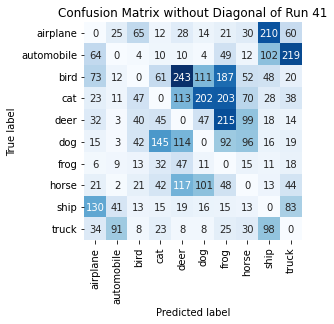

Summing down the rows, for Predictions of each Class that were wrong:  [398. 197. 253. 385. 699. 514. 855. 417. 544. 515.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  243.0 times
Summing across the columns, for total number of that True Class misidentified:  [465. 474. 807. 735. 513. 542. 162. 409. 345. 325.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  215.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16

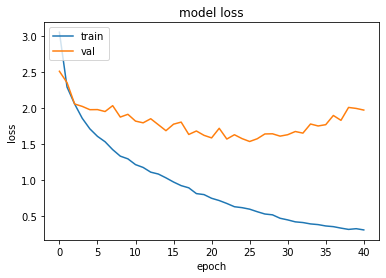

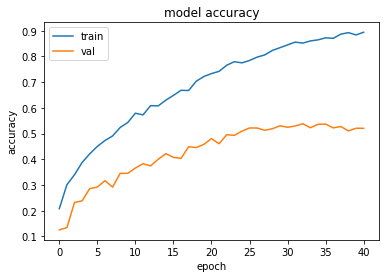

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5328431129455566 , and Val Acc happened to be 0.5217000246047974
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5382000207901001 and Val Loss happened to be  1.649216651916504
TestLoss:  1.4986695051193237  TestAcc: 0.5313000082969666
ship 0.799
frog 0.705
truck 0.616
horse 0.565
automobile 0.55
deer 0.534
airplane 0.474
cat 0.388
dog 0.347
bird 0.335


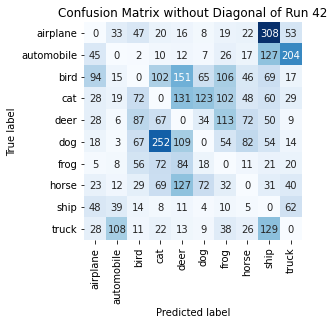

Summing down the rows, for Predictions of each Class that were wrong:  [317. 243. 385. 622. 654. 340. 500. 329. 849. 448.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  151.0 times
Summing across the columns, for total number of that True Class misidentified:  [526. 450. 665. 612. 466. 653. 295. 435. 201. 384.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  113.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

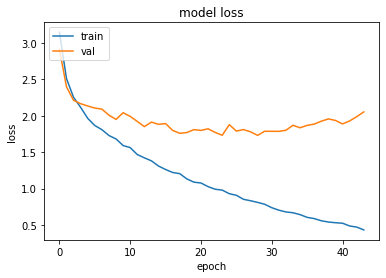

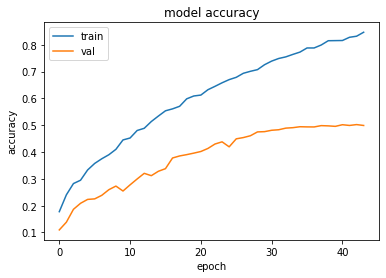

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.7295998334884644 , and Val Acc happened to be 0.4749000072479248
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5022000074386597 and Val Loss happened to be  1.9859998226165771
TestLoss:  1.6890970468521118  TestAcc: 0.48030000925064087
frog 0.771
ship 0.689
deer 0.589
automobile 0.561
truck 0.475
airplane 0.465
horse 0.459
dog 0.29
bird 0.272
cat 0.232


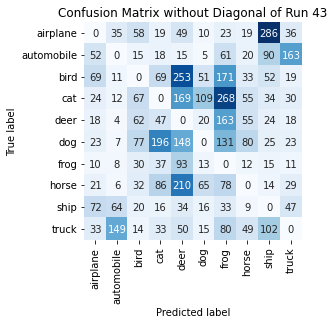

Summing down the rows, for Predictions of each Class that were wrong:  [ 322.  296.  375.  521. 1021.  304. 1008.  332.  642.  376.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  253.0 times
Summing across the columns, for total number of that True Class misidentified:  [535. 439. 728. 768. 411. 710. 229. 541. 311. 525.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  163.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

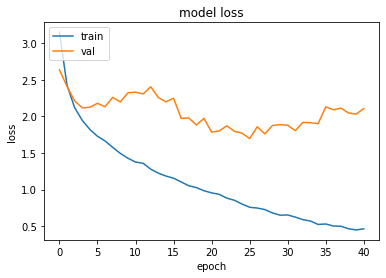

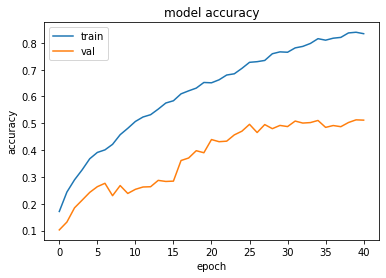

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.697986364364624 , and Val Acc happened to be 0.4961000084877014
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5127999782562256 and Val Loss happened to be  2.032778024673462
TestLoss:  1.6380822658538818  TestAcc: 0.5069000124931335
frog 0.854
automobile 0.628
truck 0.593
ship 0.587
airplane 0.477
deer 0.442
horse 0.418
dog 0.405
bird 0.339
cat 0.326


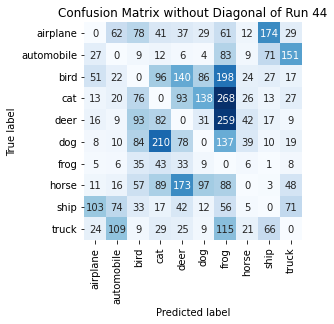

Summing down the rows, for Predictions of each Class that were wrong:  [ 258.  328.  474.  619.  627.  415. 1265.  184.  382.  379.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [523. 372. 661. 674. 558. 595. 146. 582. 413. 407.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  259.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

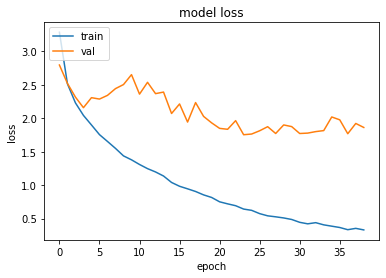

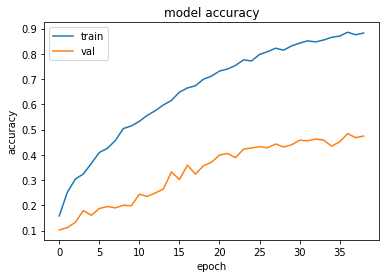

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.7539585828781128 , and Val Acc happened to be 0.42250001430511475
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.48410001397132874 and Val Loss happened to be  1.768918514251709
TestLoss:  1.7124760150909424  TestAcc: 0.43290001153945923
ship 0.795
frog 0.789
bird 0.498
airplane 0.447
truck 0.416
automobile 0.359
deer 0.323
horse 0.294
dog 0.225
cat 0.183


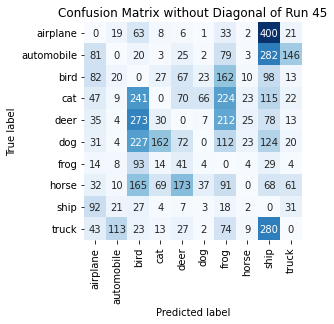

Summing down the rows, for Predictions of each Class that were wrong:  [ 457.  208. 1132.  330.  488.  145. 1005.  101. 1474.  331.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [553. 641. 502. 817. 677. 775. 211. 706. 205. 584.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  273.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

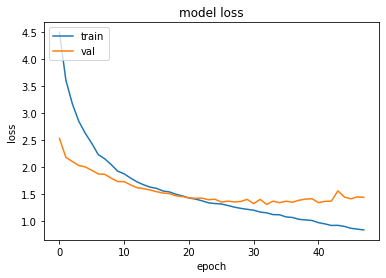

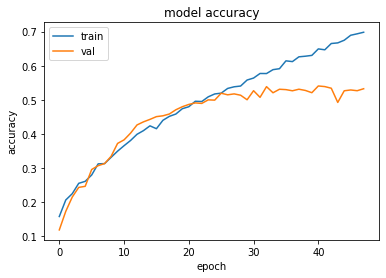

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3130210638046265 , and Val Acc happened to be 0.5388000011444092
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5407999753952026 and Val Loss happened to be  1.3452513217926025
TestLoss:  1.2872689962387085  TestAcc: 0.5346999764442444
frog 0.714
ship 0.656
truck 0.633
horse 0.624
automobile 0.586
airplane 0.552
dog 0.52
deer 0.505
cat 0.295
bird 0.262


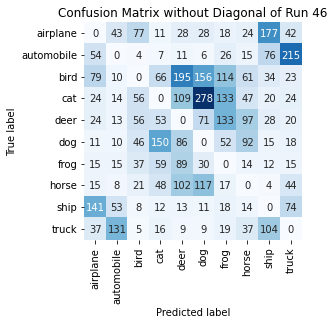

Summing down the rows, for Predictions of each Class that were wrong:  [400. 297. 310. 422. 642. 706. 530. 401. 470. 475.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  195.0 times
Summing across the columns, for total number of that True Class misidentified:  [448. 414. 738. 705. 495. 480. 286. 376. 344. 367.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  133.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

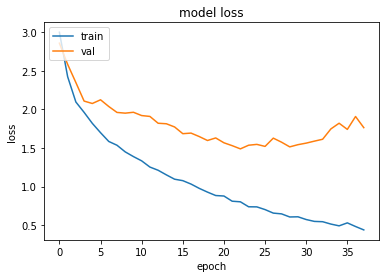

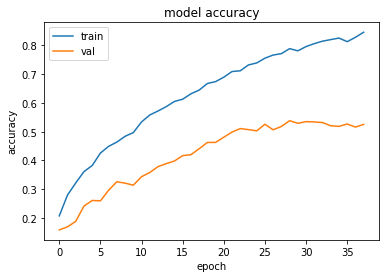

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4891636371612549 , and Val Acc happened to be 0.5109000205993652
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5382999777793884 and Val Loss happened to be  1.5151050090789795
TestLoss:  1.440656304359436  TestAcc: 0.517300009727478
frog 0.739
truck 0.704
ship 0.639
airplane 0.559
horse 0.53
dog 0.522
deer 0.516
automobile 0.411
bird 0.279
cat 0.274


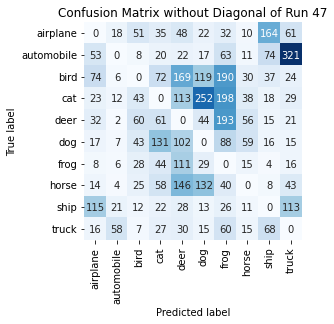

Summing down the rows, for Predictions of each Class that were wrong:  [352. 134. 277. 470. 769. 643. 890. 245. 404. 643.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  169.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 589. 721. 726. 484. 478. 261. 470. 361. 296.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  193.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


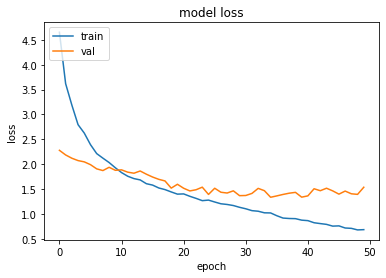

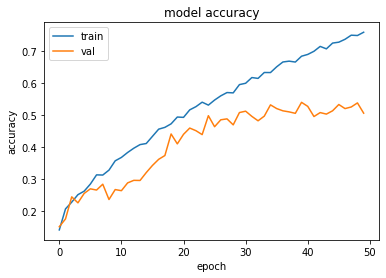

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3345392942428589 , and Val Acc happened to be 0.5320000052452087
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.539900004863739 and Val Loss happened to be  1.336768388748169
TestLoss:  1.3064860105514526  TestAcc: 0.5350000262260437
frog 0.779
ship 0.727
automobile 0.601
truck 0.566
horse 0.536
airplane 0.523
dog 0.455
deer 0.442
cat 0.364
bird 0.357


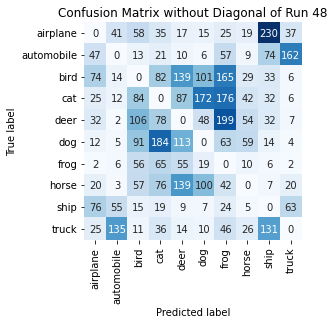

Summing down the rows, for Predictions of each Class that were wrong:  [313. 273. 491. 596. 583. 478. 797. 253. 559. 307.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [477. 399. 643. 636. 558. 545. 221. 464. 273. 434.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  199.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

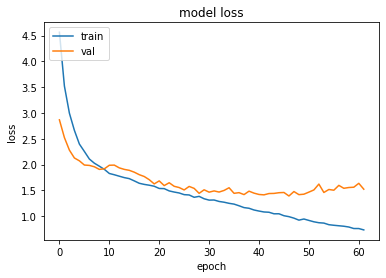

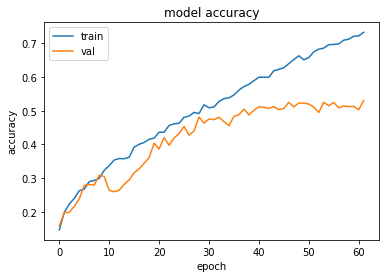

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  46 when  Val Loss was:  1.3921325206756592 , and Val Acc happened to be 0.5252000093460083
Additionally, the best val acc epoch happened to be  61 when val acc was:  0.5300999879837036 and Val Loss happened to be  1.5234431028366089
TestLoss:  1.3591820001602173  TestAcc: 0.5302000045776367
truck 0.698
frog 0.689
ship 0.673
horse 0.626
dog 0.613
automobile 0.506
airplane 0.494
deer 0.461
cat 0.276
bird 0.266


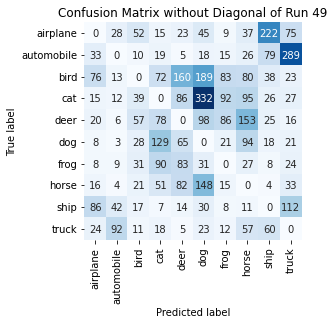

Summing down the rows, for Predictions of each Class that were wrong:  [286. 209. 266. 479. 523. 914. 341. 580. 480. 620.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  160.0 times
Summing across the columns, for total number of that True Class misidentified:  [506. 494. 734. 724. 539. 387. 311. 374. 327. 302.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  153.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0

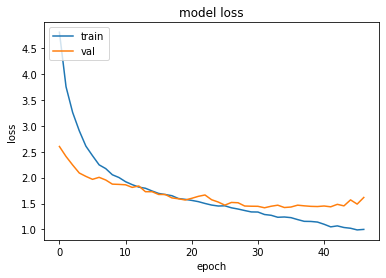

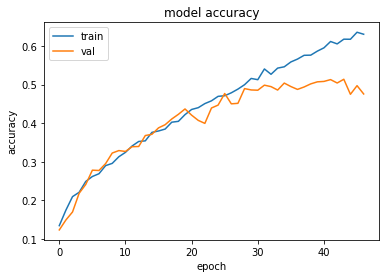

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.417641282081604 , and Val Acc happened to be 0.4986000061035156
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5138999819755554 and Val Loss happened to be  1.4543602466583252
TestLoss:  1.3837897777557373  TestAcc: 0.4982999861240387
ship 0.689
frog 0.661
truck 0.645
horse 0.575
automobile 0.528
deer 0.495
dog 0.463
airplane 0.387
cat 0.304
bird 0.236


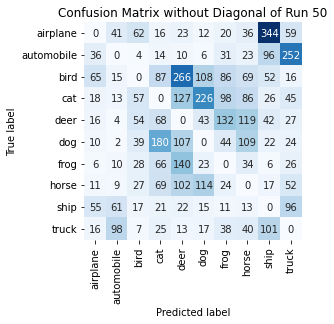

Summing down the rows, for Predictions of each Class that were wrong:  [233. 253. 295. 546. 810. 564. 484. 529. 706. 597.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  266.0 times
Summing across the columns, for total number of that True Class misidentified:  [613. 472. 764. 696. 505. 537. 339. 425. 311. 355.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  132.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 11 November 2021 19:10:22  (subtract ~5-hours for local Hour), and file is called  runs_GroupB_final.pkl


In [ ]:
#@title
run_through_runs(ds=make_unbatched(train_B), ds_noalb=train_B_noalb, dstitle="B" , showpictures= False)


filename will be:  runs_GroupC .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


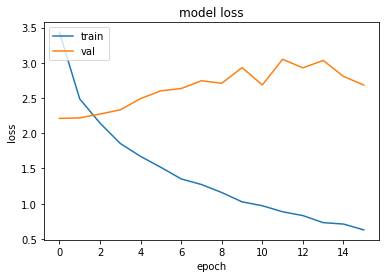

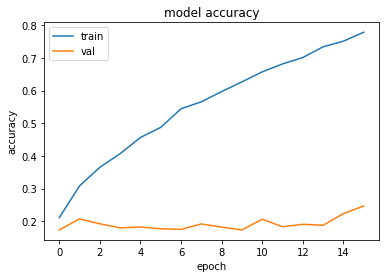

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  0 when  Val Loss was:  2.210174798965454 , and Val Acc happened to be 0.1738000065088272
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.2468000054359436 and Val Loss happened to be  2.683683395385742
TestLoss:  2.2091026306152344  TestAcc: 0.17090000212192535
ship 0.522
airplane 0.5
horse 0.377
cat 0.141
dog 0.069
deer 0.046
bird 0.028
automobile 0.02
truck 0.005
frog 0.001


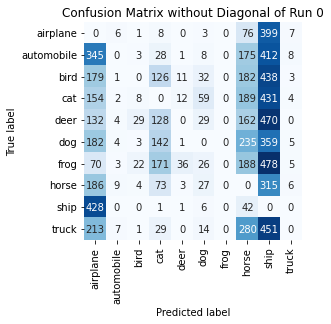

Summing down the rows, for Predictions of each Class that were wrong:  [1889.   36.   71.  706.   65.  204.    0. 1529. 3753.   38.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  36.0 times
Summing across the columns, for total number of that True Class misidentified:  [500. 980. 972. 859. 954. 931. 999. 623. 478. 995.]
For example, the model misclassified true 4's (deer) as label   8 ship  a total of  470.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   

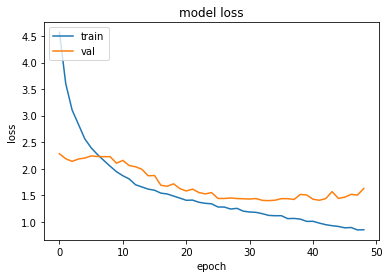

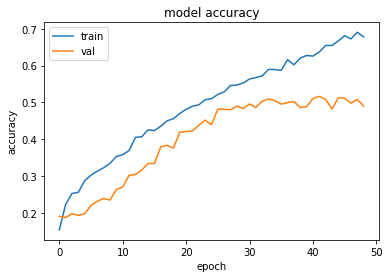

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3987698554992676 , and Val Acc happened to be 0.5097000002861023
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5163000226020813 and Val Loss happened to be  1.4060444831848145
TestLoss:  1.3850833177566528  TestAcc: 0.5072000026702881
frog 0.803
automobile 0.673
ship 0.614
truck 0.601
airplane 0.513
dog 0.495
horse 0.493
deer 0.361
bird 0.324
cat 0.195


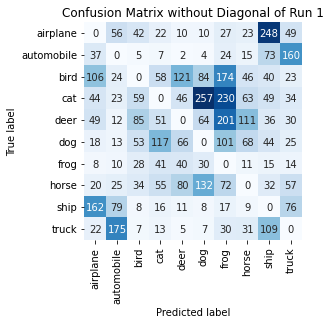

Summing down the rows, for Predictions of each Class that were wrong:  [466. 417. 321. 380. 381. 596. 876. 377. 646. 468.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  121.0 times
Summing across the columns, for total number of that True Class misidentified:  [487. 327. 676. 805. 639. 505. 197. 507. 386. 399.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  201.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0

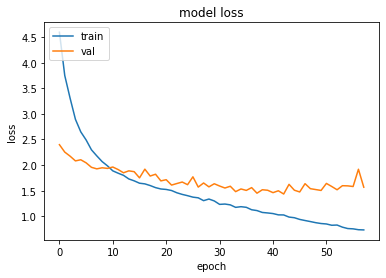

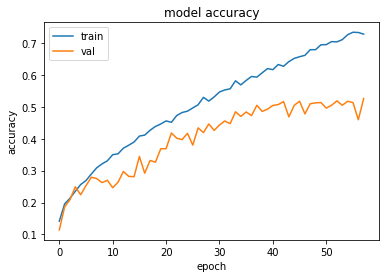

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  42 when  Val Loss was:  1.4345732927322388 , and Val Acc happened to be 0.516700029373169
Additionally, the best val acc epoch happened to be  57 when val acc was:  0.5263000130653381 and Val Loss happened to be  1.567223072052002
TestLoss:  1.4055063724517822  TestAcc: 0.5175999999046326
frog 0.737
ship 0.674
dog 0.625
truck 0.609
automobile 0.569
airplane 0.484
horse 0.47
deer 0.43
bird 0.306
cat 0.272


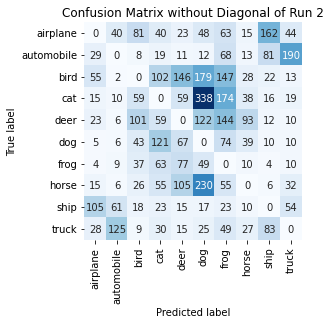

Summing down the rows, for Predictions of each Class that were wrong:  [ 279.  265.  382.  512.  518. 1020.  797.  273.  396.  382.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  146.0 times
Summing across the columns, for total number of that True Class misidentified:  [516. 431. 694. 728. 570. 375. 263. 530. 326. 391.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  144.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0

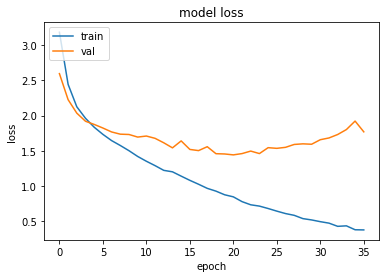

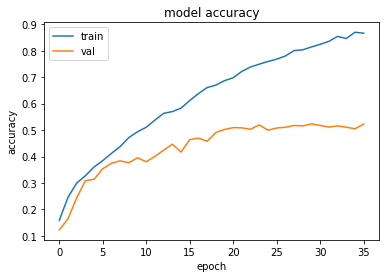

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4420565366744995 , and Val Acc happened to be 0.5091999769210815
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5232999920845032 and Val Loss happened to be  1.5929890871047974
TestLoss:  1.4181634187698364  TestAcc: 0.5109999775886536
frog 0.741
ship 0.669
truck 0.577
automobile 0.561
dog 0.527
horse 0.506
airplane 0.485
deer 0.464
cat 0.367
bird 0.213


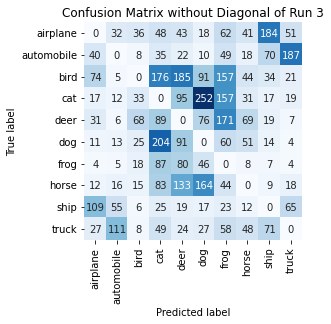

Summing down the rows, for Predictions of each Class that were wrong:  [325. 255. 217. 796. 692. 701. 781. 322. 425. 376.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  185.0 times
Summing across the columns, for total number of that True Class misidentified:  [515. 439. 787. 633. 536. 473. 259. 494. 331. 423.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

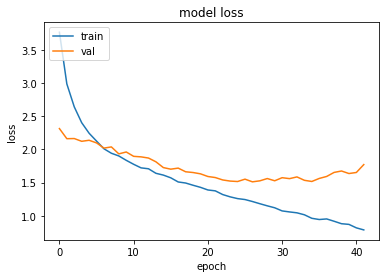

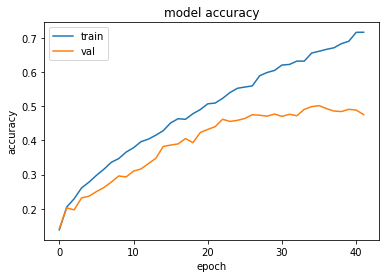

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.510553002357483 , and Val Acc happened to be 0.4749000072479248
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5013999938964844 and Val Loss happened to be  1.5616357326507568
TestLoss:  1.4927884340286255  TestAcc: 0.47380000352859497
frog 0.676
ship 0.634
truck 0.607
horse 0.573
dog 0.562
airplane 0.447
deer 0.4
automobile 0.393
cat 0.298
bird 0.148


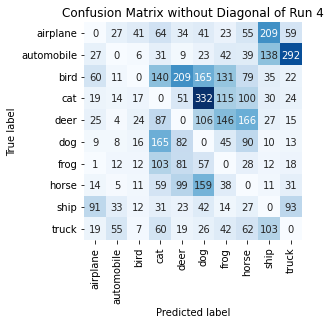

Summing down the rows, for Predictions of each Class that were wrong:  [265. 169. 146. 740. 607. 951. 596. 646. 575. 567.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  209.0 times
Summing across the columns, for total number of that True Class misidentified:  [553. 607. 852. 702. 600. 438. 324. 427. 366. 393.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  166.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   

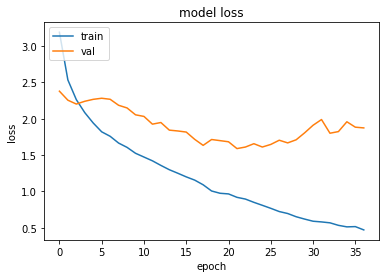

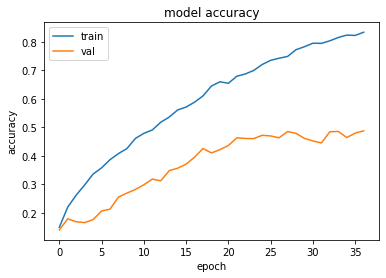

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.58881413936615 , and Val Acc happened to be 0.46320000290870667
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.4875999987125397 and Val Loss happened to be  1.8730781078338623
TestLoss:  1.5803624391555786  TestAcc: 0.45899999141693115
frog 0.59
ship 0.553
airplane 0.551
dog 0.528
horse 0.468
automobile 0.463
truck 0.456
cat 0.398
deer 0.366
bird 0.217


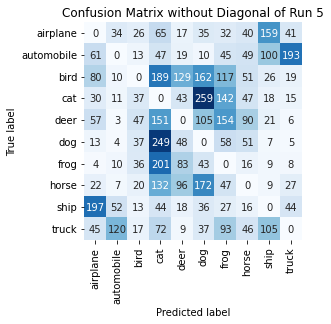

Summing down the rows, for Predictions of each Class that were wrong:  [ 509.  251.  246. 1150.  462.  859.  715.  406.  454.  358.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  129.0 times
Summing across the columns, for total number of that True Class misidentified:  [449. 537. 783. 602. 634. 472. 410. 532. 447. 544.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  154.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0

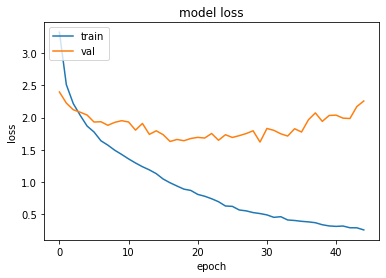

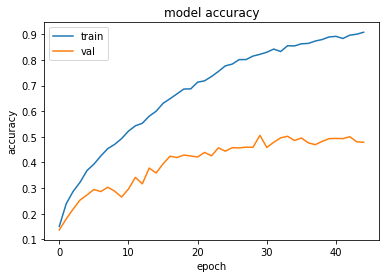

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.6205776929855347 , and Val Acc happened to be 0.5055000185966492
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5055000185966492 and Val Loss happened to be  1.6205776929855347
TestLoss:  1.5996918678283691  TestAcc: 0.4999000132083893
ship 0.732
frog 0.729
airplane 0.555
automobile 0.544
horse 0.532
truck 0.498
deer 0.433
dog 0.415
bird 0.285
cat 0.276


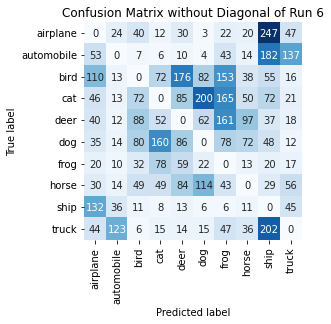

Summing down the rows, for Predictions of each Class that were wrong:  [510. 259. 385. 452. 557. 508. 718. 351. 892. 369.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [445. 456. 715. 724. 567. 585. 271. 468. 268. 502.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  161.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Bri

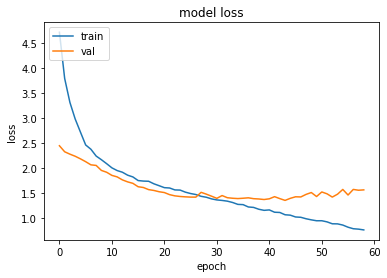

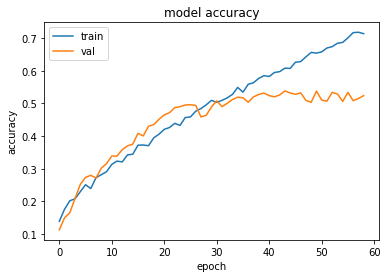

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.3547226190567017 , and Val Acc happened to be 0.5385000109672546
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5385000109672546 and Val Loss happened to be  1.3547226190567017
TestLoss:  1.3358453512191772  TestAcc: 0.534500002861023
frog 0.694
truck 0.653
ship 0.651
automobile 0.615
horse 0.558
airplane 0.523
dog 0.501
deer 0.478
bird 0.437
cat 0.235


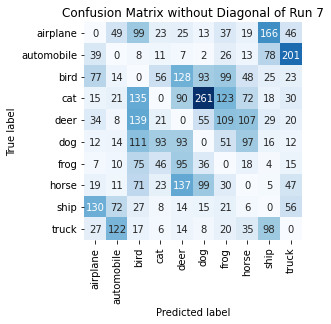

Summing down the rows, for Predictions of each Class that were wrong:  [360. 321. 682. 287. 603. 582. 516. 415. 439. 450.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  137.0 times
Summing across the columns, for total number of that True Class misidentified:  [477. 385. 563. 765. 522. 499. 306. 442. 349. 347.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  139.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0

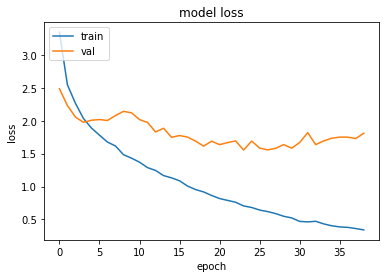

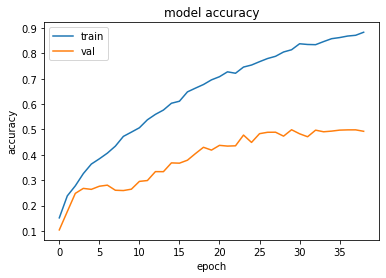

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5547802448272705 , and Val Acc happened to be 0.47780001163482666
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.49880000948905945 and Val Loss happened to be  1.5821648836135864
TestLoss:  1.532621145248413  TestAcc: 0.47780001163482666
frog 0.735
airplane 0.592
ship 0.582
deer 0.513
dog 0.505
automobile 0.477
truck 0.41
horse 0.407
bird 0.332
cat 0.225


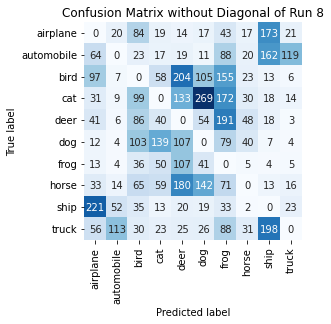

Summing down the rows, for Predictions of each Class that were wrong:  [568. 229. 561. 418. 809. 684. 920. 216. 606. 211.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  204.0 times
Summing across the columns, for total number of that True Class misidentified:  [408. 523. 668. 775. 487. 495. 265. 593. 418. 590.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  191.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

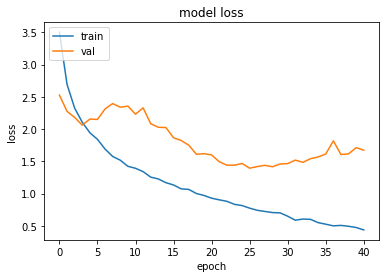

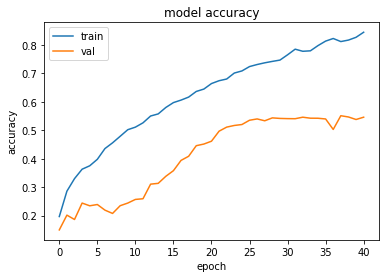

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.393627643585205 , and Val Acc happened to be 0.5353000164031982
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5511999726295471 and Val Loss happened to be  1.6051076650619507
TestLoss:  1.3748996257781982  TestAcc: 0.5351999998092651
ship 0.735
truck 0.724
frog 0.7
horse 0.566
deer 0.552
airplane 0.533
automobile 0.499
dog 0.411
cat 0.371
bird 0.261


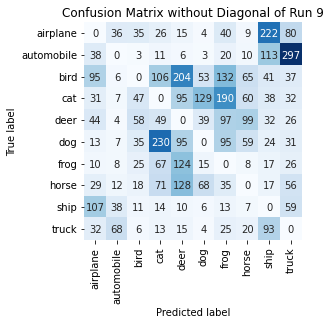

Summing down the rows, for Predictions of each Class that were wrong:  [399. 186. 238. 587. 692. 321. 647. 337. 597. 644.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  204.0 times
Summing across the columns, for total number of that True Class misidentified:  [467. 501. 739. 629. 448. 589. 300. 434. 265. 276.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  99.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

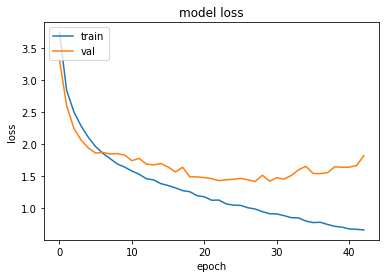

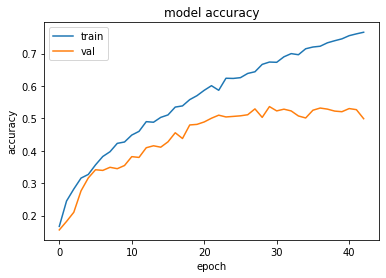

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.413034200668335 , and Val Acc happened to be 0.52920001745224
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.536300003528595 and Val Loss happened to be  1.4197297096252441
TestLoss:  1.3784089088439941  TestAcc: 0.5297999978065491
frog 0.754
truck 0.662
horse 0.612
ship 0.611
automobile 0.554
dog 0.548
airplane 0.535
deer 0.507
bird 0.271
cat 0.244


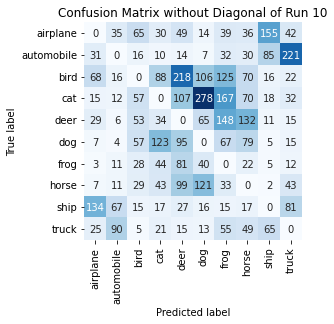

Summing down the rows, for Predictions of each Class that were wrong:  [319. 252. 325. 410. 705. 660. 681. 505. 362. 483.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  218.0 times
Summing across the columns, for total number of that True Class misidentified:  [465. 446. 729. 756. 493. 452. 246. 388. 389. 338.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  148.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

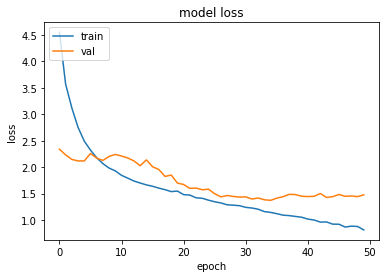

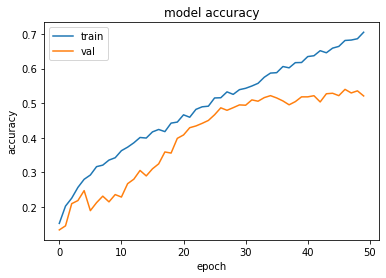

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3730055093765259 , and Val Acc happened to be 0.5217000246047974
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.539900004863739 and Val Loss happened to be  1.4493248462677002
TestLoss:  1.32624351978302  TestAcc: 0.527999997138977
frog 0.775
automobile 0.732
dog 0.621
horse 0.607
ship 0.574
truck 0.573
airplane 0.497
deer 0.406
bird 0.359
cat 0.136


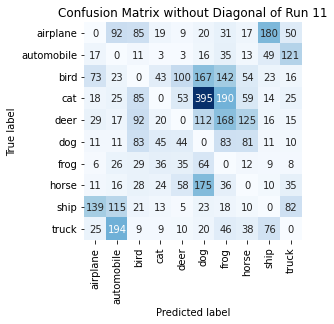

Summing down the rows, for Predictions of each Class that were wrong:  [329. 519. 443. 212. 317. 992. 749. 409. 388. 362.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  100.0 times
Summing across the columns, for total number of that True Class misidentified:  [503. 268. 641. 864. 594. 379. 225. 393. 426. 427.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  168.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16 

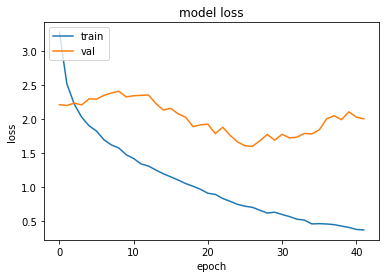

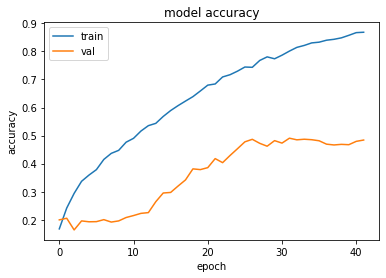

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.602063536643982 , and Val Acc happened to be 0.48669999837875366
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.49070000648498535 and Val Loss happened to be  1.7256689071655273
TestLoss:  1.5953675508499146  TestAcc: 0.48410001397132874
frog 0.746
ship 0.656
truck 0.522
airplane 0.521
automobile 0.49
dog 0.464
bird 0.45
horse 0.418
deer 0.346
cat 0.228


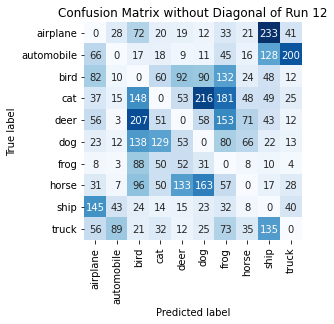

Summing down the rows, for Predictions of each Class that were wrong:  [504. 210. 811. 424. 438. 629. 786. 297. 685. 375.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  133.0 times
Summing across the columns, for total number of that True Class misidentified:  [479. 510. 550. 772. 654. 536. 254. 582. 344. 478.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  207.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.0 , 0.0 )


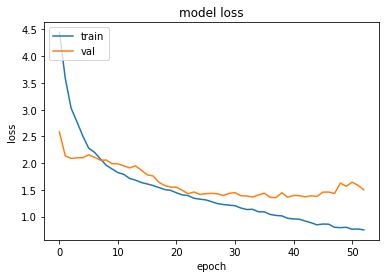

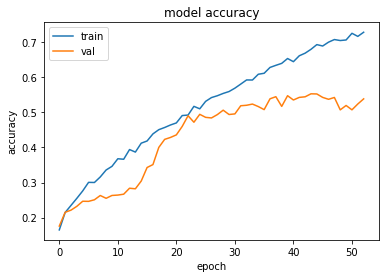

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3557013273239136 , and Val Acc happened to be 0.5443000197410583
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5525000095367432 and Val Loss happened to be  1.388716459274292
TestLoss:  1.3239827156066895  TestAcc: 0.5408999919891357
frog 0.799
ship 0.684
truck 0.672
automobile 0.661
airplane 0.571
horse 0.545
dog 0.504
deer 0.439
cat 0.301
bird 0.233


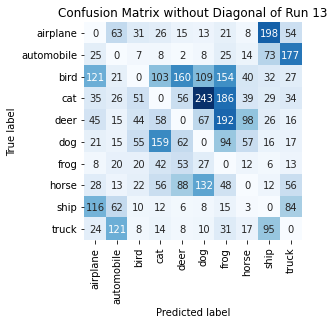

Summing down the rows, for Predictions of each Class that were wrong:  [423. 356. 248. 478. 450. 617. 766. 288. 487. 478.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  160.0 times
Summing across the columns, for total number of that True Class misidentified:  [429. 339. 767. 699. 561. 496. 201. 455. 316. 328.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

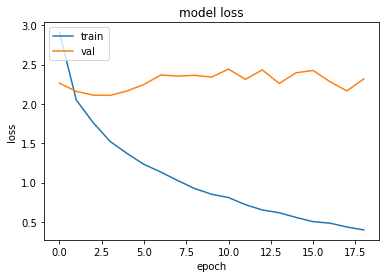

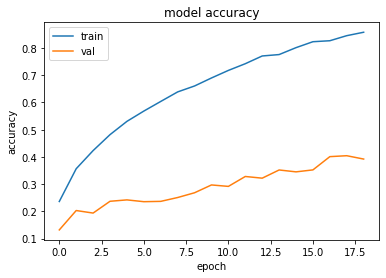

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.108429431915283 , and Val Acc happened to be 0.2370000034570694
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.4043999910354614 and Val Loss happened to be  2.1650078296661377
TestLoss:  2.100830554962158  TestAcc: 0.24240000545978546
cat 0.649
ship 0.56
dog 0.392
deer 0.329
frog 0.258
airplane 0.152
horse 0.074
truck 0.006
automobile 0.003
bird 0.001


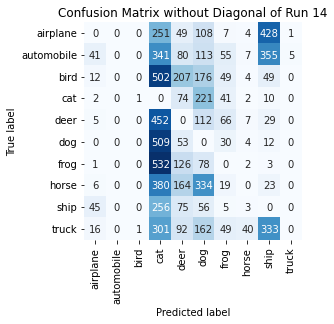

Summing down the rows, for Predictions of each Class that were wrong:  [1.280e+02 0.000e+00 2.000e+00 3.524e+03 9.200e+02 1.360e+03 3.210e+02
 7.300e+01 1.242e+03 6.000e+00]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  207.0 times
Summing across the columns, for total number of that True Class misidentified:  [848. 997. 999. 351. 671. 608. 742. 926. 440. 994.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  452.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 12

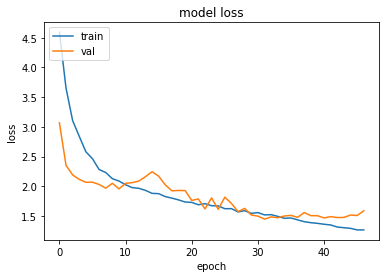

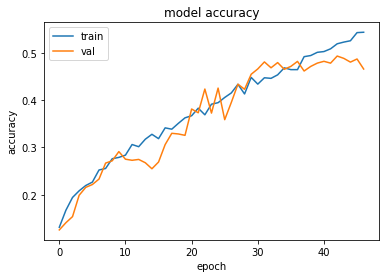

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.4471070766448975 , and Val Acc happened to be 0.4805000126361847
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.492900013923645 and Val Loss happened to be  1.4739673137664795
TestLoss:  1.4205859899520874  TestAcc: 0.4934000074863434
frog 0.67
ship 0.655
automobile 0.574
truck 0.544
dog 0.528
horse 0.509
airplane 0.494
deer 0.375
cat 0.307
bird 0.278


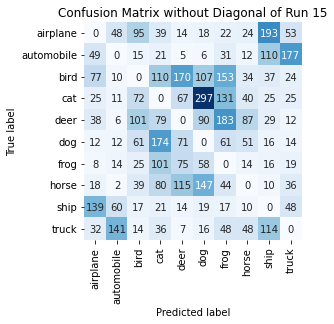

Summing down the rows, for Predictions of each Class that were wrong:  [398. 304. 439. 661. 538. 758. 690. 320. 550. 408.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [506. 426. 722. 693. 625. 472. 330. 491. 345. 456.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  183.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


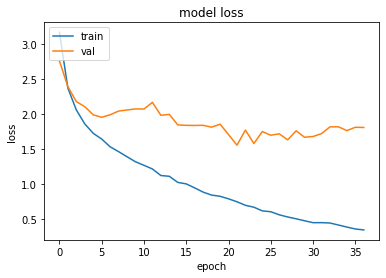

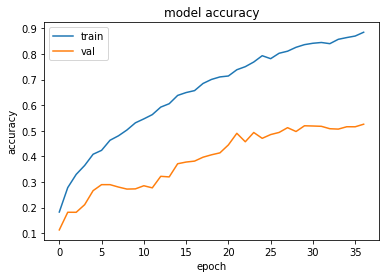

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.554747223854065 , and Val Acc happened to be 0.4900999963283539
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.525600016117096 and Val Loss happened to be  1.8076612949371338
TestLoss:  1.5372421741485596  TestAcc: 0.4925000071525574
ship 0.729
frog 0.704
truck 0.664
airplane 0.543
automobile 0.491
dog 0.467
deer 0.461
horse 0.354
cat 0.303
bird 0.209


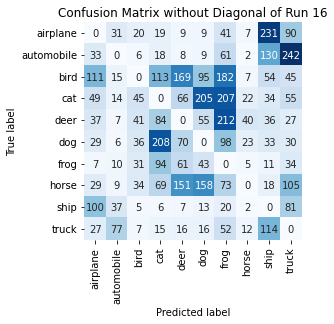

Summing down the rows, for Predictions of each Class that were wrong:  [422. 206. 225. 626. 557. 603. 946. 120. 661. 709.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  169.0 times
Summing across the columns, for total number of that True Class misidentified:  [457. 509. 791. 697. 539. 533. 296. 646. 271. 336.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  212.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

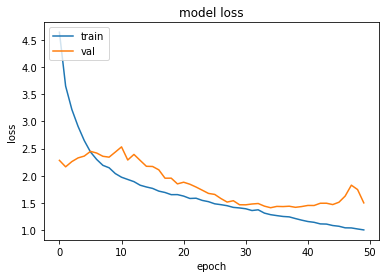

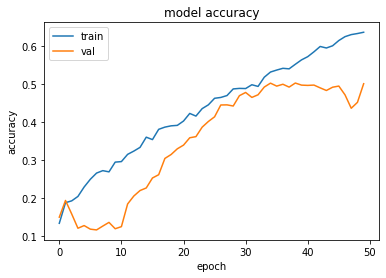

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4104927778244019 , and Val Acc happened to be 0.503000020980835
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5033000111579895 and Val Loss happened to be  1.4180673360824585
TestLoss:  1.3806525468826294  TestAcc: 0.5084999799728394
frog 0.678
truck 0.622
ship 0.614
horse 0.575
automobile 0.567
dog 0.561
airplane 0.559
deer 0.545
cat 0.184
bird 0.18


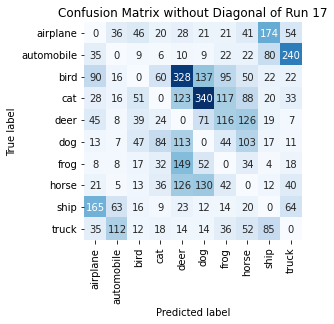

Summing down the rows, for Predictions of each Class that were wrong:  [440. 271. 250. 289. 914. 786. 507. 536. 433. 489.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  328.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 433. 820. 816. 455. 439. 322. 425. 386. 378.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  126.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

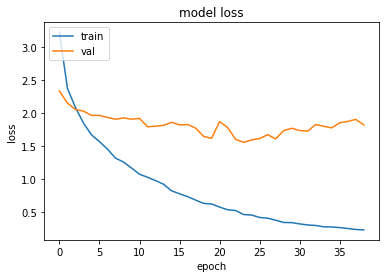

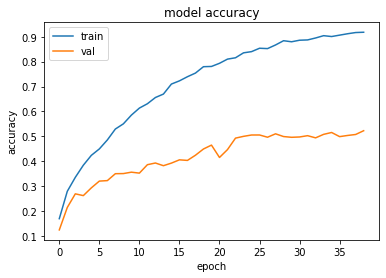

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5609897375106812 , and Val Acc happened to be 0.5001999735832214
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5228000283241272 and Val Loss happened to be  1.8260458707809448
TestLoss:  1.5127209424972534  TestAcc: 0.5038999915122986
frog 0.728
ship 0.703
truck 0.615
deer 0.537
horse 0.517
airplane 0.468
automobile 0.455
dog 0.436
cat 0.362
bird 0.218


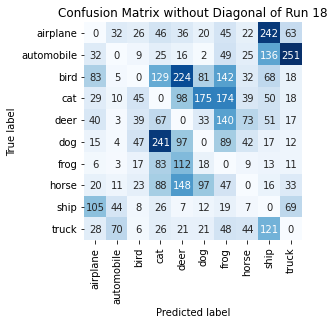

Summing down the rows, for Predictions of each Class that were wrong:  [358. 182. 220. 731. 759. 459. 753. 293. 714. 492.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  224.0 times
Summing across the columns, for total number of that True Class misidentified:  [532. 545. 782. 638. 463. 564. 272. 483. 297. 385.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  140.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

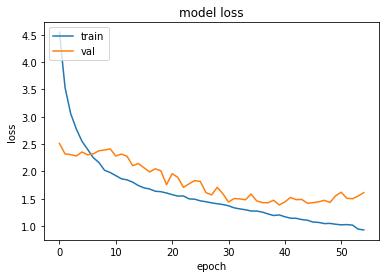

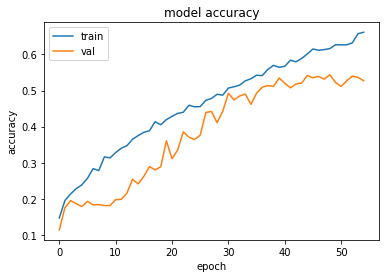

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3869725465774536 , and Val Acc happened to be 0.5346999764442444
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5437999963760376 and Val Loss happened to be  1.4317271709442139
TestLoss:  1.3543554544448853  TestAcc: 0.5379999876022339
frog 0.775
automobile 0.672
truck 0.67
ship 0.6
horse 0.57
airplane 0.537
dog 0.523
deer 0.418
bird 0.358
cat 0.257


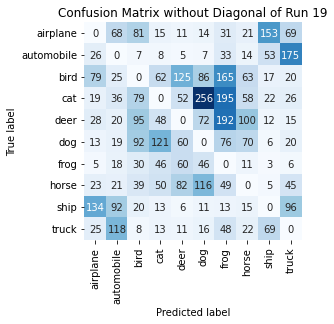

Summing down the rows, for Predictions of each Class that were wrong:  [352. 417. 451. 376. 412. 624. 802. 374. 340. 472.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [463. 328. 642. 743. 582. 477. 225. 430. 400. 330.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

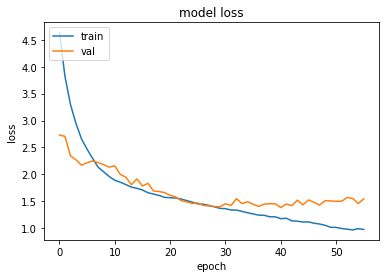

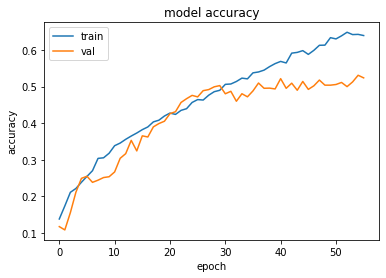

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3813555240631104 , and Val Acc happened to be 0.5216000080108643
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.5307999849319458 and Val Loss happened to be  1.4538710117340088
TestLoss:  1.3540209531784058  TestAcc: 0.5253999829292297
frog 0.79
automobile 0.645
truck 0.626
ship 0.622
dog 0.576
horse 0.555
airplane 0.516
deer 0.428
bird 0.313
cat 0.183


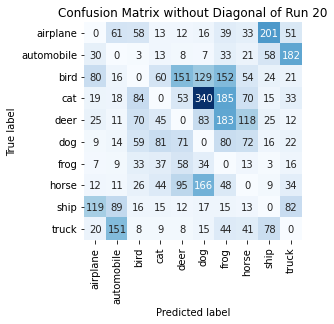

Summing down the rows, for Predictions of each Class that were wrong:  [321. 380. 357. 317. 468. 807. 779. 435. 429. 453.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  151.0 times
Summing across the columns, for total number of that True Class misidentified:  [484. 355. 687. 817. 572. 424. 210. 445. 378. 374.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  183.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

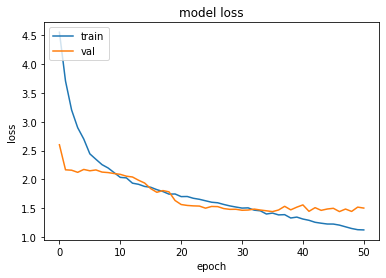

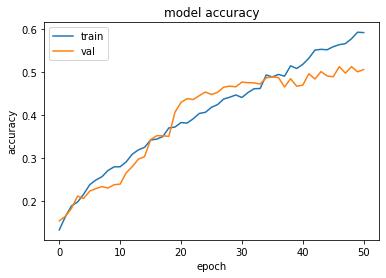

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.4408371448516846 , and Val Acc happened to be 0.4887999892234802
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5123999714851379 and Val Loss happened to be  1.4414219856262207
TestLoss:  1.420575737953186  TestAcc: 0.4893999993801117
frog 0.759
automobile 0.658
truck 0.629
ship 0.611
dog 0.532
horse 0.516
deer 0.465
airplane 0.341
bird 0.246
cat 0.137


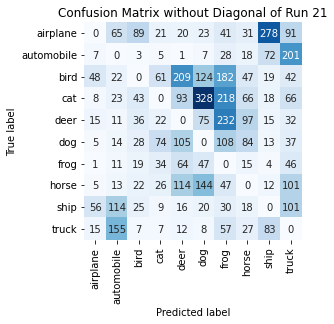

Summing down the rows, for Predictions of each Class that were wrong:  [160. 428. 272. 259. 634. 776. 943. 403. 514. 717.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  209.0 times
Summing across the columns, for total number of that True Class misidentified:  [659. 342. 754. 863. 535. 468. 241. 484. 389. 371.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  232.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

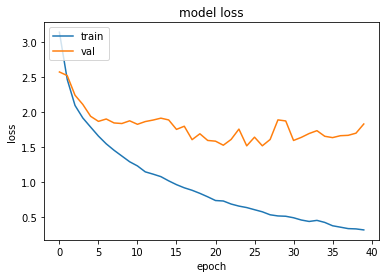

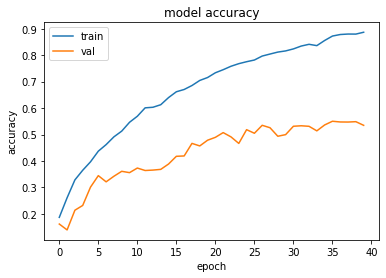

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5211254358291626 , and Val Acc happened to be 0.5184999704360962
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5503000020980835 and Val Loss happened to be  1.6387213468551636
TestLoss:  1.4886120557785034  TestAcc: 0.5325999855995178
frog 0.75
ship 0.71
truck 0.648
dog 0.549
deer 0.527
automobile 0.495
airplane 0.471
bird 0.424
horse 0.407
cat 0.345


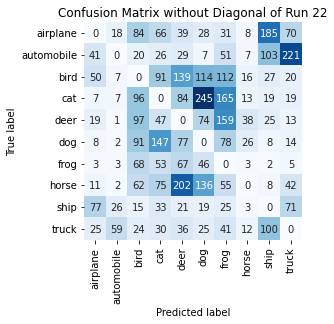

Summing down the rows, for Predictions of each Class that were wrong:  [241. 125. 557. 568. 694. 694. 717. 126. 477. 475.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [529. 505. 576. 655. 473. 451. 250. 593. 290. 352.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 , 0.08 )


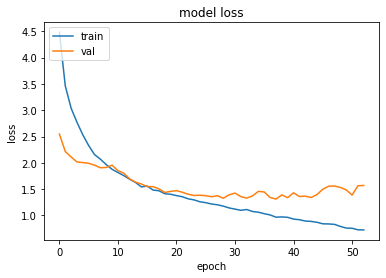

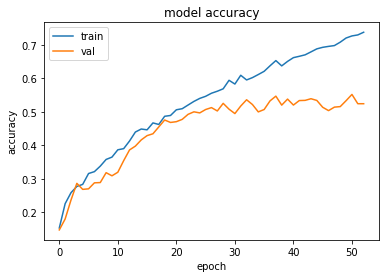

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.311069130897522 , and Val Acc happened to be 0.5467000007629395
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.551800012588501 and Val Loss happened to be  1.387152910232544
TestLoss:  1.2828449010849  TestAcc: 0.5473999977111816
frog 0.79
ship 0.678
automobile 0.642
truck 0.621
dog 0.559
deer 0.552
horse 0.537
airplane 0.536
cat 0.287
bird 0.272


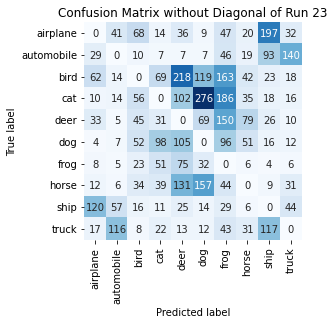

Summing down the rows, for Predictions of each Class that were wrong:  [295. 265. 312. 342. 712. 695. 804. 289. 503. 309.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  218.0 times
Summing across the columns, for total number of that True Class misidentified:  [464. 358. 728. 713. 448. 441. 210. 463. 322. 379.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  150.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

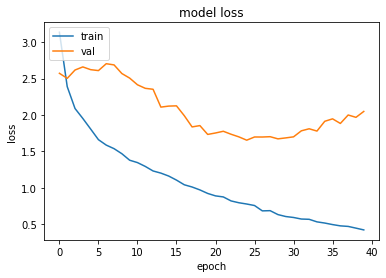

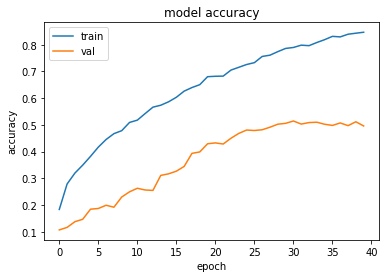

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.654384732246399 , and Val Acc happened to be 0.4805000126361847
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5144000053405762 and Val Loss happened to be  1.7003318071365356
TestLoss:  1.622968316078186  TestAcc: 0.48030000925064087
ship 0.757
frog 0.727
deer 0.622
truck 0.485
dog 0.471
horse 0.447
automobile 0.365
airplane 0.35
cat 0.298
bird 0.281


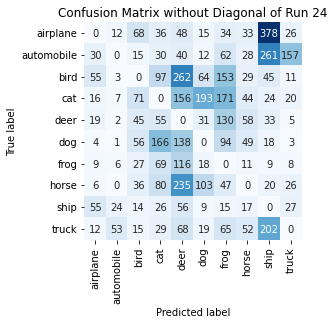

Summing down the rows, for Predictions of each Class that were wrong:  [ 206.  108.  347.  588. 1119.  464.  771.  321.  990.  283.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  262.0 times
Summing across the columns, for total number of that True Class misidentified:  [650. 635. 719. 702. 378. 529. 273. 553. 243. 515.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  130.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

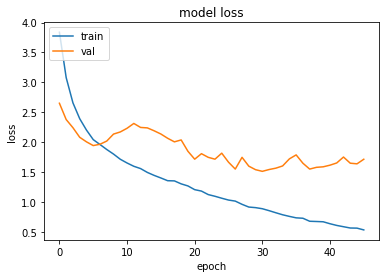

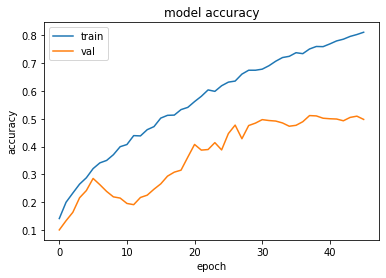

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.5112109184265137 , and Val Acc happened to be 0.49709999561309814
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5116999745368958 and Val Loss happened to be  1.5489134788513184
TestLoss:  1.48732590675354  TestAcc: 0.4952000081539154
frog 0.802
ship 0.738
automobile 0.684
dog 0.546
truck 0.533
airplane 0.467
horse 0.417
deer 0.383
cat 0.213
bird 0.169


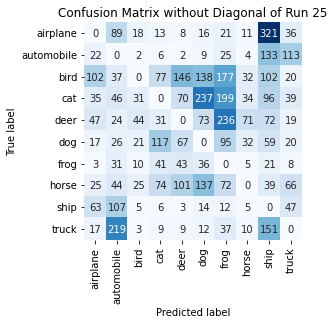

Summing down the rows, for Predictions of each Class that were wrong:  [331. 623. 159. 374. 449. 672. 874. 204. 994. 368.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  146.0 times
Summing across the columns, for total number of that True Class misidentified:  [533. 316. 831. 787. 617. 454. 198. 583. 262. 467.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  236.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

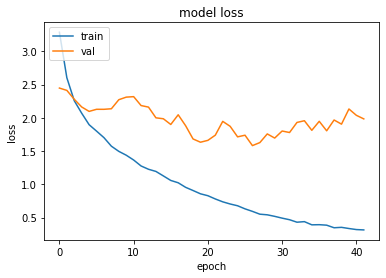

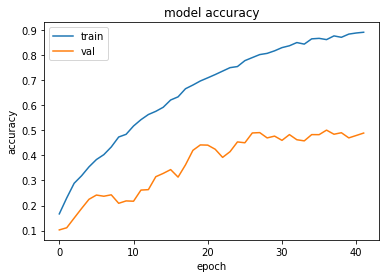

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.5820469856262207 , and Val Acc happened to be 0.48980000615119934
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5011000037193298 and Val Loss happened to be  1.8049062490463257
TestLoss:  1.5735325813293457  TestAcc: 0.5012999773025513
frog 0.801
ship 0.671
truck 0.624
automobile 0.616
airplane 0.489
dog 0.462
horse 0.453
deer 0.369
bird 0.312
cat 0.216


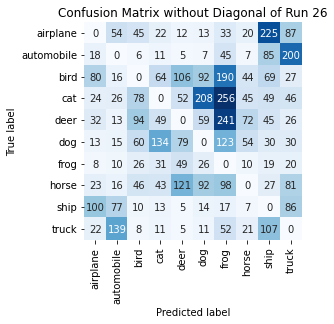

Summing down the rows, for Predictions of each Class that were wrong:  [ 320.  366.  373.  378.  434.  522. 1055.  280.  656.  603.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  121.0 times
Summing across the columns, for total number of that True Class misidentified:  [511. 384. 688. 784. 631. 538. 199. 547. 329. 376.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  241.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

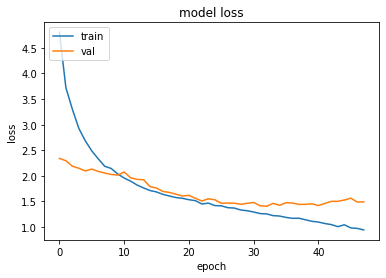

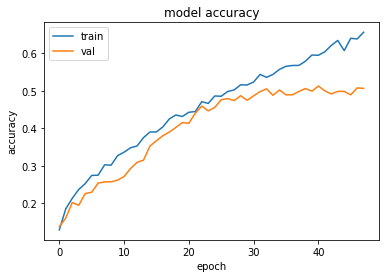

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.4064011573791504 , and Val Acc happened to be 0.505299985408783
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5127000212669373 and Val Loss happened to be  1.420640230178833
TestLoss:  1.3897393941879272  TestAcc: 0.5056999921798706
frog 0.679
ship 0.633
truck 0.63
dog 0.605
automobile 0.572
airplane 0.534
horse 0.511
deer 0.425
bird 0.274
cat 0.194


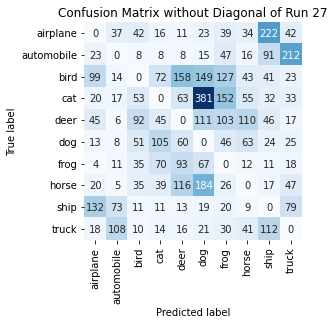

Summing down the rows, for Predictions of each Class that were wrong:  [374. 279. 337. 380. 538. 970. 590. 383. 596. 496.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  158.0 times
Summing across the columns, for total number of that True Class misidentified:  [466. 428. 726. 806. 575. 395. 321. 489. 367. 370.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  111.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

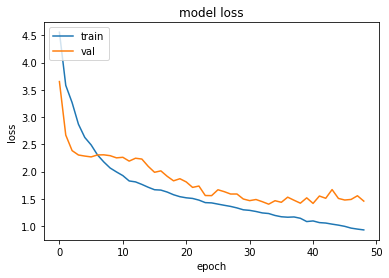

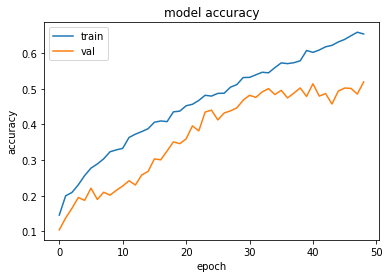

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.4024858474731445 , and Val Acc happened to be 0.5004000067710876
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5189999938011169 and Val Loss happened to be  1.4585362672805786
TestLoss:  1.3931554555892944  TestAcc: 0.5005000233650208
frog 0.767
truck 0.689
ship 0.561
dog 0.546
airplane 0.536
deer 0.529
horse 0.505
automobile 0.464
bird 0.292
cat 0.116


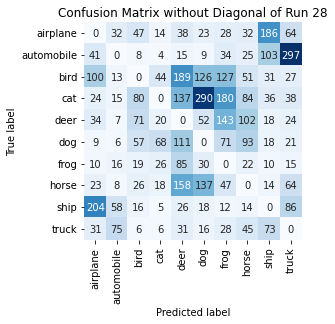

Summing down the rows, for Predictions of each Class that were wrong:  [476. 230. 330. 205. 790. 701. 670. 468. 489. 636.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [464. 536. 708. 884. 471. 454. 233. 495. 439. 311.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  143.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


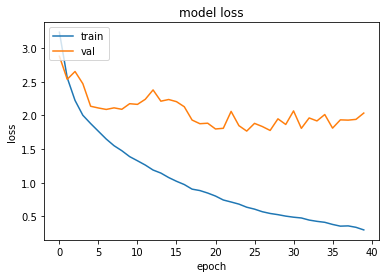

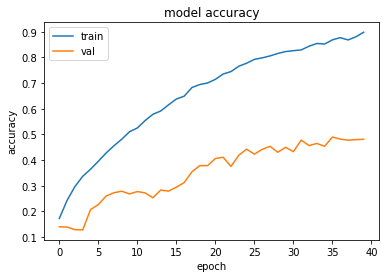

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.7683230638504028 , and Val Acc happened to be 0.4424000084400177
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.48969998955726624 and Val Loss happened to be  1.8122907876968384
TestLoss:  1.747907042503357  TestAcc: 0.4422999918460846
frog 0.771
ship 0.747
airplane 0.56
truck 0.456
automobile 0.361
bird 0.36
dog 0.33
deer 0.329
horse 0.257
cat 0.252


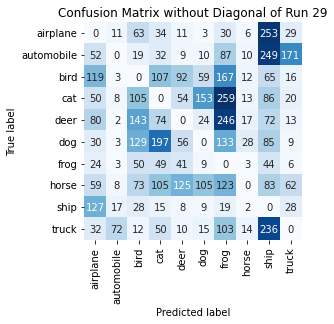

Summing down the rows, for Predictions of each Class that were wrong:  [ 573.  127.  622.  663.  406.  387. 1167.  105. 1173.  354.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [440. 639. 640. 748. 671. 670. 229. 743. 253. 544.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  246.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.1

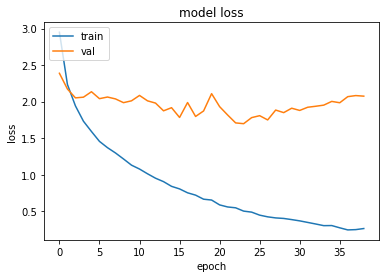

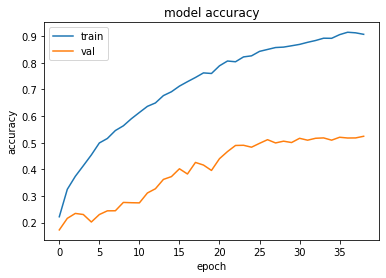

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6985353231430054 , and Val Acc happened to be 0.4902999997138977
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5241000056266785 and Val Loss happened to be  2.0752077102661133
TestLoss:  1.6553245782852173  TestAcc: 0.4948999881744385
ship 0.759
frog 0.697
automobile 0.594
horse 0.568
airplane 0.56
truck 0.472
deer 0.47
cat 0.335
dog 0.315
bird 0.179


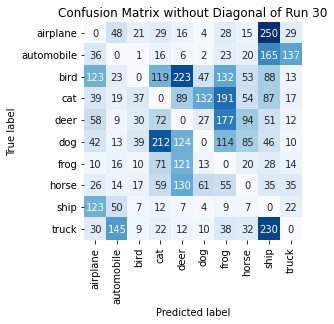

Summing down the rows, for Predictions of each Class that were wrong:  [487. 337. 171. 612. 728. 300. 767. 380. 980. 289.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  223.0 times
Summing across the columns, for total number of that True Class misidentified:  [440. 406. 821. 665. 530. 685. 303. 432. 241. 528.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  177.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

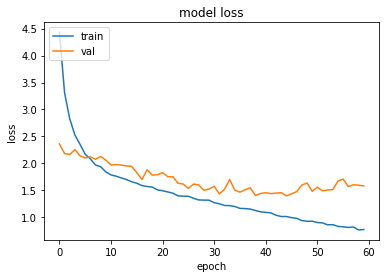

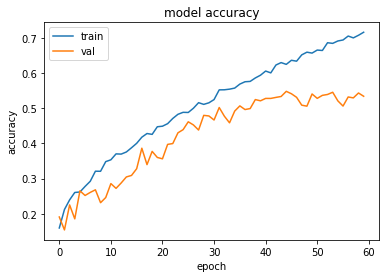

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  44 when  Val Loss was:  1.3982735872268677 , and Val Acc happened to be 0.5475999712944031
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5475999712944031 and Val Loss happened to be  1.3982735872268677
TestLoss:  1.3655107021331787  TestAcc: 0.5519999861717224
frog 0.723
automobile 0.696
ship 0.695
horse 0.608
truck 0.602
dog 0.555
deer 0.521
airplane 0.49
bird 0.335
cat 0.295


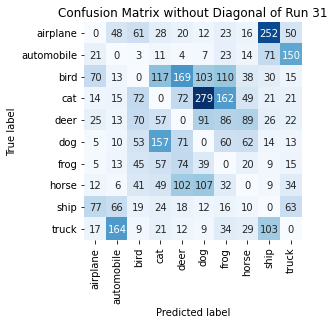

Summing down the rows, for Predictions of each Class that were wrong:  [246. 348. 373. 521. 542. 659. 546. 327. 535. 383.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  169.0 times
Summing across the columns, for total number of that True Class misidentified:  [510. 304. 665. 705. 479. 445. 277. 392. 305. 398.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  91.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )


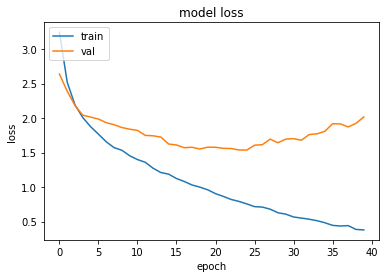

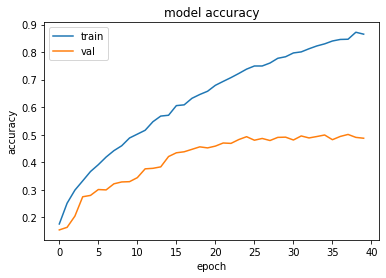

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5357091426849365 , and Val Acc happened to be 0.4927000105381012
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5008999705314636 and Val Loss happened to be  1.871930718421936
TestLoss:  1.5148502588272095  TestAcc: 0.4950999915599823
frog 0.642
truck 0.617
ship 0.583
horse 0.507
deer 0.499
dog 0.495
airplane 0.489
automobile 0.479
bird 0.344
cat 0.296


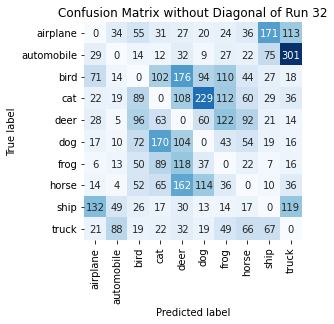

Summing down the rows, for Predictions of each Class that were wrong:  [340. 236. 473. 571. 789. 595. 537. 413. 426. 669.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [511. 521. 656. 704. 501. 505. 358. 493. 417. 383.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  122.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    

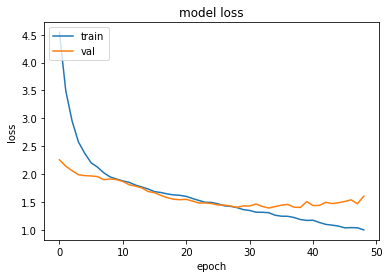

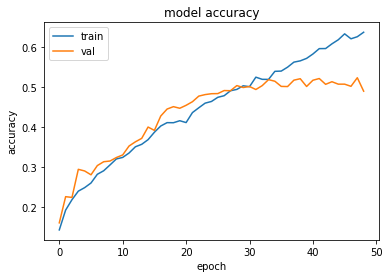

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3890912532806396 , and Val Acc happened to be 0.5185999870300293
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5234000086784363 and Val Loss happened to be  1.4661669731140137
TestLoss:  1.361074686050415  TestAcc: 0.5120000243186951
frog 0.757
automobile 0.687
ship 0.579
truck 0.575
horse 0.556
airplane 0.504
dog 0.476
deer 0.414
cat 0.291
bird 0.281


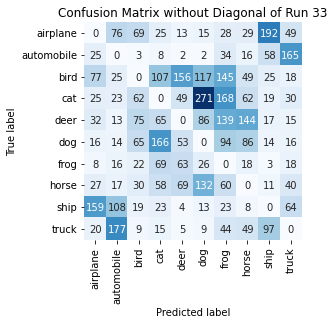

Summing down the rows, for Predictions of each Class that were wrong:  [389. 469. 354. 536. 414. 671. 735. 461. 436. 415.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  156.0 times
Summing across the columns, for total number of that True Class misidentified:  [496. 313. 719. 709. 586. 524. 243. 444. 421. 425.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  144.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

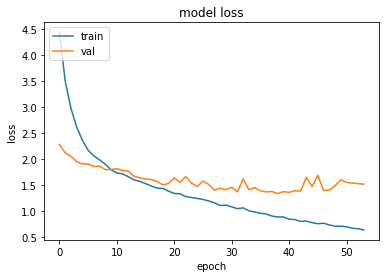

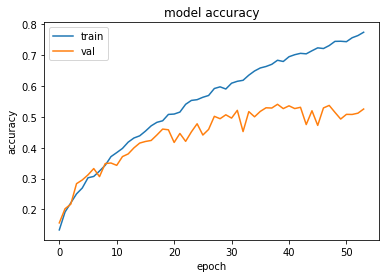

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3358596563339233 , and Val Acc happened to be 0.5406000018119812
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5406000018119812 and Val Loss happened to be  1.3358596563339233
TestLoss:  1.3151782751083374  TestAcc: 0.5436000227928162
frog 0.731
automobile 0.687
truck 0.639
dog 0.634
airplane 0.586
horse 0.583
ship 0.546
deer 0.476
bird 0.279
cat 0.275


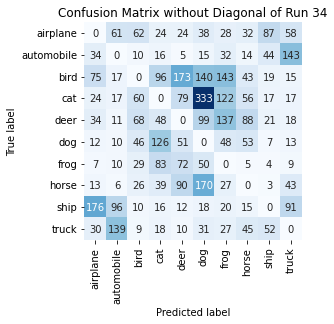

Summing down the rows, for Predictions of each Class that were wrong:  [405. 367. 320. 466. 516. 894. 584. 351. 254. 407.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [414. 313. 721. 725. 524. 366. 269. 417. 454. 361.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  137.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

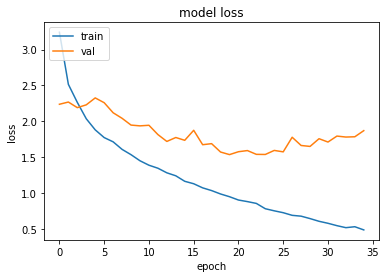

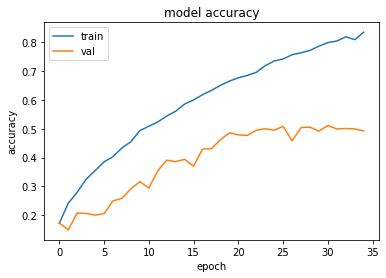

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.533644199371338 , and Val Acc happened to be 0.48590001463890076
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5113999843597412 and Val Loss happened to be  1.7091439962387085
TestLoss:  1.5037835836410522  TestAcc: 0.4893999993801117
ship 0.769
frog 0.668
truck 0.601
deer 0.536
automobile 0.522
dog 0.472
airplane 0.398
cat 0.32
horse 0.308
bird 0.3


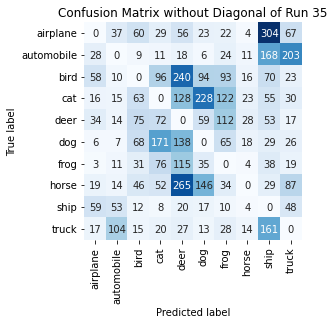

Summing down the rows, for Predictions of each Class that were wrong:  [ 240.  265.  379.  535. 1007.  621.  510.  122.  907.  520.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  265.0 times
Summing across the columns, for total number of that True Class misidentified:  [602. 478. 700. 680. 464. 528. 332. 692. 231. 399.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  112.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

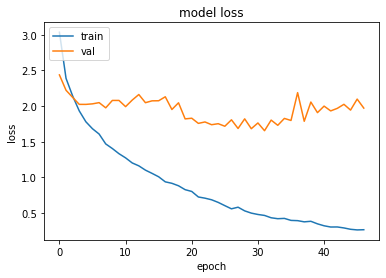

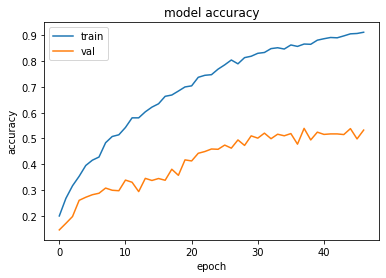

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.6543388366699219 , and Val Acc happened to be 0.520799994468689
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5393000245094299 and Val Loss happened to be  1.7864797115325928
TestLoss:  1.625424861907959  TestAcc: 0.5200999975204468
ship 0.659
frog 0.619
airplane 0.609
horse 0.578
truck 0.554
automobile 0.512
dog 0.481
deer 0.469
cat 0.46
bird 0.26


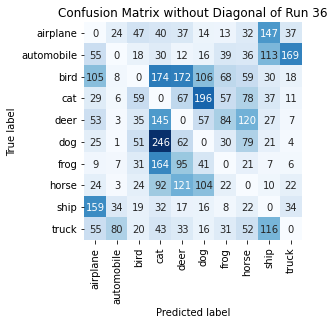

Summing down the rows, for Predictions of each Class that were wrong:  [514. 166. 304. 966. 616. 566. 352. 499. 508. 308.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  172.0 times
Summing across the columns, for total number of that True Class misidentified:  [391. 488. 740. 540. 531. 519. 381. 422. 341. 446.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  145.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0

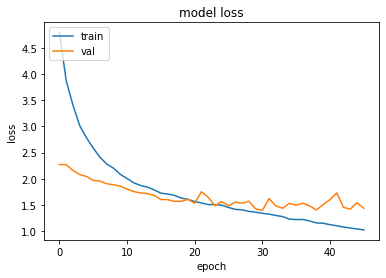

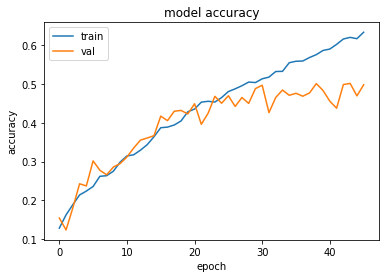

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.3978021144866943 , and Val Acc happened to be 0.49639999866485596
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5012000203132629 and Val Loss happened to be  1.421237826347351
TestLoss:  1.3798236846923828  TestAcc: 0.49709999561309814
truck 0.696
frog 0.647
ship 0.593
horse 0.54
airplane 0.503
automobile 0.49
deer 0.49
dog 0.459
bird 0.294
cat 0.259


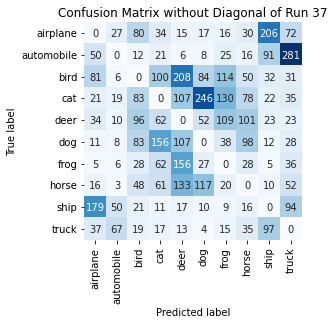

Summing down the rows, for Predictions of each Class that were wrong:  [434. 196. 470. 524. 762. 565. 476. 452. 498. 652.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  208.0 times
Summing across the columns, for total number of that True Class misidentified:  [497. 510. 706. 741. 510. 541. 353. 460. 407. 304.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  109.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

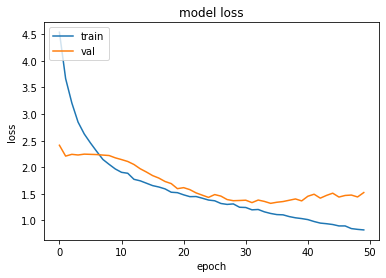

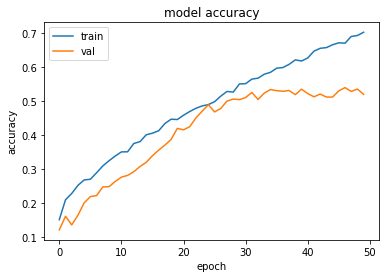

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3222970962524414 , and Val Acc happened to be 0.5331000089645386
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5389000177383423 and Val Loss happened to be  1.470547080039978
TestLoss:  1.3020834922790527  TestAcc: 0.5329999923706055
ship 0.693
truck 0.683
frog 0.639
dog 0.636
horse 0.605
deer 0.569
automobile 0.547
airplane 0.482
bird 0.282
cat 0.194


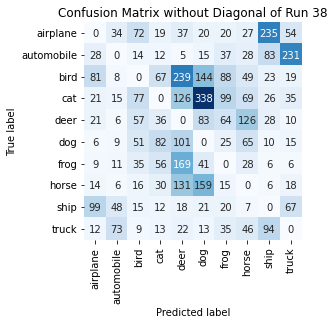

Summing down the rows, for Predictions of each Class that were wrong:  [291. 210. 346. 327. 848. 834. 403. 445. 511. 455.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  239.0 times
Summing across the columns, for total number of that True Class misidentified:  [518. 453. 718. 806. 431. 364. 361. 395. 307. 317.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  126.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

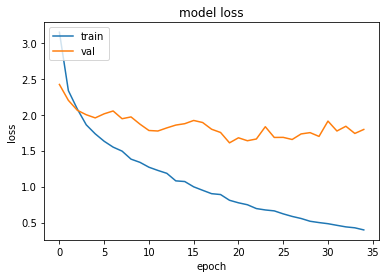

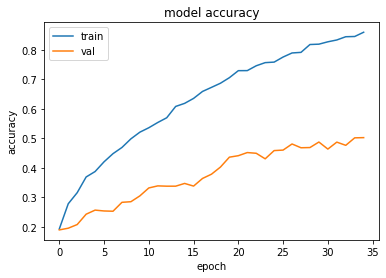

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.608487606048584 , and Val Acc happened to be 0.4361000061035156
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5023000240325928 and Val Loss happened to be  1.7945095300674438
TestLoss:  1.5982260704040527  TestAcc: 0.4449000060558319
ship 0.813
frog 0.798
deer 0.503
airplane 0.479
horse 0.429
automobile 0.423
truck 0.317
cat 0.308
dog 0.228
bird 0.151


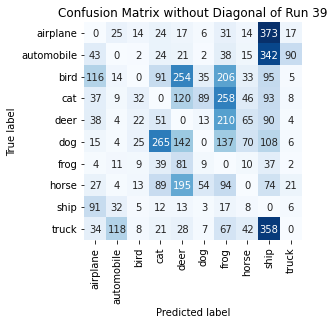

Summing down the rows, for Predictions of each Class that were wrong:  [ 405.  221.  130.  616.  871.  218. 1058.  303. 1570.  159.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  254.0 times
Summing across the columns, for total number of that True Class misidentified:  [521. 577. 849. 692. 497. 772. 202. 571. 187. 683.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  210.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

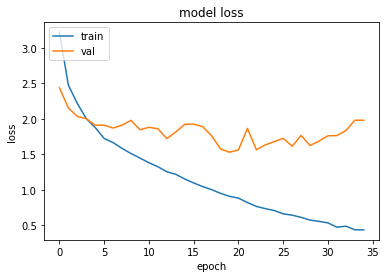

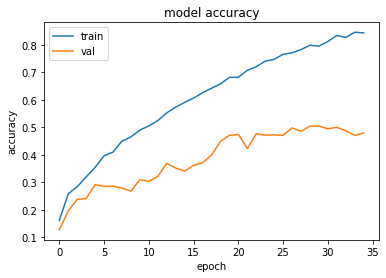

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.5302807092666626 , and Val Acc happened to be 0.4708000123500824
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5047000050544739 and Val Loss happened to be  1.686773419380188
TestLoss:  1.5056246519088745  TestAcc: 0.47760000824928284
frog 0.844
truck 0.57
deer 0.536
ship 0.535
automobile 0.507
airplane 0.49
dog 0.484
horse 0.472
bird 0.204
cat 0.134


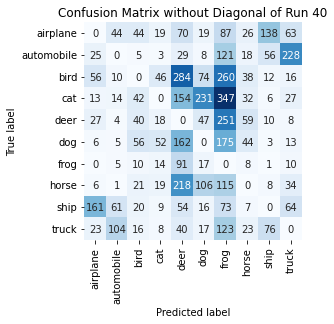

Summing down the rows, for Predictions of each Class that were wrong:  [ 317.  248.  254.  188. 1102.  535. 1552.  255.  310.  463.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  284.0 times
Summing across the columns, for total number of that True Class misidentified:  [510. 493. 796. 866. 464. 516. 156. 528. 465. 430.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  251.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

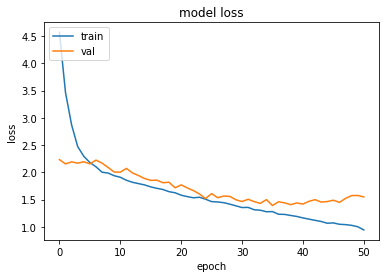

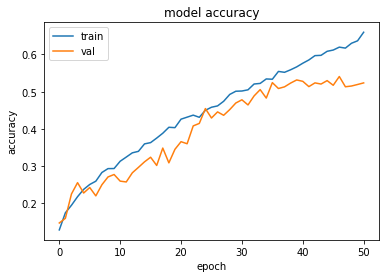

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3895821571350098 , and Val Acc happened to be 0.5242999792098999
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5407000184059143 and Val Loss happened to be  1.4470523595809937
TestLoss:  1.3414125442504883  TestAcc: 0.5353999733924866
frog 0.701
truck 0.684
ship 0.662
horse 0.632
deer 0.587
automobile 0.544
airplane 0.543
dog 0.5
bird 0.255
cat 0.246


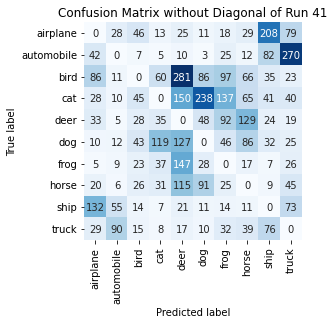

Summing down the rows, for Predictions of each Class that were wrong:  [385. 226. 247. 315. 893. 526. 486. 454. 514. 600.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  281.0 times
Summing across the columns, for total number of that True Class misidentified:  [457. 456. 745. 754. 413. 500. 299. 368. 338. 316.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  129.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.1

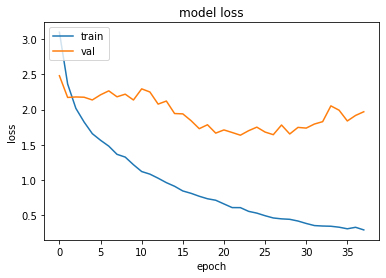

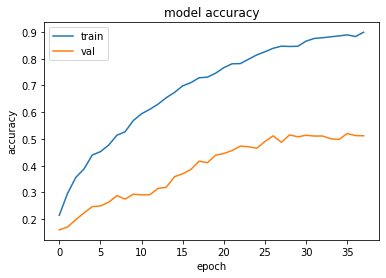

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.6356595754623413 , and Val Acc happened to be 0.4733000099658966
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5205000042915344 and Val Loss happened to be  1.8377095460891724
TestLoss:  1.610980749130249  TestAcc: 0.48089998960494995
frog 0.826
ship 0.811
truck 0.485
horse 0.477
airplane 0.405
cat 0.403
deer 0.398
dog 0.373
bird 0.326
automobile 0.305


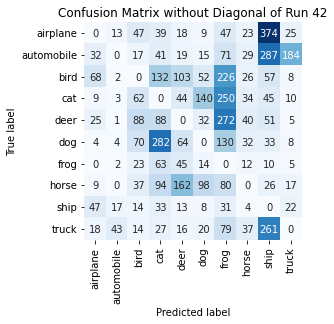

Summing down the rows, for Predictions of each Class that were wrong:  [ 212.   85.  372.  799.  484.  388. 1186.  237. 1144.  284.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  162.0 times
Summing across the columns, for total number of that True Class misidentified:  [595. 695. 674. 597. 602. 627. 174. 523. 189. 515.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  272.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

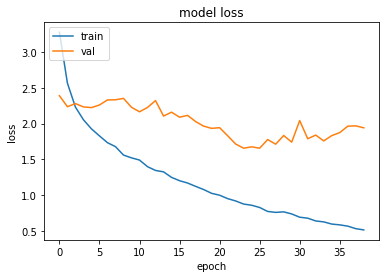

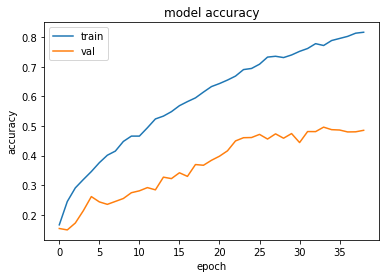

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6554919481277466 , and Val Acc happened to be 0.4603999853134155
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.4961000084877014 and Val Loss happened to be  1.7573957443237305
TestLoss:  1.6394542455673218  TestAcc: 0.4636000096797943
ship 0.677
frog 0.605
dog 0.578
airplane 0.544
truck 0.537
deer 0.477
automobile 0.326
horse 0.324
bird 0.315
cat 0.253


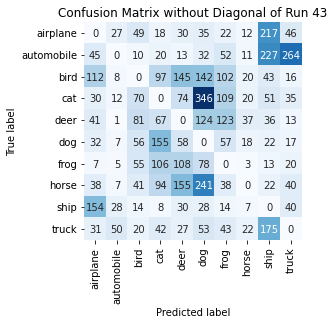

Summing down the rows, for Predictions of each Class that were wrong:  [ 490.  145.  396.  607.  640. 1079.  560.  150.  806.  491.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [456. 674. 685. 747. 523. 422. 395. 676. 323. 463.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  124.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0

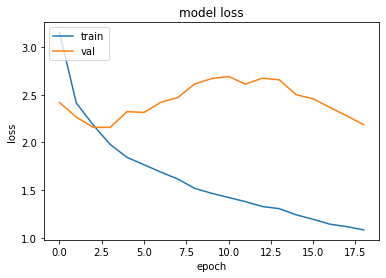

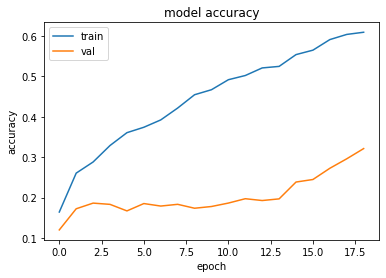

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.157780647277832 , and Val Acc happened to be 0.18299999833106995
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.32120001316070557 and Val Loss happened to be  2.185220956802368
TestLoss:  2.1498215198516846  TestAcc: 0.18790000677108765
dog 0.759
frog 0.354
ship 0.301
cat 0.217
horse 0.113
automobile 0.053
deer 0.042
airplane 0.022
bird 0.011
truck 0.007


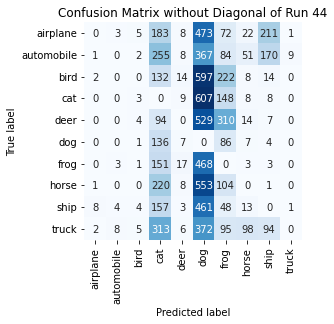

Summing down the rows, for Predictions of each Class that were wrong:  [  14.   18.   25. 1641.   80. 4427. 1169.  224.  512.   11.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  17.0 times
Summing across the columns, for total number of that True Class misidentified:  [978. 947. 989. 783. 958. 241. 646. 887. 699. 993.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  529.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


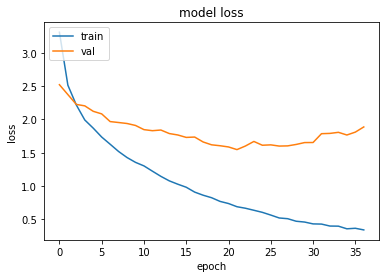

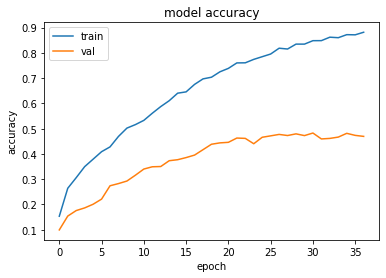

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5471948385238647 , and Val Acc happened to be 0.46299999952316284
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.4828999936580658 and Val Loss happened to be  1.6538234949111938
TestLoss:  1.516296625137329  TestAcc: 0.4666999876499176
frog 0.703
truck 0.692
ship 0.656
dog 0.532
airplane 0.509
deer 0.48
automobile 0.396
horse 0.326
bird 0.199
cat 0.174


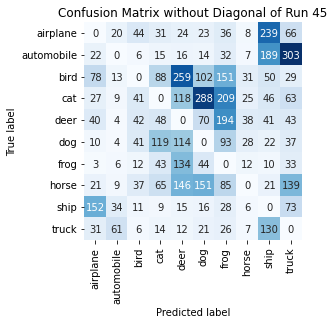

Summing down the rows, for Predictions of each Class that were wrong:  [384. 160. 240. 432. 838. 729. 854. 162. 748. 786.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  259.0 times
Summing across the columns, for total number of that True Class misidentified:  [491. 604. 801. 826. 520. 468. 297. 674. 344. 308.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  194.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

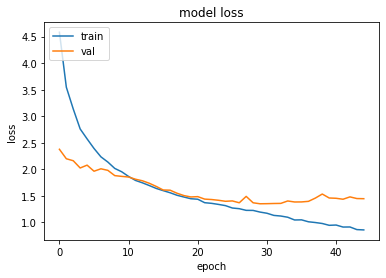

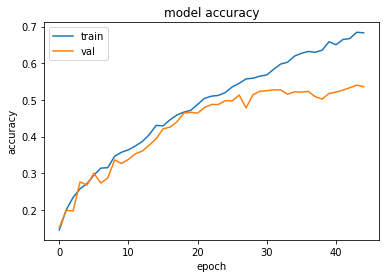

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.3515150547027588 , and Val Acc happened to be 0.5235999822616577
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5403000116348267 and Val Loss happened to be  1.4498180150985718
TestLoss:  1.3103327751159668  TestAcc: 0.5336999893188477
frog 0.786
automobile 0.713
ship 0.648
truck 0.638
airplane 0.567
horse 0.544
dog 0.498
deer 0.457
bird 0.271
cat 0.215


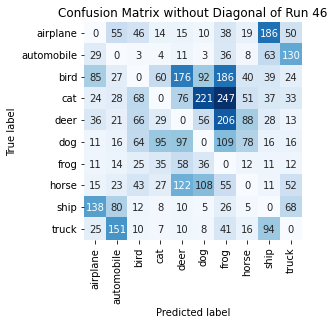

Summing down the rows, for Predictions of each Class that were wrong:  [374. 415. 337. 279. 575. 539. 944. 317. 485. 398.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [433. 287. 729. 785. 543. 502. 214. 456. 352. 362.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  206.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

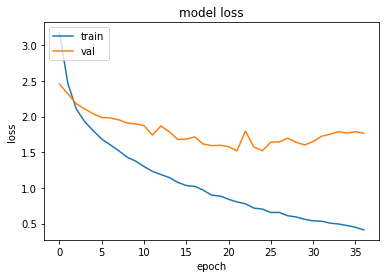

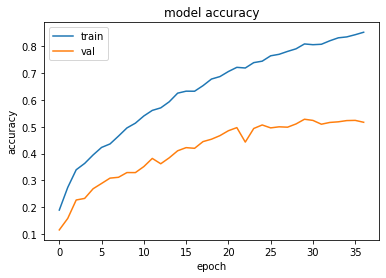

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5188912153244019 , and Val Acc happened to be 0.4968000054359436
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.527999997138977 and Val Loss happened to be  1.6019542217254639
TestLoss:  1.5035911798477173  TestAcc: 0.5063999891281128
frog 0.786
ship 0.715
automobile 0.604
deer 0.573
airplane 0.534
truck 0.471
dog 0.457
horse 0.431
cat 0.302
bird 0.191


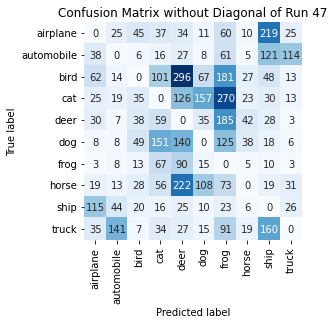

Summing down the rows, for Predictions of each Class that were wrong:  [ 335.  279.  241.  537.  987.  426. 1069.  175.  653.  234.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  296.0 times
Summing across the columns, for total number of that True Class misidentified:  [466. 396. 809. 698. 427. 543. 214. 569. 285. 529.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  185.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16

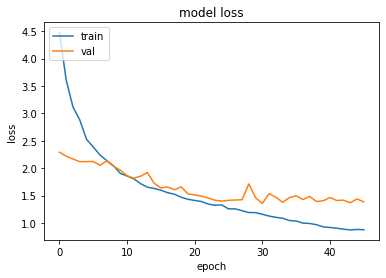

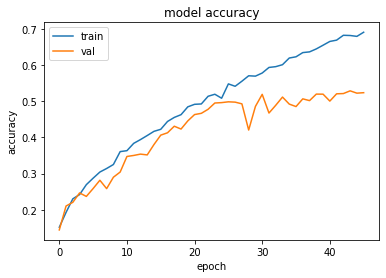

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.3583325147628784 , and Val Acc happened to be 0.5187000036239624
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5284000039100647 and Val Loss happened to be  1.369471549987793
TestLoss:  1.336899995803833  TestAcc: 0.5181999802589417
ship 0.756
truck 0.711
frog 0.654
horse 0.619
deer 0.51
automobile 0.476
dog 0.474
airplane 0.464
cat 0.343
bird 0.175


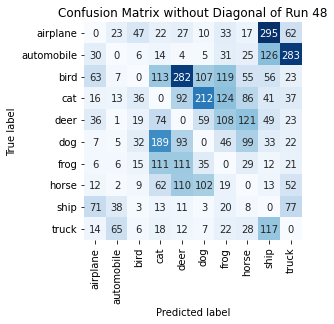

Summing down the rows, for Predictions of each Class that were wrong:  [255. 160. 173. 616. 742. 540. 522. 468. 742. 600.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  282.0 times
Summing across the columns, for total number of that True Class misidentified:  [536. 524. 825. 657. 490. 526. 346. 381. 244. 289.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  121.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

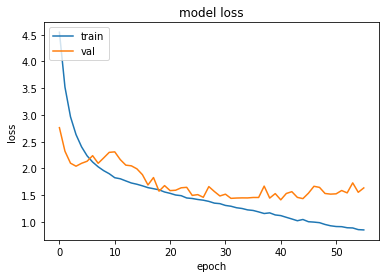

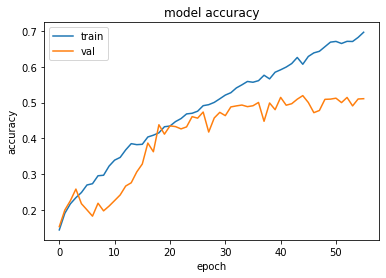

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.4137698411941528 , and Val Acc happened to be 0.5144000053405762
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5192999839782715 and Val Loss happened to be  1.436537742614746
TestLoss:  1.3910692930221558  TestAcc: 0.5109999775886536
frog 0.821
ship 0.668
truck 0.641
automobile 0.6
deer 0.541
horse 0.503
airplane 0.478
dog 0.448
bird 0.256
cat 0.154


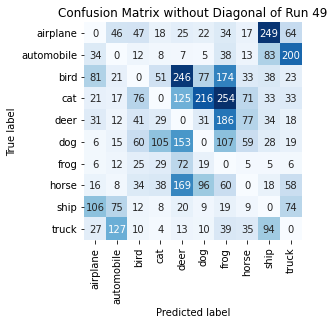

Summing down the rows, for Predictions of each Class that were wrong:  [328. 333. 317. 290. 830. 485. 911. 319. 582. 495.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  246.0 times
Summing across the columns, for total number of that True Class misidentified:  [522. 400. 744. 846. 459. 552. 179. 497. 332. 359.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  186.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

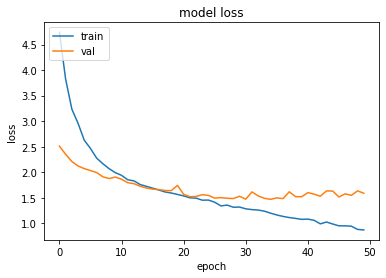

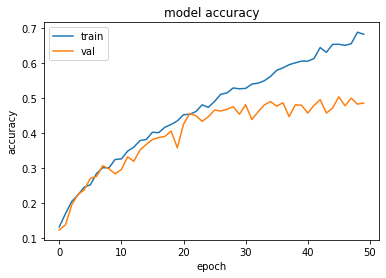

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4683754444122314 , and Val Acc happened to be 0.4896000027656555
Additionally, the best val acc epoch happened to be  45 when val acc was:  0.5034000277519226 and Val Loss happened to be  1.5144333839416504
TestLoss:  1.4553418159484863  TestAcc: 0.48590001463890076
dog 0.642
truck 0.626
ship 0.594
frog 0.591
automobile 0.556
airplane 0.431
horse 0.426
deer 0.383
cat 0.346
bird 0.264


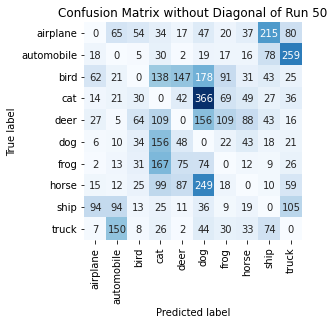

Summing down the rows, for Predictions of each Class that were wrong:  [ 245.  391.  264.  784.  431. 1169.  385.  328.  517.  627.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [569. 444. 736. 654. 617. 358. 409. 574. 406. 374.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  156.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 11 November 2021 20:08:02  (subtract ~5-hours for local Hour), and file is called  runs_GroupC_final.pkl


In [ ]:
#@title Group C: 51 Run Results
run_through_runs(ds=make_unbatched(train_C),  ds_noalb= train_C_noalb, dstitle="C" , showpictures= False)


filename will be:  runs_GroupD .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


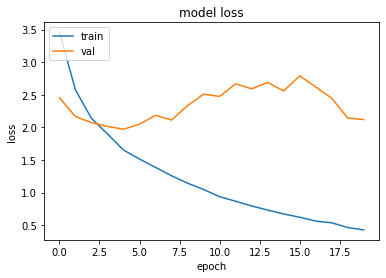

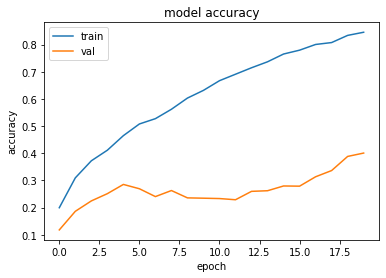

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.9714367389678955 , and Val Acc happened to be 0.2849999964237213
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.40049999952316284 and Val Loss happened to be  2.120091438293457
TestLoss:  1.9614564180374146  TestAcc: 0.2809999883174896
ship 0.852
frog 0.797
airplane 0.279
cat 0.224
bird 0.218
horse 0.216
deer 0.139
dog 0.06
truck 0.013
automobile 0.012


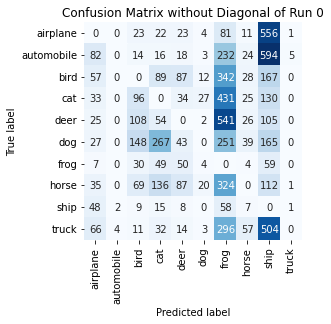

Summing down the rows, for Predictions of each Class that were wrong:  [ 380.    6.  508.  680.  364.   75. 2556.  221. 2392.    8.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [721. 988. 782. 776. 861. 940. 203. 784. 148. 987.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  541.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   

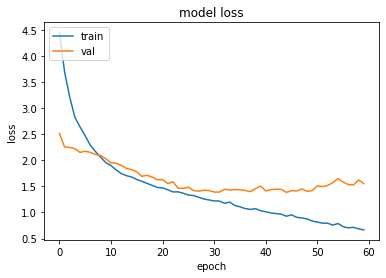

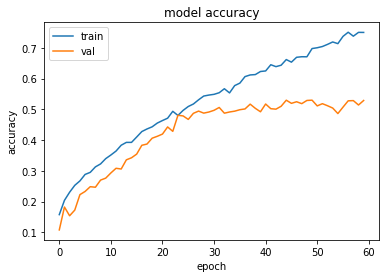

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  44 when  Val Loss was:  1.3844724893569946 , and Val Acc happened to be 0.529699981212616
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5297999978065491 and Val Loss happened to be  1.4181435108184814
TestLoss:  1.3960767984390259  TestAcc: 0.5228999853134155
frog 0.702
automobile 0.689
ship 0.679
airplane 0.533
horse 0.527
dog 0.52
bird 0.499
truck 0.481
deer 0.357
cat 0.242


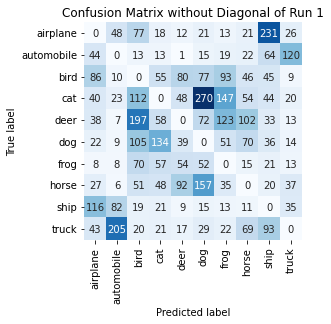

Summing down the rows, for Predictions of each Class that were wrong:  [424. 398. 664. 425. 352. 708. 516. 410. 587. 287.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  92.0 times
Summing across the columns, for total number of that True Class misidentified:  [467. 311. 501. 758. 643. 480. 298. 473. 321. 519.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  197.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0.

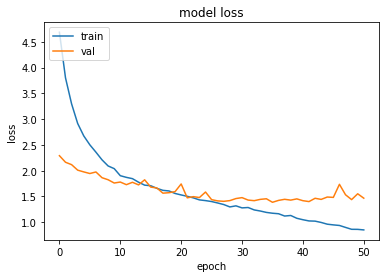

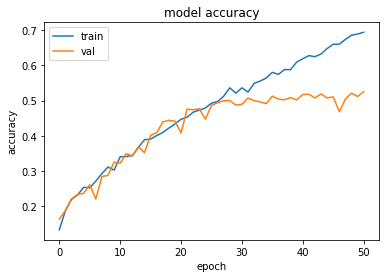

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3874050378799438 , and Val Acc happened to be 0.5127000212669373
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5252000093460083 and Val Loss happened to be  1.466809868812561
TestLoss:  1.3841798305511475  TestAcc: 0.5051000118255615
automobile 0.782
frog 0.781
ship 0.675
horse 0.558
truck 0.502
dog 0.428
airplane 0.393
bird 0.333
deer 0.31
cat 0.289


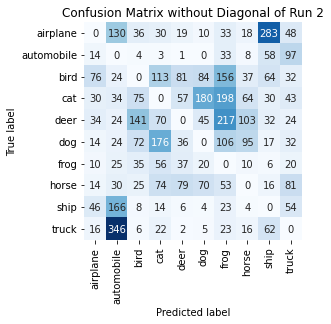

Summing down the rows, for Predictions of each Class that were wrong:  [254. 803. 402. 558. 318. 418. 842. 355. 568. 431.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [607. 218. 667. 711. 690. 572. 219. 442. 325. 498.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  217.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Bright

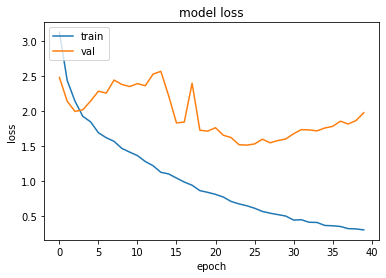

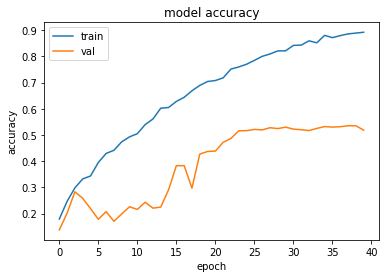

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5120857954025269 , and Val Acc happened to be 0.5164999961853027
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5351999998092651 and Val Loss happened to be  1.8140547275543213
TestLoss:  1.4786279201507568  TestAcc: 0.5177000164985657
truck 0.704
frog 0.646
ship 0.61
dog 0.585
automobile 0.506
horse 0.461
deer 0.457
airplane 0.449
bird 0.383
cat 0.376


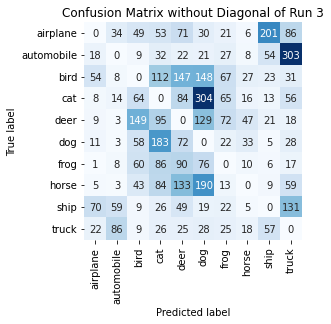

Summing down the rows, for Predictions of each Class that were wrong:  [198. 218. 450. 697. 693. 945. 334. 170. 389. 729.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [551. 494. 617. 624. 543. 415. 354. 539. 390. 296.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  149.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

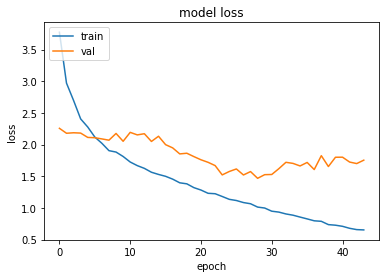

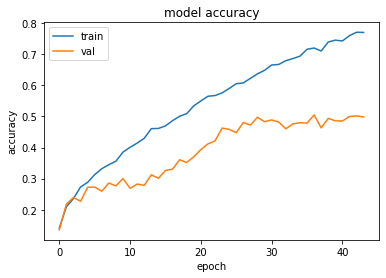

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.4675116539001465 , and Val Acc happened to be 0.49720001220703125
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5047000050544739 and Val Loss happened to be  1.605790376663208
TestLoss:  1.4407774209976196  TestAcc: 0.5062000155448914
frog 0.708
ship 0.659
automobile 0.646
airplane 0.589
deer 0.518
truck 0.468
horse 0.429
bird 0.41
dog 0.374
cat 0.261


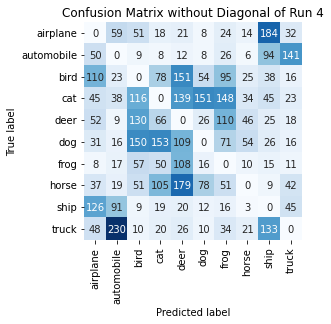

Summing down the rows, for Predictions of each Class that were wrong:  [507. 502. 583. 517. 765. 363. 575. 213. 569. 344.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [411. 354. 590. 739. 482. 626. 292. 571. 341. 532.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  130.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

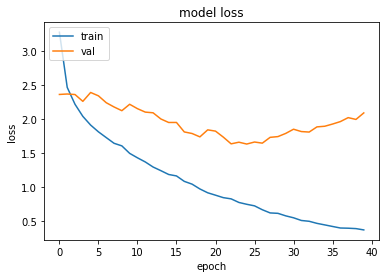

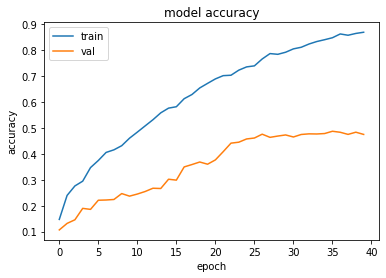

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.637284517288208 , and Val Acc happened to be 0.4575999975204468
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.48730000853538513 and Val Loss happened to be  1.9313081502914429
TestLoss:  1.6036700010299683  TestAcc: 0.45840001106262207
ship 0.794
deer 0.65
horse 0.467
frog 0.46
dog 0.431
truck 0.426
automobile 0.422
airplane 0.374
bird 0.3
cat 0.26


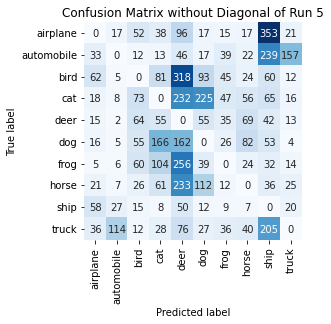

Summing down the rows, for Predictions of each Class that were wrong:  [ 264.  191.  369.  554. 1469.  597.  264.  341. 1085.  282.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  318.0 times
Summing across the columns, for total number of that True Class misidentified:  [626. 578. 700. 740. 350. 569. 540. 533. 206. 574.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  69.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0

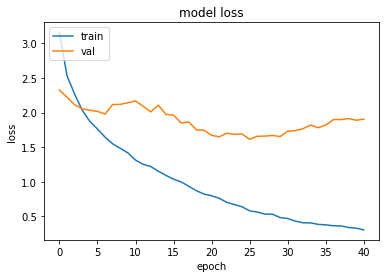

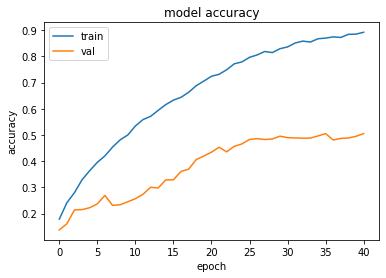

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.613491177558899 , and Val Acc happened to be 0.4830000102519989
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5052000284194946 and Val Loss happened to be  1.8178582191467285
TestLoss:  1.5697444677352905  TestAcc: 0.49300000071525574
ship 0.761
frog 0.725
automobile 0.556
truck 0.516
deer 0.511
horse 0.467
bird 0.386
airplane 0.371
dog 0.351
cat 0.286


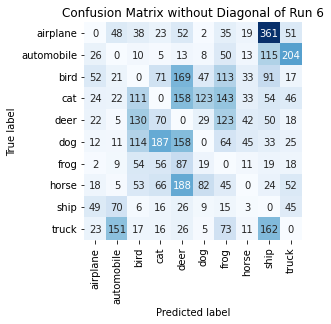

Summing down the rows, for Predictions of each Class that were wrong:  [228. 342. 533. 510. 877. 324. 661. 210. 909. 476.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  188.0 times
Summing across the columns, for total number of that True Class misidentified:  [629. 444. 614. 714. 489. 649. 275. 533. 239. 484.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  130.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Bri

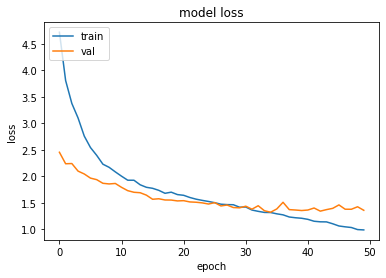

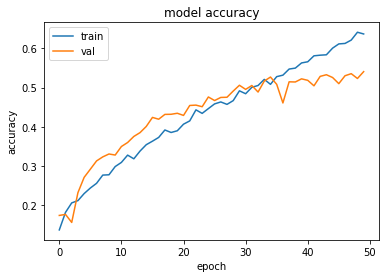

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3253886699676514 , and Val Acc happened to be 0.5267999768257141
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5406000018119812 and Val Loss happened to be  1.3618916273117065
TestLoss:  1.3032499551773071  TestAcc: 0.534600019454956
frog 0.734
automobile 0.707
horse 0.621
ship 0.612
dog 0.554
airplane 0.546
truck 0.545
deer 0.39
bird 0.352
cat 0.285


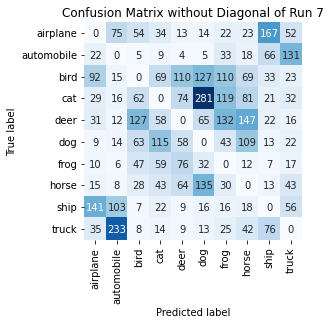

Summing down the rows, for Predictions of each Class that were wrong:  [384. 482. 401. 423. 417. 688. 530. 519. 418. 392.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  110.0 times
Summing across the columns, for total number of that True Class misidentified:  [454. 293. 648. 715. 610. 446. 266. 379. 388. 455.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  147.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 

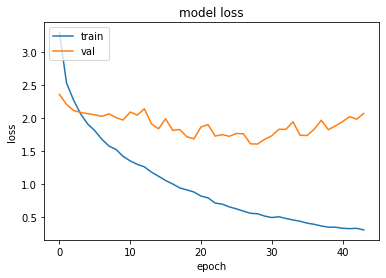

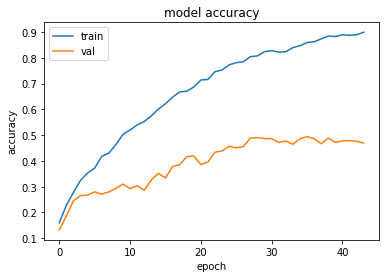

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.6067285537719727 , and Val Acc happened to be 0.4902999997138977
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.49399998784065247 and Val Loss happened to be  1.7354285717010498
TestLoss:  1.5936412811279297  TestAcc: 0.49149999022483826
frog 0.786
ship 0.719
automobile 0.631
truck 0.531
airplane 0.46
dog 0.454
horse 0.413
deer 0.401
cat 0.271
bird 0.249


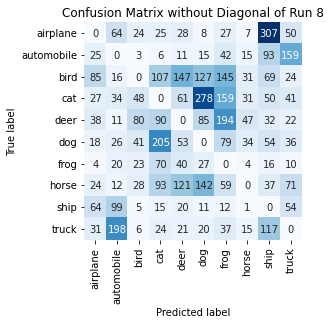

Summing down the rows, for Predictions of each Class that were wrong:  [316. 480. 258. 635. 502. 713. 754. 185. 775. 467.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [540. 369. 751. 729. 599. 546. 214. 587. 281. 469.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  194.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

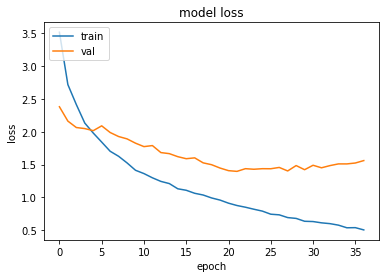

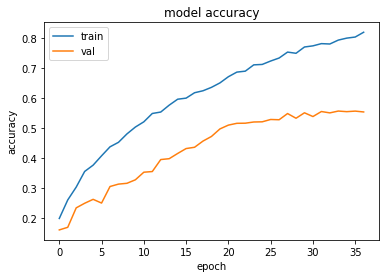

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.3966882228851318 , and Val Acc happened to be 0.5152000188827515
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5561000108718872 and Val Loss happened to be  1.510437250137329
TestLoss:  1.3701322078704834  TestAcc: 0.5212000012397766
ship 0.761
deer 0.698
frog 0.64
truck 0.566
horse 0.549
automobile 0.528
airplane 0.492
dog 0.399
cat 0.3
bird 0.279


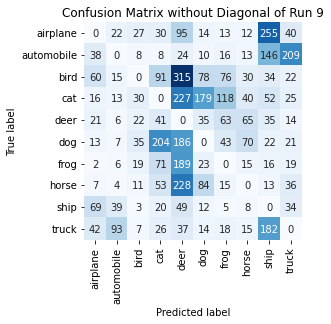

Summing down the rows, for Predictions of each Class that were wrong:  [ 268.  205.  162.  544. 1350.  449.  367.  268.  755.  420.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  315.0 times
Summing across the columns, for total number of that True Class misidentified:  [508. 472. 721. 700. 302. 601. 360. 451. 239. 434.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  65.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

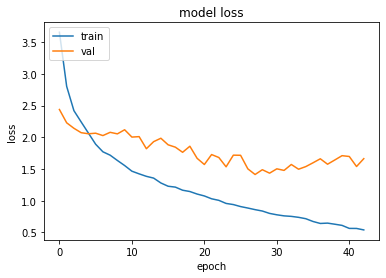

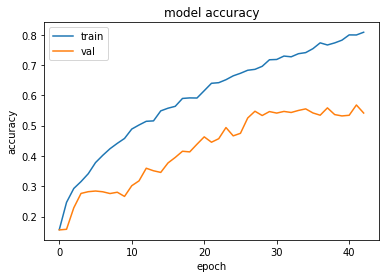

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.4136372804641724 , and Val Acc happened to be 0.5473999977111816
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5680000185966492 and Val Loss happened to be  1.5395134687423706
TestLoss:  1.3961752653121948  TestAcc: 0.5467000007629395
frog 0.806
ship 0.754
horse 0.606
truck 0.605
automobile 0.603
airplane 0.579
deer 0.542
dog 0.458
bird 0.296
cat 0.218


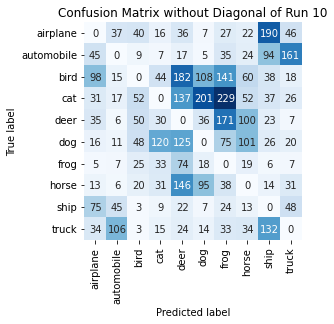

Summing down the rows, for Predictions of each Class that were wrong:  [352. 250. 250. 305. 763. 491. 773. 425. 560. 364.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [421. 397. 704. 782. 458. 542. 194. 394. 246. 395.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

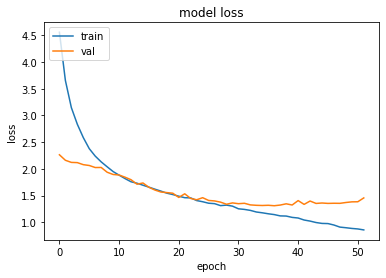

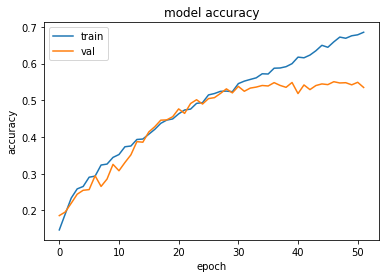

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3107153177261353 , and Val Acc happened to be 0.54830002784729
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5508000254631042 and Val Loss happened to be  1.3570623397827148
TestLoss:  1.2733412981033325  TestAcc: 0.5536999702453613
automobile 0.728
frog 0.701
ship 0.65
horse 0.633
airplane 0.611
dog 0.555
truck 0.545
bird 0.437
deer 0.376
cat 0.301


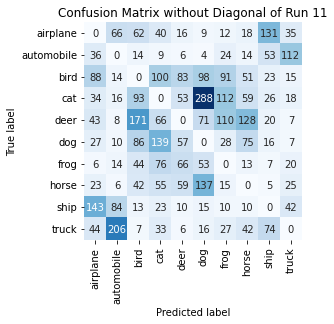

Summing down the rows, for Predictions of each Class that were wrong:  [444. 424. 532. 541. 356. 691. 429. 410. 355. 281.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  83.0 times
Summing across the columns, for total number of that True Class misidentified:  [389. 272. 563. 699. 624. 445. 299. 367. 350. 455.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  171.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16 )

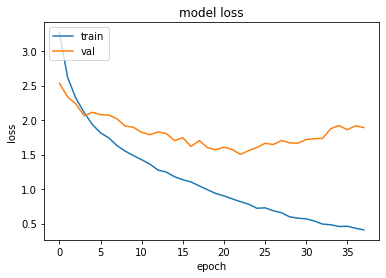

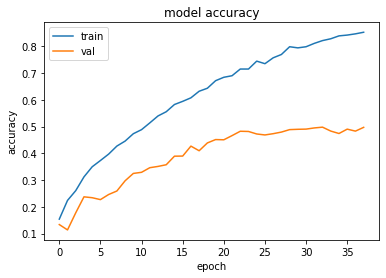

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5016790628433228 , and Val Acc happened to be 0.4828000068664551
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.49810001254081726 and Val Loss happened to be  1.7357336282730103
TestLoss:  1.482122778892517  TestAcc: 0.4912000000476837
ship 0.702
frog 0.628
horse 0.582
dog 0.559
airplane 0.548
automobile 0.479
truck 0.472
deer 0.359
bird 0.355
cat 0.228


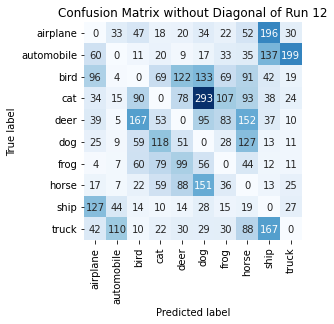

Summing down the rows, for Predictions of each Class that were wrong:  [444. 234. 480. 448. 511. 836. 423. 701. 655. 356.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  122.0 times
Summing across the columns, for total number of that True Class misidentified:  [452. 521. 645. 772. 641. 441. 372. 418. 298. 528.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  167.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.0 , 0.0 )


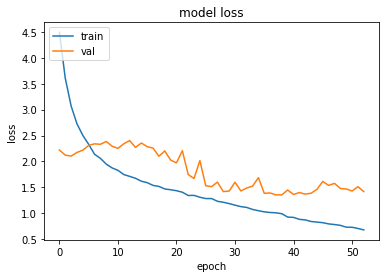

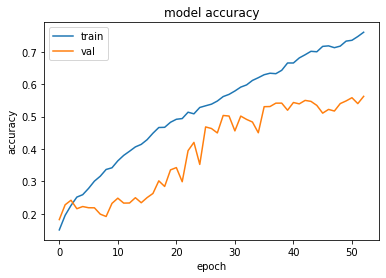

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3515522480010986 , and Val Acc happened to be 0.5412999987602234
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5623000264167786 and Val Loss happened to be  1.4157158136367798
TestLoss:  1.330461859703064  TestAcc: 0.5464000105857849
frog 0.816
automobile 0.714
horse 0.642
ship 0.621
deer 0.573
truck 0.566
airplane 0.504
dog 0.439
bird 0.351
cat 0.238


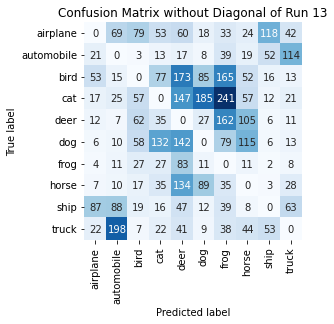

Summing down the rows, for Predictions of each Class that were wrong:  [229. 433. 329. 410. 844. 444. 831. 435. 268. 313.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [496. 286. 649. 762. 427. 561. 184. 358. 379. 434.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  162.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

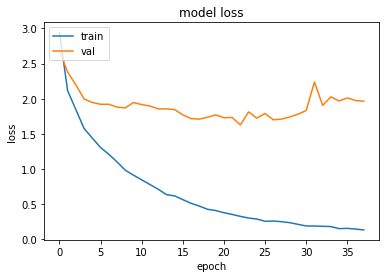

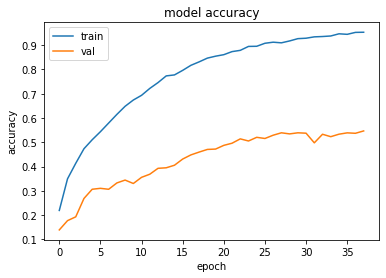

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.6267162561416626 , and Val Acc happened to be 0.51419997215271
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5468999743461609 and Val Loss happened to be  1.9647079706192017
TestLoss:  1.602704644203186  TestAcc: 0.5187000036239624
ship 0.774
frog 0.72
deer 0.602
horse 0.581
truck 0.539
automobile 0.508
airplane 0.473
dog 0.435
cat 0.331
bird 0.224


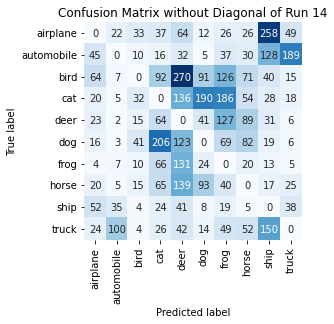

Summing down the rows, for Predictions of each Class that were wrong:  [268. 186. 164. 596. 978. 478. 679. 429. 684. 351.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  270.0 times
Summing across the columns, for total number of that True Class misidentified:  [527. 492. 776. 669. 398. 565. 280. 419. 226. 461.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  127.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

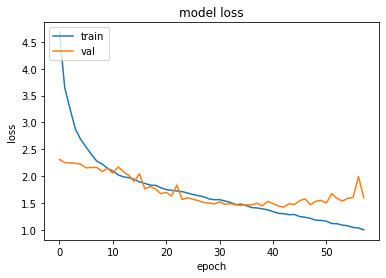

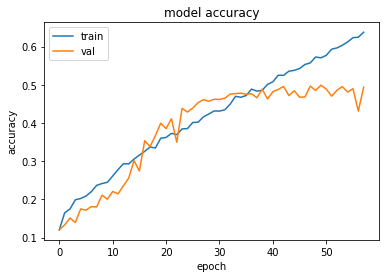

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  42 when  Val Loss was:  1.4218920469284058 , and Val Acc happened to be 0.49570000171661377
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.49889999628067017 and Val Loss happened to be  1.5469011068344116
TestLoss:  1.4094994068145752  TestAcc: 0.4982999861240387
ship 0.731
automobile 0.681
frog 0.671
horse 0.566
bird 0.455
truck 0.454
dog 0.443
airplane 0.422
deer 0.332
cat 0.228


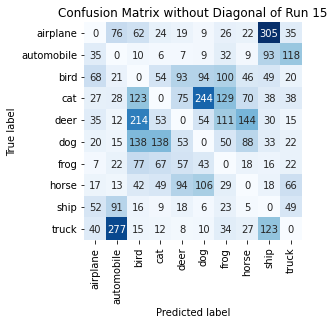

Summing down the rows, for Predictions of each Class that were wrong:  [301. 555. 697. 412. 424. 575. 534. 429. 705. 385.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  94.0 times
Summing across the columns, for total number of that True Class misidentified:  [578. 319. 545. 772. 668. 557. 329. 434. 269. 546.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  214.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
N

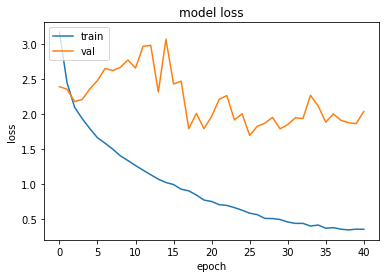

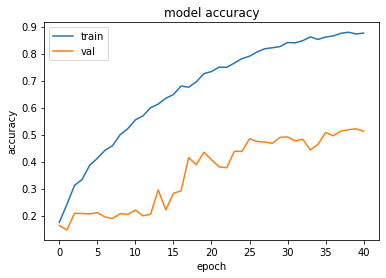

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6979745626449585 , and Val Acc happened to be 0.484499990940094
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.521399974822998 and Val Loss happened to be  1.8647480010986328
TestLoss:  1.6710110902786255  TestAcc: 0.48910000920295715
frog 0.773
ship 0.652
truck 0.513
automobile 0.469
deer 0.466
horse 0.459
bird 0.402
cat 0.4
dog 0.391
airplane 0.366


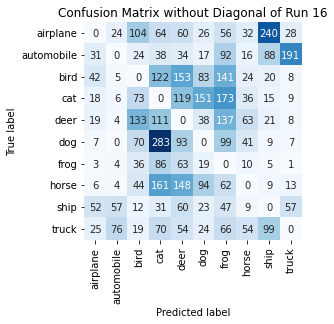

Summing down the rows, for Predictions of each Class that were wrong:  [203. 180. 515. 966. 784. 475. 873. 285. 506. 322.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  153.0 times
Summing across the columns, for total number of that True Class misidentified:  [634. 531. 598. 600. 534. 609. 227. 541. 348. 487.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  137.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

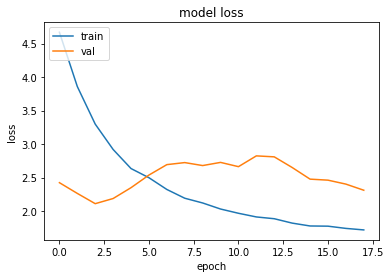

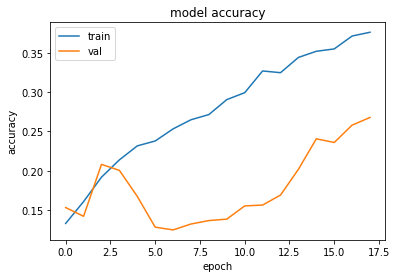

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.1104049682617188 , and Val Acc happened to be 0.20810000598430634
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.2676999866962433 and Val Loss happened to be  2.3108367919921875
TestLoss:  2.106085777282715  TestAcc: 0.2078000009059906
ship 0.659
bird 0.617
airplane 0.473
dog 0.271
truck 0.032
deer 0.011
horse 0.011
frog 0.003
cat 0.001
automobile 0.0


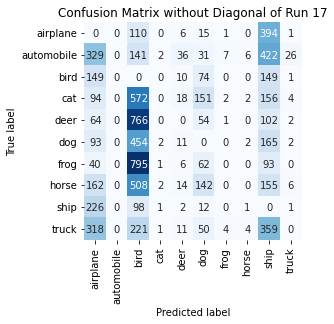

Summing down the rows, for Predictions of each Class that were wrong:  [1475.    0. 3665.    9.  114.  591.   15.   15. 1995.   43.]
For example, the model predicted a  label 4 (deer) on a true   1  a total of  36.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 527. 1000.  383.  999.  989.  729.  997.  989.  341.  968.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  766.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0

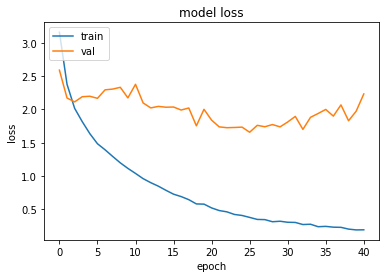

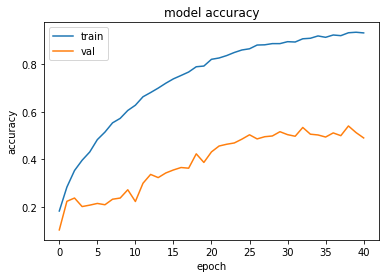

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6569961309432983 , and Val Acc happened to be 0.5031999945640564
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5404000282287598 and Val Loss happened to be  1.8300998210906982
TestLoss:  1.6007269620895386  TestAcc: 0.5044000148773193
frog 0.841
ship 0.596
automobile 0.552
horse 0.549
truck 0.527
deer 0.497
airplane 0.487
dog 0.374
bird 0.368
cat 0.253


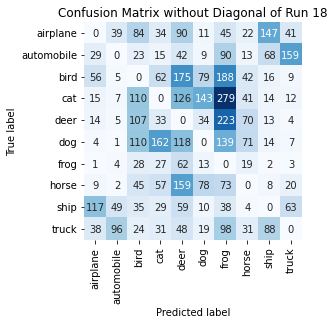

Summing down the rows, for Predictions of each Class that were wrong:  [ 283.  208.  566.  450.  879.  396. 1173.  313.  370.  318.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  175.0 times
Summing across the columns, for total number of that True Class misidentified:  [513. 448. 632. 747. 503. 626. 159. 451. 404. 473.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  223.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

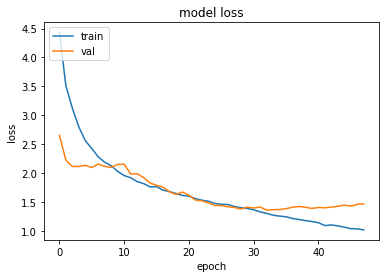

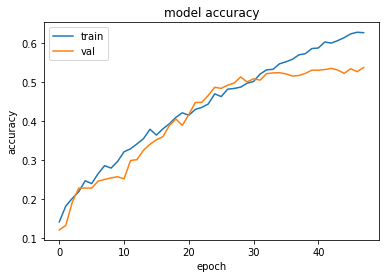

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3598028421401978 , and Val Acc happened to be 0.520799994468689
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5367000102996826 and Val Loss happened to be  1.4679856300354004
TestLoss:  1.3318381309509277  TestAcc: 0.5284000039100647
ship 0.683
frog 0.678
truck 0.609
horse 0.583
automobile 0.549
airplane 0.526
dog 0.507
bird 0.421
deer 0.384
cat 0.344


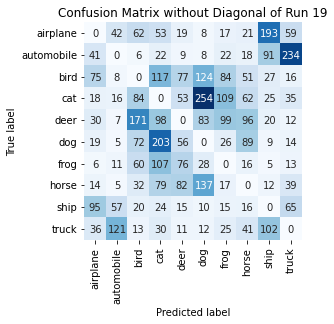

Summing down the rows, for Predictions of each Class that were wrong:  [334. 272. 520. 733. 398. 664. 414. 410. 484. 487.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  82.0 times
Summing across the columns, for total number of that True Class misidentified:  [474. 451. 579. 656. 616. 493. 322. 417. 317. 391.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  171.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise: 

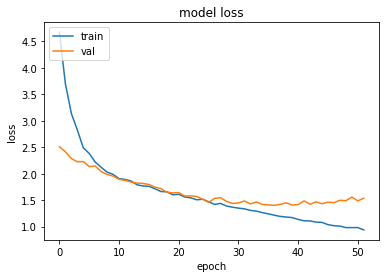

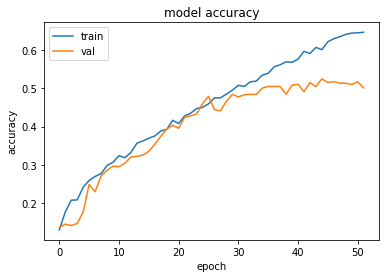

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.4020335674285889 , and Val Acc happened to be 0.5048999786376953
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5246999859809875 and Val Loss happened to be  1.4328675270080566
TestLoss:  1.3811818361282349  TestAcc: 0.5149000287055969
frog 0.672
automobile 0.666
horse 0.647
ship 0.638
truck 0.604
dog 0.528
airplane 0.514
bird 0.345
cat 0.268
deer 0.267


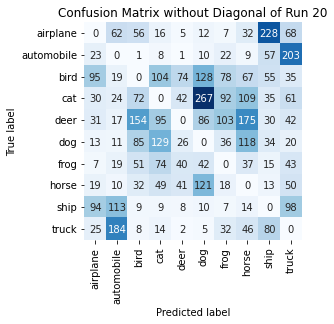

Summing down the rows, for Predictions of each Class that were wrong:  [337. 459. 468. 498. 239. 681. 395. 607. 547. 620.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  74.0 times
Summing across the columns, for total number of that True Class misidentified:  [486. 334. 655. 732. 733. 472. 328. 353. 362. 396.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  175.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

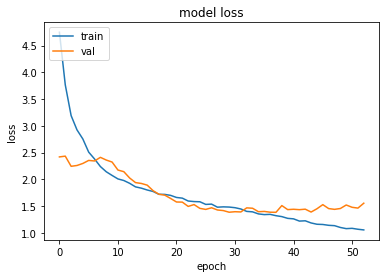

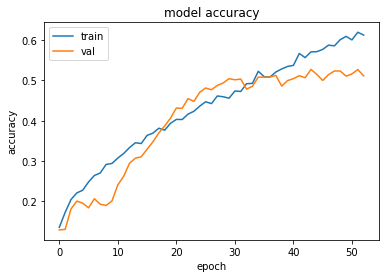

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3844057321548462 , and Val Acc happened to be 0.512499988079071
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.527400016784668 and Val Loss happened to be  1.3893182277679443
TestLoss:  1.3696026802062988  TestAcc: 0.5162000060081482
frog 0.799
automobile 0.669
ship 0.661
horse 0.556
airplane 0.515
truck 0.5
bird 0.441
deer 0.38
dog 0.376
cat 0.265


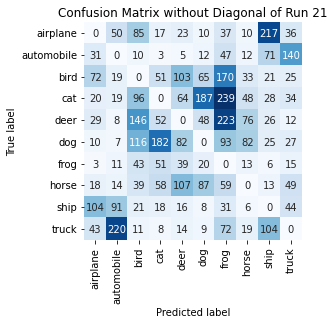

Summing down the rows, for Predictions of each Class that were wrong:  [330. 439. 567. 440. 453. 446. 971. 299. 511. 382.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  107.0 times
Summing across the columns, for total number of that True Class misidentified:  [485. 331. 559. 735. 620. 624. 201. 444. 339. 500.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  223.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

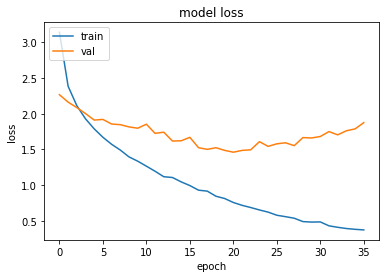

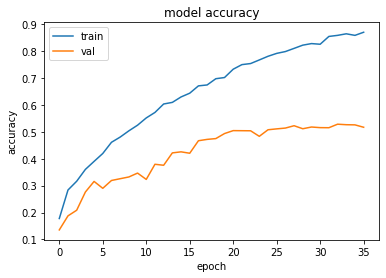

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4614789485931396 , and Val Acc happened to be 0.5045999884605408
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5285000205039978 and Val Loss happened to be  1.7043308019638062
TestLoss:  1.4255965948104858  TestAcc: 0.5126000046730042
frog 0.755
ship 0.644
airplane 0.609
horse 0.576
truck 0.534
deer 0.501
automobile 0.487
dog 0.456
cat 0.318
bird 0.246


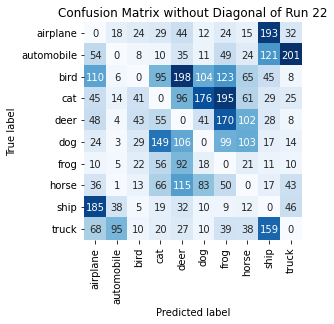

Summing down the rows, for Predictions of each Class that were wrong:  [580. 184. 195. 499. 745. 465. 758. 441. 620. 387.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  198.0 times
Summing across the columns, for total number of that True Class misidentified:  [391. 513. 754. 682. 499. 544. 245. 424. 356. 466.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  170.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 , 0.08 )


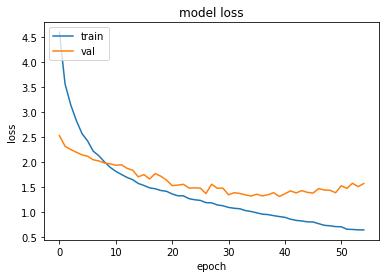

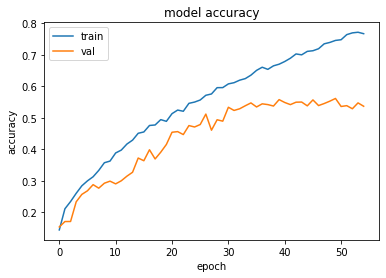

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3045666217803955 , and Val Acc happened to be 0.5577999949455261
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5615000128746033 and Val Loss happened to be  1.3793755769729614
TestLoss:  1.269147515296936  TestAcc: 0.5586000084877014
frog 0.794
automobile 0.724
ship 0.657
airplane 0.635
horse 0.607
dog 0.562
truck 0.526
bird 0.448
deer 0.373
cat 0.26


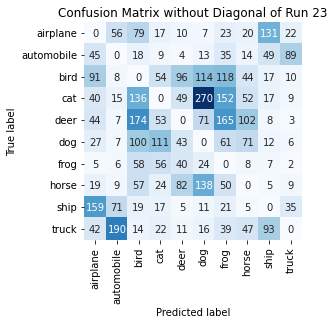

Summing down the rows, for Predictions of each Class that were wrong:  [472. 369. 655. 363. 340. 664. 664. 363. 339. 185.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  96.0 times
Summing across the columns, for total number of that True Class misidentified:  [365. 276. 552. 740. 627. 438. 206. 393. 343. 474.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  174.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:   

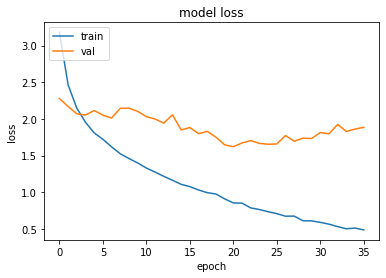

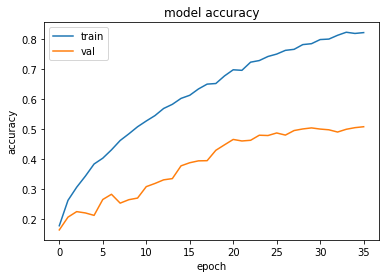

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.6206872463226318 , and Val Acc happened to be 0.4645000100135803
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5069000124931335 and Val Loss happened to be  1.885398030281067
TestLoss:  1.5916423797607422  TestAcc: 0.47609999775886536
frog 0.792
ship 0.652
airplane 0.559
automobile 0.498
deer 0.492
truck 0.446
horse 0.407
bird 0.398
dog 0.354
cat 0.163


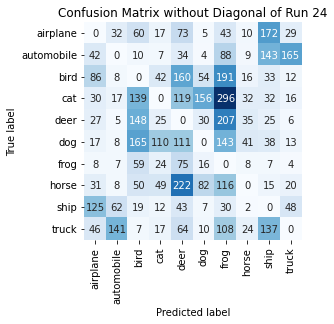

Summing down the rows, for Predictions of each Class that were wrong:  [ 412.  288.  657.  303.  901.  364. 1222.  177.  602.  313.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  222.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 502. 602. 837. 508. 646. 208. 593. 348. 554.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  207.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

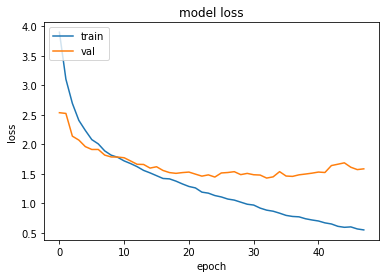

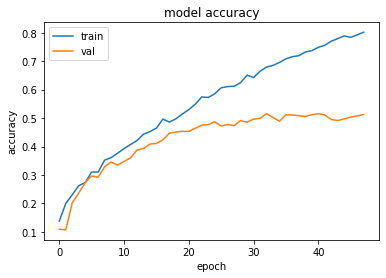

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.4293955564498901 , and Val Acc happened to be 0.5152000188827515
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5153999924659729 and Val Loss happened to be  1.5312016010284424
TestLoss:  1.4038183689117432  TestAcc: 0.515999972820282
frog 0.698
automobile 0.659
ship 0.622
dog 0.547
truck 0.532
horse 0.509
airplane 0.498
deer 0.449
cat 0.357
bird 0.289


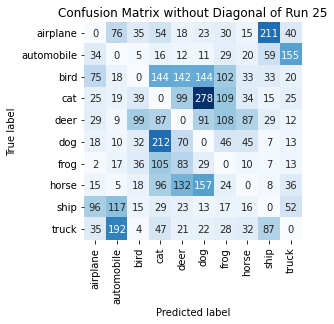

Summing down the rows, for Predictions of each Class that were wrong:  [329. 463. 283. 790. 600. 768. 493. 292. 456. 366.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  142.0 times
Summing across the columns, for total number of that True Class misidentified:  [502. 341. 711. 643. 551. 453. 302. 491. 378. 468.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  108.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

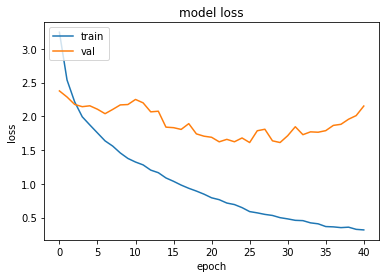

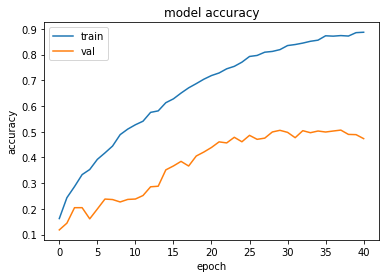

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6118296384811401 , and Val Acc happened to be 0.48579999804496765
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5062999725341797 and Val Loss happened to be  1.8818414211273193
TestLoss:  1.5829397439956665  TestAcc: 0.4832000136375427
ship 0.787
frog 0.642
truck 0.579
deer 0.513
horse 0.508
dog 0.47
airplane 0.39
cat 0.39
automobile 0.31
bird 0.243


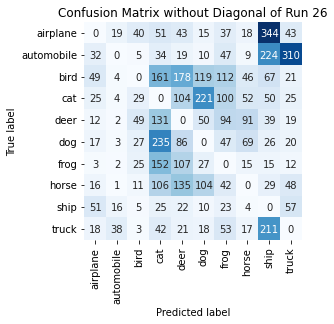

Summing down the rows, for Predictions of each Class that were wrong:  [ 223.   89.  194.  937.  715.  574.  555.  321. 1005.  555.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  178.0 times
Summing across the columns, for total number of that True Class misidentified:  [610. 690. 757. 610. 487. 530. 358. 492. 213. 421.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  131.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.1

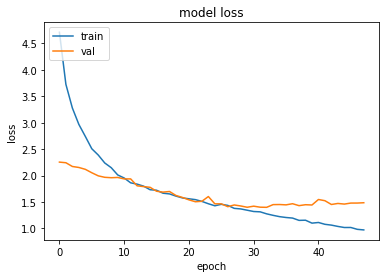

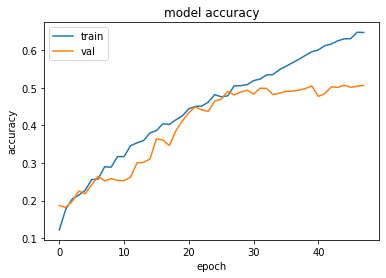

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3992232084274292 , and Val Acc happened to be 0.498199999332428
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5065000057220459 and Val Loss happened to be  1.4606515169143677
TestLoss:  1.3858062028884888  TestAcc: 0.5
frog 0.721
horse 0.625
truck 0.611
ship 0.586
dog 0.553
automobile 0.524
airplane 0.512
deer 0.481
bird 0.214
cat 0.173


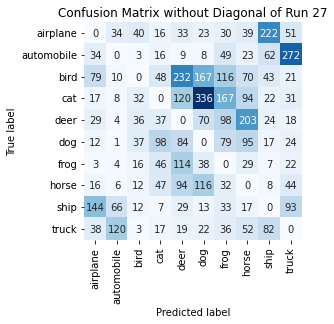

Summing down the rows, for Predictions of each Class that were wrong:  [372. 253. 191. 332. 734. 793. 640. 622. 487. 576.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  232.0 times
Summing across the columns, for total number of that True Class misidentified:  [488. 476. 786. 827. 519. 447. 279. 375. 414. 389.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  203.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

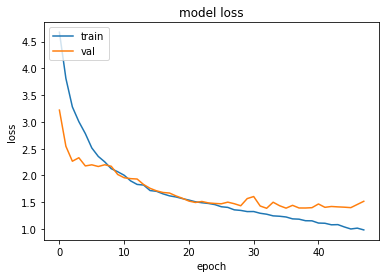

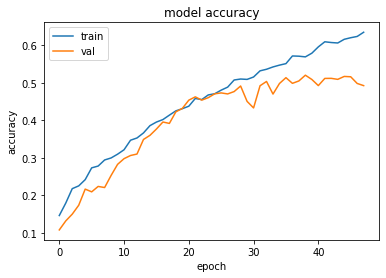

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3876804113388062 , and Val Acc happened to be 0.5034999847412109
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5202000141143799 and Val Loss happened to be  1.3928922414779663
TestLoss:  1.3689168691635132  TestAcc: 0.5134999752044678
frog 0.756
automobile 0.65
dog 0.641
ship 0.582
truck 0.54
horse 0.52
airplane 0.518
bird 0.438
deer 0.283
cat 0.207


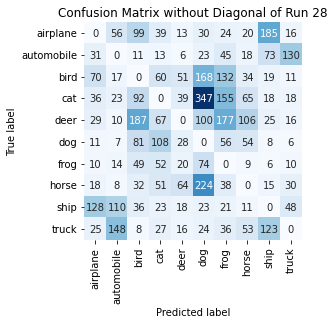

Summing down the rows, for Predictions of each Class that were wrong:  [ 358.  393.  595.  440.  255. 1013.  684.  370.  472.  285.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  64.0 times
Summing across the columns, for total number of that True Class misidentified:  [482. 350. 562. 793. 717. 359. 244. 480. 418. 460.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  187.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 

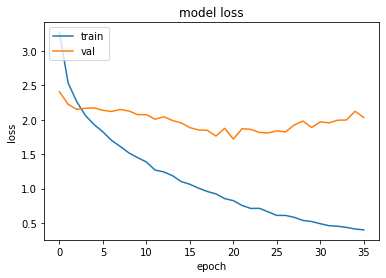

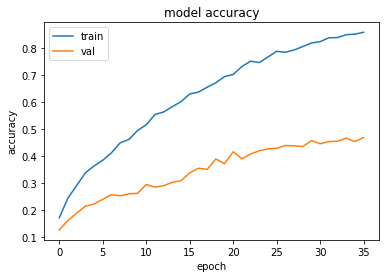

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.719858169555664 , and Val Acc happened to be 0.4163999855518341
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.4693000018596649 and Val Loss happened to be  2.033038377761841
TestLoss:  1.7150249481201172  TestAcc: 0.4172999858856201
frog 0.863
ship 0.806
airplane 0.473
dog 0.363
horse 0.361
truck 0.345
automobile 0.333
deer 0.247
cat 0.207
bird 0.175


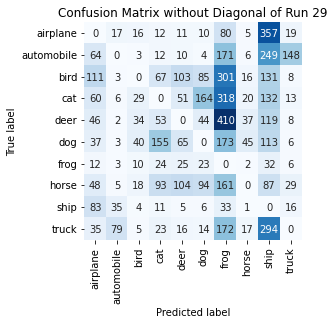

Summing down the rows, for Predictions of each Class that were wrong:  [ 496.  153.  159.  450.  390.  444. 1819.  149. 1514.  253.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [527. 667. 825. 793. 753. 637. 137. 639. 194. 655.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  410.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.1

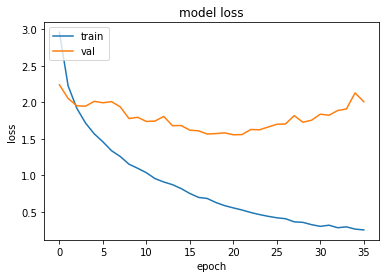

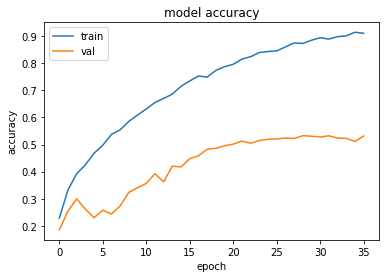

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.556835651397705 , and Val Acc happened to be 0.5012999773025513
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5325000286102295 and Val Loss happened to be  1.7284458875656128
TestLoss:  1.5202925205230713  TestAcc: 0.513700008392334
ship 0.679
automobile 0.669
deer 0.662
truck 0.587
frog 0.556
dog 0.487
horse 0.476
airplane 0.469
bird 0.394
cat 0.158


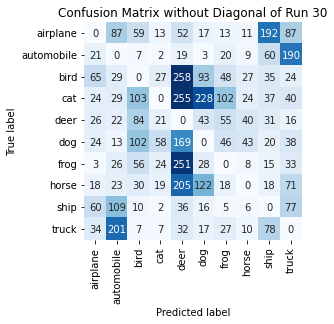

Summing down the rows, for Predictions of each Class that were wrong:  [ 275.  539.  458.  173. 1277.  567.  334.  178.  486.  576.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  258.0 times
Summing across the columns, for total number of that True Class misidentified:  [531. 331. 606. 842. 338. 513. 444. 524. 321. 413.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  84.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

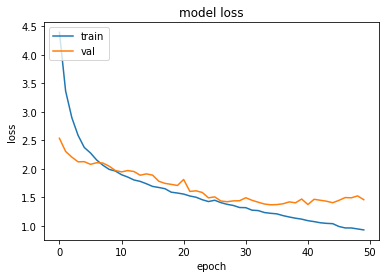

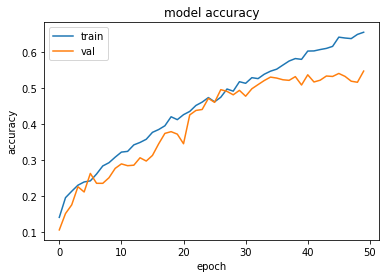

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3687472343444824 , and Val Acc happened to be 0.5307999849319458
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5475000143051147 and Val Loss happened to be  1.4582743644714355
TestLoss:  1.340330958366394  TestAcc: 0.5322999954223633
frog 0.768
ship 0.661
truck 0.661
horse 0.565
automobile 0.561
dog 0.522
airplane 0.517
cat 0.408
bird 0.34
deer 0.32


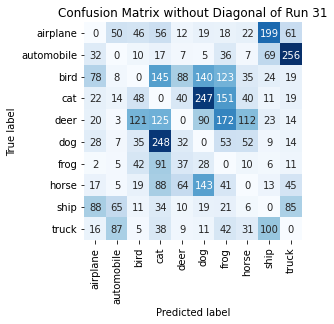

Summing down the rows, for Predictions of each Class that were wrong:  [303. 244. 337. 842. 299. 702. 657. 315. 454. 524.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  88.0 times
Summing across the columns, for total number of that True Class misidentified:  [483. 439. 660. 592. 680. 478. 232. 435. 339. 339.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  172.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

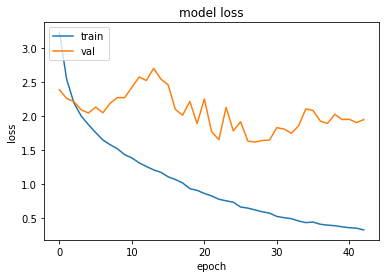

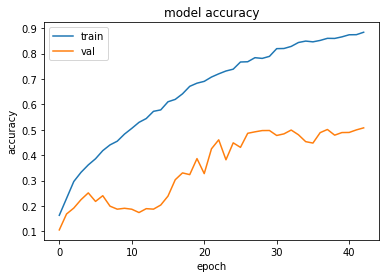

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.6188945770263672 , and Val Acc happened to be 0.492000013589859
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5077000260353088 and Val Loss happened to be  1.9475213289260864
TestLoss:  1.584259033203125  TestAcc: 0.49880000948905945
frog 0.746
automobile 0.656
dog 0.539
airplane 0.532
ship 0.504
horse 0.489
truck 0.444
cat 0.398
deer 0.359
bird 0.321


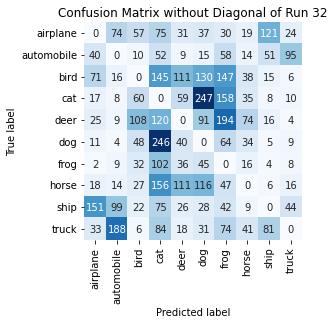

Summing down the rows, for Predictions of each Class that were wrong:  [ 368.  421.  370. 1055.  441.  740.  814.  280.  307.  216.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  111.0 times
Summing across the columns, for total number of that True Class misidentified:  [468. 344. 679. 602. 641. 461. 254. 511. 496. 556.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  194.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )


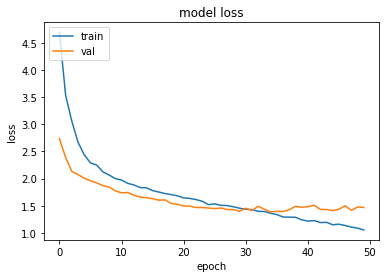

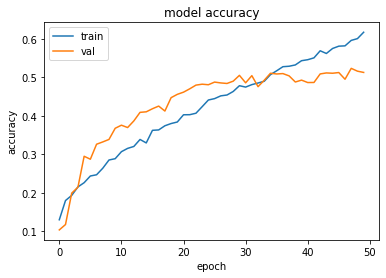

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.387254238128662 , and Val Acc happened to be 0.5108000040054321
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5235000252723694 and Val Loss happened to be  1.4158939123153687
TestLoss:  1.3625156879425049  TestAcc: 0.5151000022888184
frog 0.796
automobile 0.633
ship 0.612
horse 0.589
truck 0.533
dog 0.497
airplane 0.446
bird 0.407
deer 0.332
cat 0.306


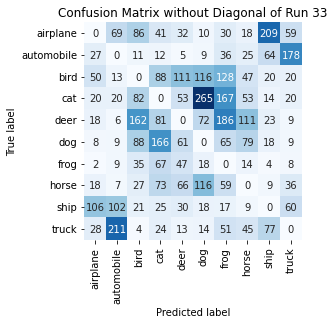

Summing down the rows, for Predictions of each Class that were wrong:  [277. 446. 516. 577. 418. 638. 739. 401. 438. 399.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  111.0 times
Summing across the columns, for total number of that True Class misidentified:  [554. 367. 593. 694. 668. 503. 204. 411. 388. 467.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  186.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

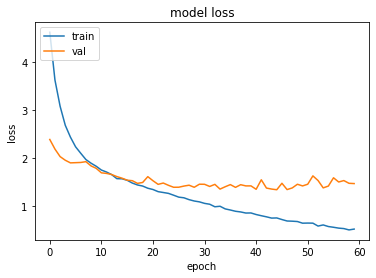

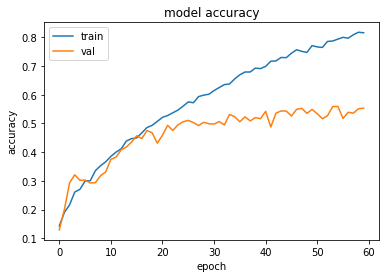

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  44 when  Val Loss was:  1.3389112949371338 , and Val Acc happened to be 0.5432999730110168
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.559499979019165 and Val Loss happened to be  1.415529727935791
TestLoss:  1.3048325777053833  TestAcc: 0.5515000224113464
ship 0.781
automobile 0.729
horse 0.717
frog 0.688
truck 0.559
deer 0.503
dog 0.464
bird 0.414
airplane 0.394
cat 0.266


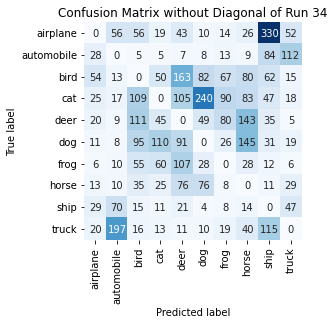

Summing down the rows, for Predictions of each Class that were wrong:  [206. 390. 497. 338. 624. 507. 325. 568. 727. 303.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  163.0 times
Summing across the columns, for total number of that True Class misidentified:  [606. 271. 586. 734. 497. 536. 312. 283. 219. 441.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  143.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

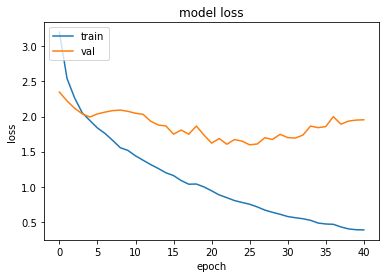

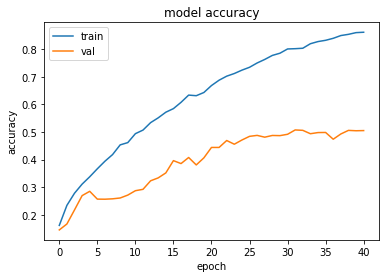

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.596889615058899 , and Val Acc happened to be 0.48410001397132874
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5073000192642212 and Val Loss happened to be  1.6938552856445312
TestLoss:  1.571812629699707  TestAcc: 0.492000013589859
frog 0.817
ship 0.71
automobile 0.632
truck 0.49
airplane 0.475
cat 0.397
horse 0.388
dog 0.378
bird 0.373
deer 0.26


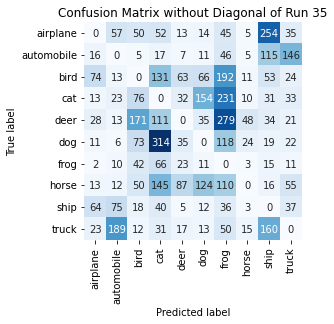

Summing down the rows, for Predictions of each Class that were wrong:  [ 244.  398.  497.  907.  282.  440. 1107.  124.  697.  384.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [525. 368. 627. 603. 740. 622. 183. 612. 290. 510.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  279.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 ,

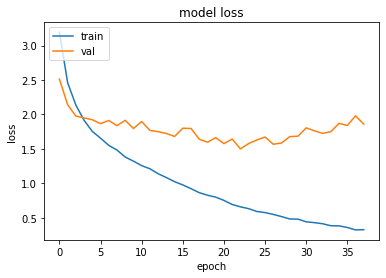

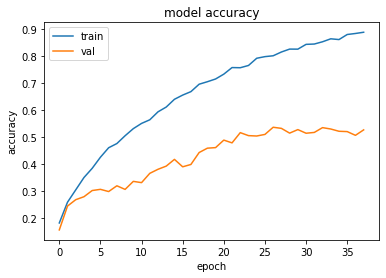

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.499191403388977 , and Val Acc happened to be 0.5160999894142151
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5360999703407288 and Val Loss happened to be  1.5668162107467651
TestLoss:  1.4524779319763184  TestAcc: 0.5217000246047974
frog 0.772
ship 0.762
truck 0.582
horse 0.529
deer 0.521
automobile 0.497
dog 0.452
airplane 0.39
cat 0.374
bird 0.338


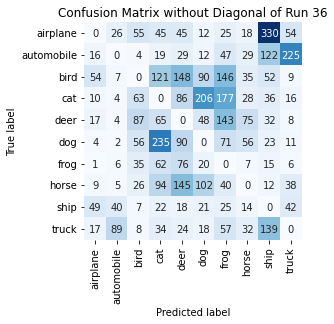

Summing down the rows, for Predictions of each Class that were wrong:  [177. 183. 341. 697. 661. 529. 731. 294. 761. 409.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  148.0 times
Summing across the columns, for total number of that True Class misidentified:  [610. 503. 662. 626. 479. 548. 228. 471. 238. 418.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  143.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 

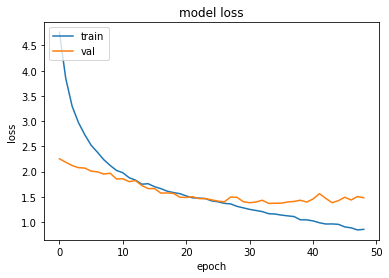

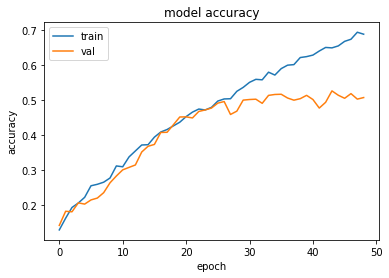

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3693166971206665 , and Val Acc happened to be 0.5139999985694885
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5267999768257141 and Val Loss happened to be  1.383252501487732
TestLoss:  1.347856044769287  TestAcc: 0.5148000121116638
frog 0.793
ship 0.705
automobile 0.674
truck 0.546
horse 0.544
dog 0.476
airplane 0.435
bird 0.429
deer 0.385
cat 0.161


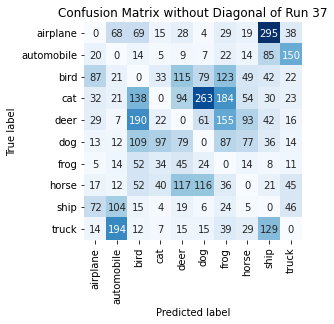

Summing down the rows, for Predictions of each Class that were wrong:  [289. 453. 651. 257. 521. 575. 699. 354. 688. 365.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  117.0 times
Summing across the columns, for total number of that True Class misidentified:  [565. 326. 571. 839. 615. 524. 207. 456. 295. 454.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  190.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

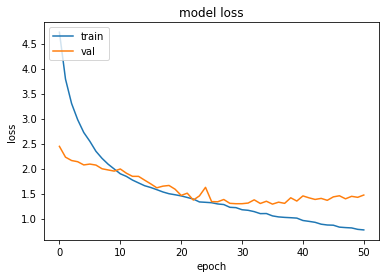

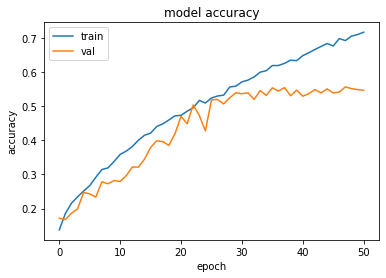

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.2893354892730713 , and Val Acc happened to be 0.5544000267982483
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5569999814033508 and Val Loss happened to be  1.3954557180404663
TestLoss:  1.271756887435913  TestAcc: 0.5546000003814697
frog 0.807
ship 0.739
automobile 0.666
airplane 0.622
truck 0.619
horse 0.589
dog 0.492
deer 0.396
bird 0.378
cat 0.238


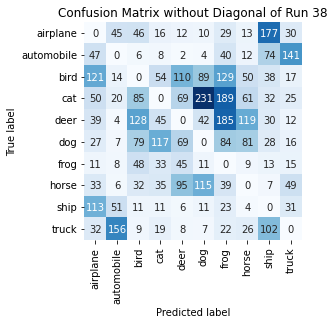

Summing down the rows, for Predictions of each Class that were wrong:  [473. 311. 444. 338. 416. 520. 740. 375. 501. 336.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  110.0 times
Summing across the columns, for total number of that True Class misidentified:  [378. 334. 622. 762. 604. 508. 193. 411. 261. 381.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  185.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

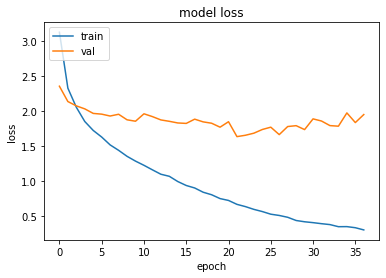

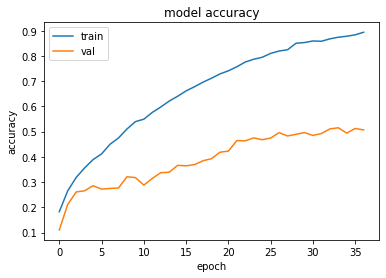

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.6367727518081665 , and Val Acc happened to be 0.46470001339912415
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5152999758720398 and Val Loss happened to be  1.7859281301498413
TestLoss:  1.6044416427612305  TestAcc: 0.4697999954223633
frog 0.76
ship 0.708
airplane 0.617
automobile 0.565
deer 0.54
cat 0.37
dog 0.353
horse 0.35
truck 0.302
bird 0.133


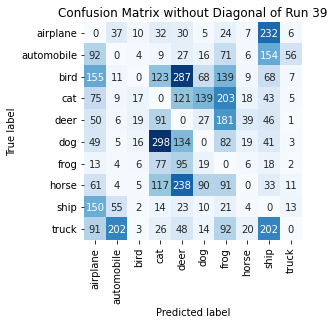

Summing down the rows, for Predictions of each Class that were wrong:  [ 736.  333.   82.  787. 1003.  388.  904.  128.  837.  104.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  287.0 times
Summing across the columns, for total number of that True Class misidentified:  [383. 435. 867. 630. 460. 647. 240. 650. 292. 698.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  181.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

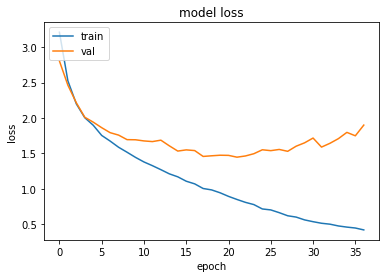

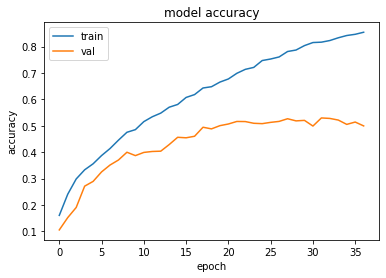

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4462072849273682 , and Val Acc happened to be 0.5162000060081482
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5295000076293945 and Val Loss happened to be  1.5885767936706543
TestLoss:  1.4154149293899536  TestAcc: 0.5169000029563904
frog 0.796
ship 0.658
horse 0.612
truck 0.609
automobile 0.599
airplane 0.551
deer 0.527
dog 0.387
cat 0.269
bird 0.161


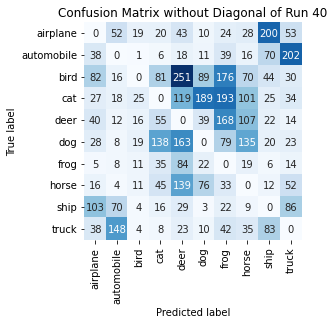

Summing down the rows, for Predictions of each Class that were wrong:  [377. 336. 110. 404. 869. 449. 776. 520. 482. 508.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  251.0 times
Summing across the columns, for total number of that True Class misidentified:  [449. 401. 839. 731. 473. 613. 204. 388. 342. 391.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  168.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


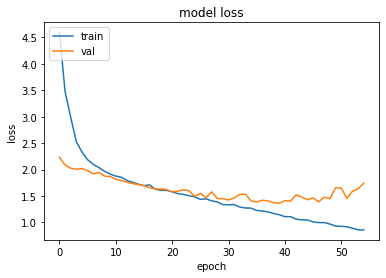

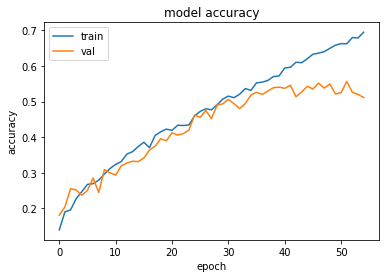

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3623613119125366 , and Val Acc happened to be 0.5406000018119812
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5566999912261963 and Val Loss happened to be  1.4542063474655151
TestLoss:  1.323493480682373  TestAcc: 0.554099977016449
frog 0.813
automobile 0.708
ship 0.688
horse 0.624
dog 0.557
truck 0.531
airplane 0.523
deer 0.476
bird 0.381
cat 0.24


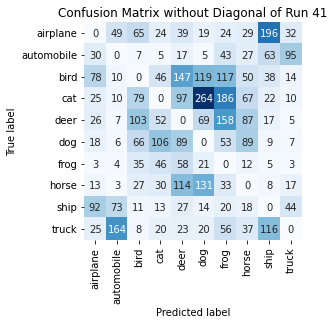

Summing down the rows, for Predictions of each Class that were wrong:  [310. 326. 401. 342. 611. 662. 690. 416. 474. 227.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [477. 292. 619. 760. 524. 443. 187. 376. 312. 469.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16

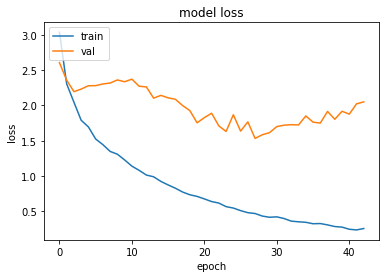

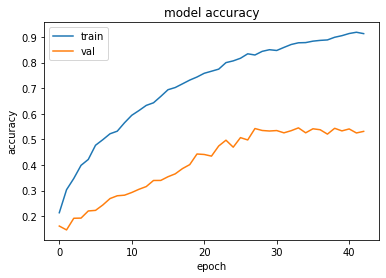

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.5324490070343018 , and Val Acc happened to be 0.5425000190734863
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5450999736785889 and Val Loss happened to be  1.7231091260910034
TestLoss:  1.4700076580047607  TestAcc: 0.54830002784729
ship 0.746
frog 0.686
automobile 0.621
airplane 0.59
horse 0.539
deer 0.521
truck 0.491
bird 0.467
cat 0.467
dog 0.355


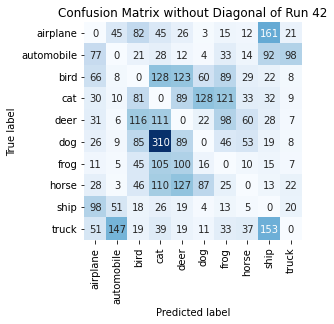

Summing down the rows, for Predictions of each Class that were wrong:  [418. 284. 513. 902. 604. 335. 473. 253. 535. 200.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  127.0 times
Summing across the columns, for total number of that True Class misidentified:  [410. 379. 533. 533. 479. 645. 314. 461. 254. 509.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  116.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

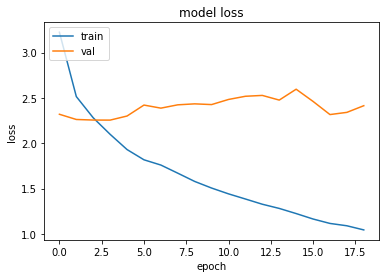

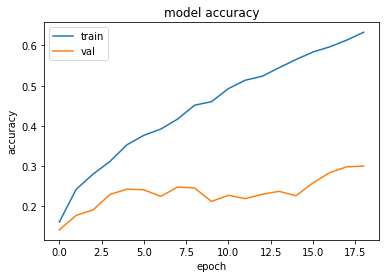

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.2558043003082275 , and Val Acc happened to be 0.2295999974012375
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.3000999987125397 and Val Loss happened to be  2.4147450923919678
TestLoss:  2.240377902984619  TestAcc: 0.2328999936580658
dog 0.693
ship 0.675
deer 0.465
frog 0.274
bird 0.069
airplane 0.058
cat 0.048
horse 0.047
automobile 0.0
truck 0.0


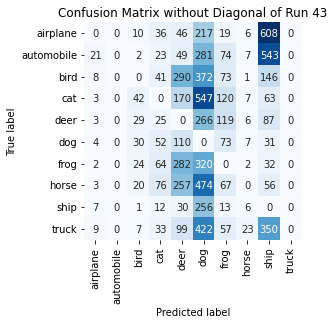

Summing down the rows, for Predictions of each Class that were wrong:  [  60.    0.  165.  362. 1333. 3155.  615.   65. 1916.    0.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  290.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 942. 1000.  931.  952.  535.  307.  726.  953.  325. 1000.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  266.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomI

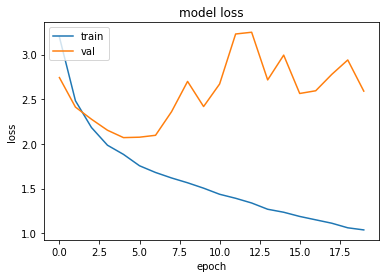

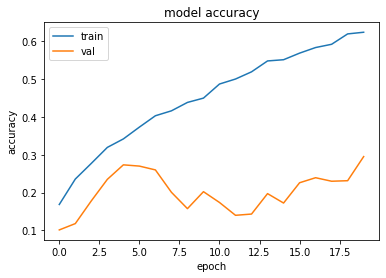

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  2.070175886154175 , and Val Acc happened to be 0.2732999920845032
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.29510000348091125 and Val Loss happened to be  2.5906078815460205
TestLoss:  2.0546059608459473  TestAcc: 0.2786000072956085
ship 0.775
frog 0.58
bird 0.382
dog 0.33
cat 0.302
airplane 0.266
horse 0.071
deer 0.06
automobile 0.012
truck 0.008


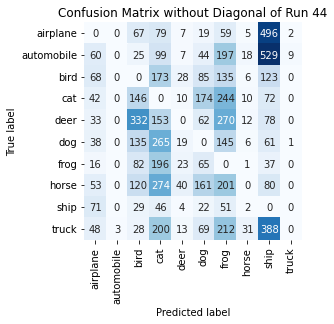

Summing down the rows, for Predictions of each Class that were wrong:  [ 429.    3.  964. 1485.  151.  701. 1514.   91. 1864.   12.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  40.0 times
Summing across the columns, for total number of that True Class misidentified:  [734. 988. 618. 698. 940. 670. 420. 929. 225. 992.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  332.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )

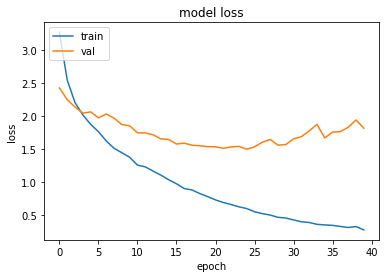

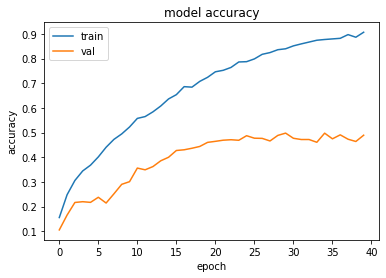

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.4982221126556396 , and Val Acc happened to be 0.48730000853538513
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.49779999256134033 and Val Loss happened to be  1.568543553352356
TestLoss:  1.4885189533233643  TestAcc: 0.49619999527931213
frog 0.737
ship 0.636
automobile 0.596
airplane 0.485
bird 0.449
truck 0.446
horse 0.431
dog 0.418
cat 0.397
deer 0.367


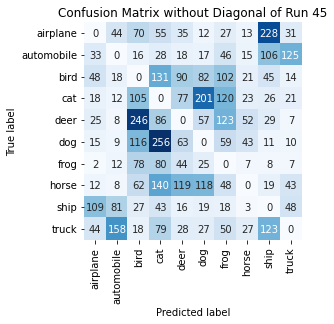

Summing down the rows, for Predictions of each Class that were wrong:  [306. 350. 738. 898. 490. 558. 593. 204. 595. 306.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  119.0 times
Summing across the columns, for total number of that True Class misidentified:  [515. 404. 551. 603. 633. 582. 263. 569. 364. 554.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  246.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

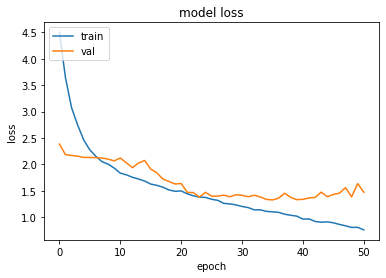

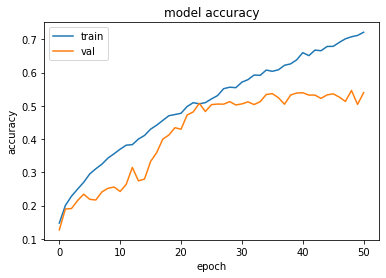

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3292702436447144 , and Val Acc happened to be 0.5368000268936157
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5462999939918518 and Val Loss happened to be  1.387498378753662
TestLoss:  1.323776125907898  TestAcc: 0.5375999808311462
ship 0.714
automobile 0.71
frog 0.693
horse 0.683
truck 0.559
airplane 0.522
deer 0.51
dog 0.447
bird 0.333
cat 0.205


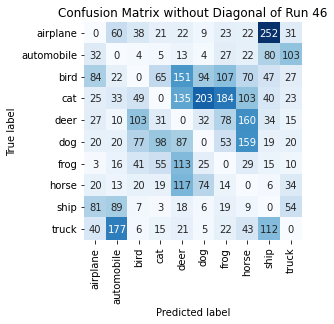

Summing down the rows, for Predictions of each Class that were wrong:  [332. 440. 345. 312. 677. 452. 527. 617. 605. 317.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  151.0 times
Summing across the columns, for total number of that True Class misidentified:  [478. 290. 667. 795. 490. 553. 307. 317. 286. 441.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  160.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

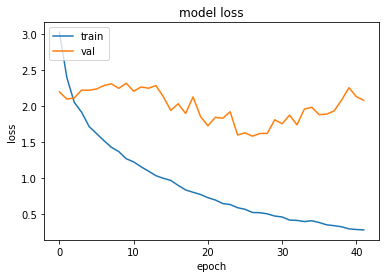

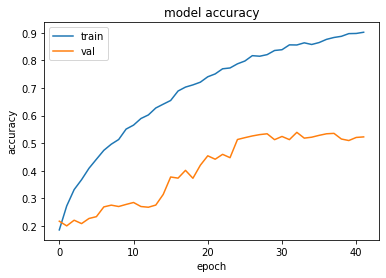

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.5843034982681274 , and Val Acc happened to be 0.5260999798774719
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5392000079154968 and Val Loss happened to be  1.742357850074768
TestLoss:  1.5382323265075684  TestAcc: 0.5325999855995178
frog 0.81
ship 0.78
automobile 0.656
truck 0.517
horse 0.512
airplane 0.474
deer 0.471
dog 0.4
bird 0.383
cat 0.323


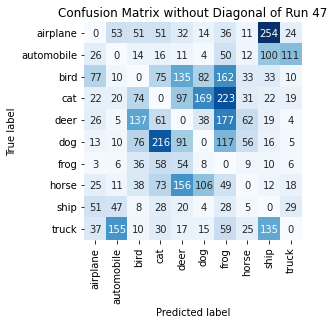

Summing down the rows, for Predictions of each Class that were wrong:  [280. 317. 444. 608. 613. 440. 901. 244. 601. 226.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  156.0 times
Summing across the columns, for total number of that True Class misidentified:  [526. 344. 617. 677. 529. 600. 190. 488. 220. 483.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  177.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


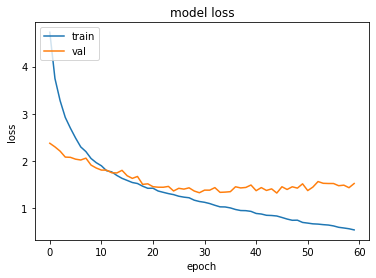

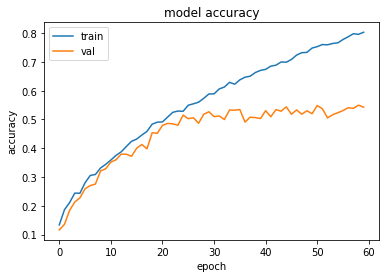

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  44 when  Val Loss was:  1.3208998441696167 , and Val Acc happened to be 0.5437999963760376
Additionally, the best val acc epoch happened to be  58 when val acc was:  0.5496000051498413 and Val Loss happened to be  1.4343875646591187
TestLoss:  1.3070335388183594  TestAcc: 0.5472999811172485
frog 0.738
ship 0.678
truck 0.627
horse 0.626
automobile 0.607
dog 0.586
airplane 0.536
bird 0.419
cat 0.334
deer 0.322


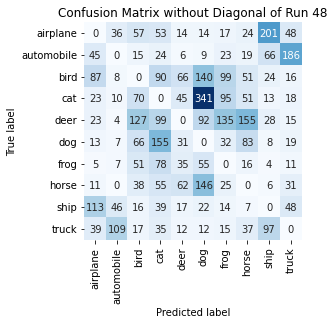

Summing down the rows, for Predictions of each Class that were wrong:  [359. 227. 457. 628. 288. 831. 455. 443. 447. 392.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  66.0 times
Summing across the columns, for total number of that True Class misidentified:  [464. 393. 581. 666. 678. 414. 262. 374. 322. 373.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  155.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

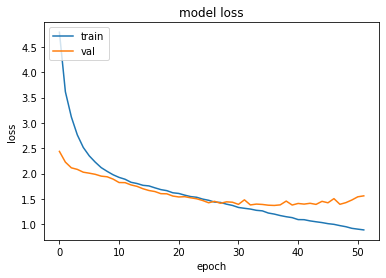

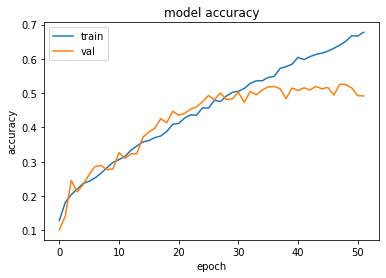

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.369176983833313 , and Val Acc happened to be 0.5194000005722046
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5263000130653381 and Val Loss happened to be  1.391615867614746
TestLoss:  1.3456974029541016  TestAcc: 0.5210000276565552
automobile 0.716
frog 0.653
horse 0.633
ship 0.605
airplane 0.59
dog 0.567
truck 0.506
deer 0.38
bird 0.306
cat 0.254


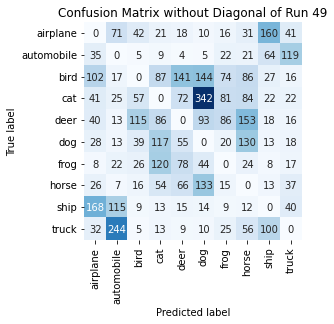

Summing down the rows, for Predictions of each Class that were wrong:  [480. 527. 314. 520. 458. 795. 348. 597. 425. 326.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [410. 284. 694. 746. 620. 433. 347. 367. 395. 494.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  153.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0

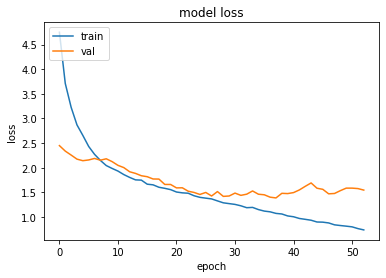

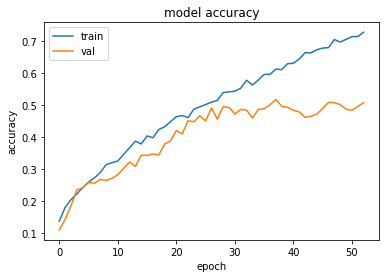

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3862148523330688 , and Val Acc happened to be 0.5177000164985657
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5177000164985657 and Val Loss happened to be  1.3862148523330688
TestLoss:  1.3740886449813843  TestAcc: 0.5149999856948853
frog 0.737
ship 0.707
truck 0.603
automobile 0.587
deer 0.58
horse 0.508
dog 0.491
airplane 0.388
bird 0.312
cat 0.237


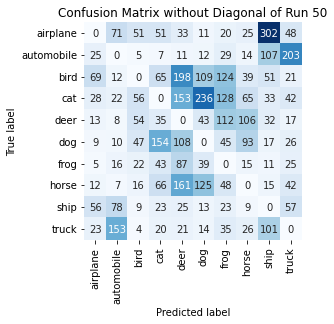

Summing down the rows, for Predictions of each Class that were wrong:  [240. 377. 264. 464. 797. 602. 564. 392. 669. 481.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  198.0 times
Summing across the columns, for total number of that True Class misidentified:  [612. 413. 688. 763. 420. 509. 263. 492. 293. 397.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  112.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 11 November 2021 21:05:42  (subtract ~5-hours for local Hour), and file is called  runs_GroupD_final.pkl


In [ ]:
#@title Group D: 51 Run Results
run_through_runs(ds=make_unbatched(train_D),   ds_noalb=train_D_noalb,   dstitle="D" , showpictures= False)


filename will be:  runs_GroupE .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


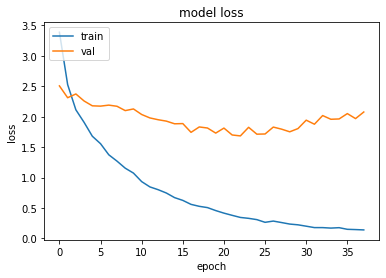

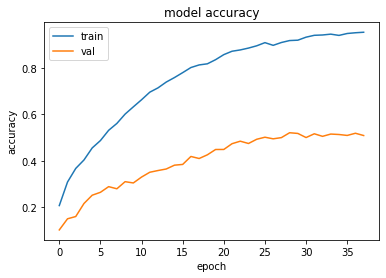

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.6841481924057007 , and Val Acc happened to be 0.48410001397132874
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5205000042915344 and Val Loss happened to be  1.7517427206039429
TestLoss:  1.6614607572555542  TestAcc: 0.490200012922287
ship 0.775
frog 0.641
deer 0.608
dog 0.554
automobile 0.454
airplane 0.43
horse 0.425
cat 0.375
truck 0.371
bird 0.269


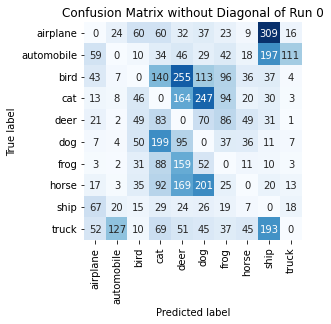

Summing down the rows, for Predictions of each Class that were wrong:  [282. 197. 306. 794. 995. 820. 459. 231. 838. 176.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  255.0 times
Summing across the columns, for total number of that True Class misidentified:  [570. 546. 731. 625. 392. 446. 359. 575. 225. 629.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  86.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.

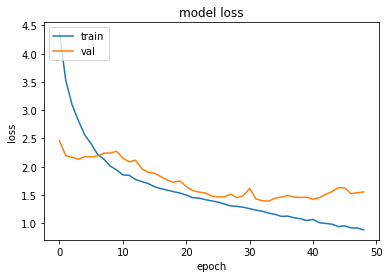

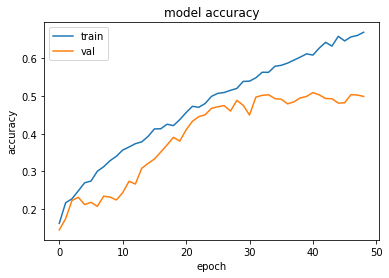

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3900420665740967 , and Val Acc happened to be 0.5033000111579895
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5090000033378601 and Val Loss happened to be  1.4230815172195435
TestLoss:  1.375164270401001  TestAcc: 0.506600022315979
frog 0.667
ship 0.635
automobile 0.602
truck 0.566
airplane 0.544
dog 0.542
horse 0.523
deer 0.455
bird 0.343
cat 0.189


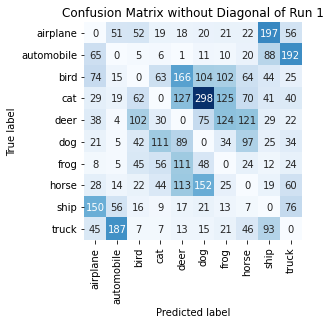

Summing down the rows, for Predictions of each Class that were wrong:  [458. 356. 353. 345. 655. 744. 475. 471. 548. 529.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  166.0 times
Summing across the columns, for total number of that True Class misidentified:  [456. 398. 657. 811. 545. 458. 333. 477. 365. 434.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  124.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0

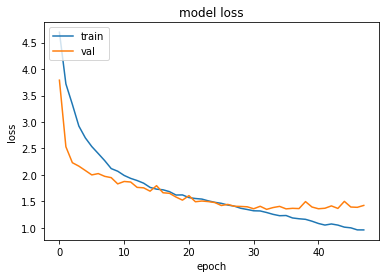

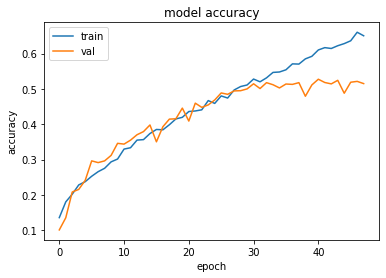

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3484159708023071 , and Val Acc happened to be 0.517799973487854
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5274999737739563 and Val Loss happened to be  1.3597842454910278
TestLoss:  1.3209755420684814  TestAcc: 0.5273000001907349
frog 0.782
truck 0.678
ship 0.657
automobile 0.637
horse 0.569
dog 0.512
airplane 0.464
deer 0.374
bird 0.33
cat 0.27


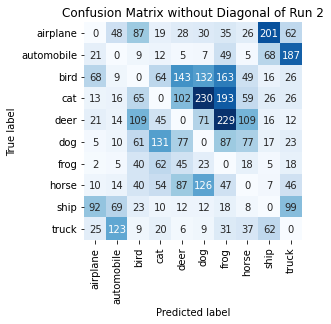

Summing down the rows, for Predictions of each Class that were wrong:  [257. 308. 443. 417. 505. 640. 852. 388. 418. 499.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  143.0 times
Summing across the columns, for total number of that True Class misidentified:  [536. 363. 670. 730. 626. 488. 218. 431. 343. 322.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  229.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brigh

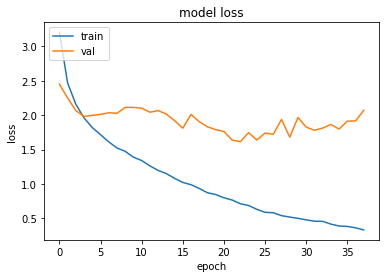

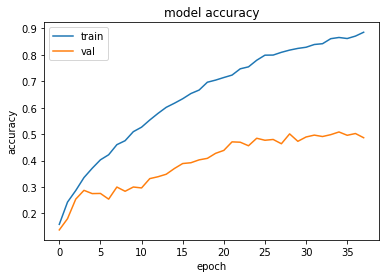

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.614432454109192 , and Val Acc happened to be 0.46950000524520874
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5083000063896179 and Val Loss happened to be  1.7973079681396484
TestLoss:  1.5640066862106323  TestAcc: 0.4830999970436096
frog 0.84
ship 0.761
truck 0.611
horse 0.563
deer 0.538
automobile 0.44
dog 0.325
airplane 0.324
bird 0.23
cat 0.199


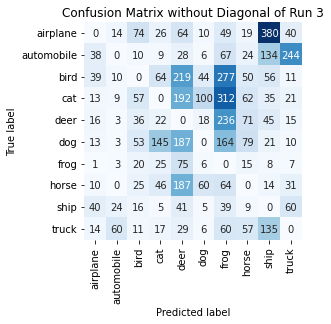

Summing down the rows, for Predictions of each Class that were wrong:  [ 184.  126.  302.  359. 1022.  255. 1268.  386.  828.  439.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  219.0 times
Summing across the columns, for total number of that True Class misidentified:  [676. 560. 770. 801. 462. 675. 160. 437. 239. 389.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  236.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

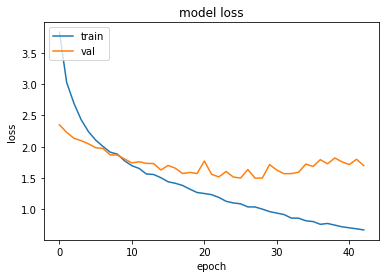

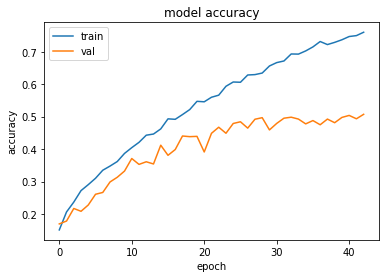

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.4991192817687988 , and Val Acc happened to be 0.492000013589859
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5072000026702881 and Val Loss happened to be  1.69900643825531
TestLoss:  1.4783365726470947  TestAcc: 0.49000000953674316
truck 0.791
frog 0.691
ship 0.628
dog 0.58
horse 0.541
automobile 0.408
airplane 0.373
deer 0.34
cat 0.295
bird 0.253


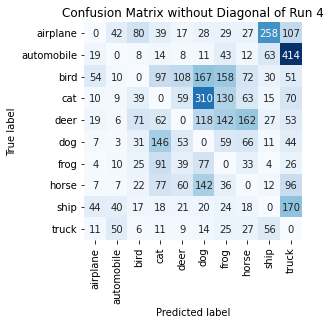

Summing down the rows, for Predictions of each Class that were wrong:  [ 175.  177.  299.  555.  374.  887.  646.  480.  476. 1031.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  108.0 times
Summing across the columns, for total number of that True Class misidentified:  [627. 592. 747. 705. 660. 420. 309. 459. 372. 209.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  162.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )


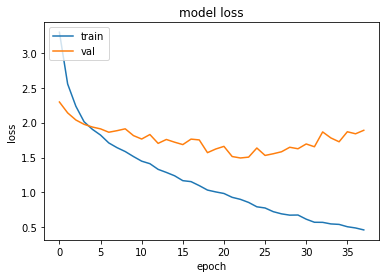

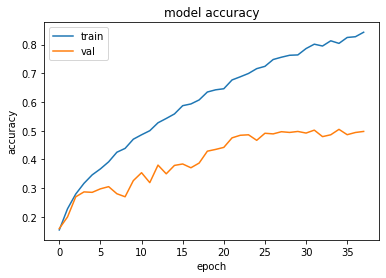

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4931793212890625 , and Val Acc happened to be 0.48429998755455017
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5048999786376953 and Val Loss happened to be  1.7254252433776855
TestLoss:  1.469467043876648  TestAcc: 0.4970000088214874
ship 0.749
frog 0.665
truck 0.614
automobile 0.544
deer 0.498
dog 0.452
horse 0.418
cat 0.38
bird 0.369
airplane 0.281


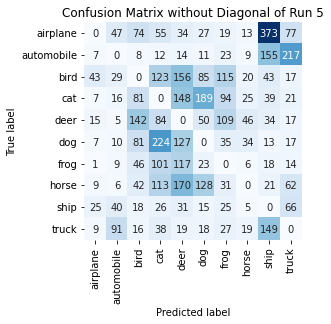

Summing down the rows, for Predictions of each Class that were wrong:  [123. 253. 508. 776. 816. 546. 478. 177. 845. 508.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [719. 456. 631. 620. 502. 548. 335. 582. 251. 386.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  142.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Brigh

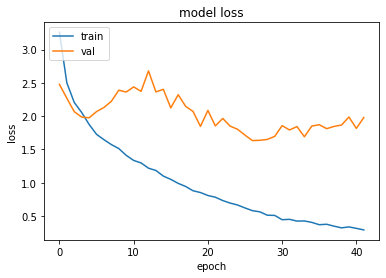

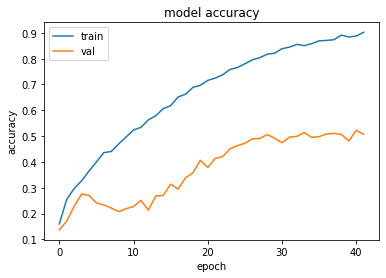

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.633243203163147 , and Val Acc happened to be 0.4893999993801117
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5220999717712402 and Val Loss happened to be  1.816221833229065
TestLoss:  1.5950772762298584  TestAcc: 0.49070000648498535
frog 0.867
ship 0.65
truck 0.609
airplane 0.569
automobile 0.508
deer 0.461
horse 0.45
dog 0.324
bird 0.313
cat 0.156


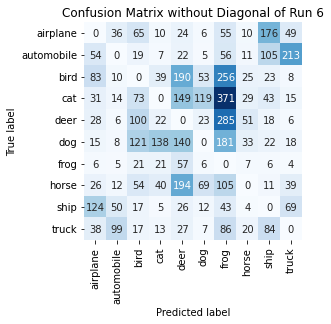

Summing down the rows, for Predictions of each Class that were wrong:  [ 405.  240.  487.  295.  829.  300. 1438.  190.  488.  421.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  194.0 times
Summing across the columns, for total number of that True Class misidentified:  [431. 492. 687. 844. 539. 676. 133. 550. 350. 391.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  285.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 ,

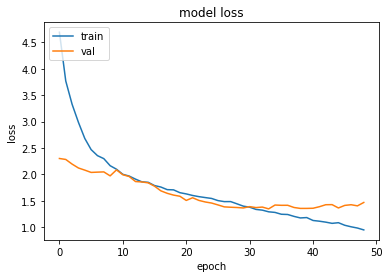

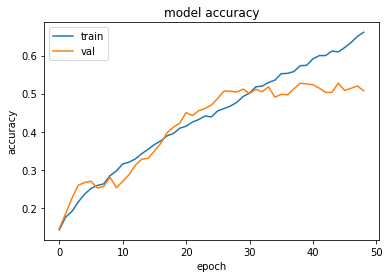

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3464127779006958 , and Val Acc happened to be 0.517799973487854
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5275999903678894 and Val Loss happened to be  1.3636558055877686
TestLoss:  1.3379374742507935  TestAcc: 0.5128999948501587
frog 0.763
ship 0.745
automobile 0.619
horse 0.565
truck 0.551
dog 0.522
deer 0.441
airplane 0.396
cat 0.283
bird 0.244


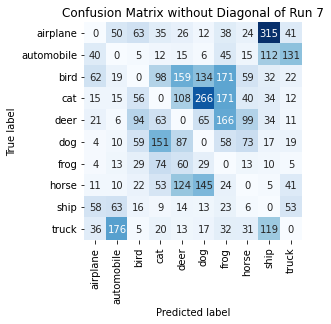

Summing down the rows, for Predictions of each Class that were wrong:  [251. 362. 349. 515. 606. 687. 728. 360. 678. 335.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  159.0 times
Summing across the columns, for total number of that True Class misidentified:  [604. 381. 756. 717. 559. 478. 237. 435. 255. 449.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  166.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0

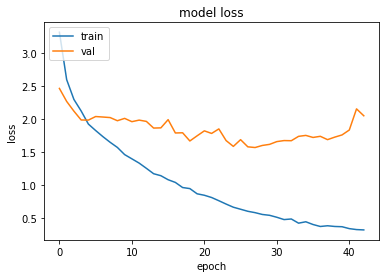

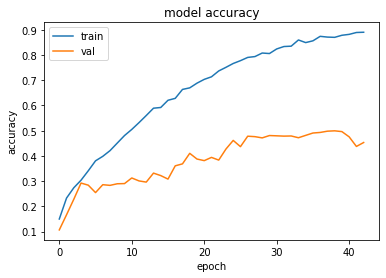

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.565502643585205 , and Val Acc happened to be 0.4763999879360199
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.49950000643730164 and Val Loss happened to be  1.72300386428833
TestLoss:  1.5320361852645874  TestAcc: 0.48420000076293945
ship 0.74
frog 0.735
truck 0.681
deer 0.526
horse 0.475
automobile 0.429
dog 0.396
bird 0.328
airplane 0.315
cat 0.217


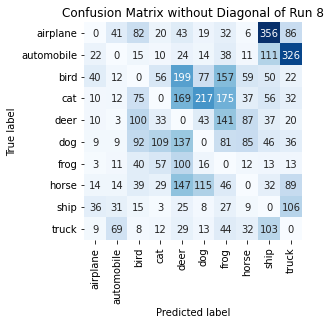

Summing down the rows, for Predictions of each Class that were wrong:  [153. 202. 466. 329. 873. 522. 741. 338. 804. 730.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  199.0 times
Summing across the columns, for total number of that True Class misidentified:  [685. 571. 672. 783. 474. 604. 265. 525. 260. 319.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  141.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

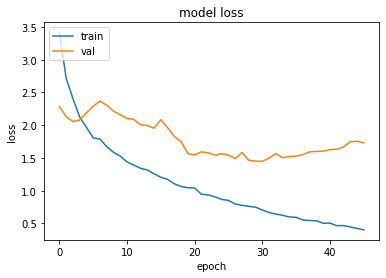

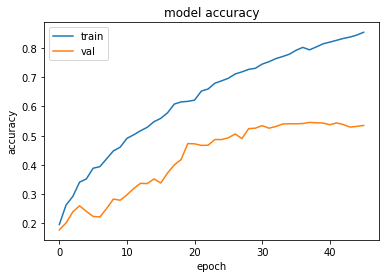

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.4484319686889648 , and Val Acc happened to be 0.534600019454956
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5455999970436096 and Val Loss happened to be  1.5944089889526367
TestLoss:  1.4047232866287231  TestAcc: 0.5440999865531921
frog 0.785
horse 0.698
ship 0.687
truck 0.627
automobile 0.562
deer 0.521
airplane 0.516
dog 0.435
bird 0.318
cat 0.292


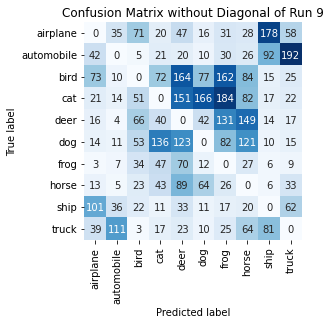

Summing down the rows, for Predictions of each Class that were wrong:  [322. 233. 328. 407. 720. 408. 688. 601. 419. 433.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  164.0 times
Summing across the columns, for total number of that True Class misidentified:  [484. 438. 682. 708. 479. 565. 215. 302. 313. 373.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  149.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise: 

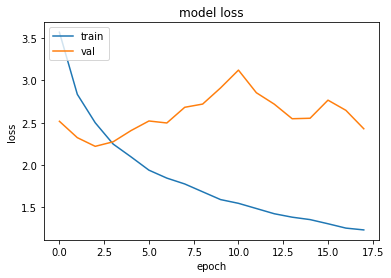

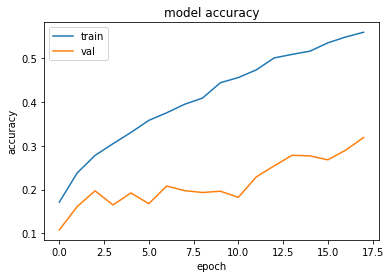

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.2209413051605225 , and Val Acc happened to be 0.19699999690055847
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.3188000023365021 and Val Loss happened to be  2.42828369140625
TestLoss:  2.217940330505371  TestAcc: 0.1972000002861023
airplane 0.753
cat 0.517
ship 0.321
dog 0.115
bird 0.101
deer 0.099
frog 0.065
horse 0.001
automobile 0.0
truck 0.0


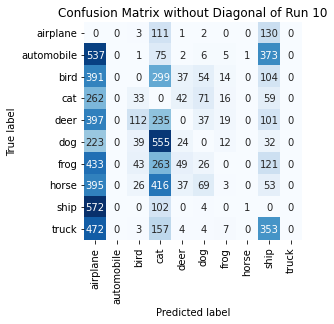

Summing down the rows, for Predictions of each Class that were wrong:  [3.682e+03 0.000e+00 2.600e+02 2.213e+03 1.960e+02 2.730e+02 7.600e+01
 2.000e+00 1.326e+03 0.000e+00]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  49.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 247. 1000.  899.  483.  901.  885.  935.  999.  679. 1000.]
For example, the model misclassified true 4's (deer) as label   0 airplane  a total of  397.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 10

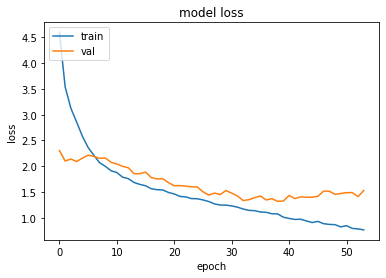

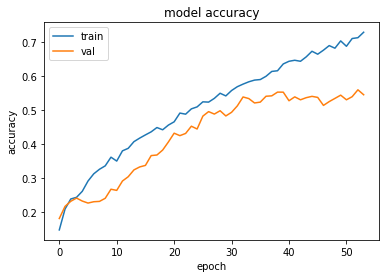

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3196362257003784 , and Val Acc happened to be 0.5521000027656555
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.558899998664856 and Val Loss happened to be  1.4106426239013672
TestLoss:  1.2912864685058594  TestAcc: 0.5501999855041504
ship 0.739
frog 0.707
automobile 0.683
truck 0.611
horse 0.598
dog 0.545
deer 0.544
airplane 0.455
bird 0.361
cat 0.259


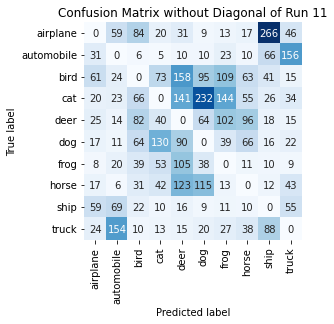

Summing down the rows, for Predictions of each Class that were wrong:  [262. 380. 404. 386. 689. 592. 481. 366. 543. 395.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  158.0 times
Summing across the columns, for total number of that True Class misidentified:  [545. 317. 639. 741. 456. 455. 293. 402. 261. 389.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  102.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16 

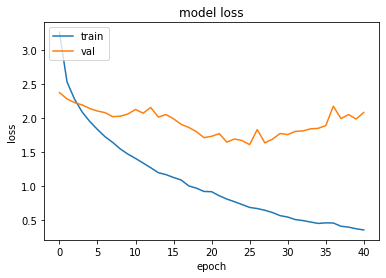

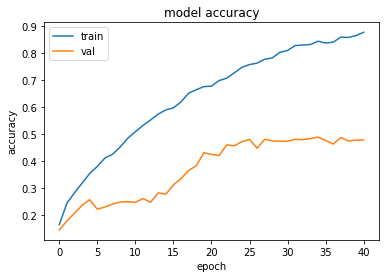

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6097108125686646 , and Val Acc happened to be 0.4799000024795532
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.48840001225471497 and Val Loss happened to be  1.8491235971450806
TestLoss:  1.5732628107070923  TestAcc: 0.4787999987602234
frog 0.757
ship 0.702
truck 0.549
horse 0.546
deer 0.498
automobile 0.48
airplane 0.41
dog 0.36
cat 0.289
bird 0.197


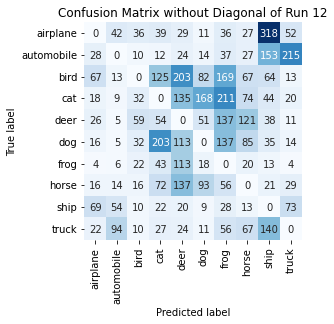

Summing down the rows, for Predictions of each Class that were wrong:  [266. 242. 227. 597. 798. 457. 867. 501. 826. 431.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  203.0 times
Summing across the columns, for total number of that True Class misidentified:  [590. 520. 803. 711. 502. 640. 243. 454. 298. 451.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  137.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.0 , 0.0 )


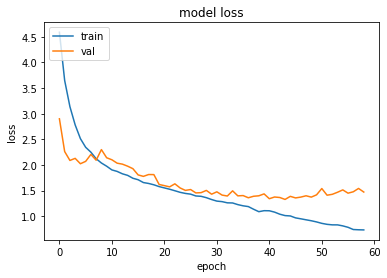

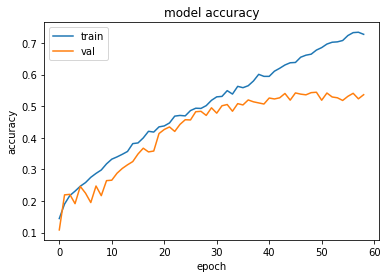

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.327466368675232 , and Val Acc happened to be 0.5400999784469604
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5440000295639038 and Val Loss happened to be  1.417158603668213
TestLoss:  1.3278796672821045  TestAcc: 0.5338000059127808
ship 0.746
frog 0.728
automobile 0.701
horse 0.622
airplane 0.532
truck 0.439
deer 0.431
dog 0.431
bird 0.391
cat 0.317


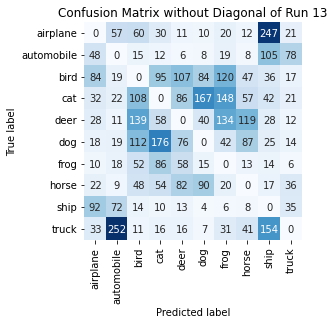

Summing down the rows, for Predictions of each Class that were wrong:  [367. 479. 559. 537. 455. 425. 540. 392. 668. 240.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  107.0 times
Summing across the columns, for total number of that True Class misidentified:  [468. 299. 609. 683. 569. 569. 272. 378. 254. 561.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  139.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

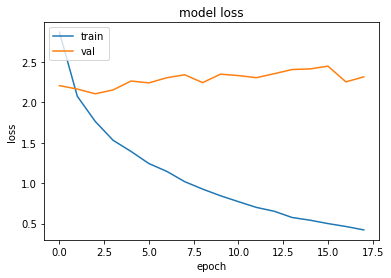

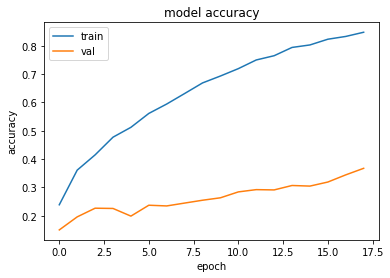

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.10675311088562 , and Val Acc happened to be 0.22669999301433563
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.36739999055862427 and Val Loss happened to be  2.3166346549987793
TestLoss:  2.101546287536621  TestAcc: 0.22859999537467957
dog 0.672
deer 0.585
airplane 0.575
ship 0.207
cat 0.173
frog 0.043
bird 0.011
truck 0.008
horse 0.007
automobile 0.005


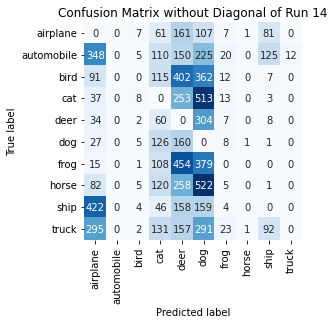

Summing down the rows, for Predictions of each Class that were wrong:  [1351.    0.   39.  877. 2153. 2862.   99.    3.  318.   12.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  454.0 times
Summing across the columns, for total number of that True Class misidentified:  [425. 995. 989. 827. 415. 328. 957. 993. 793. 992.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  304.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

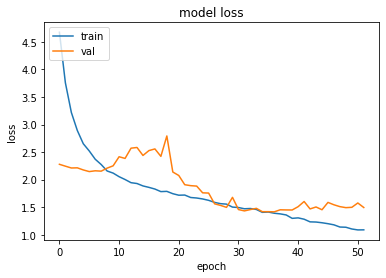

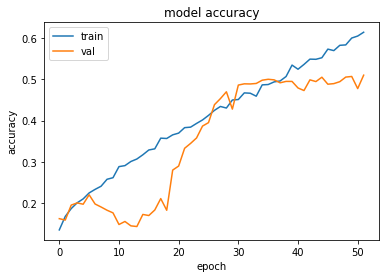

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.41605806350708 , and Val Acc happened to be 0.4984999895095825
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5098000168800354 and Val Loss happened to be  1.4943407773971558
TestLoss:  1.4066904783248901  TestAcc: 0.4984000027179718
frog 0.703
ship 0.651
automobile 0.647
horse 0.573
bird 0.483
truck 0.462
airplane 0.434
dog 0.414
deer 0.33
cat 0.287


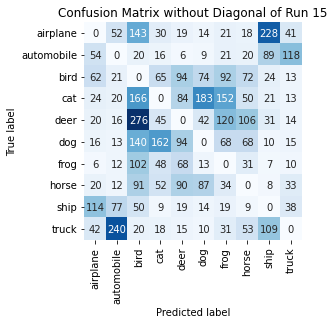

Summing down the rows, for Predictions of each Class that were wrong:  [ 358.  463. 1008.  445.  489.  446.  558.  427.  527.  295.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  94.0 times
Summing across the columns, for total number of that True Class misidentified:  [566. 353. 517. 713. 670. 586. 297. 427. 349. 538.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  276.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0

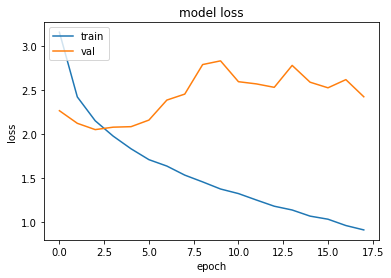

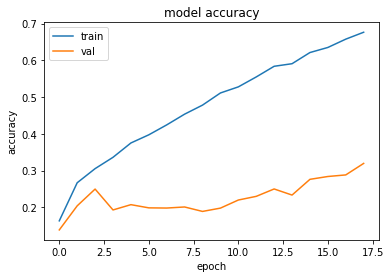

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.0511629581451416 , and Val Acc happened to be 0.24979999661445618
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.319599986076355 and Val Loss happened to be  2.424293279647827
TestLoss:  2.049870252609253  TestAcc: 0.25949999690055847
ship 0.634
frog 0.628
airplane 0.51
dog 0.338
truck 0.138
bird 0.129
horse 0.116
deer 0.078
cat 0.016
automobile 0.008


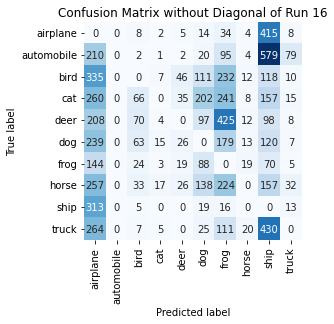

Summing down the rows, for Predictions of each Class that were wrong:  [2230.    0.  278.   54.  159.  714. 1557.   92. 2144.  177.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  46.0 times
Summing across the columns, for total number of that True Class misidentified:  [490. 992. 871. 984. 922. 662. 372. 884. 366. 862.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  425.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

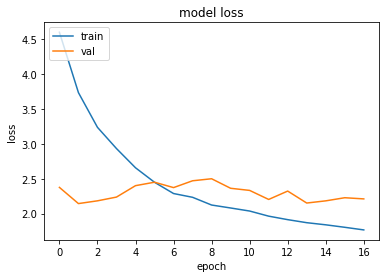

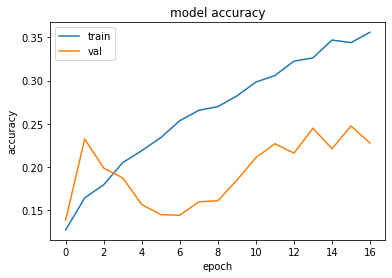

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  2.143596649169922 , and Val Acc happened to be 0.23240000009536743
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.2475000023841858 and Val Loss happened to be  2.227532386779785
TestLoss:  2.1409964561462402  TestAcc: 0.2378000020980835
dog 0.535
airplane 0.534
frog 0.477
cat 0.251
ship 0.18
horse 0.169
bird 0.167
truck 0.032
deer 0.024
automobile 0.009


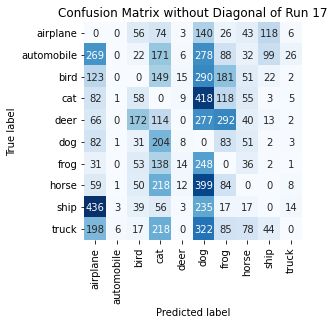

Summing down the rows, for Predictions of each Class that were wrong:  [1346.   12.  498. 1342.   70. 2607.  974.  403.  303.   67.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  15.0 times
Summing across the columns, for total number of that True Class misidentified:  [466. 991. 833. 749. 976. 465. 523. 831. 820. 968.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  292.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )

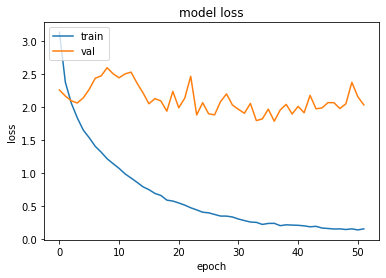

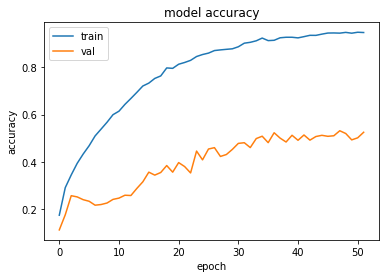

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.787115216255188 , and Val Acc happened to be 0.5230000019073486
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.531499981880188 and Val Loss happened to be  1.9787120819091797
TestLoss:  1.7529418468475342  TestAcc: 0.5342000126838684
frog 0.781
automobile 0.652
truck 0.615
ship 0.605
dog 0.575
airplane 0.559
horse 0.552
cat 0.349
bird 0.335
deer 0.319


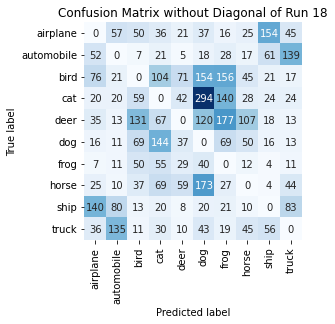

Summing down the rows, for Predictions of each Class that were wrong:  [407. 358. 427. 546. 282. 899. 653. 339. 358. 389.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  71.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 348. 665. 651. 681. 425. 219. 448. 395. 385.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  177.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

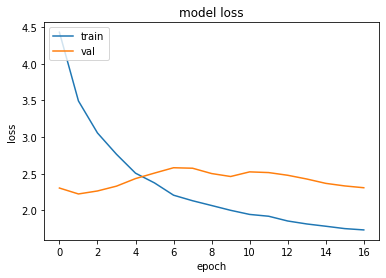

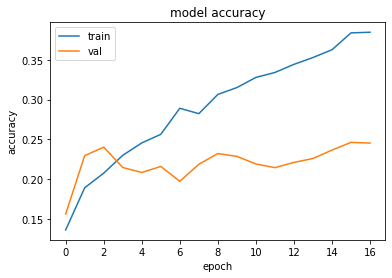

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  2.223616123199463 , and Val Acc happened to be 0.22939999401569366
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.24609999358654022 and Val Loss happened to be  2.333228826522827
TestLoss:  2.2210264205932617  TestAcc: 0.22550000250339508
dog 0.73
ship 0.514
airplane 0.243
bird 0.223
frog 0.21
horse 0.182
cat 0.089
deer 0.063
truck 0.001
automobile 0.0


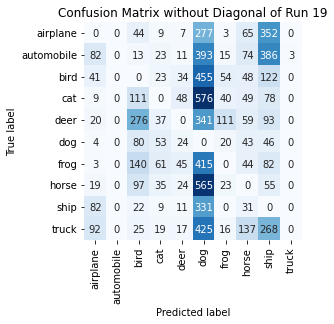

Summing down the rows, for Predictions of each Class that were wrong:  [3.520e+02 0.000e+00 8.080e+02 2.690e+02 2.210e+02 3.778e+03 2.820e+02
 5.500e+02 1.482e+03 3.000e+00]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  48.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 757. 1000.  777.  911.  937.  270.  790.  818.  486.  999.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  341.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
Z

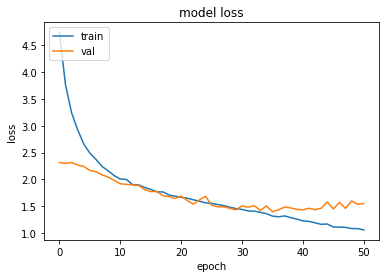

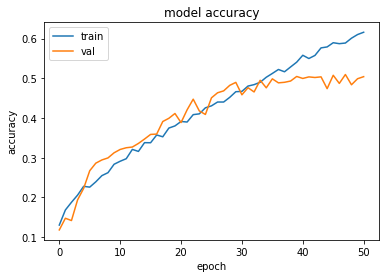

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3980865478515625 , and Val Acc happened to be 0.4986000061035156
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5095000267028809 and Val Loss happened to be  1.459868311882019
TestLoss:  1.3730262517929077  TestAcc: 0.5059000253677368
frog 0.743
ship 0.669
automobile 0.621
truck 0.613
horse 0.546
dog 0.517
airplane 0.422
deer 0.401
cat 0.327
bird 0.2


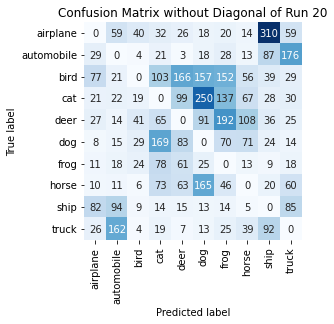

Summing down the rows, for Predictions of each Class that were wrong:  [291. 416. 176. 574. 523. 750. 684. 386. 645. 496.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  166.0 times
Summing across the columns, for total number of that True Class misidentified:  [578. 379. 800. 673. 599. 483. 257. 454. 331. 387.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

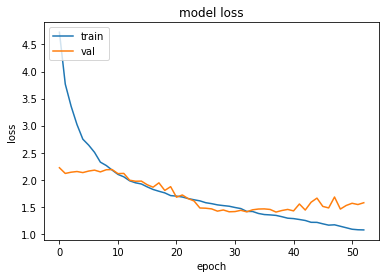

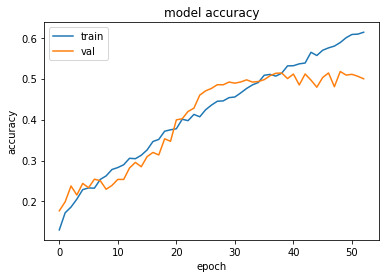

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.4020404815673828 , and Val Acc happened to be 0.5131999850273132
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5174999833106995 and Val Loss happened to be  1.457391381263733
TestLoss:  1.3913792371749878  TestAcc: 0.5121999979019165
frog 0.703
automobile 0.696
ship 0.666
horse 0.62
truck 0.591
airplane 0.548
deer 0.452
dog 0.416
bird 0.252
cat 0.178


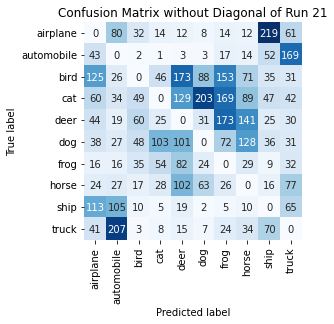

Summing down the rows, for Predictions of each Class that were wrong:  [504. 541. 256. 284. 636. 429. 653. 528. 509. 538.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [452. 304. 748. 822. 548. 584. 297. 380. 334. 409.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  173.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

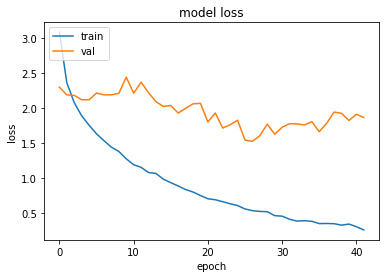

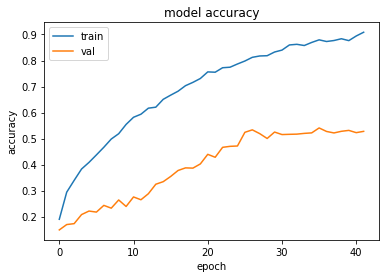

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.5255047082901 , and Val Acc happened to be 0.5335000157356262
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5407999753952026 and Val Loss happened to be  1.6633816957473755
TestLoss:  1.5029079914093018  TestAcc: 0.5349000096321106
ship 0.756
truck 0.703
frog 0.696
horse 0.647
airplane 0.515
automobile 0.507
dog 0.437
deer 0.43
bird 0.38
cat 0.278


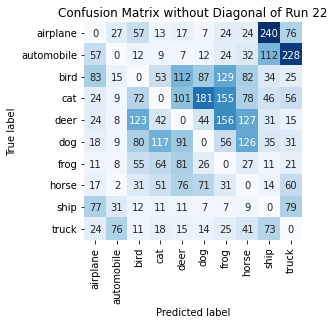

Summing down the rows, for Predictions of each Class that were wrong:  [335. 185. 453. 378. 511. 449. 607. 546. 596. 591.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [485. 493. 620. 722. 570. 563. 304. 353. 244. 297.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  156.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 , 0.08 )


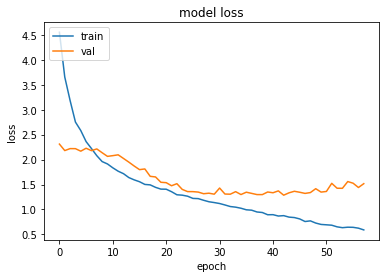

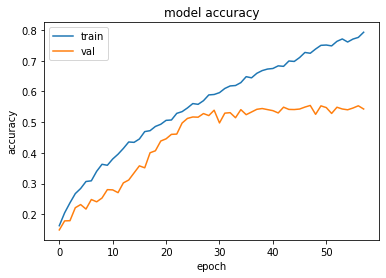

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  42 when  Val Loss was:  1.2861753702163696 , and Val Acc happened to be 0.5486999750137329
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5543000102043152 and Val Loss happened to be  1.338426113128662
TestLoss:  1.2594105005264282  TestAcc: 0.5569999814033508
ship 0.725
truck 0.719
frog 0.685
horse 0.628
automobile 0.602
deer 0.544
dog 0.52
airplane 0.448
bird 0.362
cat 0.337


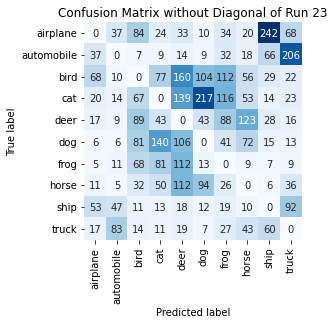

Summing down the rows, for Predictions of each Class that were wrong:  [234. 222. 453. 448. 713. 509. 495. 404. 467. 485.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  160.0 times
Summing across the columns, for total number of that True Class misidentified:  [552. 398. 638. 663. 456. 480. 315. 372. 275. 281.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  123.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

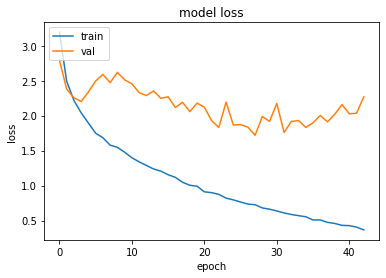

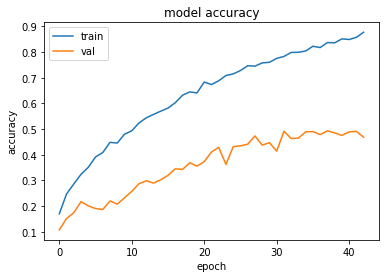

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.7196464538574219 , and Val Acc happened to be 0.4729999899864197
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.49300000071525574 and Val Loss happened to be  1.9115148782730103
TestLoss:  1.6646957397460938  TestAcc: 0.48350000381469727
frog 0.791
ship 0.727
truck 0.605
horse 0.492
dog 0.474
airplane 0.462
deer 0.41
automobile 0.371
bird 0.256
cat 0.247


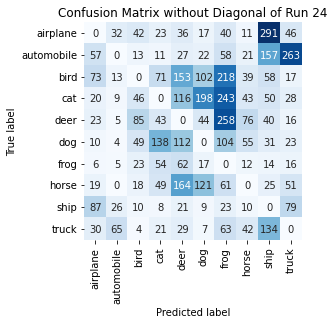

Summing down the rows, for Predictions of each Class that were wrong:  [ 325.  159.  290.  418.  720.  537. 1068.  309.  800.  539.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  164.0 times
Summing across the columns, for total number of that True Class misidentified:  [538. 629. 744. 753. 590. 526. 209. 508. 273. 395.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  258.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

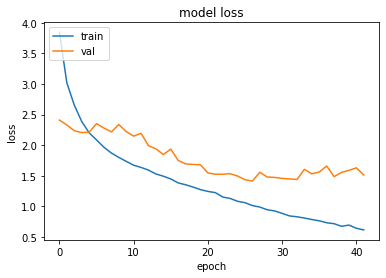

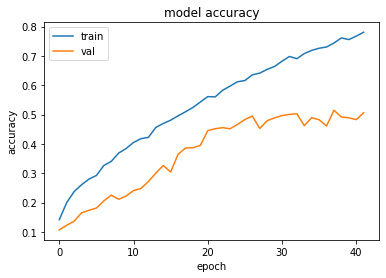

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.415891170501709 , and Val Acc happened to be 0.49540001153945923
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5149000287055969 and Val Loss happened to be  1.4876630306243896
TestLoss:  1.3794801235198975  TestAcc: 0.5008000135421753
ship 0.703
frog 0.688
truck 0.671
dog 0.613
automobile 0.576
horse 0.484
deer 0.408
airplane 0.364
bird 0.34
cat 0.161


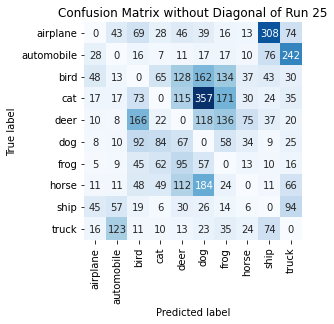

Summing down the rows, for Predictions of each Class that were wrong:  [188. 291. 539. 333. 617. 983. 605. 242. 592. 602.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [636. 424. 660. 839. 592. 387. 312. 516. 297. 329.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  166.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

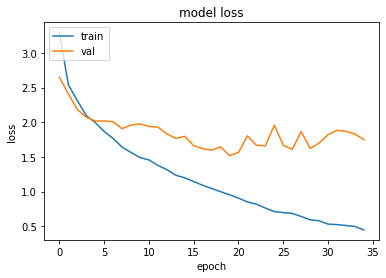

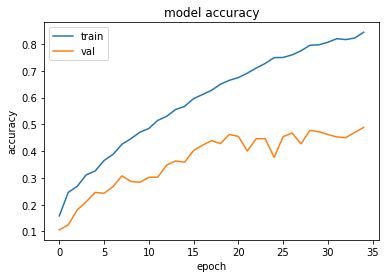

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.5197975635528564 , and Val Acc happened to be 0.4625999927520752
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.48899999260902405 and Val Loss happened to be  1.7477165460586548
TestLoss:  1.5057766437530518  TestAcc: 0.460099995136261
truck 0.65
frog 0.642
ship 0.616
airplane 0.536
dog 0.448
automobile 0.418
bird 0.417
horse 0.367
deer 0.318
cat 0.189


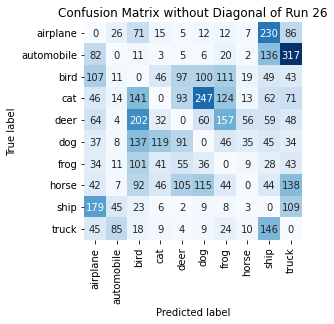

Summing down the rows, for Predictions of each Class that were wrong:  [636. 211. 796. 317. 457. 594. 546. 154. 799. 889.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  105.0 times
Summing across the columns, for total number of that True Class misidentified:  [464. 582. 583. 811. 682. 552. 358. 633. 384. 350.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  202.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

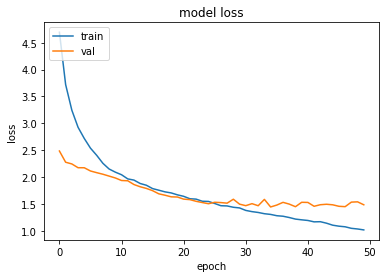

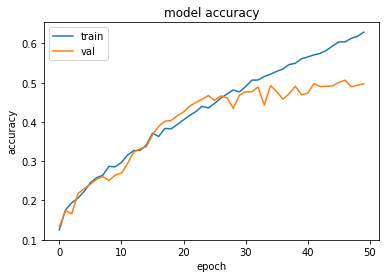

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4446135759353638 , and Val Acc happened to be 0.49239999055862427
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5065000057220459 and Val Loss happened to be  1.4505385160446167
TestLoss:  1.4244612455368042  TestAcc: 0.4984999895095825
automobile 0.652
horse 0.65
frog 0.632
ship 0.576
dog 0.526
truck 0.526
deer 0.489
airplane 0.43
cat 0.262
bird 0.242


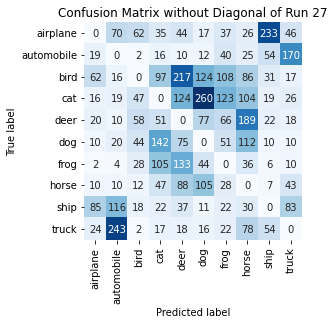

Summing down the rows, for Predictions of each Class that were wrong:  [248. 508. 273. 532. 746. 666. 497. 686. 436. 423.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  217.0 times
Summing across the columns, for total number of that True Class misidentified:  [570. 348. 758. 738. 511. 474. 368. 350. 424. 474.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  189.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

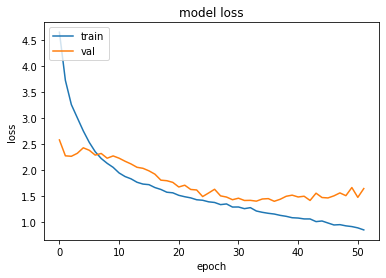

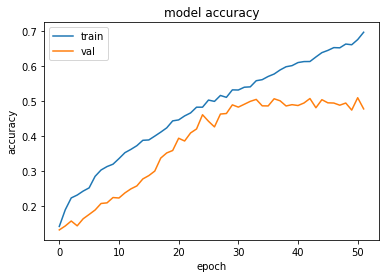

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3937909603118896 , and Val Acc happened to be 0.5065000057220459
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5095000267028809 and Val Loss happened to be  1.469454288482666
TestLoss:  1.3680968284606934  TestAcc: 0.5127000212669373
frog 0.741
ship 0.659
automobile 0.622
truck 0.621
deer 0.516
horse 0.512
airplane 0.505
dog 0.445
bird 0.339
cat 0.167


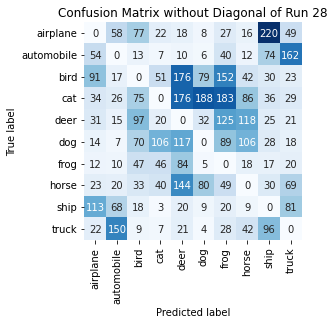

Summing down the rows, for Predictions of each Class that were wrong:  [394. 371. 439. 302. 766. 411. 713. 449. 556. 472.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [495. 378. 661. 833. 484. 555. 259. 488. 341. 379.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  125.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


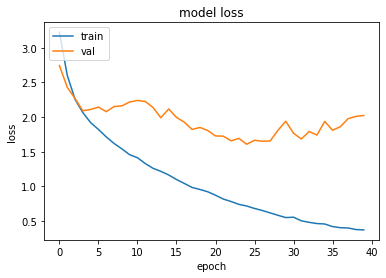

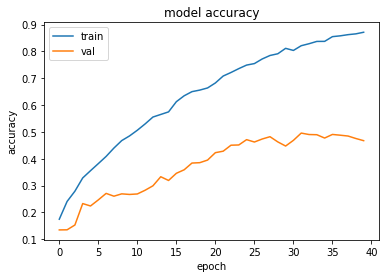

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6080604791641235 , and Val Acc happened to be 0.47110000252723694
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.49559998512268066 and Val Loss happened to be  1.684340476989746
TestLoss:  1.5862805843353271  TestAcc: 0.46720001101493835
frog 0.679
airplane 0.607
ship 0.565
bird 0.527
automobile 0.472
truck 0.441
dog 0.404
deer 0.36
horse 0.34
cat 0.277


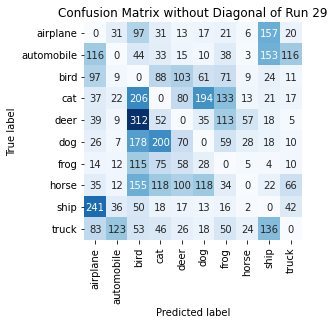

Summing down the rows, for Predictions of each Class that were wrong:  [ 688.  261. 1210.  661.  482.  494.  535.  147.  553.  297.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  103.0 times
Summing across the columns, for total number of that True Class misidentified:  [393. 528. 473. 723. 640. 596. 321. 660. 435. 559.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  312.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.1

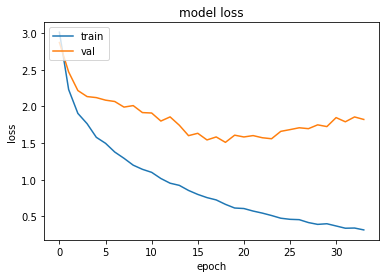

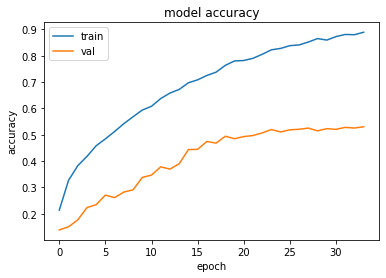

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5100938081741333 , and Val Acc happened to be 0.4943000078201294
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5302000045776367 and Val Loss happened to be  1.8227254152297974
TestLoss:  1.4809197187423706  TestAcc: 0.5004000067710876
ship 0.755
frog 0.706
truck 0.615
deer 0.538
airplane 0.473
automobile 0.459
dog 0.439
horse 0.393
bird 0.357
cat 0.269


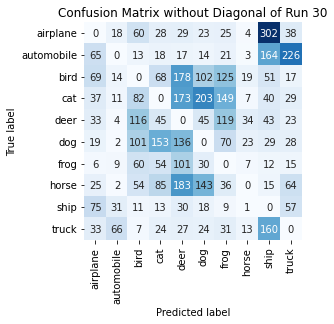

Summing down the rows, for Predictions of each Class that were wrong:  [362. 157. 504. 488. 874. 602. 585. 111. 816. 497.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  183.0 times
Summing across the columns, for total number of that True Class misidentified:  [527. 541. 643. 731. 462. 561. 294. 607. 245. 385.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  119.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

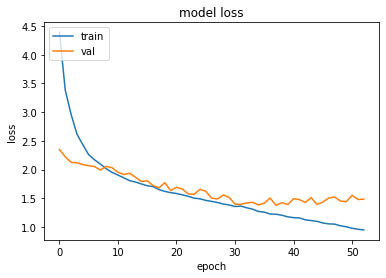

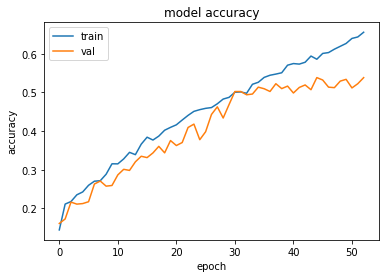

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3777592182159424 , and Val Acc happened to be 0.5223000049591064
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.538100004196167 and Val Loss happened to be  1.3932439088821411
TestLoss:  1.3589411973953247  TestAcc: 0.527999997138977
frog 0.813
ship 0.697
automobile 0.674
horse 0.622
truck 0.616
airplane 0.506
deer 0.378
dog 0.37
cat 0.306
bird 0.298


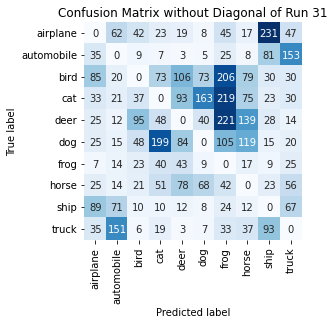

Summing down the rows, for Predictions of each Class that were wrong:  [359. 380. 291. 470. 441. 381. 920. 503. 533. 442.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  106.0 times
Summing across the columns, for total number of that True Class misidentified:  [494. 326. 702. 694. 622. 630. 187. 378. 303. 384.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  221.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

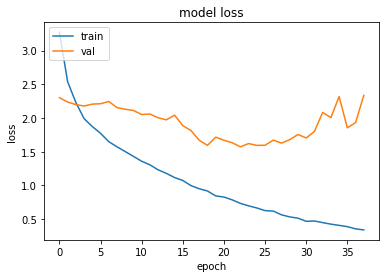

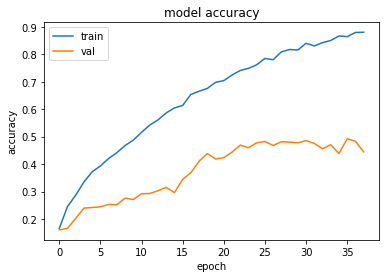

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5720211267471313 , and Val Acc happened to be 0.4690000116825104
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.49219998717308044 and Val Loss happened to be  1.854306697845459
TestLoss:  1.559208631515503  TestAcc: 0.4745999872684479
frog 0.789
ship 0.613
horse 0.575
truck 0.551
airplane 0.506
automobile 0.465
bird 0.406
deer 0.384
dog 0.319
cat 0.138


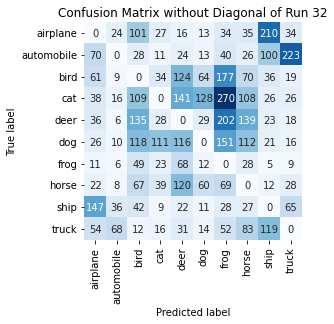

Summing down the rows, for Predictions of each Class that were wrong:  [ 465.  183.  661.  298.  662.  344. 1023.  628.  552.  438.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [494. 535. 594. 862. 616. 681. 211. 425. 387. 449.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  202.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )


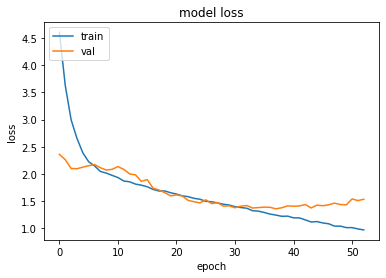

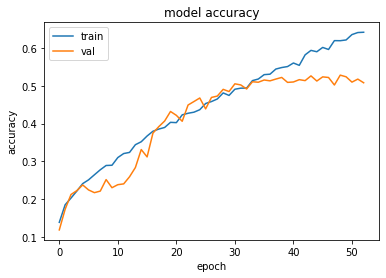

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3609627485275269 , and Val Acc happened to be 0.5177000164985657
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5281000137329102 and Val Loss happened to be  1.4401782751083374
TestLoss:  1.3317331075668335  TestAcc: 0.5253000259399414
ship 0.741
frog 0.698
automobile 0.642
truck 0.628
dog 0.582
horse 0.561
deer 0.537
airplane 0.42
bird 0.273
cat 0.171


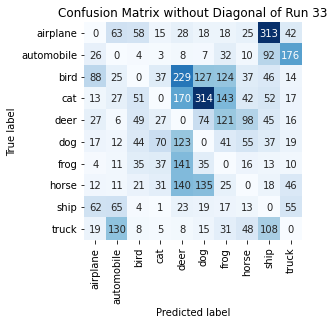

Summing down the rows, for Predictions of each Class that were wrong:  [268. 350. 274. 226. 870. 744. 552. 344. 724. 395.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  229.0 times
Summing across the columns, for total number of that True Class misidentified:  [580. 358. 727. 829. 463. 418. 302. 439. 259. 372.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  121.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

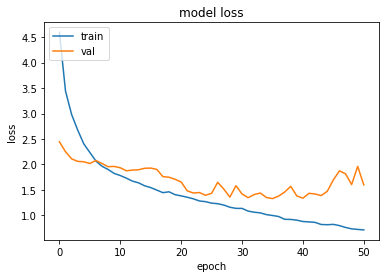

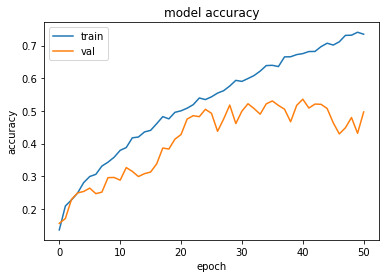

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.328914999961853 , and Val Acc happened to be 0.5303999781608582
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5357000231742859 and Val Loss happened to be  1.337080955505371
TestLoss:  1.299375057220459  TestAcc: 0.5394999980926514
frog 0.787
ship 0.739
truck 0.727
horse 0.597
dog 0.577
deer 0.537
automobile 0.536
airplane 0.361
bird 0.306
cat 0.228


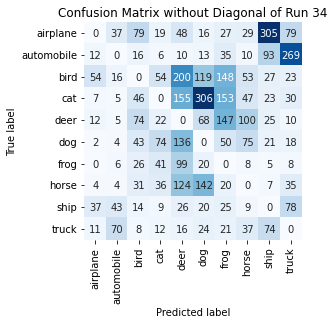

Summing down the rows, for Predictions of each Class that were wrong:  [139. 190. 337. 273. 814. 728. 626. 368. 580. 550.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  200.0 times
Summing across the columns, for total number of that True Class misidentified:  [639. 464. 694. 772. 463. 423. 213. 403. 261. 273.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  147.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

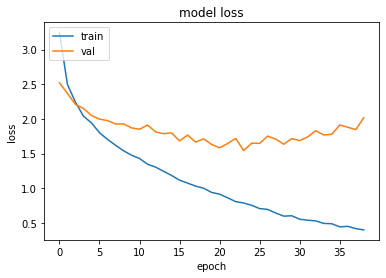

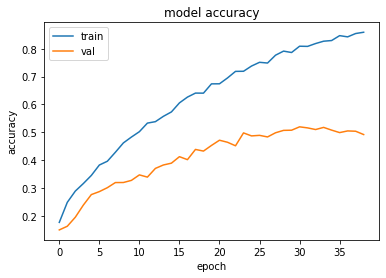

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5439215898513794 , and Val Acc happened to be 0.4975999891757965
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5194000005722046 and Val Loss happened to be  1.6866984367370605
TestLoss:  1.5269007682800293  TestAcc: 0.49559998512268066
frog 0.808
ship 0.765
truck 0.637
horse 0.484
deer 0.482
automobile 0.436
dog 0.361
airplane 0.341
bird 0.332
cat 0.31


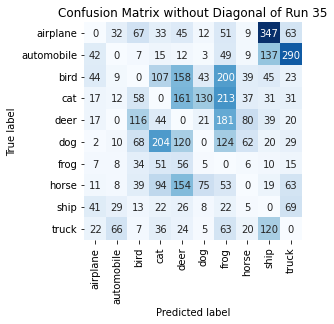

Summing down the rows, for Predictions of each Class that were wrong:  [203. 174. 409. 606. 756. 302. 956. 267. 768. 603.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  161.0 times
Summing across the columns, for total number of that True Class misidentified:  [659. 564. 668. 690. 518. 639. 192. 516. 235. 363.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  181.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

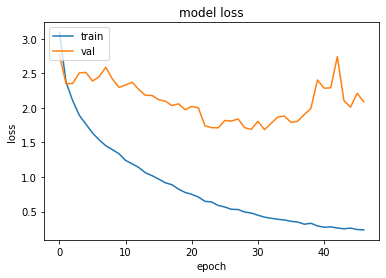

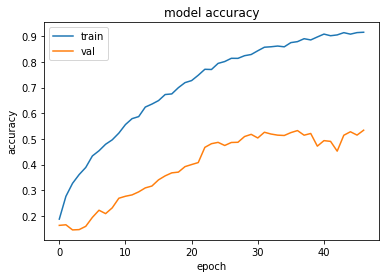

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.6865347623825073 , and Val Acc happened to be 0.526199996471405
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5342000126838684 and Val Loss happened to be  2.0883142948150635
TestLoss:  1.6853208541870117  TestAcc: 0.5249000191688538
frog 0.749
automobile 0.639
ship 0.631
airplane 0.617
deer 0.539
truck 0.525
dog 0.496
horse 0.494
bird 0.335
cat 0.224


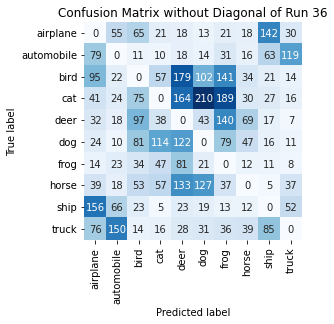

Summing down the rows, for Predictions of each Class that were wrong:  [556. 386. 453. 365. 766. 580. 687. 277. 387. 294.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [383. 361. 665. 776. 461. 504. 251. 506. 369. 475.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  140.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 

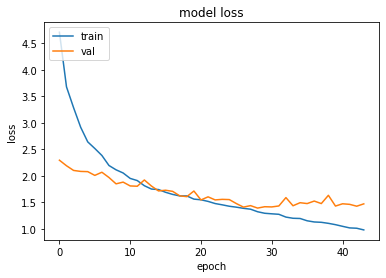

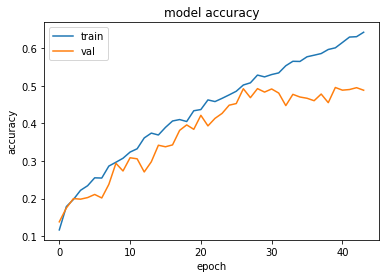

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.3912752866744995 , and Val Acc happened to be 0.49219998717308044
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.4952000081539154 and Val Loss happened to be  1.42943274974823
TestLoss:  1.387487530708313  TestAcc: 0.491100013256073
ship 0.791
frog 0.773
truck 0.585
horse 0.505
dog 0.491
automobile 0.475
deer 0.375
bird 0.321
airplane 0.32
cat 0.275


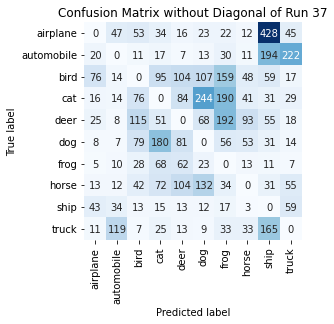

Summing down the rows, for Predictions of each Class that were wrong:  [ 217.  265.  424.  557.  484.  631.  733.  307. 1005.  466.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [680. 525. 679. 725. 625. 509. 227. 495. 209. 415.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

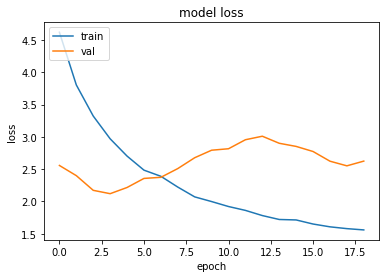

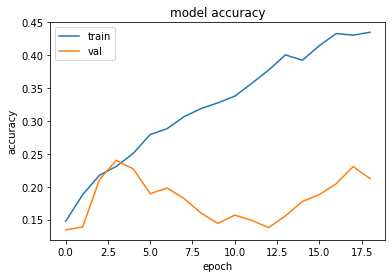

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.119530200958252 , and Val Acc happened to be 0.2402999997138977
Additionally, the best val acc epoch happened to be  3 when val acc was:  0.2402999997138977 and Val Loss happened to be  2.119530200958252
TestLoss:  2.1146960258483887  TestAcc: 0.2386000007390976
ship 0.77
deer 0.661
dog 0.411
airplane 0.166
cat 0.143
frog 0.129
horse 0.081
bird 0.016
truck 0.008
automobile 0.001


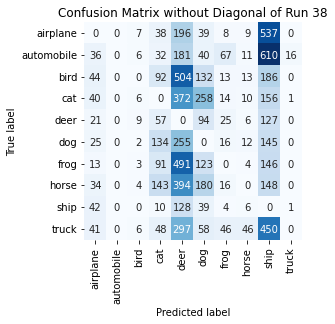

Summing down the rows, for Predictions of each Class that were wrong:  [ 296.    0.   43.  645. 2818.  963.  209.  117. 2505.   18.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  504.0 times
Summing across the columns, for total number of that True Class misidentified:  [834. 999. 984. 857. 339. 589. 871. 919. 230. 992.]
For example, the model misclassified true 4's (deer) as label   8 ship  a total of  127.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

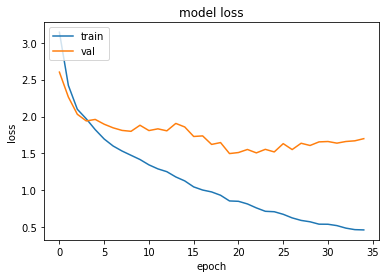

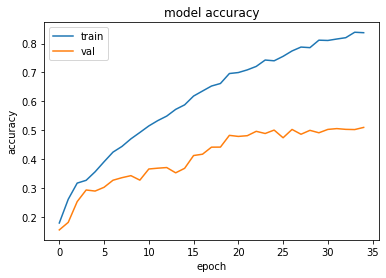

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.4988758563995361 , and Val Acc happened to be 0.4828999936580658
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5102999806404114 and Val Loss happened to be  1.7007924318313599
TestLoss:  1.4643086194992065  TestAcc: 0.4880000054836273
frog 0.746
ship 0.683
automobile 0.67
deer 0.511
airplane 0.501
truck 0.449
dog 0.418
horse 0.345
bird 0.302
cat 0.255


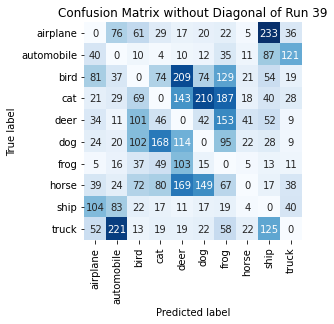

Summing down the rows, for Predictions of each Class that were wrong:  [400. 517. 487. 486. 795. 561. 765. 149. 649. 311.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  209.0 times
Summing across the columns, for total number of that True Class misidentified:  [499. 330. 698. 745. 489. 582. 254. 655. 317. 551.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  153.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

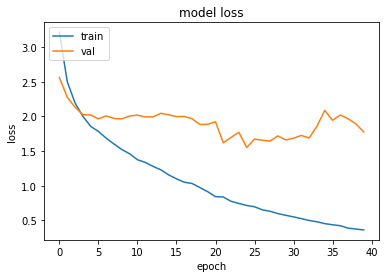

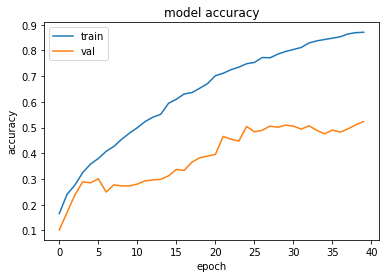

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5523608922958374 , and Val Acc happened to be 0.5041999816894531
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5235000252723694 and Val Loss happened to be  1.7764748334884644
TestLoss:  1.5222748517990112  TestAcc: 0.5084999799728394
frog 0.799
truck 0.731
ship 0.63
automobile 0.572
airplane 0.509
deer 0.509
horse 0.425
dog 0.403
cat 0.268
bird 0.239


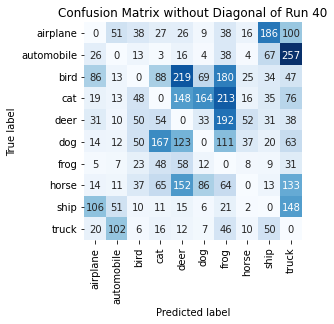

Summing down the rows, for Predictions of each Class that were wrong:  [321. 270. 275. 479. 769. 390. 903. 170. 445. 893.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  219.0 times
Summing across the columns, for total number of that True Class misidentified:  [491. 428. 761. 732. 491. 597. 201. 575. 370. 269.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


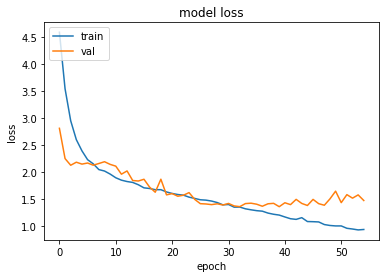

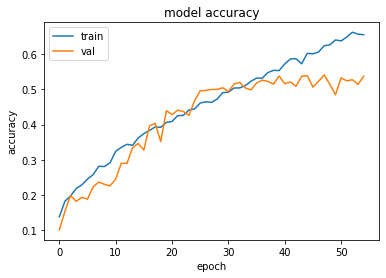

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3611372709274292 , and Val Acc happened to be 0.5375000238418579
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5407000184059143 and Val Loss happened to be  1.3880300521850586
TestLoss:  1.3281413316726685  TestAcc: 0.5425999760627747
ship 0.797
frog 0.761
truck 0.625
horse 0.611
automobile 0.589
dog 0.564
deer 0.498
airplane 0.476
bird 0.326
cat 0.179


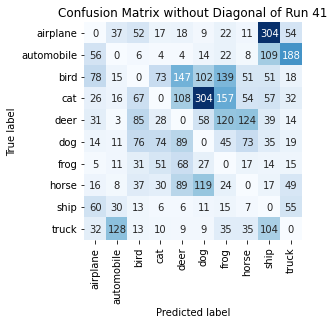

Summing down the rows, for Predictions of each Class that were wrong:  [318. 259. 380. 293. 538. 653. 579. 380. 730. 444.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [524. 411. 674. 821. 502. 436. 239. 389. 203. 375.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  124.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.1

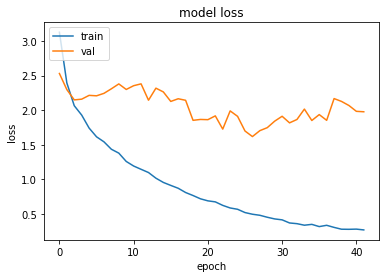

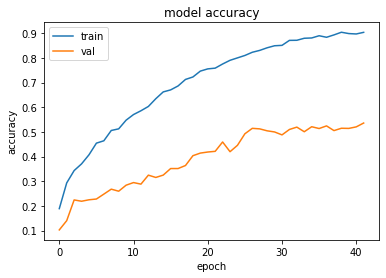

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.617484211921692 , and Val Acc happened to be 0.5145000219345093
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5360000133514404 and Val Loss happened to be  1.9759372472763062
TestLoss:  1.5681679248809814  TestAcc: 0.5185999870300293
frog 0.806
ship 0.735
airplane 0.571
horse 0.51
truck 0.477
dog 0.456
automobile 0.451
deer 0.436
bird 0.416
cat 0.328


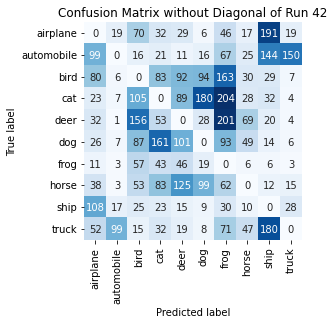

Summing down the rows, for Predictions of each Class that were wrong:  [469. 162. 584. 531. 527. 459. 937. 281. 628. 236.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [429. 549. 584. 672. 564. 544. 194. 490. 265. 523.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  201.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

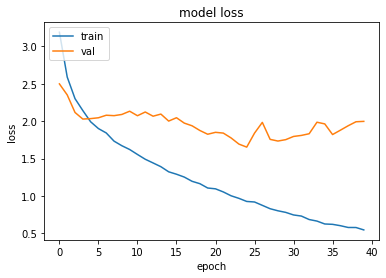

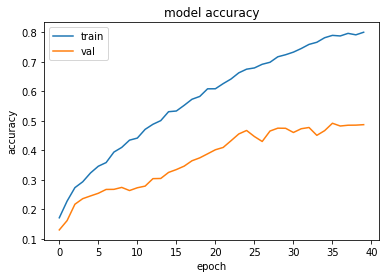

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6528240442276 , and Val Acc happened to be 0.4674000144004822
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.4918999969959259 and Val Loss happened to be  1.8206013441085815
TestLoss:  1.6083396673202515  TestAcc: 0.4733999967575073
frog 0.796
ship 0.633
automobile 0.598
truck 0.593
airplane 0.472
deer 0.466
horse 0.442
bird 0.308
dog 0.281
cat 0.145


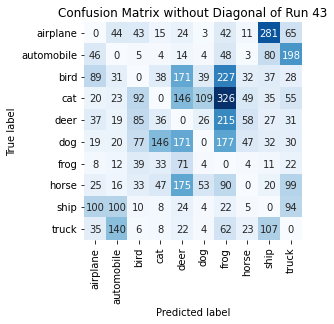

Summing down the rows, for Predictions of each Class that were wrong:  [ 379.  405.  390.  335.  818.  246. 1209.  232.  630.  622.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  175.0 times
Summing across the columns, for total number of that True Class misidentified:  [528. 402. 692. 855. 534. 719. 204. 558. 367. 407.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  215.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

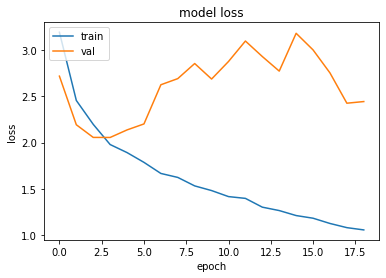

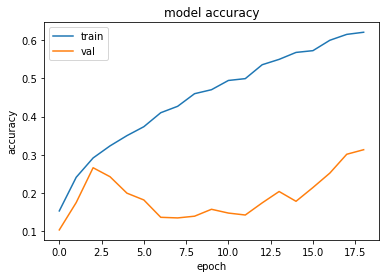

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.054431915283203 , and Val Acc happened to be 0.24269999563694
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.313400000333786 and Val Loss happened to be  2.441831350326538
TestLoss:  2.0413668155670166  TestAcc: 0.24539999663829803
frog 0.802
ship 0.777
deer 0.338
cat 0.236
airplane 0.07
dog 0.066
horse 0.066
bird 0.053
truck 0.024
automobile 0.022


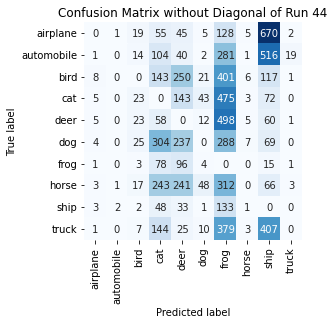

Summing down the rows, for Predictions of each Class that were wrong:  [  31.    4.  133. 1177. 1110.  146. 2895.   31. 1992.   27.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  250.0 times
Summing across the columns, for total number of that True Class misidentified:  [930. 978. 947. 764. 662. 934. 198. 934. 223. 976.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  498.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

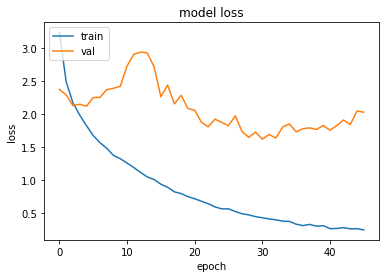

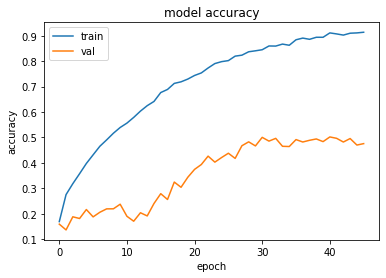

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.6166452169418335 , and Val Acc happened to be 0.5005999803543091
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5022000074386597 and Val Loss happened to be  1.7530083656311035
TestLoss:  1.6075409650802612  TestAcc: 0.4997999966144562
frog 0.724
ship 0.664
truck 0.562
automobile 0.56
deer 0.449
horse 0.445
airplane 0.436
dog 0.405
bird 0.381
cat 0.372


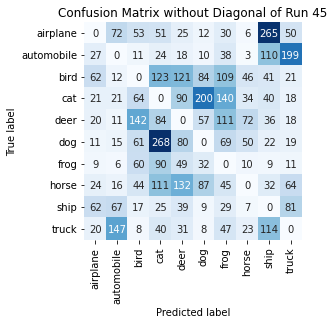

Summing down the rows, for Predictions of each Class that were wrong:  [256. 367. 460. 816. 585. 499. 618. 251. 669. 481.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  132.0 times
Summing across the columns, for total number of that True Class misidentified:  [564. 440. 619. 628. 551. 595. 276. 555. 336. 438.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  142.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

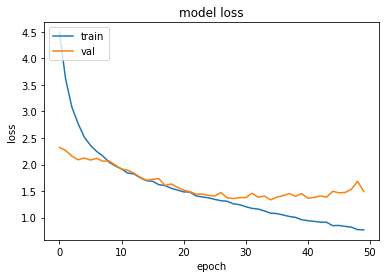

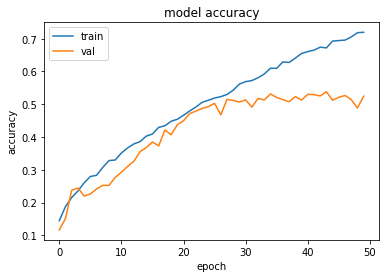

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.334535002708435 , and Val Acc happened to be 0.531499981880188
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5382000207901001 and Val Loss happened to be  1.3852882385253906
TestLoss:  1.3181301355361938  TestAcc: 0.532800018787384
frog 0.713
ship 0.687
horse 0.655
truck 0.615
automobile 0.602
deer 0.545
airplane 0.512
dog 0.498
bird 0.299
cat 0.202


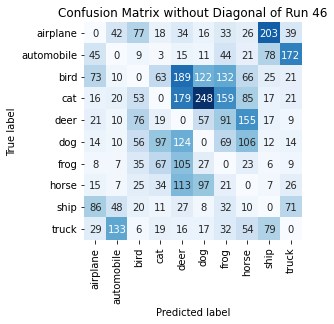

Summing down the rows, for Predictions of each Class that were wrong:  [307. 287. 357. 331. 802. 603. 613. 546. 444. 382.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [488. 398. 701. 798. 455. 502. 287. 345. 313. 385.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  155.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

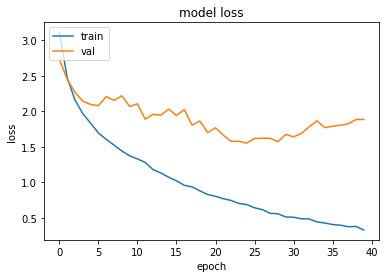

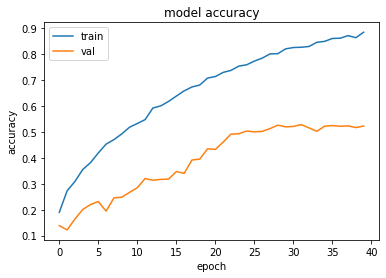

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5527654886245728 , and Val Acc happened to be 0.503600001335144
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5284000039100647 and Val Loss happened to be  1.6880748271942139
TestLoss:  1.525160789489746  TestAcc: 0.5133000016212463
frog 0.725
ship 0.68
truck 0.552
airplane 0.549
horse 0.507
automobile 0.502
bird 0.499
dog 0.489
deer 0.412
cat 0.218


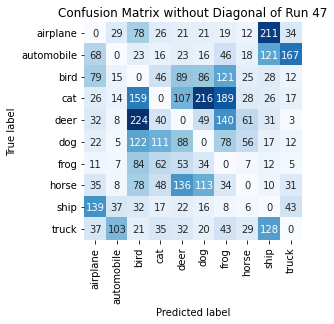

Summing down the rows, for Predictions of each Class that were wrong:  [449. 226. 821. 401. 571. 571. 678. 242. 584. 324.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  136.0 times
Summing across the columns, for total number of that True Class misidentified:  [451. 498. 501. 782. 588. 511. 275. 493. 320. 448.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  224.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


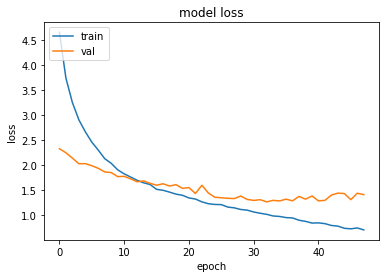

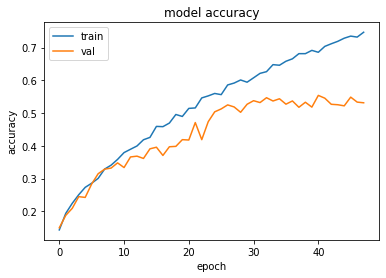

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.2642912864685059 , and Val Acc happened to be 0.5468000173568726
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5539000034332275 and Val Loss happened to be  1.2845512628555298
TestLoss:  1.2559072971343994  TestAcc: 0.553600013256073
frog 0.726
truck 0.72
ship 0.689
horse 0.653
automobile 0.553
airplane 0.546
dog 0.531
deer 0.399
cat 0.362
bird 0.357


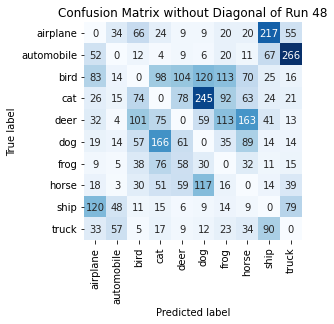

Summing down the rows, for Predictions of each Class that were wrong:  [392. 194. 394. 526. 393. 607. 446. 491. 503. 518.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [454. 447. 643. 638. 601. 469. 274. 347. 311. 280.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  163.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

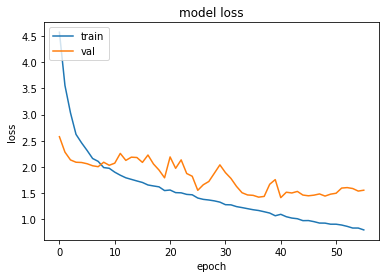

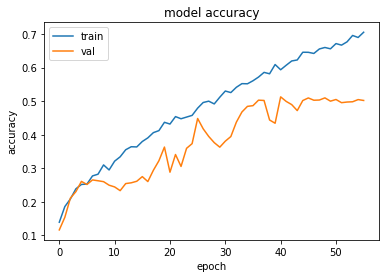

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.4164345264434814 , and Val Acc happened to be 0.5127999782562256
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5127999782562256 and Val Loss happened to be  1.4164345264434814
TestLoss:  1.4029099941253662  TestAcc: 0.5038999915122986
ship 0.795
truck 0.662
dog 0.622
frog 0.582
automobile 0.504
horse 0.474
airplane 0.432
deer 0.429
bird 0.363
cat 0.176


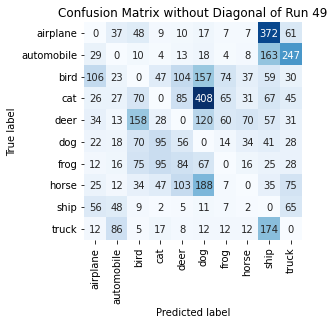

Summing down the rows, for Predictions of each Class that were wrong:  [322. 280. 479. 344. 468. 998. 250. 217. 993. 610.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [568. 496. 637. 824. 571. 378. 418. 526. 205. 338.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  158.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

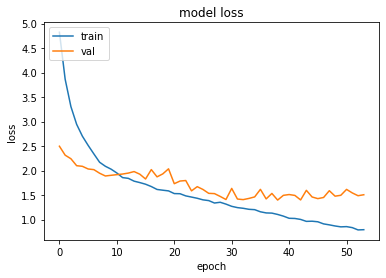

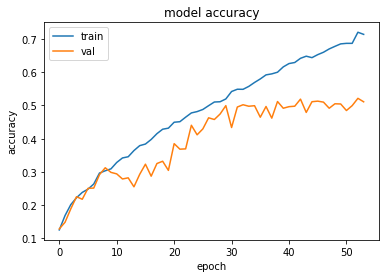

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3975841999053955 , and Val Acc happened to be 0.5116999745368958
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5213000178337097 and Val Loss happened to be  1.4864006042480469
TestLoss:  1.3948659896850586  TestAcc: 0.5081999897956848
ship 0.691
dog 0.674
truck 0.638
automobile 0.63
frog 0.605
horse 0.532
deer 0.447
airplane 0.367
bird 0.265
cat 0.233


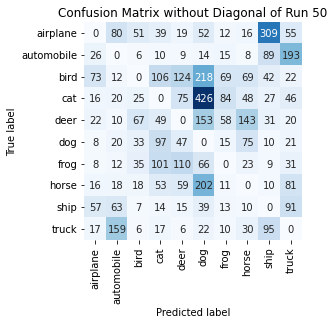

Summing down the rows, for Predictions of each Class that were wrong:  [ 243.  394.  248.  486.  464. 1192.  287.  422.  622.  560.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  124.0 times
Summing across the columns, for total number of that True Class misidentified:  [633. 370. 735. 767. 553. 326. 395. 468. 309. 362.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  153.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 11 November 2021 22:02:18  (subtract ~5-hours for local Hour), and file is called  runs_GroupE_final.pkl


In [ ]:
#@title Group E: 51 Run Results
run_through_runs(ds=make_unbatched(train_E),     ds_noalb=train_E_noalb,   dstitle="E" , showpictures= False)

filename will be:  runs_GroupF .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


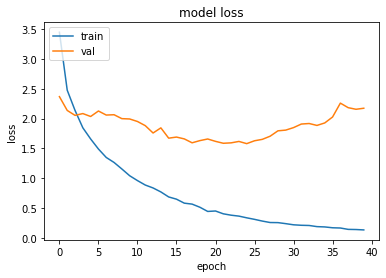

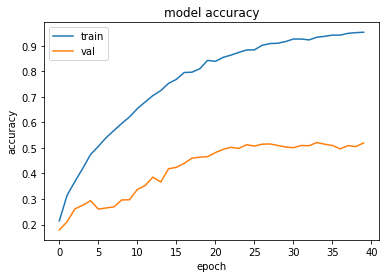

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.580420970916748 , and Val Acc happened to be 0.5123999714851379
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5210999846458435 and Val Loss happened to be  1.8853707313537598
TestLoss:  1.5466347932815552  TestAcc: 0.5188999772071838
frog 0.71
truck 0.668
ship 0.651
horse 0.538
deer 0.53
airplane 0.517
automobile 0.516
dog 0.393
bird 0.342
cat 0.324


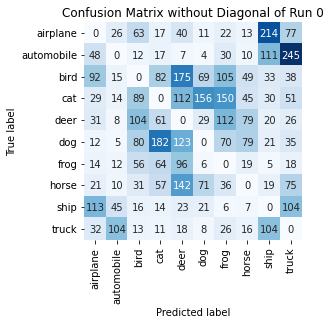

Summing down the rows, for Predictions of each Class that were wrong:  [392. 239. 464. 505. 736. 375. 557. 317. 557. 669.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  175.0 times
Summing across the columns, for total number of that True Class misidentified:  [483. 484. 658. 676. 470. 607. 290. 462. 349. 332.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  112.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0

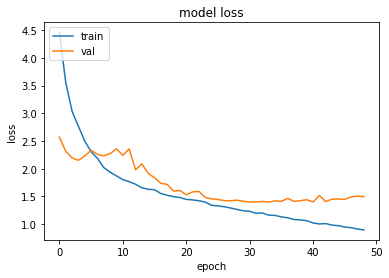

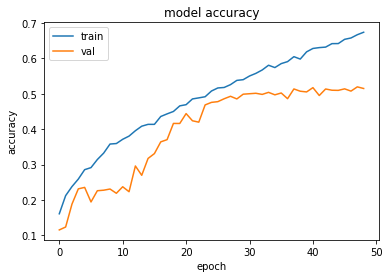

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3989487886428833 , and Val Acc happened to be 0.5040000081062317
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5195000171661377 and Val Loss happened to be  1.5057106018066406
TestLoss:  1.3750829696655273  TestAcc: 0.5063999891281128
frog 0.722
horse 0.615
ship 0.593
automobile 0.589
airplane 0.575
truck 0.538
dog 0.515
deer 0.482
bird 0.233
cat 0.202


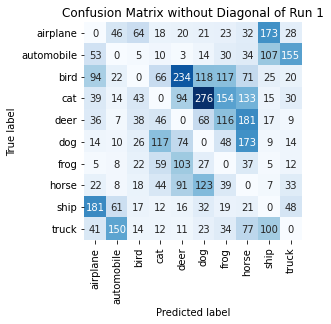

Summing down the rows, for Predictions of each Class that were wrong:  [485. 326. 247. 384. 646. 702. 580. 759. 458. 349.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  234.0 times
Summing across the columns, for total number of that True Class misidentified:  [425. 411. 767. 798. 518. 485. 278. 385. 407. 462.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  181.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 

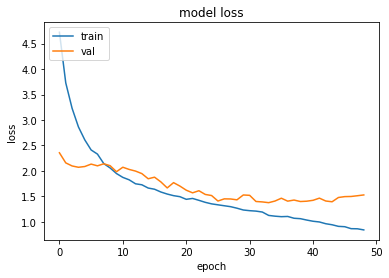

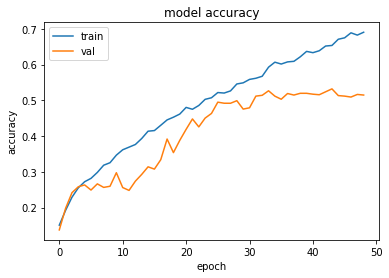

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3754786252975464 , and Val Acc happened to be 0.5267000198364258
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5321000218391418 and Val Loss happened to be  1.3930655717849731
TestLoss:  1.340206265449524  TestAcc: 0.525600016117096
frog 0.718
ship 0.674
automobile 0.657
truck 0.64
horse 0.604
dog 0.499
airplane 0.49
deer 0.445
cat 0.3
bird 0.229


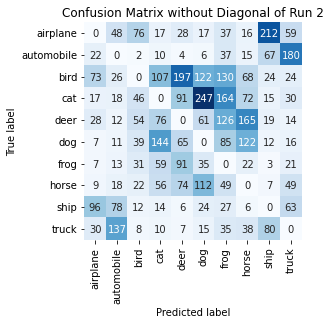

Summing down the rows, for Predictions of each Class that were wrong:  [289. 361. 290. 493. 563. 639. 690. 524. 439. 456.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  197.0 times
Summing across the columns, for total number of that True Class misidentified:  [510. 343. 771. 700. 555. 501. 282. 396. 326. 360.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  165.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brig

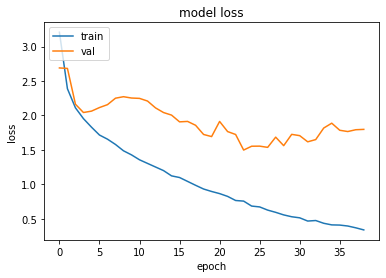

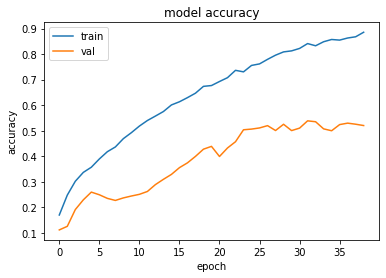

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.4970437288284302 , and Val Acc happened to be 0.5034999847412109
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5385000109672546 and Val Loss happened to be  1.6168543100357056
TestLoss:  1.4595404863357544  TestAcc: 0.5044999718666077
frog 0.671
deer 0.657
truck 0.654
horse 0.593
ship 0.578
automobile 0.488
cat 0.442
airplane 0.431
dog 0.331
bird 0.2


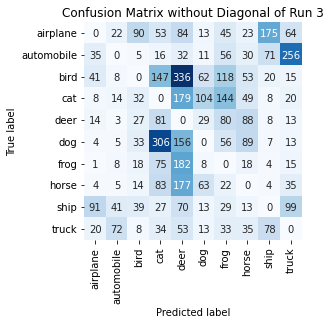

Summing down the rows, for Predictions of each Class that were wrong:  [ 218.  178.  266.  822. 1269.  316.  583.  398.  375.  530.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  336.0 times
Summing across the columns, for total number of that True Class misidentified:  [569. 512. 800. 558. 343. 669. 329. 407. 422. 346.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  88.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

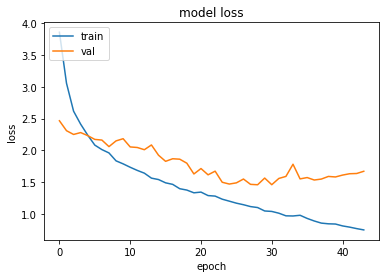

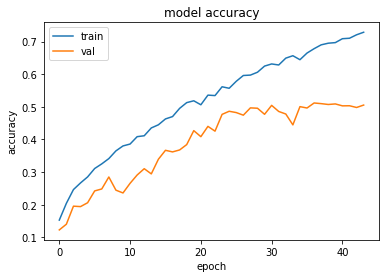

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.4599655866622925 , and Val Acc happened to be 0.4957999885082245
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.511900007724762 and Val Loss happened to be  1.5345897674560547
TestLoss:  1.4348719120025635  TestAcc: 0.5037000179290771
ship 0.689
truck 0.581
dog 0.551
frog 0.541
horse 0.518
deer 0.484
bird 0.472
automobile 0.47
airplane 0.459
cat 0.272


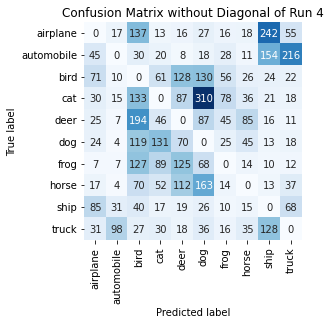

Summing down the rows, for Predictions of each Class that were wrong:  [335. 193. 877. 459. 583. 865. 288. 285. 621. 457.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [541. 530. 528. 728. 516. 449. 459. 482. 311. 419.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  194.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

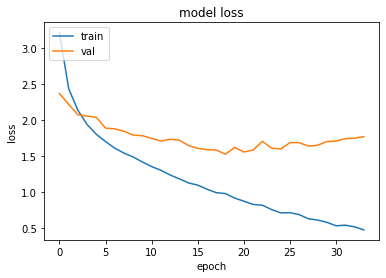

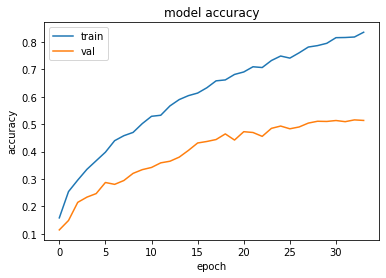

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5260835886001587 , and Val Acc happened to be 0.4643000066280365
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.515500009059906 and Val Loss happened to be  1.7493482828140259
TestLoss:  1.5124576091766357  TestAcc: 0.46880000829696655
ship 0.766
deer 0.751
frog 0.592
automobile 0.488
horse 0.462
airplane 0.458
dog 0.443
truck 0.431
cat 0.166
bird 0.131


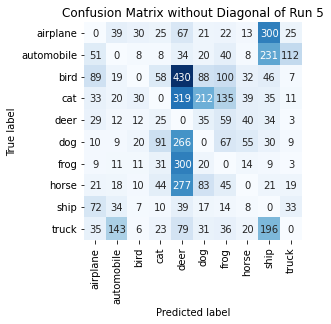

Summing down the rows, for Predictions of each Class that were wrong:  [ 349.  305.  134.  315. 1811.  527.  518.  229.  902.  222.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  430.0 times
Summing across the columns, for total number of that True Class misidentified:  [542. 512. 869. 834. 249. 557. 408. 538. 234. 569.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  59.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.

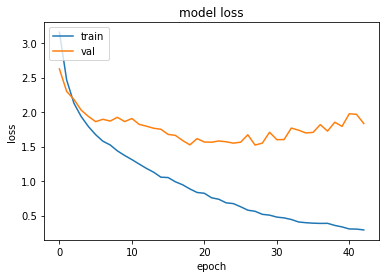

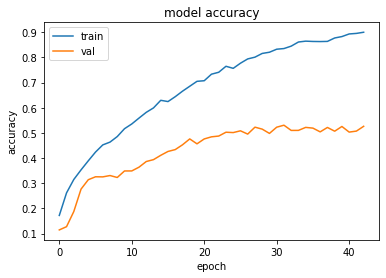

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.5215680599212646 , and Val Acc happened to be 0.5227000117301941
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5304999947547913 and Val Loss happened to be  1.6013844013214111
TestLoss:  1.488338828086853  TestAcc: 0.5289999842643738
truck 0.685
frog 0.649
ship 0.648
automobile 0.607
deer 0.589
horse 0.566
dog 0.537
airplane 0.532
cat 0.274
bird 0.203


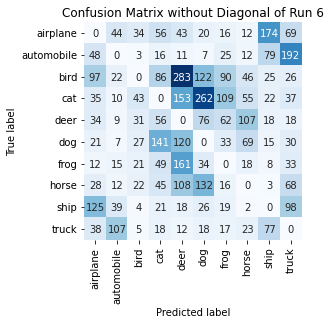

Summing down the rows, for Predictions of each Class that were wrong:  [438. 265. 190. 488. 909. 697. 387. 344. 421. 571.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  283.0 times
Summing across the columns, for total number of that True Class misidentified:  [468. 393. 797. 726. 411. 463. 351. 434. 352. 315.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  107.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Br

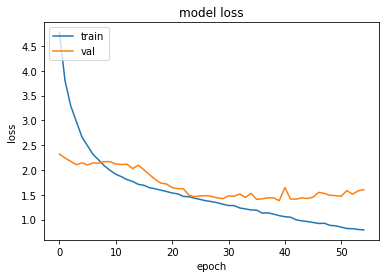

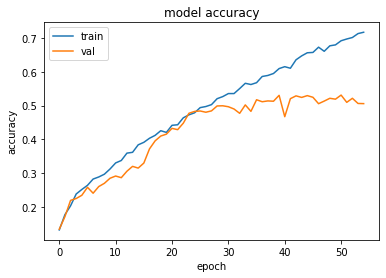

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3815345764160156 , and Val Acc happened to be 0.5306000113487244
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5313000082969666 and Val Loss happened to be  1.470746636390686
TestLoss:  1.3579598665237427  TestAcc: 0.5260999798774719
frog 0.77
ship 0.727
truck 0.672
horse 0.611
automobile 0.509
dog 0.481
airplane 0.46
deer 0.42
cat 0.335
bird 0.276


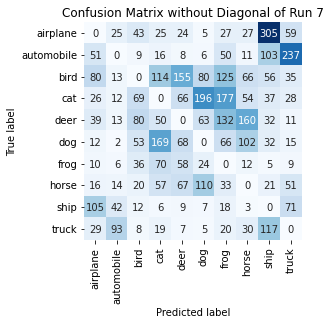

Summing down the rows, for Predictions of each Class that were wrong:  [368. 220. 330. 526. 462. 496. 648. 465. 708. 516.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [540. 491. 724. 665. 580. 519. 230. 389. 273. 328.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  160.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 

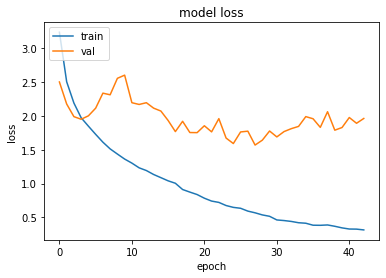

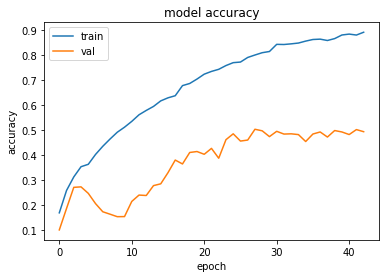

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.5699321031570435 , and Val Acc happened to be 0.5038999915122986
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5038999915122986 and Val Loss happened to be  1.5699321031570435
TestLoss:  1.5493793487548828  TestAcc: 0.5040000081062317
frog 0.755
ship 0.682
truck 0.667
horse 0.534
deer 0.521
automobile 0.489
dog 0.455
airplane 0.394
cat 0.327
bird 0.216


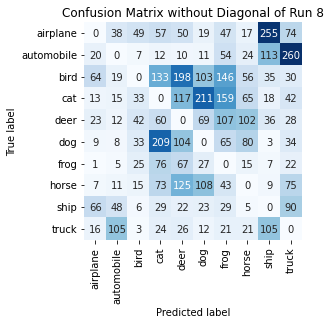

Summing down the rows, for Predictions of each Class that were wrong:  [219. 261. 213. 673. 719. 583. 671. 385. 581. 655.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  198.0 times
Summing across the columns, for total number of that True Class misidentified:  [606. 511. 784. 673. 479. 545. 245. 466. 318. 333.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  107.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

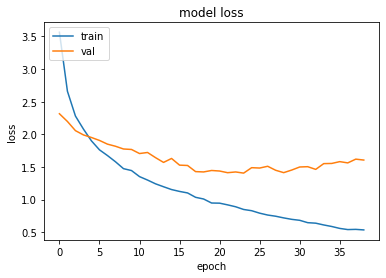

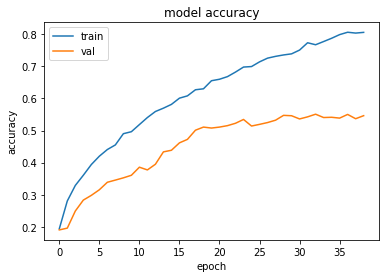

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.4062408208847046 , and Val Acc happened to be 0.534600019454956
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5509999990463257 and Val Loss happened to be  1.4633253812789917
TestLoss:  1.3827115297317505  TestAcc: 0.5329999923706055
ship 0.765
frog 0.722
automobile 0.708
horse 0.674
deer 0.537
truck 0.535
airplane 0.511
dog 0.354
bird 0.293
cat 0.231


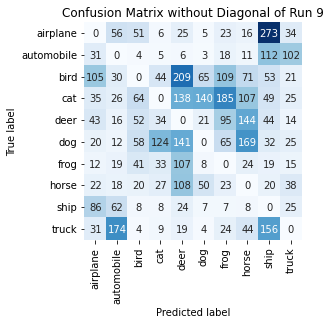

Summing down the rows, for Predictions of each Class that were wrong:  [385. 413. 302. 290. 777. 303. 549. 594. 758. 299.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  209.0 times
Summing across the columns, for total number of that True Class misidentified:  [489. 292. 707. 769. 463. 646. 278. 326. 235. 465.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  144.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise: 

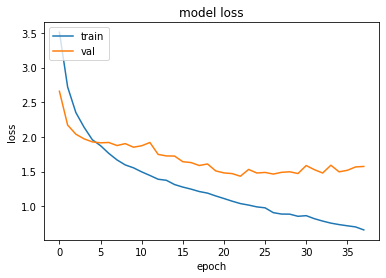

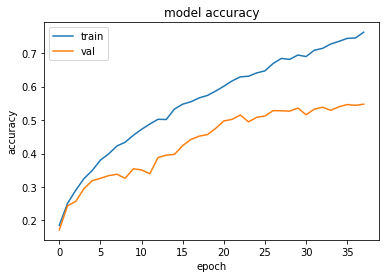

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4330487251281738 , and Val Acc happened to be 0.5152000188827515
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5475999712944031 and Val Loss happened to be  1.5739020109176636
TestLoss:  1.4134072065353394  TestAcc: 0.519599974155426
frog 0.79
ship 0.669
automobile 0.574
dog 0.57
horse 0.535
truck 0.518
deer 0.5
airplane 0.451
bird 0.31
cat 0.279


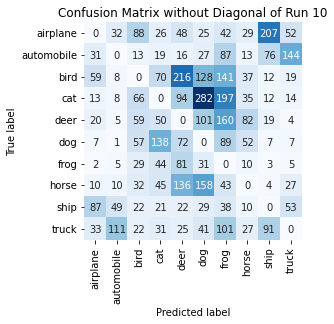

Summing down the rows, for Predictions of each Class that were wrong:  [262. 229. 388. 444. 710. 822. 898. 295. 431. 325.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  216.0 times
Summing across the columns, for total number of that True Class misidentified:  [549. 426. 690. 721. 500. 430. 210. 465. 331. 482.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  160.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

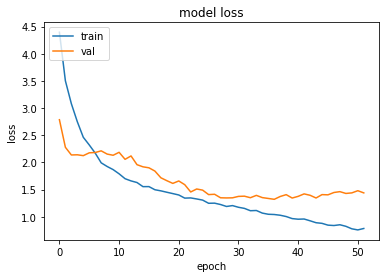

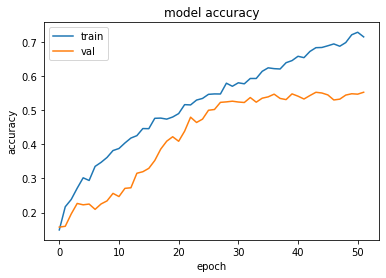

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3199509382247925 , and Val Acc happened to be 0.5467000007629395
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.552299976348877 and Val Loss happened to be  1.4379810094833374
TestLoss:  1.2962712049484253  TestAcc: 0.5482000112533569
frog 0.711
ship 0.696
automobile 0.671
horse 0.613
truck 0.613
airplane 0.537
deer 0.509
dog 0.502
bird 0.394
cat 0.236


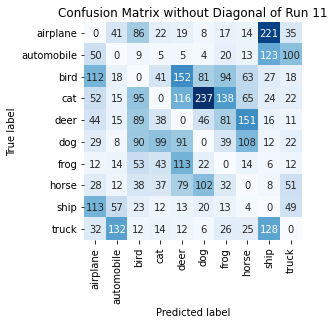

Summing down the rows, for Predictions of each Class that were wrong:  [472. 312. 495. 311. 600. 526. 460. 457. 565. 320.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  152.0 times
Summing across the columns, for total number of that True Class misidentified:  [463. 329. 606. 764. 491. 498. 289. 387. 304. 387.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  151.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16

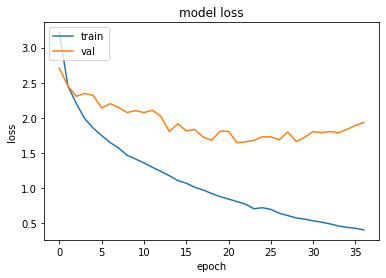

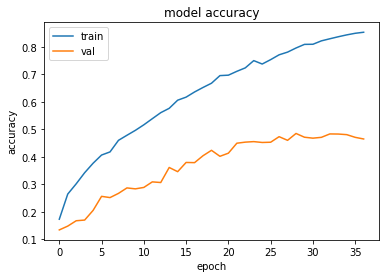

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.6469545364379883 , and Val Acc happened to be 0.4494999945163727
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.48500001430511475 and Val Loss happened to be  1.6639949083328247
TestLoss:  1.6060127019882202  TestAcc: 0.4505000114440918
frog 0.826
ship 0.717
truck 0.468
automobile 0.464
deer 0.434
airplane 0.39
bird 0.376
horse 0.347
dog 0.276
cat 0.207


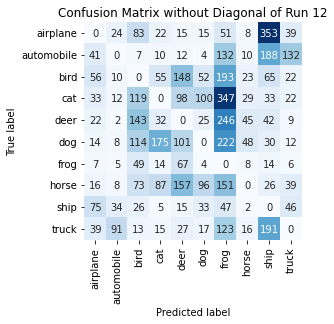

Summing down the rows, for Predictions of each Class that were wrong:  [ 303.  194.  627.  415.  640.  346. 1512.  189.  942.  327.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  157.0 times
Summing across the columns, for total number of that True Class misidentified:  [610. 536. 624. 793. 566. 724. 174. 653. 283. 532.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  246.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.

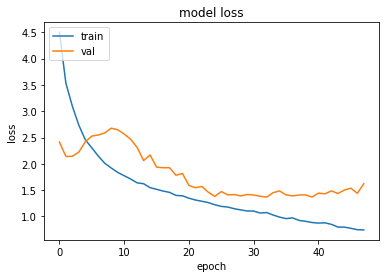

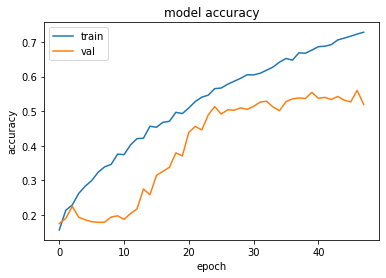

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3683292865753174 , and Val Acc happened to be 0.5285999774932861
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5601999759674072 and Val Loss happened to be  1.4394992589950562
TestLoss:  1.3353065252304077  TestAcc: 0.5375000238418579
horse 0.74
frog 0.696
ship 0.687
truck 0.637
dog 0.589
automobile 0.556
deer 0.52
airplane 0.455
cat 0.265
bird 0.23


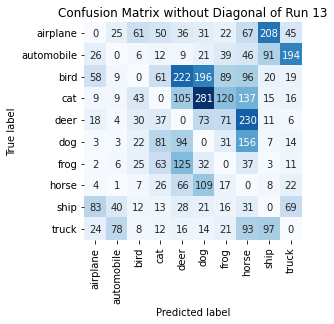

Summing down the rows, for Predictions of each Class that were wrong:  [227. 175. 214. 355. 701. 778. 426. 893. 460. 396.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  222.0 times
Summing across the columns, for total number of that True Class misidentified:  [545. 444. 770. 735. 480. 411. 304. 260. 313. 363.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  230.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0

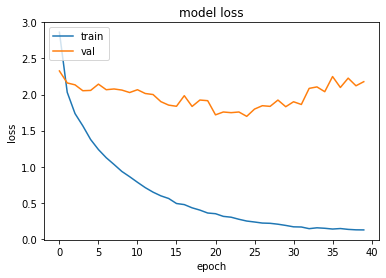

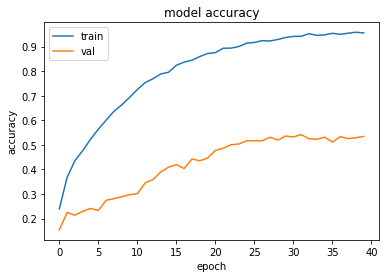

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6980080604553223 , and Val Acc happened to be 0.5167999863624573
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5419999957084656 and Val Loss happened to be  1.8626075983047485
TestLoss:  1.6808816194534302  TestAcc: 0.5203999876976013
ship 0.738
frog 0.698
automobile 0.67
deer 0.581
airplane 0.524
cat 0.509
horse 0.502
truck 0.439
dog 0.287
bird 0.256


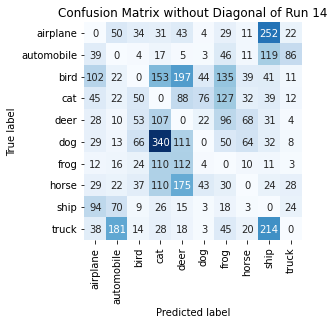

Summing down the rows, for Predictions of each Class that were wrong:  [416. 406. 291. 922. 764. 202. 576. 258. 763. 198.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  197.0 times
Summing across the columns, for total number of that True Class misidentified:  [476. 330. 744. 491. 419. 713. 302. 498. 262. 561.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  107.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0

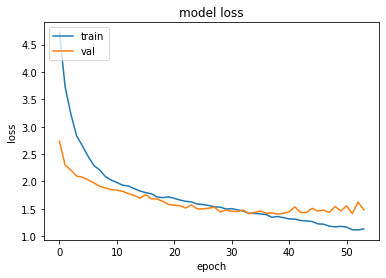

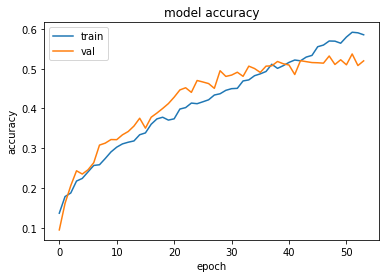

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.405491828918457 , and Val Acc happened to be 0.5181000232696533
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5370000004768372 and Val Loss happened to be  1.4146525859832764
TestLoss:  1.3809846639633179  TestAcc: 0.5152999758720398
frog 0.808
ship 0.725
horse 0.635
truck 0.624
automobile 0.536
dog 0.461
deer 0.442
airplane 0.41
cat 0.264
bird 0.248


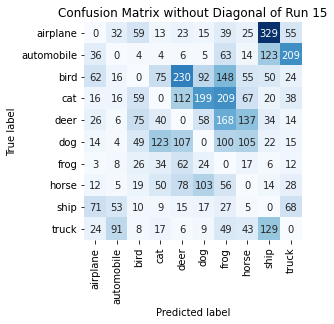

Summing down the rows, for Predictions of each Class that were wrong:  [264. 231. 309. 365. 639. 522. 859. 468. 727. 463.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  230.0 times
Summing across the columns, for total number of that True Class misidentified:  [590. 464. 752. 736. 558. 539. 192. 365. 275. 376.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  168.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


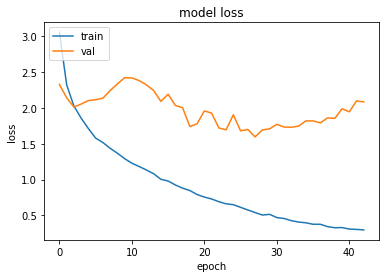

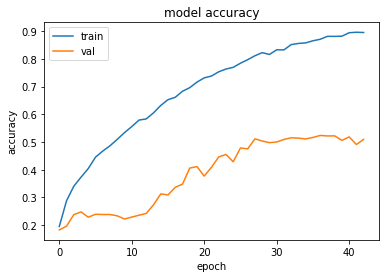

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.5958095788955688 , and Val Acc happened to be 0.5115000009536743
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5236999988555908 and Val Loss happened to be  1.7915740013122559
TestLoss:  1.5785876512527466  TestAcc: 0.5112000107765198
ship 0.699
truck 0.693
frog 0.682
deer 0.546
horse 0.54
dog 0.531
airplane 0.469
automobile 0.436
bird 0.324
cat 0.192


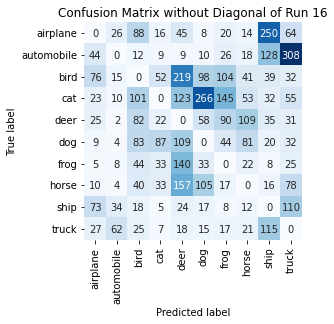

Summing down the rows, for Predictions of each Class that were wrong:  [292. 165. 493. 264. 844. 610. 471. 371. 643. 735.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  219.0 times
Summing across the columns, for total number of that True Class misidentified:  [531. 564. 676. 808. 454. 469. 318. 460. 301. 307.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  109.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0

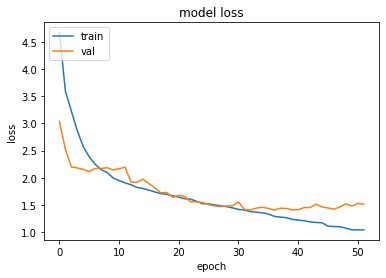

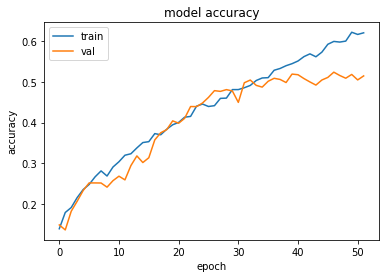

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.4036509990692139 , and Val Acc happened to be 0.5091999769210815
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5242999792098999 and Val Loss happened to be  1.4186609983444214
TestLoss:  1.3803470134735107  TestAcc: 0.5153999924659729
frog 0.747
automobile 0.674
ship 0.637
horse 0.542
airplane 0.54
deer 0.522
dog 0.503
truck 0.462
bird 0.331
cat 0.196


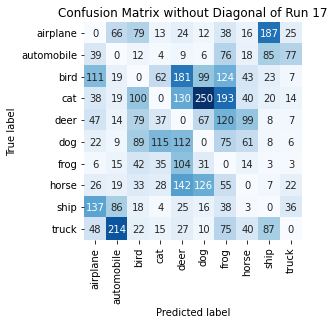

Summing down the rows, for Predictions of each Class that were wrong:  [474. 461. 474. 313. 754. 617. 794. 334. 428. 197.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  181.0 times
Summing across the columns, for total number of that True Class misidentified:  [460. 326. 669. 804. 478. 497. 253. 458. 363. 538.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  120.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

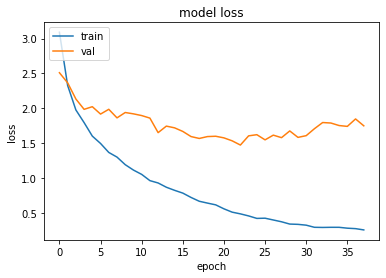

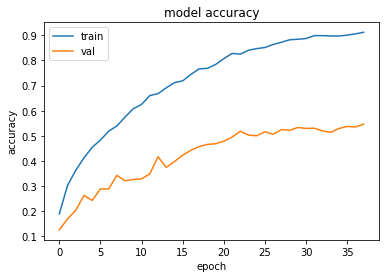

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4713659286499023 , and Val Acc happened to be 0.5180000066757202
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5462999939918518 and Val Loss happened to be  1.7473793029785156
TestLoss:  1.4421833753585815  TestAcc: 0.5230000019073486
frog 0.784
truck 0.593
horse 0.588
airplane 0.581
deer 0.555
ship 0.541
automobile 0.484
dog 0.46
bird 0.353
cat 0.291


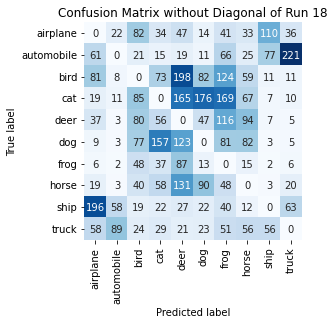

Summing down the rows, for Predictions of each Class that were wrong:  [486. 199. 476. 481. 818. 478. 736. 443. 276. 377.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  198.0 times
Summing across the columns, for total number of that True Class misidentified:  [419. 516. 647. 709. 445. 540. 216. 412. 459. 407.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  116.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

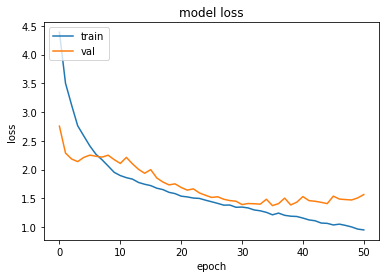

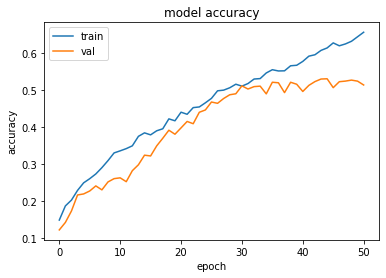

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3756012916564941 , and Val Acc happened to be 0.5210999846458435
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5304999947547913 and Val Loss happened to be  1.4101030826568604
TestLoss:  1.3344881534576416  TestAcc: 0.5333999991416931
frog 0.783
automobile 0.665
ship 0.594
horse 0.588
airplane 0.572
truck 0.564
dog 0.509
deer 0.451
bird 0.352
cat 0.256


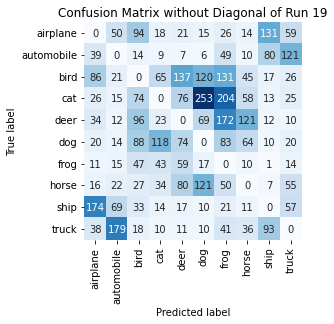

Summing down the rows, for Predictions of each Class that were wrong:  [444. 397. 491. 334. 482. 621. 777. 369. 364. 387.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  137.0 times
Summing across the columns, for total number of that True Class misidentified:  [428. 335. 648. 744. 549. 491. 217. 412. 406. 436.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  172.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

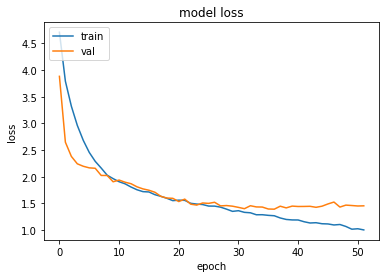

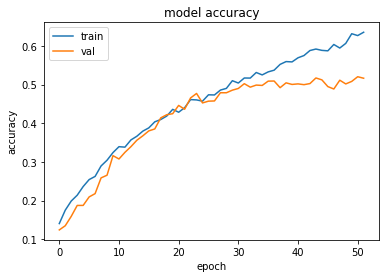

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3925518989562988 , and Val Acc happened to be 0.5090000033378601
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5200999975204468 and Val Loss happened to be  1.4524046182632446
TestLoss:  1.3635283708572388  TestAcc: 0.5138999819755554
ship 0.709
frog 0.682
horse 0.645
truck 0.606
deer 0.578
automobile 0.541
dog 0.441
airplane 0.413
bird 0.371
cat 0.153


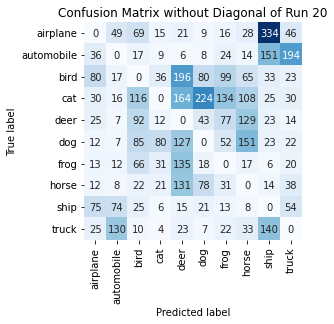

Summing down the rows, for Predictions of each Class that were wrong:  [308. 320. 502. 214. 818. 488. 468. 553. 749. 441.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  196.0 times
Summing across the columns, for total number of that True Class misidentified:  [587. 459. 629. 847. 422. 559. 318. 355. 291. 394.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  129.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 

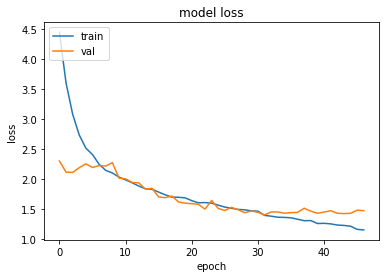

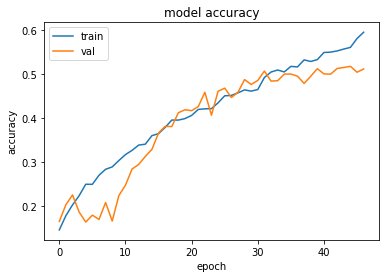

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.4085209369659424 , and Val Acc happened to be 0.5062999725341797
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5170999765396118 and Val Loss happened to be  1.4357125759124756
TestLoss:  1.3881304264068604  TestAcc: 0.5038999915122986
frog 0.718
ship 0.669
horse 0.6
truck 0.578
automobile 0.558
deer 0.494
dog 0.482
airplane 0.451
bird 0.288
cat 0.201


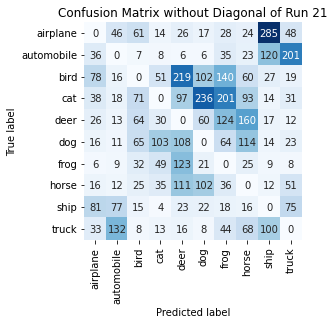

Summing down the rows, for Predictions of each Class that were wrong:  [330. 334. 348. 307. 729. 574. 690. 583. 598. 468.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  219.0 times
Summing across the columns, for total number of that True Class misidentified:  [549. 442. 712. 799. 506. 518. 282. 400. 331. 422.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  160.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise: 

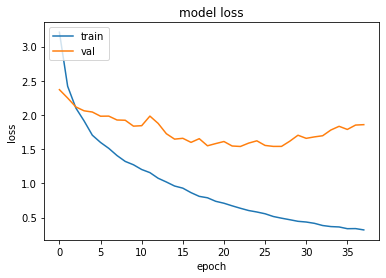

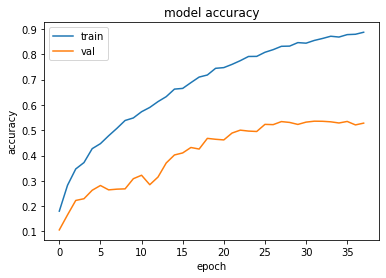

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.539490818977356 , and Val Acc happened to be 0.5004000067710876
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5357999801635742 and Val Loss happened to be  1.6795507669448853
TestLoss:  1.5262526273727417  TestAcc: 0.4921000003814697
ship 0.698
deer 0.675
truck 0.65
horse 0.622
frog 0.504
automobile 0.441
bird 0.382
dog 0.365
airplane 0.325
cat 0.259


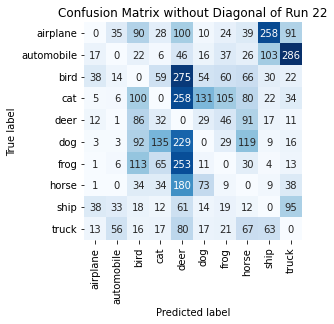

Summing down the rows, for Predictions of each Class that were wrong:  [ 128.  154.  571.  388. 1482.  355.  350.  530.  515.  606.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  275.0 times
Summing across the columns, for total number of that True Class misidentified:  [675. 559. 618. 741. 325. 635. 496. 378. 302. 350.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  91.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08

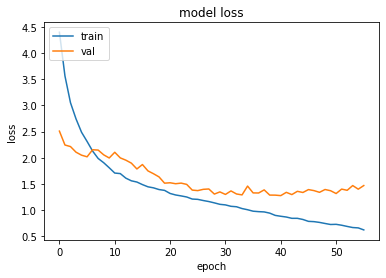

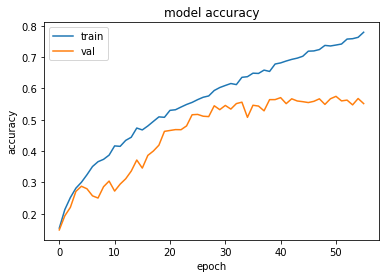

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.2767874002456665 , and Val Acc happened to be 0.5705999732017517
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5746999979019165 and Val Loss happened to be  1.3165241479873657
TestLoss:  1.2546318769454956  TestAcc: 0.5667999982833862
frog 0.788
automobile 0.697
ship 0.683
horse 0.672
truck 0.602
dog 0.534
airplane 0.528
deer 0.456
bird 0.382
cat 0.326


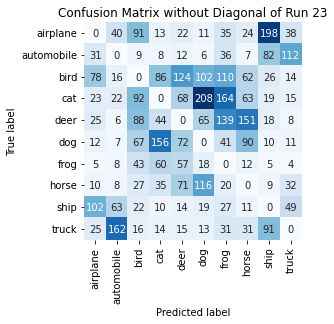

Summing down the rows, for Predictions of each Class that were wrong:  [311. 332. 455. 426. 455. 558. 603. 451. 458. 283.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  124.0 times
Summing across the columns, for total number of that True Class misidentified:  [472. 303. 618. 674. 544. 466. 212. 328. 317. 398.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  151.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

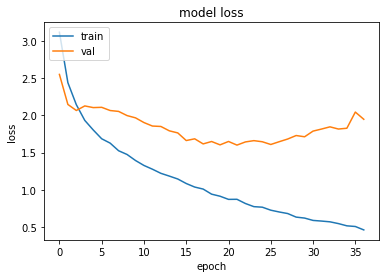

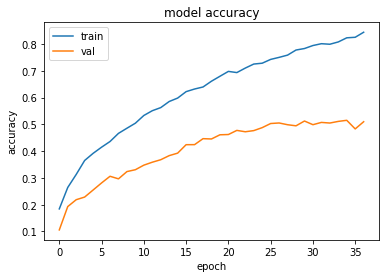

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.600845217704773 , and Val Acc happened to be 0.4772999882698059
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5149999856948853 and Val Loss happened to be  1.8279032707214355
TestLoss:  1.5664129257202148  TestAcc: 0.4805000126361847
frog 0.698
ship 0.633
deer 0.604
truck 0.597
automobile 0.53
horse 0.466
airplane 0.424
dog 0.407
cat 0.296
bird 0.15


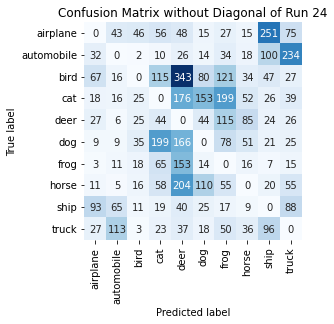

Summing down the rows, for Predictions of each Class that were wrong:  [ 287.  284.  181.  589. 1193.  473.  696.  316.  592.  584.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  343.0 times
Summing across the columns, for total number of that True Class misidentified:  [576. 470. 850. 704. 396. 593. 302. 534. 367. 403.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  115.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

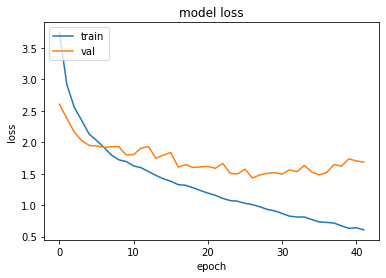

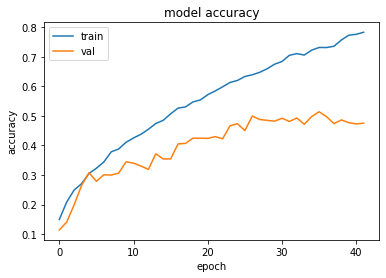

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.4311310052871704 , and Val Acc happened to be 0.49959999322891235
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5139999985694885 and Val Loss happened to be  1.480220913887024
TestLoss:  1.3926340341567993  TestAcc: 0.49779999256134033
ship 0.746
truck 0.713
frog 0.712
deer 0.537
horse 0.51
dog 0.498
airplane 0.421
automobile 0.404
bird 0.235
cat 0.202


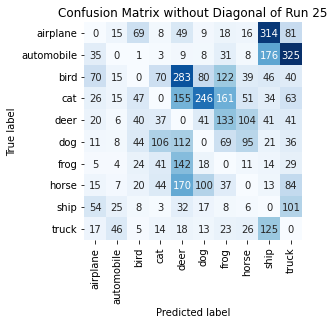

Summing down the rows, for Predictions of each Class that were wrong:  [253. 141. 258. 326. 970. 532. 602. 356. 784. 800.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  283.0 times
Summing across the columns, for total number of that True Class misidentified:  [579. 596. 765. 798. 463. 502. 288. 490. 254. 287.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  133.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

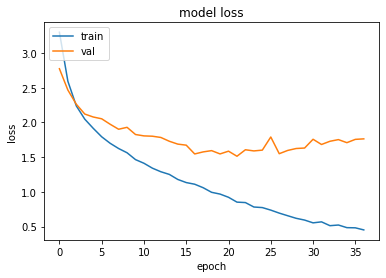

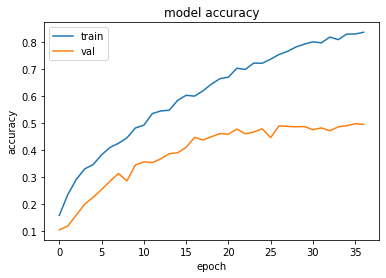

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5131622552871704 , and Val Acc happened to be 0.4779999852180481
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.4977000057697296 and Val Loss happened to be  1.755966067314148
TestLoss:  1.4717223644256592  TestAcc: 0.4805999994277954
frog 0.738
ship 0.597
truck 0.554
dog 0.551
automobile 0.531
airplane 0.507
horse 0.461
deer 0.337
cat 0.267
bird 0.263


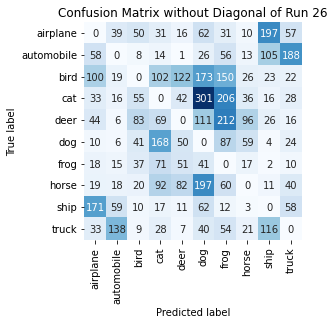

Summing down the rows, for Predictions of each Class that were wrong:  [ 486.  316.  313.  592.  382. 1013.  868.  281.  500.  443.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  122.0 times
Summing across the columns, for total number of that True Class misidentified:  [493. 469. 737. 733. 663. 449. 262. 539. 403. 446.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  212.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

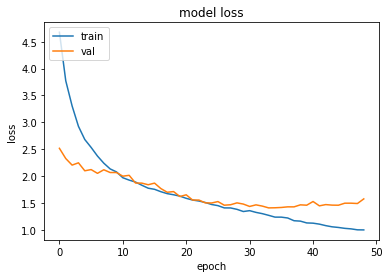

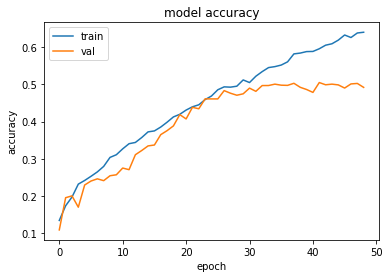

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.408499002456665 , and Val Acc happened to be 0.4968000054359436
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.504800021648407 and Val Loss happened to be  1.4466620683670044
TestLoss:  1.397688627243042  TestAcc: 0.4952000081539154
ship 0.678
frog 0.638
horse 0.576
automobile 0.559
truck 0.535
deer 0.526
dog 0.476
airplane 0.373
bird 0.319
cat 0.272


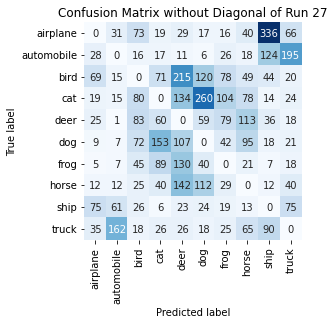

Summing down the rows, for Predictions of each Class that were wrong:  [277. 311. 438. 481. 817. 656. 418. 492. 681. 477.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  215.0 times
Summing across the columns, for total number of that True Class misidentified:  [627. 441. 681. 728. 474. 524. 362. 424. 322. 465.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  113.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

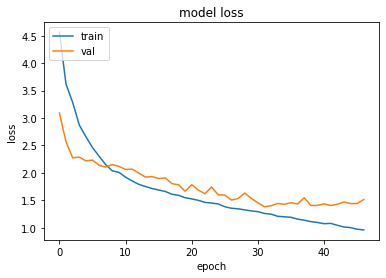

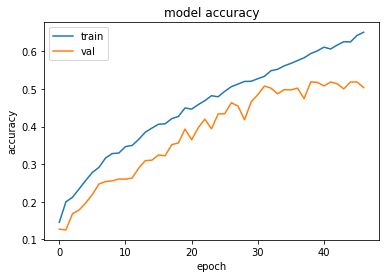

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.3825175762176514 , and Val Acc happened to be 0.5077999830245972
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5188000202178955 and Val Loss happened to be  1.4059791564941406
TestLoss:  1.3744240999221802  TestAcc: 0.5052000284194946
frog 0.707
ship 0.643
truck 0.641
automobile 0.574
horse 0.565
deer 0.533
dog 0.508
airplane 0.467
bird 0.22
cat 0.194


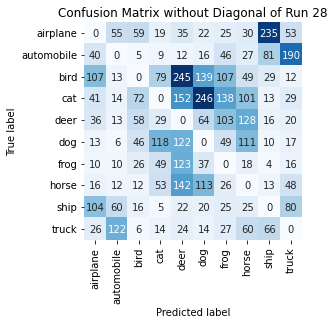

Summing down the rows, for Predictions of each Class that were wrong:  [393. 305. 300. 375. 877. 671. 546. 549. 467. 465.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  245.0 times
Summing across the columns, for total number of that True Class misidentified:  [533. 426. 780. 806. 467. 492. 293. 435. 357. 359.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  128.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )

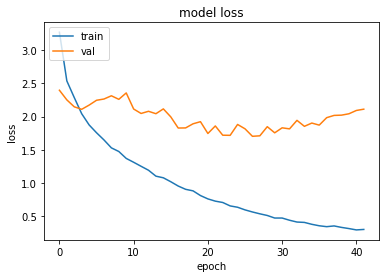

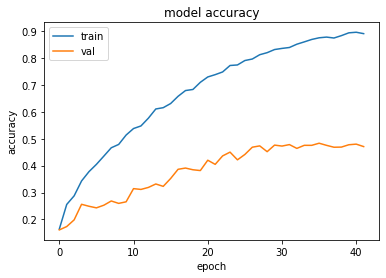

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.704026699066162 , and Val Acc happened to be 0.4683000147342682
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.4830999970436096 and Val Loss happened to be  1.8723349571228027
TestLoss:  1.6849713325500488  TestAcc: 0.4747999906539917
frog 0.679
deer 0.555
ship 0.554
dog 0.509
airplane 0.492
horse 0.441
truck 0.43
bird 0.402
automobile 0.382
cat 0.304


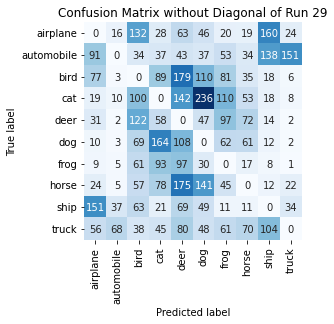

Summing down the rows, for Predictions of each Class that were wrong:  [468. 149. 676. 613. 956. 744. 540. 372. 484. 250.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [508. 618. 598. 696. 445. 491. 321. 559. 446. 570.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  122.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

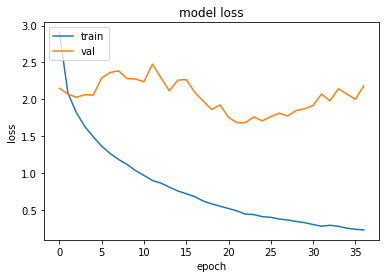

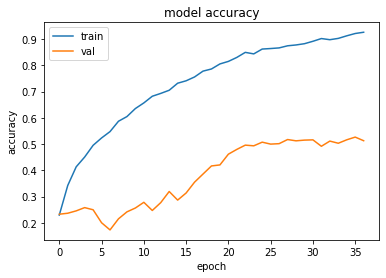

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.6807982921600342 , and Val Acc happened to be 0.4796999990940094
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5264999866485596 and Val Loss happened to be  1.999056100845337
TestLoss:  1.6491010189056396  TestAcc: 0.48730000853538513
frog 0.819
ship 0.738
deer 0.599
horse 0.565
automobile 0.477
truck 0.415
airplane 0.4
dog 0.317
bird 0.293
cat 0.25


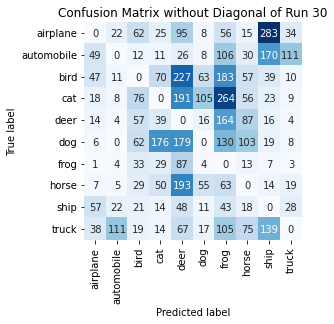

Summing down the rows, for Predictions of each Class that were wrong:  [ 237.  187.  371.  428. 1113.  287. 1114.  454.  710.  226.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  227.0 times
Summing across the columns, for total number of that True Class misidentified:  [600. 523. 707. 750. 401. 683. 181. 435. 262. 585.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  164.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

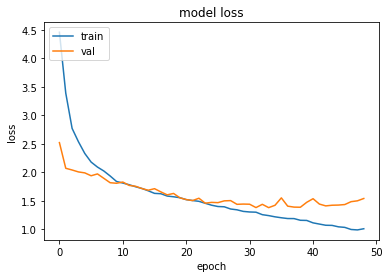

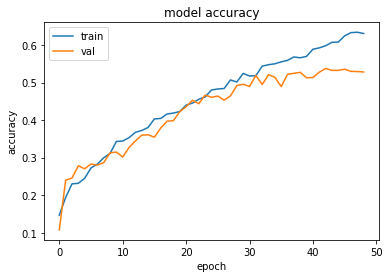

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3819397687911987 , and Val Acc happened to be 0.5209000110626221
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5374000072479248 and Val Loss happened to be  1.4126701354980469
TestLoss:  1.3550742864608765  TestAcc: 0.5212000012397766
frog 0.833
ship 0.725
automobile 0.683
horse 0.613
truck 0.597
dog 0.513
deer 0.446
airplane 0.404
bird 0.221
cat 0.177


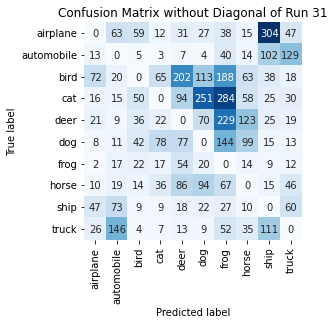

Summing down the rows, for Predictions of each Class that were wrong:  [ 215.  373.  241.  249.  582.  610. 1069.  431.  644.  374.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [596. 317. 779. 823. 554. 487. 167. 387. 275. 403.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  229.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

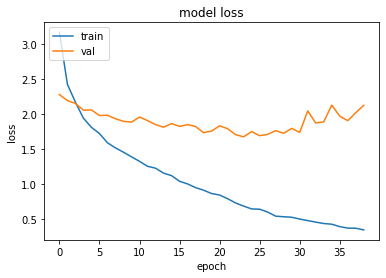

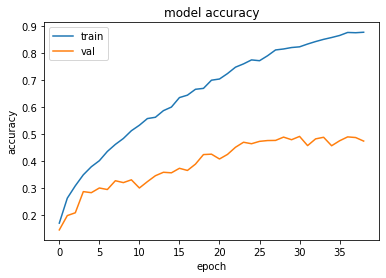

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6731181144714355 , and Val Acc happened to be 0.4691999852657318
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.4909000098705292 and Val Loss happened to be  1.735711932182312
TestLoss:  1.6334611177444458  TestAcc: 0.4729999899864197
frog 0.73
airplane 0.659
ship 0.649
automobile 0.573
truck 0.462
deer 0.378
dog 0.334
cat 0.319
horse 0.319
bird 0.307


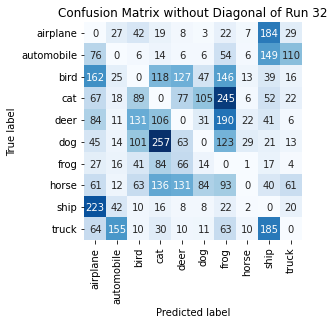

Summing down the rows, for Predictions of each Class that were wrong:  [809. 320. 493. 780. 496. 309. 958.  96. 728. 281.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  131.0 times
Summing across the columns, for total number of that True Class misidentified:  [341. 427. 693. 681. 622. 666. 270. 681. 351. 538.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  190.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    

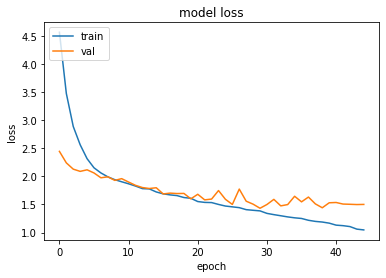

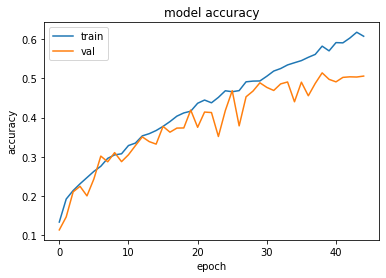

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.4323676824569702 , and Val Acc happened to be 0.4887000024318695
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5139999985694885 and Val Loss happened to be  1.4411619901657104
TestLoss:  1.4065914154052734  TestAcc: 0.4887000024318695
frog 0.881
automobile 0.699
ship 0.626
horse 0.508
truck 0.503
airplane 0.442
dog 0.442
deer 0.361
cat 0.231
bird 0.194


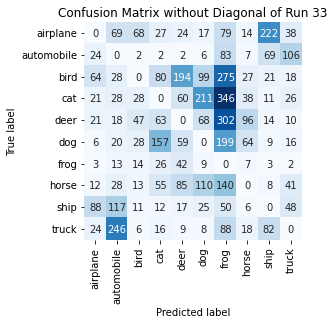

Summing down the rows, for Predictions of each Class that were wrong:  [ 263.  567.  217.  438.  492.  553. 1562.  277.  439.  305.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  194.0 times
Summing across the columns, for total number of that True Class misidentified:  [558. 301. 806. 769. 639. 558. 119. 492. 374. 497.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  302.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 

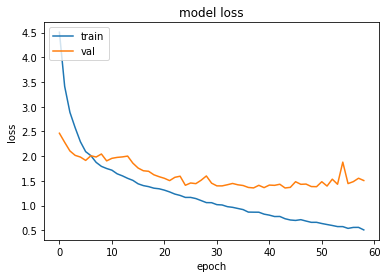

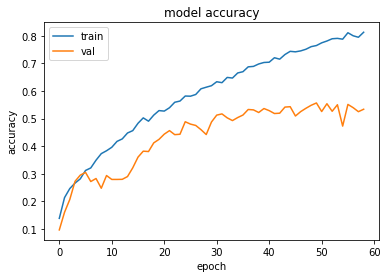

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.356147050857544 , and Val Acc happened to be 0.541700005531311
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5566999912261963 and Val Loss happened to be  1.3820441961288452
TestLoss:  1.3173987865447998  TestAcc: 0.5493999719619751
ship 0.749
frog 0.74
truck 0.684
deer 0.637
horse 0.567
automobile 0.503
dog 0.488
airplane 0.434
bird 0.348
cat 0.344


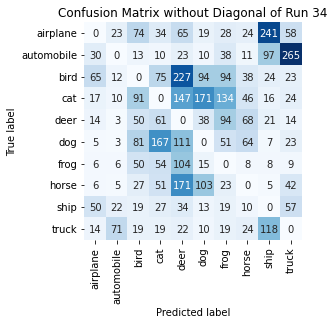

Summing down the rows, for Predictions of each Class that were wrong:  [207. 155. 424. 498. 904. 473. 500. 293. 537. 515.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  227.0 times
Summing across the columns, for total number of that True Class misidentified:  [566. 497. 652. 656. 363. 512. 260. 433. 251. 316.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  94.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

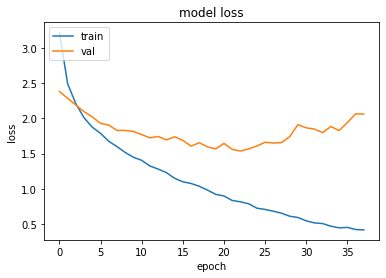

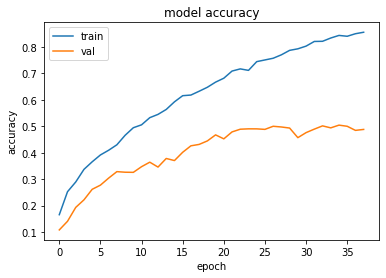

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.536290168762207 , and Val Acc happened to be 0.4885999858379364
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5040000081062317 and Val Loss happened to be  1.8265414237976074
TestLoss:  1.510206937789917  TestAcc: 0.48829999566078186
ship 0.714
horse 0.663
frog 0.647
truck 0.579
deer 0.539
automobile 0.483
dog 0.412
airplane 0.373
cat 0.311
bird 0.162


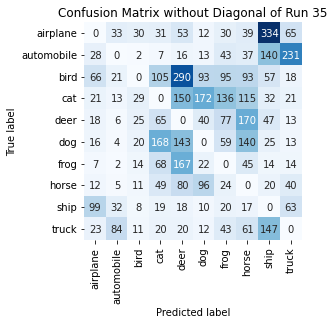

Summing down the rows, for Predictions of each Class that were wrong:  [290. 200. 150. 532. 937. 470. 527. 717. 816. 478.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  290.0 times
Summing across the columns, for total number of that True Class misidentified:  [627. 517. 838. 689. 461. 588. 353. 337. 286. 421.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  170.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

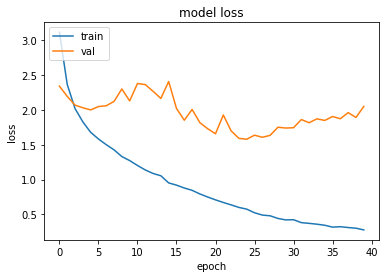

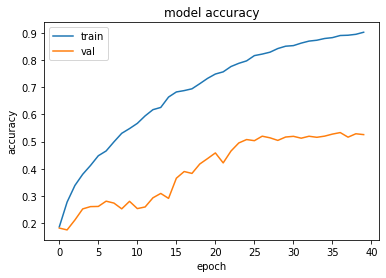

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5787570476531982 , and Val Acc happened to be 0.5076000094413757
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.53329998254776 and Val Loss happened to be  1.8730281591415405
TestLoss:  1.5560877323150635  TestAcc: 0.5128999948501587
ship 0.742
frog 0.723
automobile 0.602
deer 0.566
airplane 0.479
horse 0.461
truck 0.46
dog 0.458
bird 0.369
cat 0.269


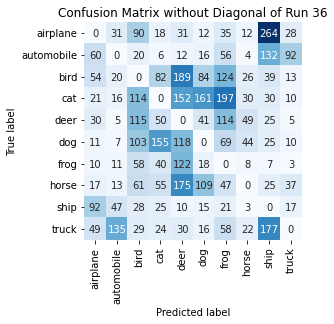

Summing down the rows, for Predictions of each Class that were wrong:  [344. 285. 618. 455. 839. 472. 721. 198. 724. 215.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [521. 398. 631. 731. 434. 542. 277. 539. 258. 540.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  115.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 

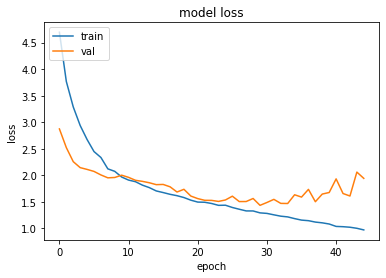

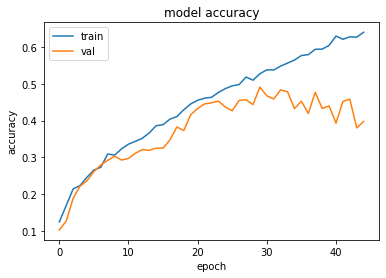

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.4352881908416748 , and Val Acc happened to be 0.49149999022483826
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.49149999022483826 and Val Loss happened to be  1.4352881908416748
TestLoss:  1.4141497611999512  TestAcc: 0.49140000343322754
truck 0.747
frog 0.741
ship 0.616
horse 0.597
automobile 0.57
deer 0.495
dog 0.452
airplane 0.371
cat 0.212
bird 0.113


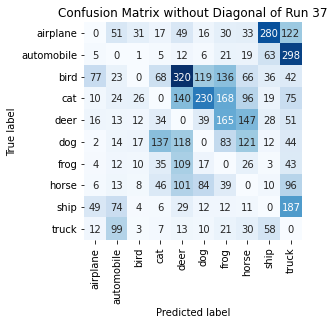

Summing down the rows, for Predictions of each Class that were wrong:  [181. 323. 112. 355. 891. 533. 675. 549. 509. 958.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  320.0 times
Summing across the columns, for total number of that True Class misidentified:  [629. 430. 887. 788. 505. 548. 259. 403. 384. 253.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  165.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

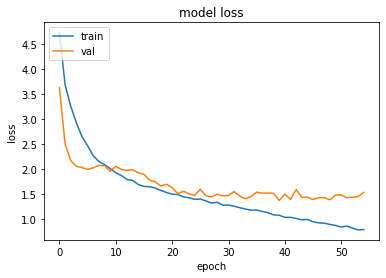

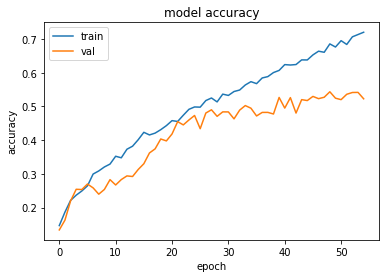

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3665680885314941 , and Val Acc happened to be 0.5266000032424927
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.54339998960495 and Val Loss happened to be  1.3804445266723633
TestLoss:  1.3310596942901611  TestAcc: 0.5289000272750854
frog 0.758
horse 0.701
truck 0.651
automobile 0.628
ship 0.619
deer 0.516
dog 0.502
airplane 0.37
bird 0.274
cat 0.27


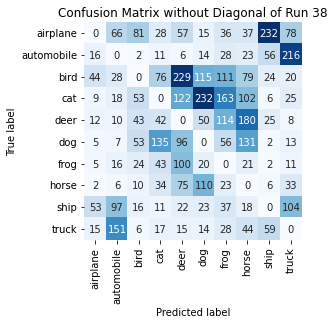

Summing down the rows, for Predictions of each Class that were wrong:  [161. 399. 288. 397. 722. 593. 596. 635. 412. 508.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  229.0 times
Summing across the columns, for total number of that True Class misidentified:  [630. 372. 726. 730. 484. 498. 242. 299. 381. 349.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  180.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

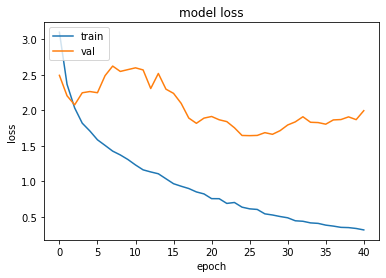

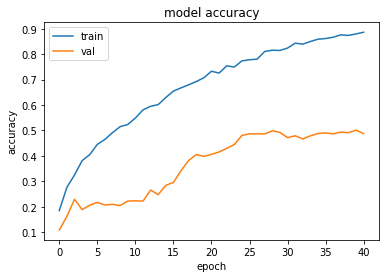

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6427204608917236 , and Val Acc happened to be 0.4867999851703644
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5011000037193298 and Val Loss happened to be  1.8681702613830566
TestLoss:  1.59717857837677  TestAcc: 0.4875999987125397
truck 0.683
ship 0.648
deer 0.647
frog 0.585
dog 0.479
horse 0.478
airplane 0.476
automobile 0.436
cat 0.342
bird 0.102


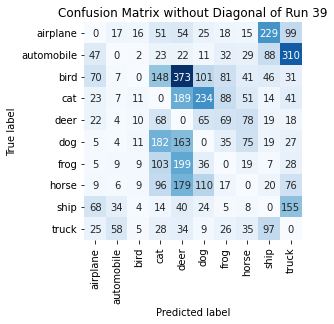

Summing down the rows, for Predictions of each Class that were wrong:  [ 274.  146.   77.  713. 1253.  615.  371.  351.  539.  785.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  373.0 times
Summing across the columns, for total number of that True Class misidentified:  [524. 564. 898. 658. 353. 521. 415. 522. 352. 317.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  78.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

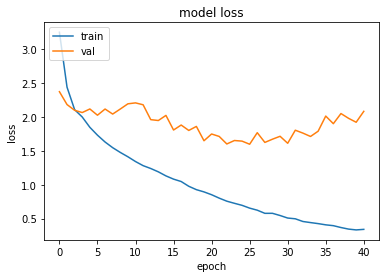

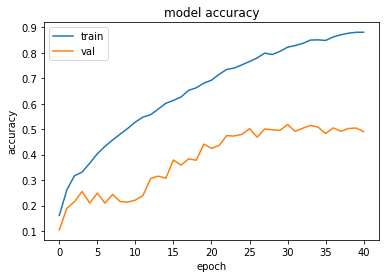

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5988073348999023 , and Val Acc happened to be 0.5019000172615051
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5184999704360962 and Val Loss happened to be  1.6131292581558228
TestLoss:  1.5748358964920044  TestAcc: 0.503600001335144
frog 0.814
automobile 0.641
airplane 0.623
ship 0.586
truck 0.501
horse 0.427
bird 0.418
cat 0.365
deer 0.343
dog 0.318


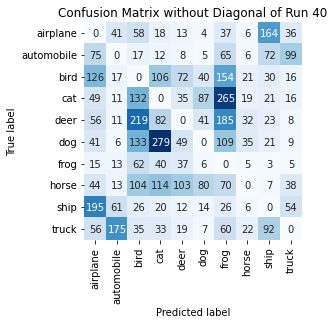

Summing down the rows, for Predictions of each Class that were wrong:  [657. 348. 786. 704. 348. 284. 971. 152. 433. 281.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  103.0 times
Summing across the columns, for total number of that True Class misidentified:  [377. 359. 582. 635. 657. 682. 186. 573. 414. 499.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  219.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


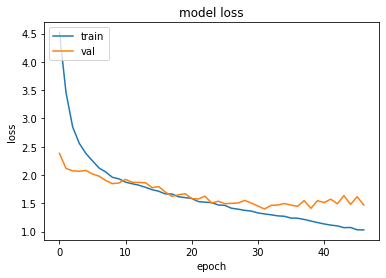

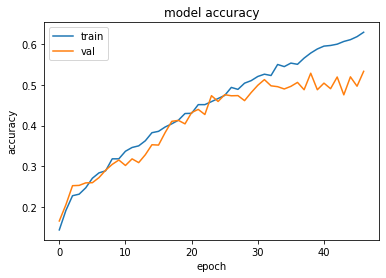

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.3997808694839478 , and Val Acc happened to be 0.512499988079071
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.532800018787384 and Val Loss happened to be  1.4705356359481812
TestLoss:  1.3717154264450073  TestAcc: 0.5084999799728394
frog 0.849
automobile 0.651
ship 0.643
horse 0.584
deer 0.547
truck 0.531
dog 0.452
airplane 0.45
bird 0.215
cat 0.163


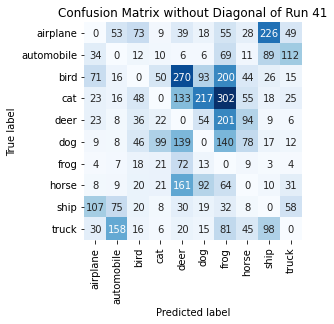

Summing down the rows, for Predictions of each Class that were wrong:  [ 309.  350.  289.  246.  870.  527. 1144.  372.  496.  312.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  270.0 times
Summing across the columns, for total number of that True Class misidentified:  [550. 349. 785. 837. 453. 548. 151. 416. 357. 469.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  201.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

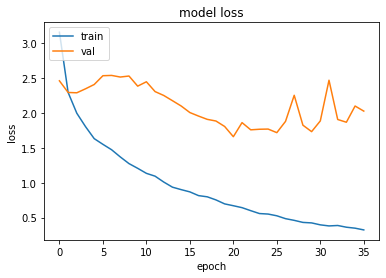

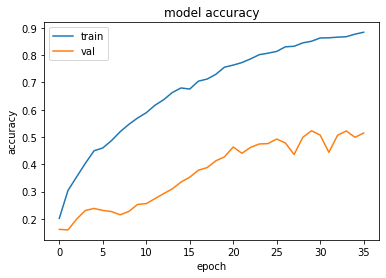

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.6601601839065552 , and Val Acc happened to be 0.4632999897003174
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5227000117301941 and Val Loss happened to be  1.7325488328933716
TestLoss:  1.6218560934066772  TestAcc: 0.47440001368522644
ship 0.713
frog 0.691
deer 0.658
airplane 0.621
automobile 0.491
dog 0.411
horse 0.396
bird 0.304
truck 0.259
cat 0.2


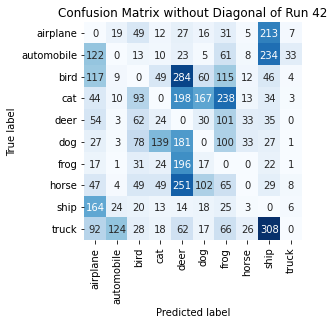

Summing down the rows, for Predictions of each Class that were wrong:  [ 684.  197.  423.  338. 1236.  432.  802.  133.  948.   63.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  284.0 times
Summing across the columns, for total number of that True Class misidentified:  [379. 509. 696. 800. 342. 589. 309. 604. 287. 741.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  101.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

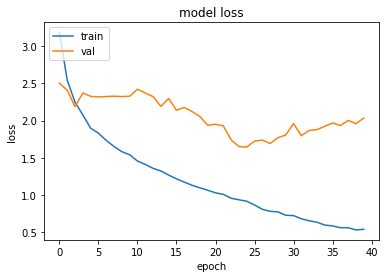

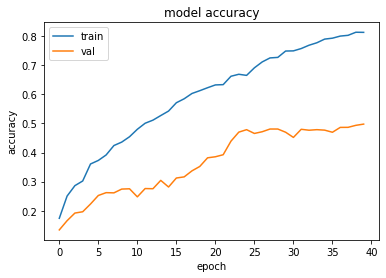

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.643140196800232 , and Val Acc happened to be 0.47850000858306885
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.4975999891757965 and Val Loss happened to be  2.033381223678589
TestLoss:  1.6002583503723145  TestAcc: 0.48660001158714294
frog 0.739
airplane 0.589
automobile 0.585
ship 0.584
truck 0.476
deer 0.47
horse 0.433
dog 0.408
cat 0.32
bird 0.262


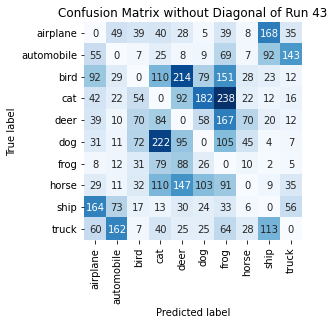

Summing down the rows, for Predictions of each Class that were wrong:  [520. 379. 329. 723. 727. 511. 957. 224. 443. 321.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  214.0 times
Summing across the columns, for total number of that True Class misidentified:  [411. 415. 738. 680. 530. 592. 261. 567. 416. 524.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  167.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


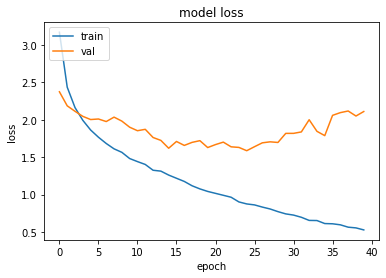

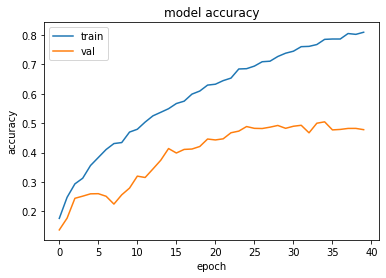

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5865558385849 , and Val Acc happened to be 0.4885999858379364
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5045999884605408 and Val Loss happened to be  1.7878506183624268
TestLoss:  1.528489589691162  TestAcc: 0.4999000132083893
automobile 0.68
deer 0.653
frog 0.64
ship 0.559
truck 0.549
airplane 0.528
horse 0.526
dog 0.411
bird 0.277
cat 0.176


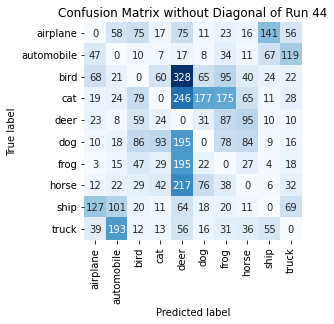

Summing down the rows, for Predictions of each Class that were wrong:  [ 348.  460.  417.  296. 1393.  424.  581.  385.  327.  370.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  328.0 times
Summing across the columns, for total number of that True Class misidentified:  [472. 320. 723. 824. 347. 589. 360. 474. 441. 451.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  95.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

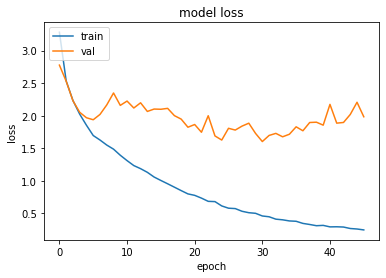

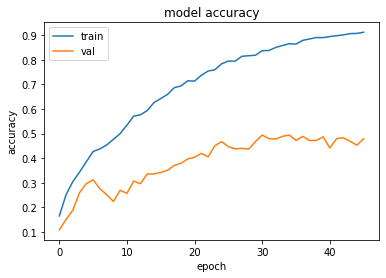

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.6042981147766113 , and Val Acc happened to be 0.49390000104904175
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.4941999912261963 and Val Loss happened to be  1.716261386871338
TestLoss:  1.5772658586502075  TestAcc: 0.49790000915527344
frog 0.799
ship 0.655
truck 0.629
automobile 0.625
deer 0.507
horse 0.456
airplane 0.388
dog 0.369
cat 0.327
bird 0.224


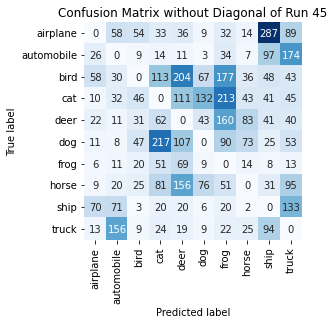

Summing down the rows, for Predictions of each Class that were wrong:  [225. 397. 244. 615. 733. 354. 799. 297. 672. 685.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  204.0 times
Summing across the columns, for total number of that True Class misidentified:  [612. 375. 776. 673. 493. 631. 201. 544. 345. 371.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  160.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

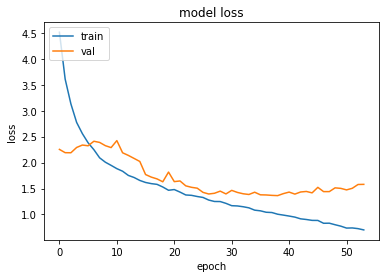

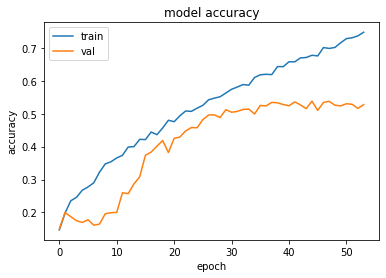

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3629587888717651 , and Val Acc happened to be 0.53329998254776
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5382999777793884 and Val Loss happened to be  1.416151523590088
TestLoss:  1.3211262226104736  TestAcc: 0.5443000197410583
frog 0.746
ship 0.726
automobile 0.701
truck 0.637
horse 0.621
dog 0.54
airplane 0.42
deer 0.414
bird 0.38
cat 0.258


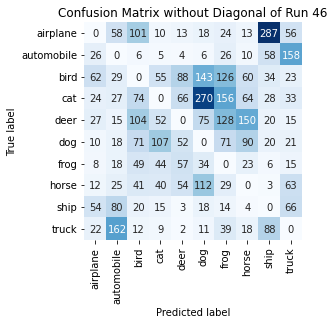

Summing down the rows, for Predictions of each Class that were wrong:  [245. 432. 478. 337. 339. 687. 613. 432. 544. 450.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  88.0 times
Summing across the columns, for total number of that True Class misidentified:  [580. 299. 620. 742. 586. 460. 254. 379. 274. 363.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  150.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

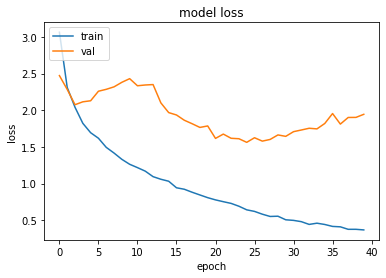

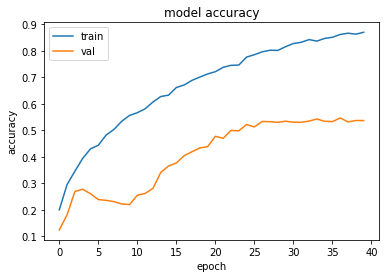

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5624977350234985 , and Val Acc happened to be 0.5220000147819519
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5468000173568726 and Val Loss happened to be  1.8112013339996338
TestLoss:  1.5068726539611816  TestAcc: 0.5220999717712402
frog 0.796
ship 0.68
deer 0.6
horse 0.582
truck 0.576
airplane 0.523
automobile 0.498
dog 0.467
bird 0.273
cat 0.226


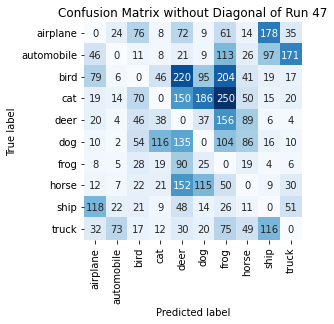

Summing down the rows, for Predictions of each Class that were wrong:  [ 344.  157.  345.  277.  918.  510. 1039.  385.  460.  344.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  220.0 times
Summing across the columns, for total number of that True Class misidentified:  [477. 502. 727. 774. 400. 533. 204. 418. 320. 424.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  156.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16

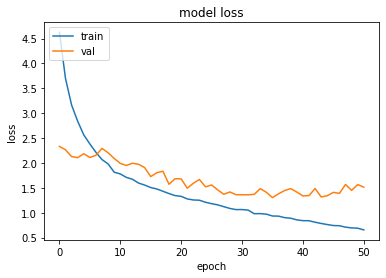

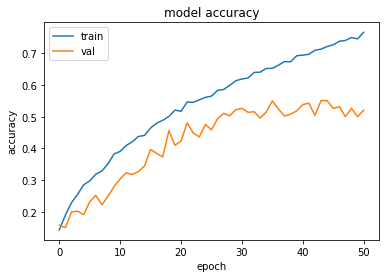

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3031686544418335 , and Val Acc happened to be 0.5498999953269958
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5508000254631042 and Val Loss happened to be  1.316675066947937
TestLoss:  1.2889010906219482  TestAcc: 0.5436999797821045
automobile 0.767
frog 0.757
ship 0.689
horse 0.626
dog 0.592
truck 0.563
airplane 0.477
deer 0.391
bird 0.378
cat 0.197


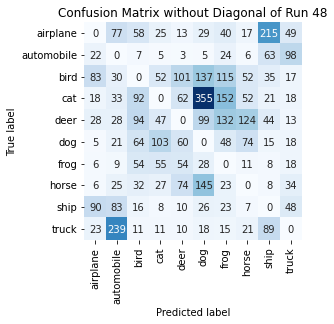

Summing down the rows, for Predictions of each Class that were wrong:  [281. 545. 428. 333. 387. 842. 572. 364. 498. 313.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [523. 233. 622. 803. 609. 408. 243. 374. 311. 437.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  132.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

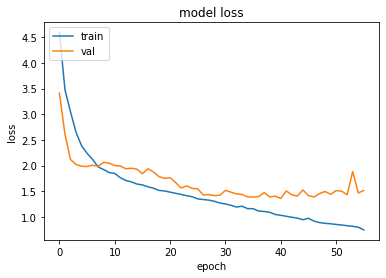

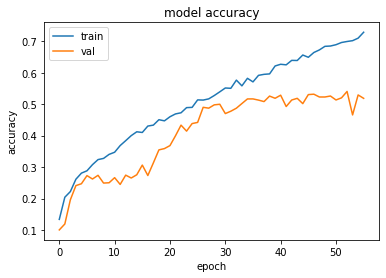

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.357325792312622 , and Val Acc happened to be 0.5285000205039978
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5404000282287598 and Val Loss happened to be  1.429542064666748
TestLoss:  1.3352333307266235  TestAcc: 0.5314000248908997
frog 0.733
ship 0.72
truck 0.649
automobile 0.59
horse 0.584
dog 0.565
deer 0.539
airplane 0.5
bird 0.261
cat 0.173


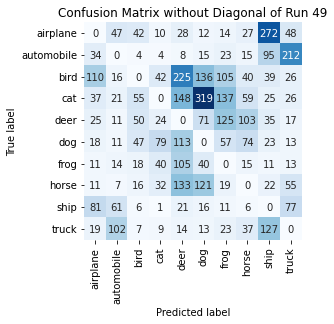

Summing down the rows, for Predictions of each Class that were wrong:  [346. 290. 245. 241. 795. 743. 514. 376. 649. 487.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  225.0 times
Summing across the columns, for total number of that True Class misidentified:  [500. 410. 739. 827. 461. 435. 267. 416. 280. 351.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  125.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

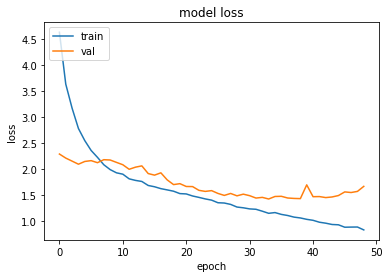

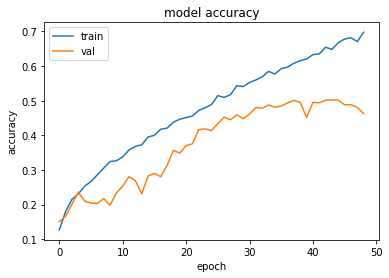

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.4280288219451904 , and Val Acc happened to be 0.48750001192092896
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5020999908447266 and Val Loss happened to be  1.4671142101287842
TestLoss:  1.408416748046875  TestAcc: 0.4902999997138977
ship 0.7
frog 0.666
automobile 0.665
deer 0.577
horse 0.546
dog 0.494
airplane 0.443
truck 0.394
bird 0.23
cat 0.188


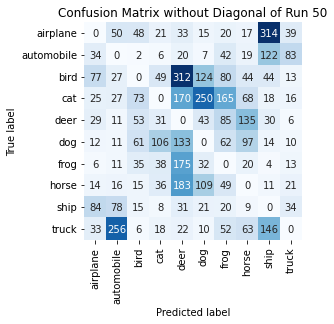

Summing down the rows, for Predictions of each Class that were wrong:  [ 314.  487.  308.  313. 1079.  611.  575.  472.  703.  235.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  312.0 times
Summing across the columns, for total number of that True Class misidentified:  [557. 335. 770. 812. 423. 506. 334. 454. 300. 606.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  135.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 11 November 2021 23:00:54  (subtract ~5-hours for local Hour), and file is called  runs_GroupF_final.pkl


In [ ]:
#@title Group F: 51 Run Results
run_through_runs(ds=make_unbatched(train_F),  ds_noalb=train_F_noalb, dstitle="F" , showpictures= False)

filename will be:  runs_GroupG .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


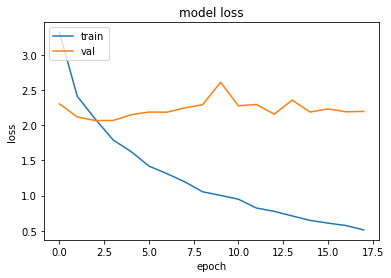

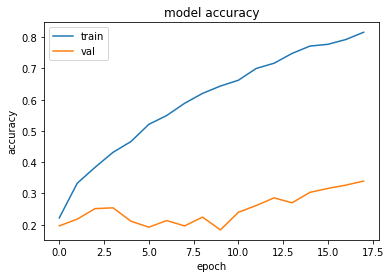

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.066148042678833 , and Val Acc happened to be 0.2515999972820282
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.33970001339912415 and Val Loss happened to be  2.1955902576446533
TestLoss:  2.0580456256866455  TestAcc: 0.2558000087738037
ship 0.85
deer 0.656
dog 0.448
frog 0.337
airplane 0.14
cat 0.08
horse 0.039
bird 0.006
automobile 0.002
truck 0.0


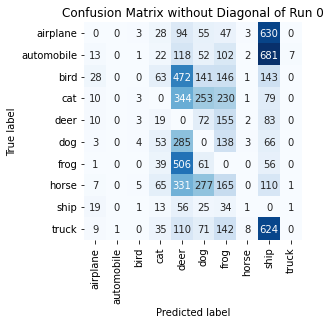

Summing down the rows, for Predictions of each Class that were wrong:  [1.000e+02 1.000e+00 2.000e+01 3.370e+02 2.316e+03 1.007e+03 1.159e+03
 2.100e+01 2.472e+03 9.000e+00]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  506.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 860.  998.  994.  920.  344.  552.  663.  961.  150. 1000.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  155.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:

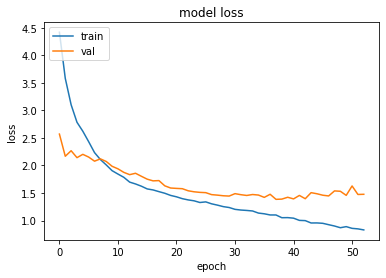

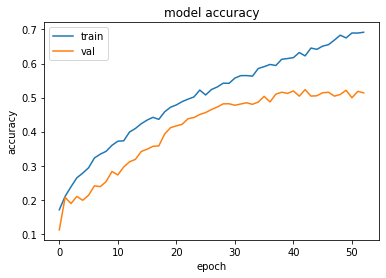

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.384502649307251 , and Val Acc happened to be 0.5101000070571899
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5232999920845032 and Val Loss happened to be  1.3958593606948853
TestLoss:  1.3752039670944214  TestAcc: 0.512499988079071
frog 0.799
automobile 0.763
ship 0.642
airplane 0.56
horse 0.531
dog 0.456
truck 0.451
bird 0.399
deer 0.345
cat 0.179


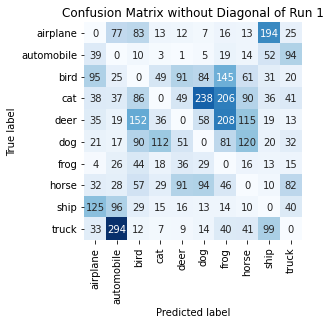

Summing down the rows, for Predictions of each Class that were wrong:  [422. 619. 563. 282. 356. 542. 775. 480. 474. 362.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  91.0 times
Summing across the columns, for total number of that True Class misidentified:  [440. 237. 601. 821. 655. 544. 201. 469. 358. 549.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  208.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0.

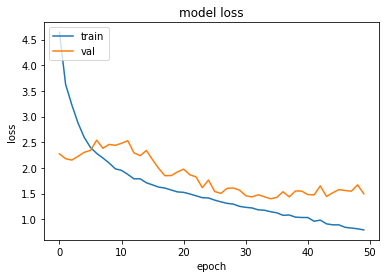

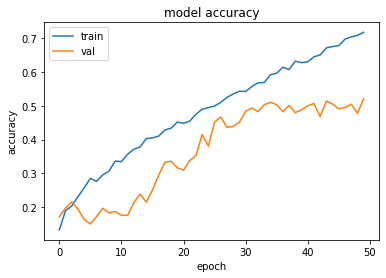

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3980979919433594 , and Val Acc happened to be 0.510200023651123
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5209000110626221 and Val Loss happened to be  1.4957541227340698
TestLoss:  1.364394187927246  TestAcc: 0.5177000164985657
frog 0.802
automobile 0.658
truck 0.634
ship 0.616
horse 0.573
airplane 0.467
dog 0.463
deer 0.426
cat 0.293
bird 0.245


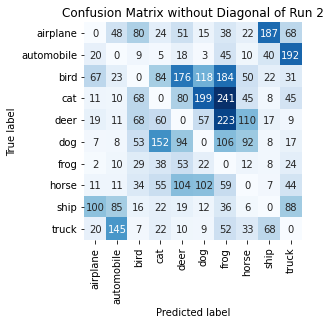

Summing down the rows, for Predictions of each Class that were wrong:  [257. 351. 364. 462. 605. 537. 984. 380. 365. 518.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [533. 342. 755. 707. 574. 537. 198. 427. 384. 366.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  223.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brigh

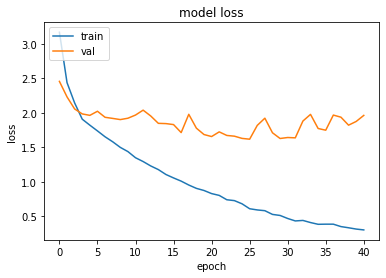

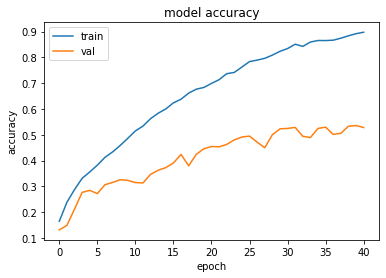

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6168477535247803 , and Val Acc happened to be 0.4950000047683716
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5360000133514404 and Val Loss happened to be  1.8743513822555542
TestLoss:  1.6008503437042236  TestAcc: 0.5040000081062317
frog 0.807
ship 0.657
deer 0.607
automobile 0.561
truck 0.527
horse 0.516
dog 0.446
airplane 0.344
bird 0.316
cat 0.259


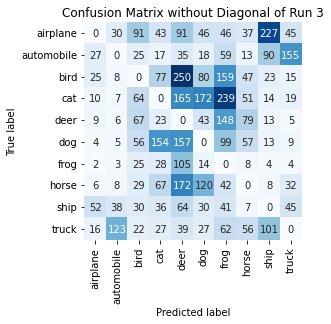

Summing down the rows, for Predictions of each Class that were wrong:  [ 151.  228.  409.  472. 1078.  550.  895.  355.  493.  329.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  250.0 times
Summing across the columns, for total number of that True Class misidentified:  [656. 439. 684. 741. 393. 554. 193. 484. 343. 473.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  148.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

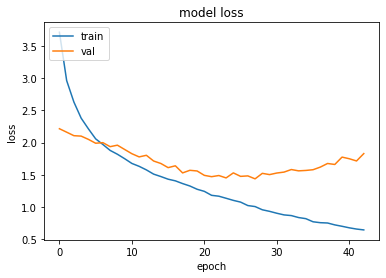

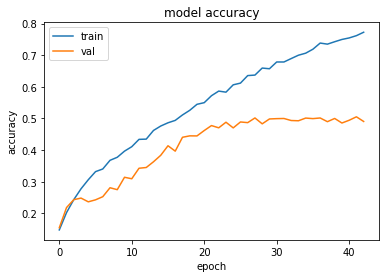

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.4382688999176025 , and Val Acc happened to be 0.5016999840736389
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.505299985408783 and Val Loss happened to be  1.7154361009597778
TestLoss:  1.4377325773239136  TestAcc: 0.5016999840736389
frog 0.745
ship 0.722
automobile 0.609
horse 0.515
dog 0.498
airplane 0.497
truck 0.484
deer 0.418
bird 0.314
cat 0.215


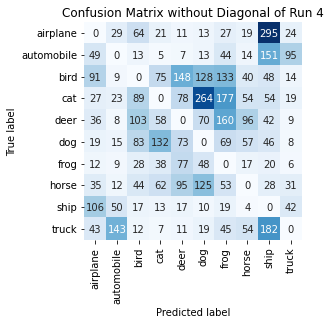

Summing down the rows, for Predictions of each Class that were wrong:  [418. 298. 453. 411. 517. 690. 727. 355. 866. 248.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  148.0 times
Summing across the columns, for total number of that True Class misidentified:  [503. 391. 686. 785. 582. 502. 255. 485. 278. 516.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  160.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

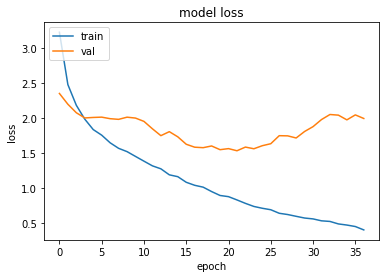

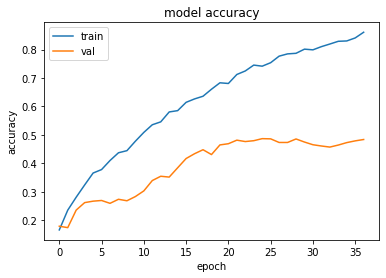

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.532100796699524 , and Val Acc happened to be 0.48170000314712524
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.4869999885559082 and Val Loss happened to be  1.6043365001678467
TestLoss:  1.4944978952407837  TestAcc: 0.49129998683929443
frog 0.733
ship 0.648
automobile 0.546
bird 0.516
horse 0.496
truck 0.491
airplane 0.453
dog 0.364
deer 0.363
cat 0.303


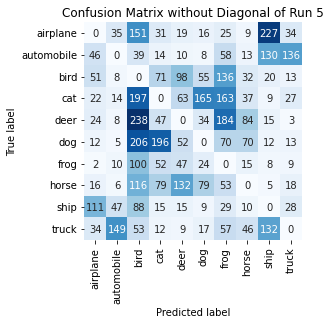

Summing down the rows, for Predictions of each Class that were wrong:  [ 318.  282. 1188.  517.  445.  407.  775.  316.  558.  281.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  132.0 times
Summing across the columns, for total number of that True Class misidentified:  [547. 454. 484. 697. 637. 636. 267. 504. 352. 509.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  238.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0

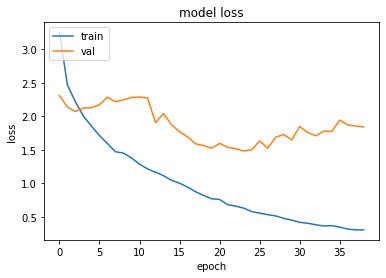

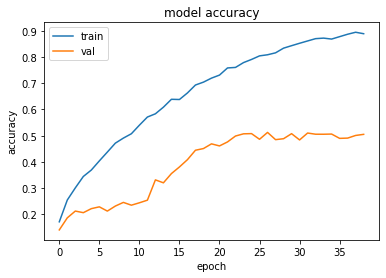

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.484053373336792 , and Val Acc happened to be 0.507099986076355
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.512499988079071 and Val Loss happened to be  1.524491548538208
TestLoss:  1.442238688468933  TestAcc: 0.5121999979019165
frog 0.736
horse 0.629
ship 0.614
truck 0.584
airplane 0.571
deer 0.552
automobile 0.542
dog 0.412
bird 0.334
cat 0.148


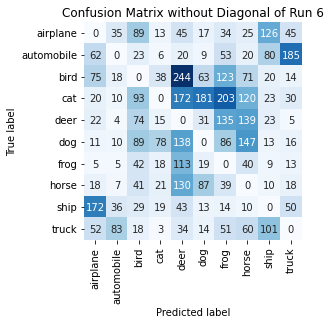

Summing down the rows, for Predictions of each Class that were wrong:  [437. 208. 498. 211. 939. 434. 738. 632. 405. 376.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  244.0 times
Summing across the columns, for total number of that True Class misidentified:  [429. 458. 666. 852. 448. 588. 264. 371. 386. 416.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  139.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Br

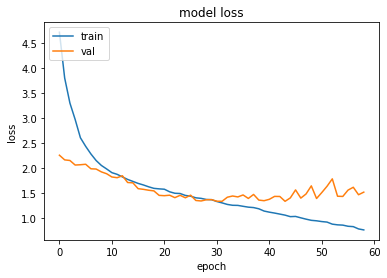

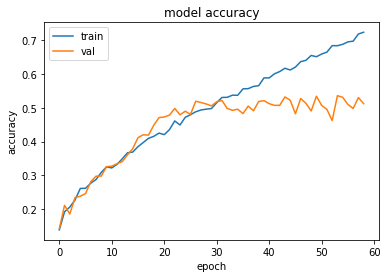

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.342065453529358 , and Val Acc happened to be 0.5321999788284302
Additionally, the best val acc epoch happened to be  53 when val acc was:  0.5357999801635742 and Val Loss happened to be  1.4436440467834473
TestLoss:  1.3173179626464844  TestAcc: 0.5372999906539917
automobile 0.685
dog 0.684
frog 0.662
horse 0.622
ship 0.621
truck 0.598
airplane 0.503
deer 0.393
bird 0.353
cat 0.252


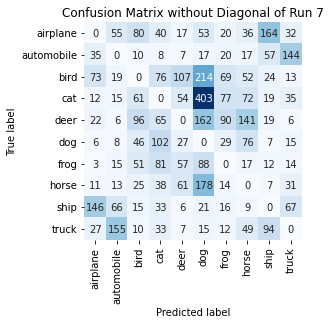

Summing down the rows, for Predictions of each Class that were wrong:  [ 335.  352.  394.  476.  343. 1151.  347.  469.  403.  357.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  107.0 times
Summing across the columns, for total number of that True Class misidentified:  [497. 315. 647. 748. 607. 316. 338. 378. 379. 402.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  162.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Brig

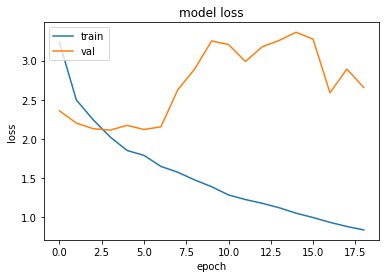

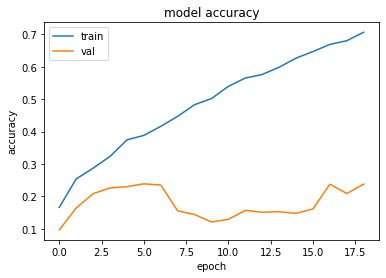

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.110494375228882 , and Val Acc happened to be 0.22599999606609344
Additionally, the best val acc epoch happened to be  5 when val acc was:  0.2386000007390976 and Val Loss happened to be  2.1184704303741455
TestLoss:  2.097618341445923  TestAcc: 0.22910000383853912
frog 0.536
dog 0.516
cat 0.4
ship 0.381
airplane 0.361
bird 0.051
horse 0.034
truck 0.012
automobile 0.0
deer 0.0


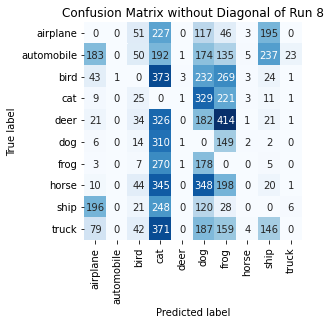

Summing down the rows, for Predictions of each Class that were wrong:  [5.500e+02 1.000e+00 2.880e+02 2.662e+03 7.000e+00 1.867e+03 1.619e+03
 2.100e+01 6.610e+02 3.300e+01]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  3.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 639. 1000.  949.  600. 1000.  484.  464.  966.  619.  988.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  414.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
bl

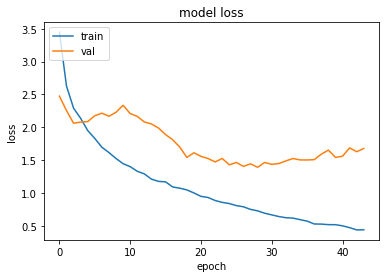

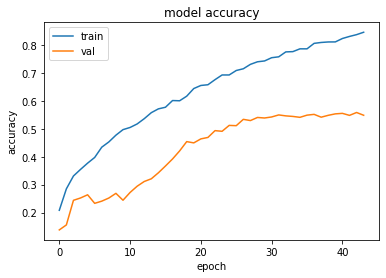

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.3906350135803223 , and Val Acc happened to be 0.5404000282287598
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5582000017166138 and Val Loss happened to be  1.626976728439331
TestLoss:  1.3558539152145386  TestAcc: 0.5544000267982483
frog 0.786
ship 0.702
automobile 0.646
horse 0.585
truck 0.581
airplane 0.536
dog 0.478
deer 0.459
cat 0.453
bird 0.318


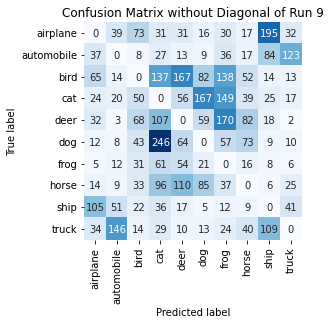

Summing down the rows, for Predictions of each Class that were wrong:  [328. 302. 342. 770. 522. 457. 653. 345. 468. 269.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  167.0 times
Summing across the columns, for total number of that True Class misidentified:  [464. 354. 682. 547. 541. 522. 214. 415. 298. 419.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  170.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

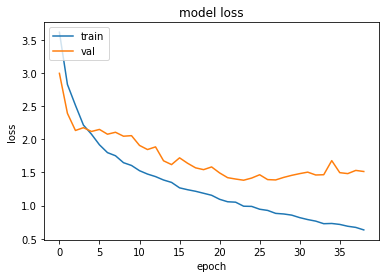

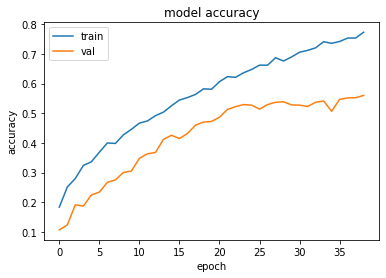

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.3824630975723267 , and Val Acc happened to be 0.5292999744415283
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5601999759674072 and Val Loss happened to be  1.5140185356140137
TestLoss:  1.3651224374771118  TestAcc: 0.531499981880188
frog 0.74
ship 0.735
automobile 0.723
airplane 0.56
horse 0.554
dog 0.543
truck 0.45
deer 0.442
bird 0.342
cat 0.226


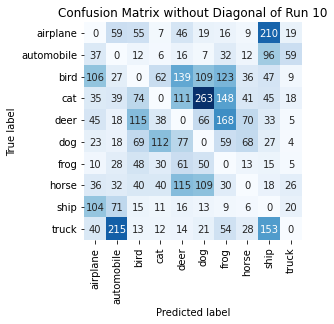

Summing down the rows, for Predictions of each Class that were wrong:  [436. 507. 441. 318. 595. 657. 639. 283. 644. 165.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [440. 277. 658. 774. 558. 457. 260. 446. 265. 550.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  168.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

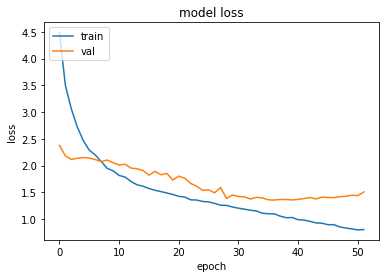

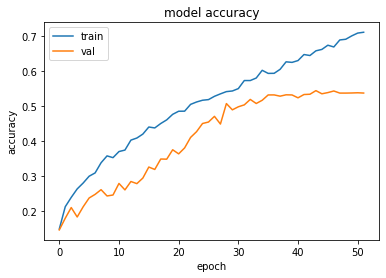

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3560798168182373 , and Val Acc happened to be 0.5314000248908997
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5436000227928162 and Val Loss happened to be  1.3771615028381348
TestLoss:  1.337926983833313  TestAcc: 0.5270000100135803
frog 0.722
automobile 0.677
dog 0.671
ship 0.621
truck 0.593
horse 0.536
airplane 0.532
deer 0.354
bird 0.332
cat 0.232


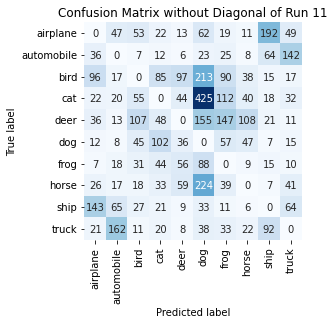

Summing down the rows, for Predictions of each Class that were wrong:  [ 399.  367.  354.  387.  328. 1261.  533.  289.  431.  381.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  97.0 times
Summing across the columns, for total number of that True Class misidentified:  [468. 323. 668. 768. 646. 329. 278. 464. 379. 407.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  155.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16

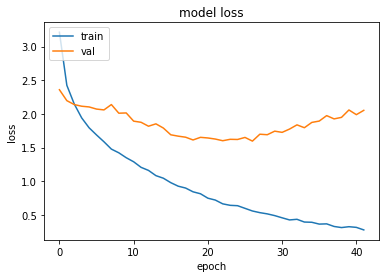

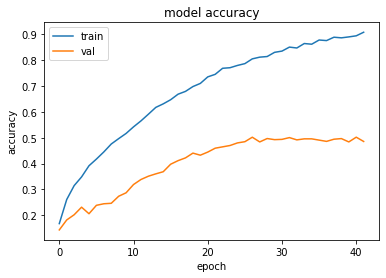

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.5955575704574585 , and Val Acc happened to be 0.501800000667572
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5019000172615051 and Val Loss happened to be  1.988632082939148
TestLoss:  1.5715094804763794  TestAcc: 0.5023000240325928
frog 0.737
ship 0.676
automobile 0.554
airplane 0.518
dog 0.487
horse 0.483
truck 0.478
deer 0.442
cat 0.327
bird 0.321


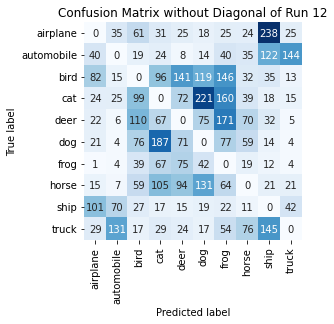

Summing down the rows, for Predictions of each Class that were wrong:  [335. 297. 507. 623. 525. 656. 759. 365. 637. 273.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [482. 446. 679. 673. 558. 513. 263. 517. 324. 522.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.0 , 0.0 )


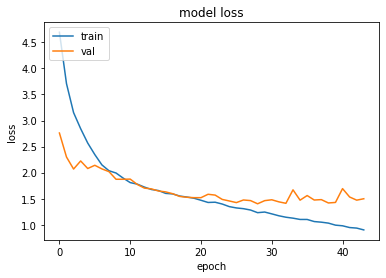

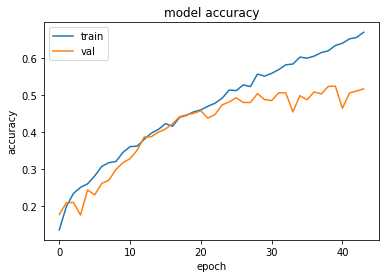

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.401841640472412 , and Val Acc happened to be 0.5041000247001648
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5242999792098999 and Val Loss happened to be  1.4275985956192017
TestLoss:  1.361502766609192  TestAcc: 0.5130000114440918
frog 0.841
automobile 0.719
ship 0.587
horse 0.552
dog 0.551
airplane 0.529
truck 0.528
deer 0.377
bird 0.277
cat 0.169


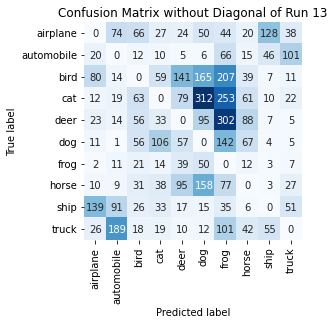

Summing down the rows, for Predictions of each Class that were wrong:  [ 323.  422.  349.  339.  467.  863. 1227.  350.  263.  267.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [471. 281. 723. 831. 623. 449. 159. 448. 413. 472.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  302.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

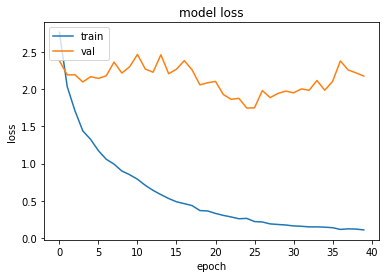

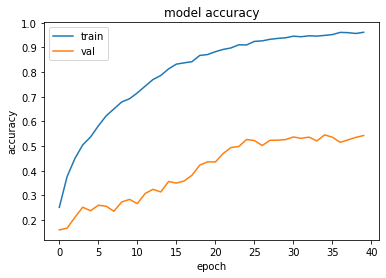

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.7468761205673218 , and Val Acc happened to be 0.5268999934196472
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5455999970436096 and Val Loss happened to be  1.9860191345214844
TestLoss:  1.7150697708129883  TestAcc: 0.5271000266075134
frog 0.808
ship 0.718
automobile 0.702
horse 0.541
airplane 0.537
truck 0.516
deer 0.478
dog 0.395
bird 0.31
cat 0.266


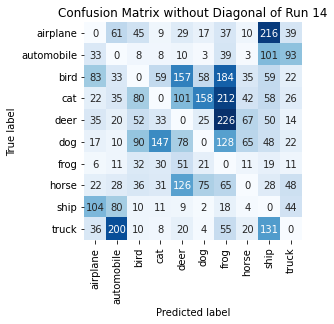

Summing down the rows, for Predictions of each Class that were wrong:  [358. 478. 363. 336. 581. 363. 964. 257. 710. 319.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  157.0 times
Summing across the columns, for total number of that True Class misidentified:  [463. 298. 690. 734. 522. 605. 192. 459. 282. 484.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  226.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

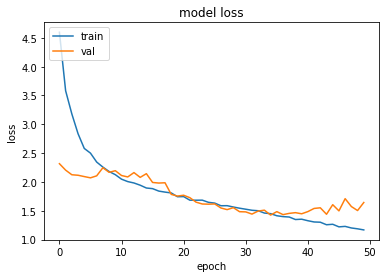

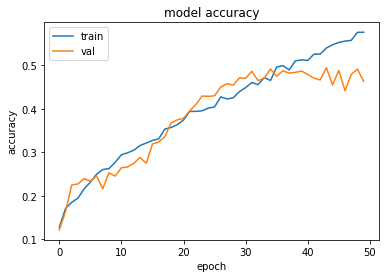

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4247496128082275 , and Val Acc happened to be 0.4909000098705292
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.4941999912261963 and Val Loss happened to be  1.4388703107833862
TestLoss:  1.4177730083465576  TestAcc: 0.489300012588501
frog 0.751
ship 0.634
automobile 0.538
truck 0.528
horse 0.515
dog 0.479
deer 0.45
airplane 0.401
cat 0.302
bird 0.295


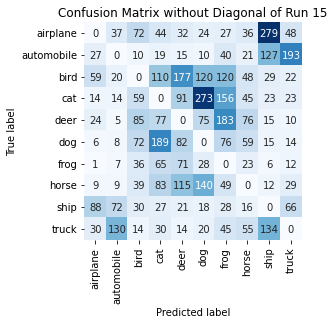

Summing down the rows, for Predictions of each Class that were wrong:  [258. 302. 417. 644. 618. 708. 724. 379. 640. 417.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  177.0 times
Summing across the columns, for total number of that True Class misidentified:  [599. 462. 705. 698. 550. 521. 249. 485. 366. 472.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  183.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


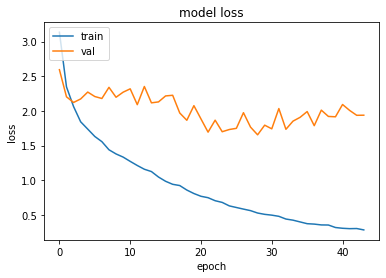

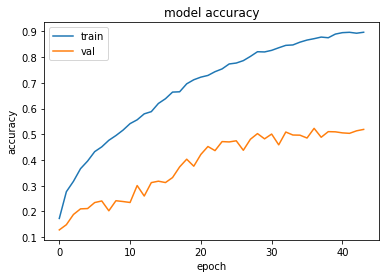

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.654687523841858 , and Val Acc happened to be 0.5027999877929688
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5231999754905701 and Val Loss happened to be  1.7866078615188599
TestLoss:  1.6507338285446167  TestAcc: 0.5037000179290771
frog 0.739
automobile 0.649
ship 0.626
truck 0.56
horse 0.536
deer 0.504
dog 0.463
airplane 0.364
bird 0.328
cat 0.268


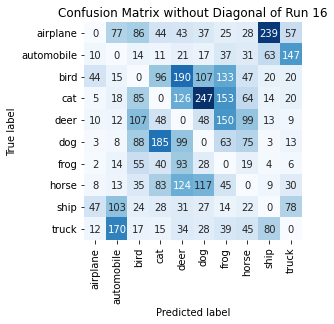

Summing down the rows, for Predictions of each Class that were wrong:  [141. 430. 511. 550. 761. 656. 659. 430. 445. 380.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  190.0 times
Summing across the columns, for total number of that True Class misidentified:  [636. 351. 672. 732. 496. 537. 261. 464. 374. 440.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  150.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

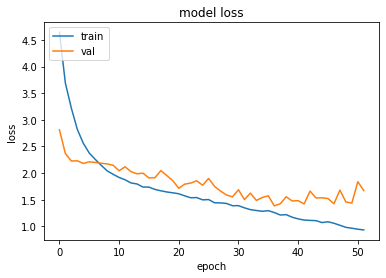

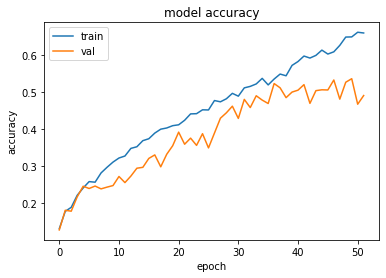

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3841561079025269 , and Val Acc happened to be 0.522599995136261
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5357000231742859 and Val Loss happened to be  1.4357383251190186
TestLoss:  1.3422662019729614  TestAcc: 0.5239999890327454
frog 0.756
ship 0.685
truck 0.633
automobile 0.572
horse 0.53
dog 0.526
deer 0.465
airplane 0.446
bird 0.354
cat 0.273


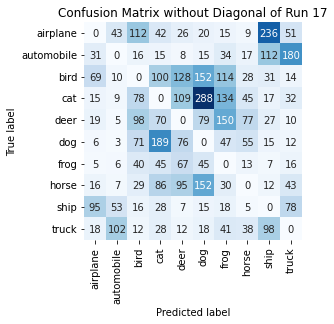

Summing down the rows, for Predictions of each Class that were wrong:  [274. 238. 472. 603. 528. 784. 583. 287. 555. 436.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [554. 428. 646. 727. 535. 474. 244. 470. 315. 367.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  150.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

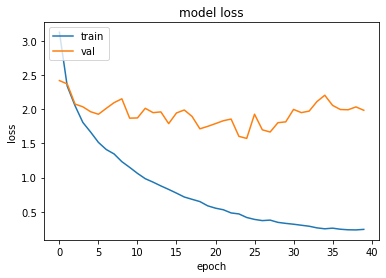

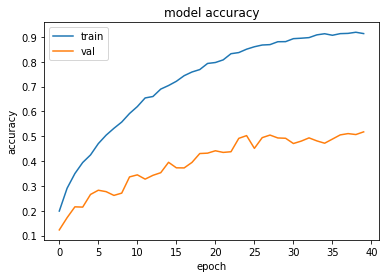

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5724879503250122 , and Val Acc happened to be 0.5026000142097473
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5177000164985657 and Val Loss happened to be  1.984025001525879
TestLoss:  1.5497887134552002  TestAcc: 0.5103999972343445
frog 0.832
ship 0.682
automobile 0.569
airplane 0.546
horse 0.516
dog 0.464
truck 0.46
cat 0.389
deer 0.336
bird 0.31


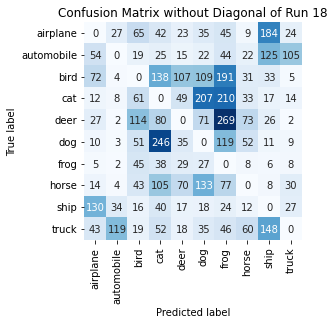

Summing down the rows, for Predictions of each Class that were wrong:  [ 367.  203.  433.  766.  363.  657. 1025.  300.  558.  224.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  107.0 times
Summing across the columns, for total number of that True Class misidentified:  [454. 431. 690. 611. 664. 536. 168. 484. 318. 540.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  269.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

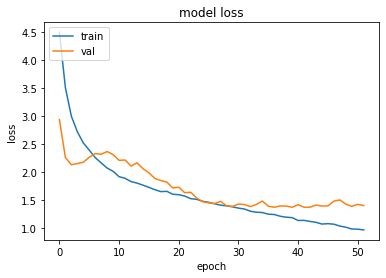

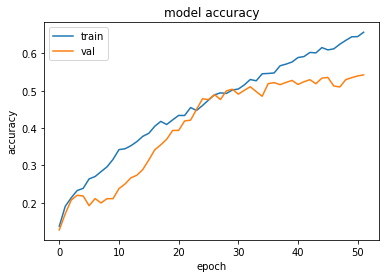

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3733986616134644 , and Val Acc happened to be 0.5214999914169312
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5422000288963318 and Val Loss happened to be  1.4040377140045166
TestLoss:  1.3552321195602417  TestAcc: 0.5264999866485596
frog 0.783
automobile 0.665
ship 0.626
truck 0.611
horse 0.581
airplane 0.526
dog 0.476
deer 0.443
cat 0.309
bird 0.245


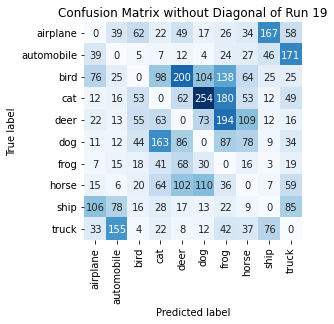

Summing down the rows, for Predictions of each Class that were wrong:  [321. 359. 277. 508. 604. 617. 749. 427. 357. 516.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  200.0 times
Summing across the columns, for total number of that True Class misidentified:  [474. 335. 755. 691. 557. 524. 217. 419. 374. 389.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  194.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

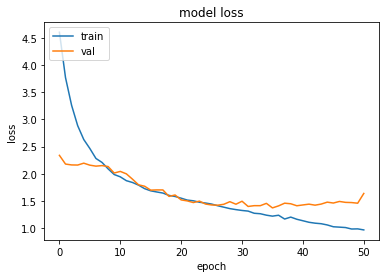

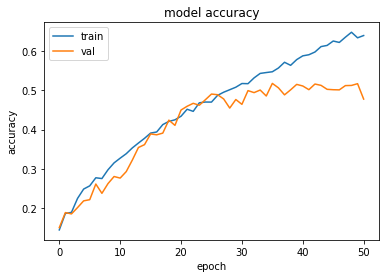

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3702424764633179 , and Val Acc happened to be 0.5177000164985657
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5177000164985657 and Val Loss happened to be  1.3702424764633179
TestLoss:  1.344718337059021  TestAcc: 0.5189999938011169
frog 0.727
truck 0.629
automobile 0.628
ship 0.614
horse 0.563
dog 0.468
airplane 0.463
deer 0.425
cat 0.343
bird 0.33


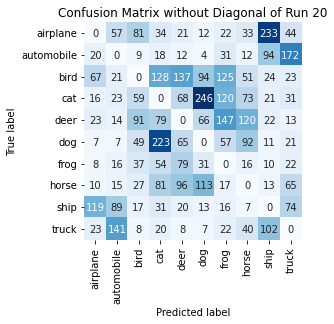

Summing down the rows, for Predictions of each Class that were wrong:  [293. 383. 378. 668. 506. 586. 557. 444. 530. 465.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  137.0 times
Summing across the columns, for total number of that True Class misidentified:  [537. 372. 670. 657. 575. 532. 273. 437. 386. 371.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  147.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

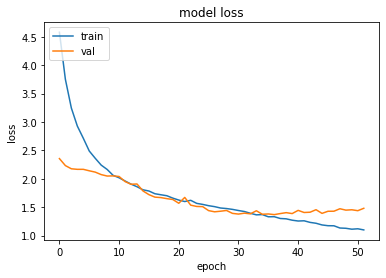

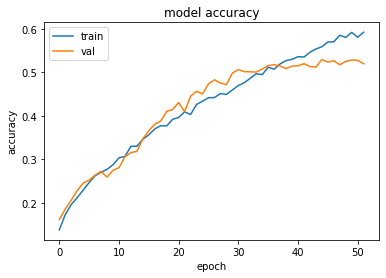

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3688087463378906 , and Val Acc happened to be 0.517300009727478
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.52920001745224 and Val Loss happened to be  1.3904482126235962
TestLoss:  1.3490278720855713  TestAcc: 0.5205000042915344
frog 0.766
automobile 0.648
truck 0.624
dog 0.567
horse 0.566
ship 0.555
airplane 0.521
deer 0.426
bird 0.297
cat 0.235


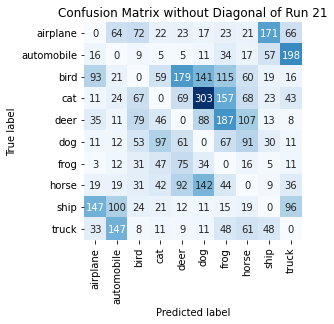

Summing down the rows, for Predictions of each Class that were wrong:  [368. 410. 374. 350. 525. 758. 690. 460. 375. 485.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [479. 352. 703. 765. 574. 433. 234. 434. 445. 376.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  187.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

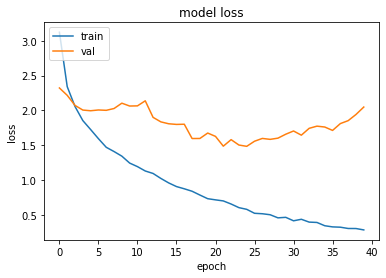

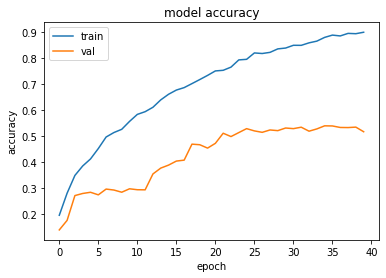

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.4835572242736816 , and Val Acc happened to be 0.527999997138977
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5388000011444092 and Val Loss happened to be  1.7611783742904663
TestLoss:  1.4600369930267334  TestAcc: 0.5321000218391418
ship 0.794
frog 0.743
truck 0.686
airplane 0.503
horse 0.482
automobile 0.465
dog 0.443
deer 0.419
cat 0.397
bird 0.389


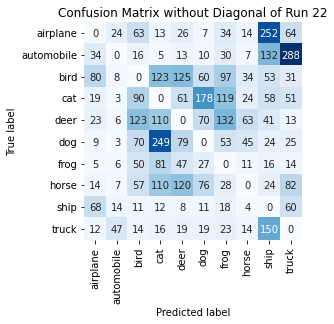

Summing down the rows, for Predictions of each Class that were wrong:  [264. 118. 494. 719. 498. 458. 534. 216. 750. 628.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [497. 535. 611. 603. 581. 557. 257. 518. 206. 314.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  132.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 , 0.08 )


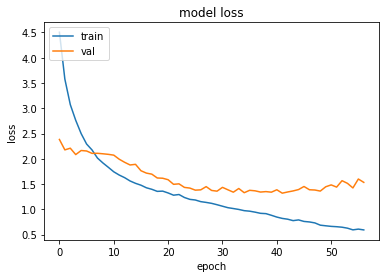

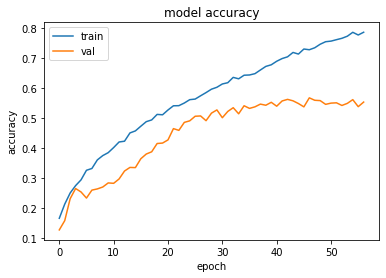

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.3198931217193604 , and Val Acc happened to be 0.5569000244140625
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.567300021648407 and Val Loss happened to be  1.387532353401184
TestLoss:  1.3049832582473755  TestAcc: 0.5552999973297119
ship 0.728
frog 0.693
truck 0.68
automobile 0.608
horse 0.592
airplane 0.584
dog 0.577
deer 0.554
bird 0.282
cat 0.255


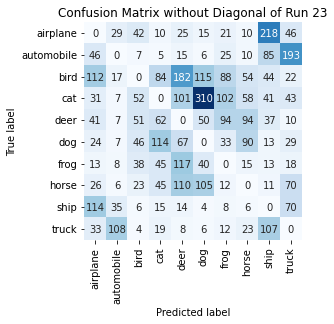

Summing down the rows, for Predictions of each Class that were wrong:  [440. 224. 269. 399. 639. 651. 395. 360. 569. 501.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [416. 392. 718. 745. 446. 423. 307. 408. 272. 320.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  94.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:   

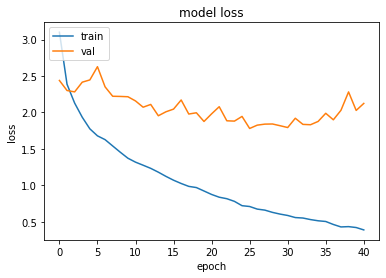

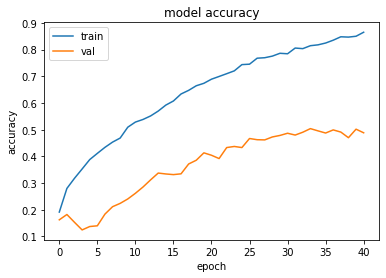

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.7801896333694458 , and Val Acc happened to be 0.4668999910354614
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5038999915122986 and Val Loss happened to be  1.8313976526260376
TestLoss:  1.7313785552978516  TestAcc: 0.46619999408721924
frog 0.893
ship 0.735
automobile 0.53
truck 0.528
airplane 0.456
horse 0.364
bird 0.334
dog 0.319
cat 0.278
deer 0.225


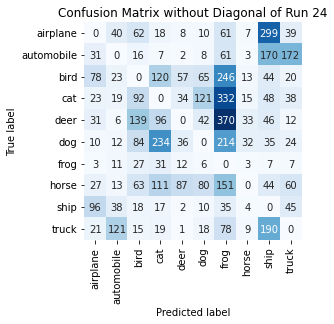

Summing down the rows, for Predictions of each Class that were wrong:  [ 320.  283.  516.  653.  239.  360. 1548.  119.  883.  417.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [544. 470. 666. 722. 775. 681. 107. 636. 265. 472.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  370.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

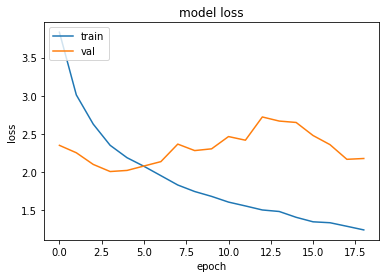

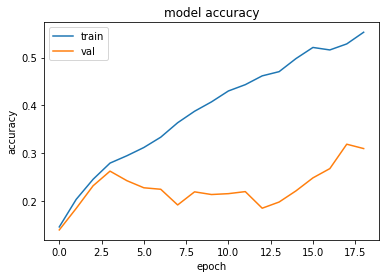

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.007877826690674 , and Val Acc happened to be 0.26260000467300415
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.3188999891281128 and Val Loss happened to be  2.167783498764038
TestLoss:  1.998958945274353  TestAcc: 0.2685000002384186
airplane 0.564
dog 0.546
ship 0.464
deer 0.293
frog 0.273
cat 0.272
bird 0.15
horse 0.054
automobile 0.036
truck 0.033


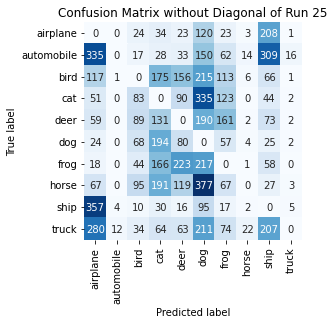

Summing down the rows, for Predictions of each Class that were wrong:  [1308.   17.  464. 1013.  803. 1910.  697.   54. 1017.   32.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  223.0 times
Summing across the columns, for total number of that True Class misidentified:  [436. 964. 850. 728. 707. 454. 727. 946. 536. 967.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  190.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:  

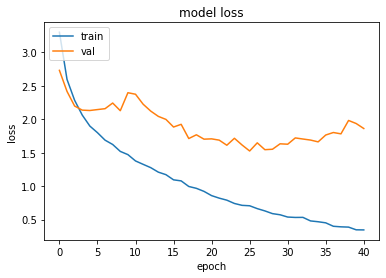

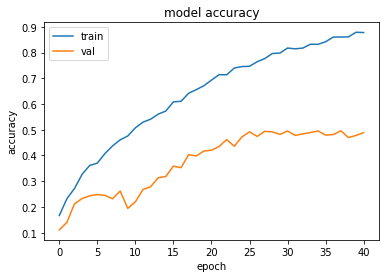

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5261492729187012 , and Val Acc happened to be 0.4918999969959259
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.4957999885082245 and Val Loss happened to be  1.7824749946594238
TestLoss:  1.5272674560546875  TestAcc: 0.48100000619888306
frog 0.763
ship 0.642
automobile 0.546
truck 0.517
dog 0.468
airplane 0.438
deer 0.418
cat 0.392
horse 0.388
bird 0.238


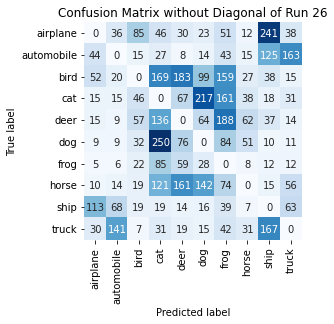

Summing down the rows, for Predictions of each Class that were wrong:  [293. 318. 302. 884. 617. 618. 841. 251. 663. 403.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  183.0 times
Summing across the columns, for total number of that True Class misidentified:  [562. 454. 762. 608. 582. 532. 237. 612. 358. 483.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  188.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

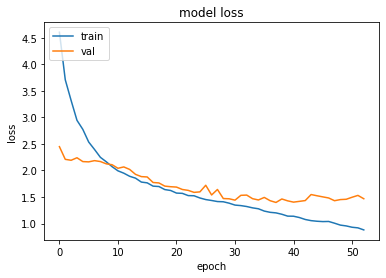

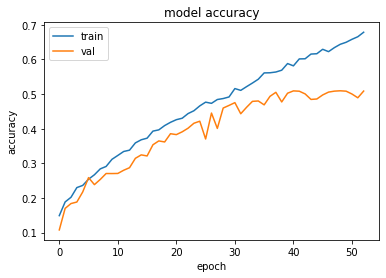

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3968985080718994 , and Val Acc happened to be 0.5049999952316284
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5094000101089478 and Val Loss happened to be  1.451026201248169
TestLoss:  1.372299313545227  TestAcc: 0.5105999708175659
frog 0.772
automobile 0.7
ship 0.621
dog 0.597
truck 0.575
horse 0.531
airplane 0.454
deer 0.363
bird 0.305
cat 0.188


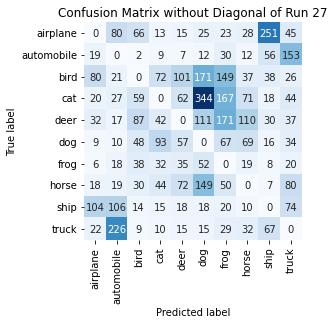

Summing down the rows, for Predictions of each Class that were wrong:  [310. 524. 353. 330. 382. 897. 706. 388. 491. 513.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [546. 300. 695. 812. 637. 403. 228. 469. 379. 425.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

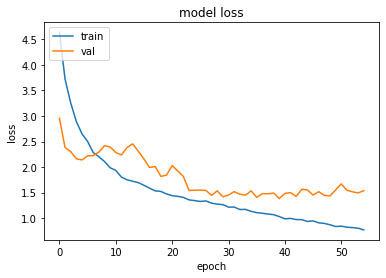

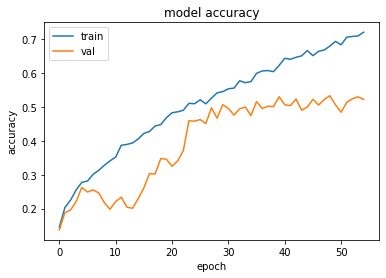

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3839657306671143 , and Val Acc happened to be 0.529699981212616
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5325999855995178 and Val Loss happened to be  1.4356778860092163
TestLoss:  1.3545331954956055  TestAcc: 0.5268999934196472
truck 0.662
frog 0.65
automobile 0.626
ship 0.597
horse 0.576
airplane 0.549
dog 0.544
deer 0.54
bird 0.277
cat 0.248


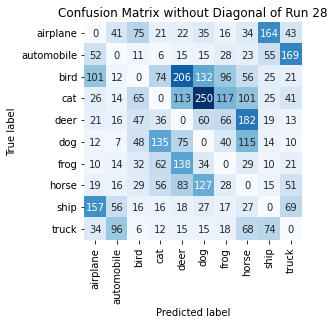

Summing down the rows, for Predictions of each Class that were wrong:  [432. 272. 329. 418. 685. 695. 426. 635. 401. 438.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  206.0 times
Summing across the columns, for total number of that True Class misidentified:  [451. 374. 723. 752. 460. 456. 350. 424. 403. 338.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  182.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )

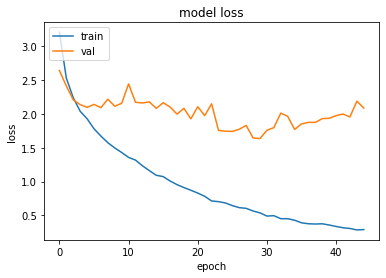

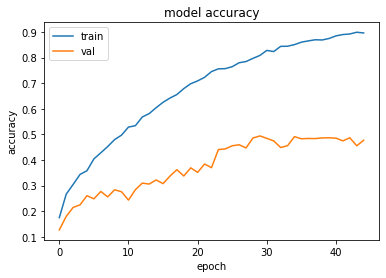

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.6373796463012695 , and Val Acc happened to be 0.49380001425743103
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.49380001425743103 and Val Loss happened to be  1.6373796463012695
TestLoss:  1.610285758972168  TestAcc: 0.4973999857902527
frog 0.772
ship 0.647
automobile 0.541
truck 0.532
deer 0.492
horse 0.48
airplane 0.472
dog 0.39
bird 0.343
cat 0.305


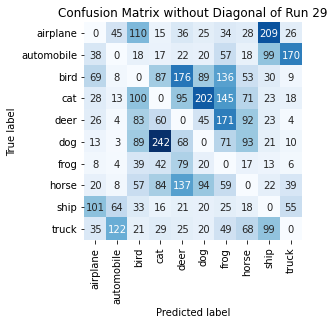

Summing down the rows, for Predictions of each Class that were wrong:  [338. 271. 550. 592. 659. 535. 747. 458. 539. 337.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [528. 459. 657. 695. 508. 610. 228. 520. 353. 468.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

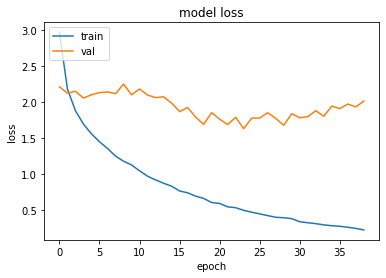

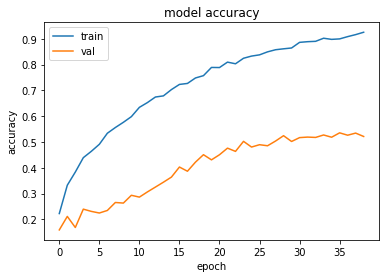

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6277241706848145 , and Val Acc happened to be 0.5026000142097473
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5356000065803528 and Val Loss happened to be  1.9076288938522339
TestLoss:  1.5909934043884277  TestAcc: 0.5113999843597412
frog 0.751
ship 0.708
truck 0.586
deer 0.537
horse 0.492
automobile 0.468
dog 0.451
airplane 0.442
cat 0.414
bird 0.265


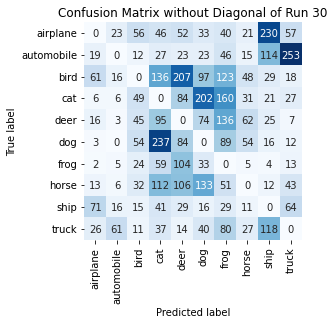

Summing down the rows, for Predictions of each Class that were wrong:  [217. 136. 298. 790. 703. 651. 754. 274. 569. 494.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  207.0 times
Summing across the columns, for total number of that True Class misidentified:  [558. 532. 735. 586. 463. 549. 249. 508. 292. 414.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  136.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 

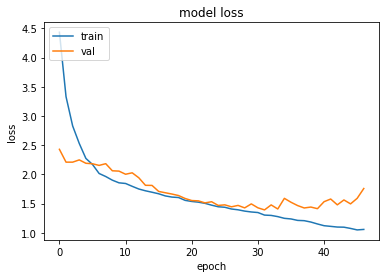

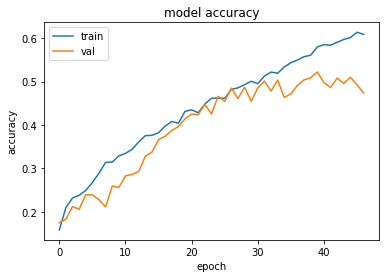

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.3929930925369263 , and Val Acc happened to be 0.5009999871253967
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5220000147819519 and Val Loss happened to be  1.4139131307601929
TestLoss:  1.3719607591629028  TestAcc: 0.5016999840736389
frog 0.84
ship 0.737
automobile 0.671
truck 0.595
horse 0.518
dog 0.455
deer 0.368
airplane 0.34
cat 0.319
bird 0.174


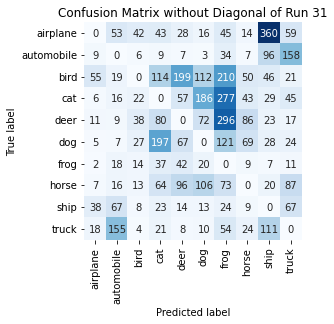

Summing down the rows, for Predictions of each Class that were wrong:  [ 151.  360.  174.  588.  518.  538. 1134.  311.  720.  489.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  199.0 times
Summing across the columns, for total number of that True Class misidentified:  [660. 329. 826. 681. 632. 545. 160. 482. 263. 405.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  296.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

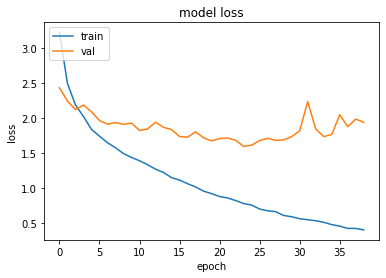

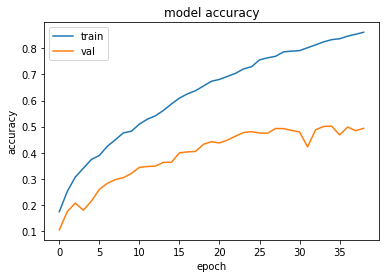

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5917935371398926 , and Val Acc happened to be 0.4772999882698059
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.501800000667572 and Val Loss happened to be  1.761996865272522
TestLoss:  1.5777620077133179  TestAcc: 0.4810999929904938
frog 0.792
ship 0.657
automobile 0.596
deer 0.546
truck 0.496
horse 0.434
airplane 0.381
cat 0.311
bird 0.304
dog 0.294


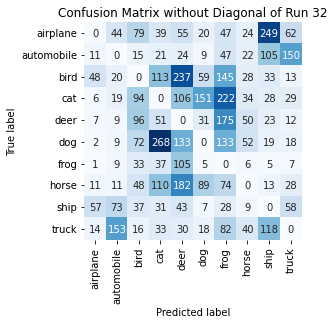

Summing down the rows, for Predictions of each Class that were wrong:  [157. 347. 490. 703. 915. 389. 953. 265. 593. 377.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  237.0 times
Summing across the columns, for total number of that True Class misidentified:  [619. 404. 696. 689. 454. 706. 208. 566. 343. 504.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  175.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    

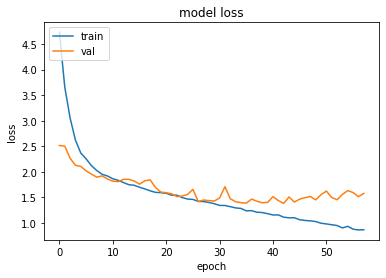

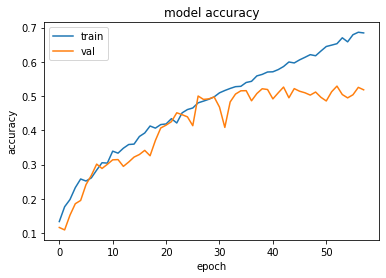

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  42 when  Val Loss was:  1.3828991651535034 , and Val Acc happened to be 0.526199996471405
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5289999842643738 and Val Loss happened to be  1.4557886123657227
TestLoss:  1.3597722053527832  TestAcc: 0.5260999798774719
frog 0.735
ship 0.66
automobile 0.617
truck 0.604
dog 0.557
airplane 0.519
horse 0.485
deer 0.438
cat 0.389
bird 0.257


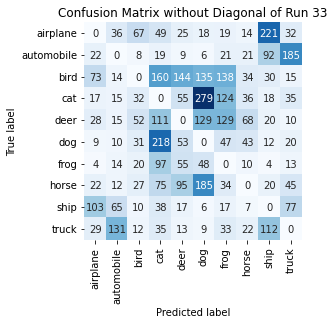

Summing down the rows, for Predictions of each Class that were wrong:  [307. 312. 259. 802. 466. 815. 562. 255. 529. 432.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  144.0 times
Summing across the columns, for total number of that True Class misidentified:  [481. 383. 743. 611. 562. 443. 265. 515. 340. 396.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  129.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:   

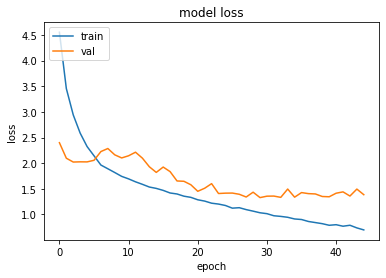

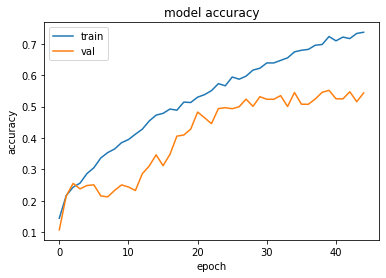

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.328948736190796 , and Val Acc happened to be 0.5317000150680542
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.551800012588501 and Val Loss happened to be  1.3451504707336426
TestLoss:  1.3019174337387085  TestAcc: 0.5338000059127808
ship 0.811
frog 0.797
truck 0.594
automobile 0.591
horse 0.538
dog 0.519
deer 0.483
airplane 0.397
cat 0.322
bird 0.286


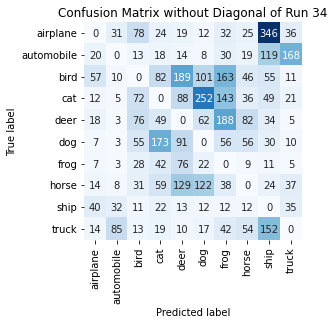

Summing down the rows, for Predictions of each Class that were wrong:  [189. 180. 377. 488. 629. 608. 704. 339. 820. 328.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [603. 409. 714. 678. 517. 481. 203. 462. 189. 406.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  188.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

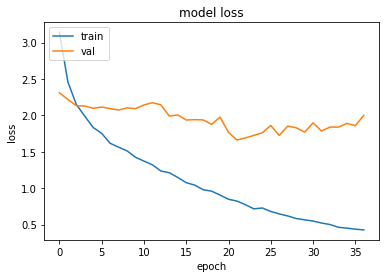

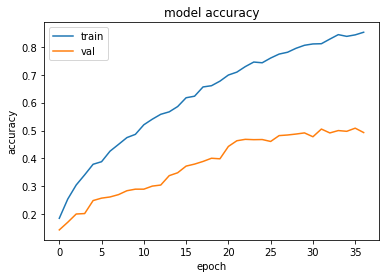

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.661531686782837 , and Val Acc happened to be 0.46320000290870667
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.508400022983551 and Val Loss happened to be  1.8595607280731201
TestLoss:  1.6298285722732544  TestAcc: 0.46470001339912415
ship 0.791
frog 0.745
bird 0.491
truck 0.478
horse 0.442
deer 0.41
automobile 0.391
dog 0.366
airplane 0.315
cat 0.218


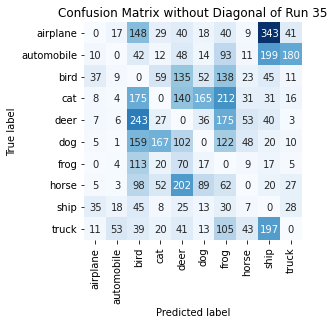

Summing down the rows, for Predictions of each Class that were wrong:  [ 118.  115. 1062.  394.  803.  417.  977.  234.  912.  321.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [685. 609. 509. 782. 590. 634. 255. 558. 209. 522.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  243.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

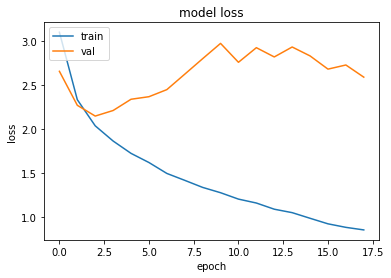

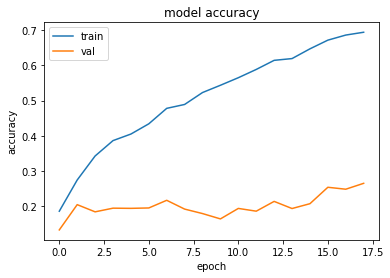

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.145529270172119 , and Val Acc happened to be 0.18459999561309814
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.2653999924659729 and Val Loss happened to be  2.5879502296447754
TestLoss:  2.144807815551758  TestAcc: 0.18539999425411224
dog 0.845
airplane 0.267
ship 0.227
cat 0.158
truck 0.112
bird 0.081
frog 0.08
deer 0.043
horse 0.036
automobile 0.005


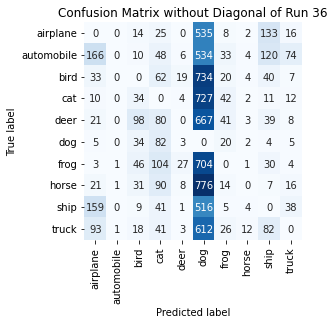

Summing down the rows, for Predictions of each Class that were wrong:  [5.110e+02 3.000e+00 2.940e+02 5.730e+02 7.100e+01 5.805e+03 2.090e+02
 3.400e+01 4.660e+02 1.800e+02]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  27.0 times
Summing across the columns, for total number of that True Class misidentified:  [733. 995. 919. 842. 957. 155. 920. 964. 773. 888.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  667.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 1

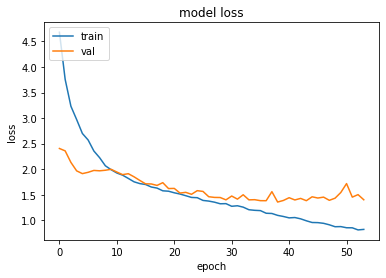

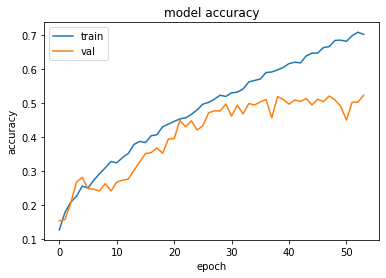

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3561967611312866 , and Val Acc happened to be 0.5188000202178955
Additionally, the best val acc epoch happened to be  53 when val acc was:  0.5231000185012817 and Val Loss happened to be  1.4007489681243896
TestLoss:  1.347326397895813  TestAcc: 0.5206999778747559
frog 0.769
dog 0.689
automobile 0.644
truck 0.599
ship 0.59
airplane 0.539
horse 0.496
deer 0.408
bird 0.281
cat 0.192


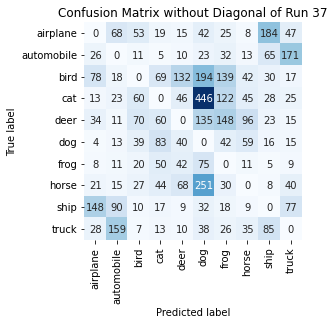

Summing down the rows, for Predictions of each Class that were wrong:  [ 360.  408.  297.  360.  372. 1236.  582.  318.  444.  416.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  132.0 times
Summing across the columns, for total number of that True Class misidentified:  [461. 356. 719. 808. 592. 311. 231. 504. 410. 401.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  148.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

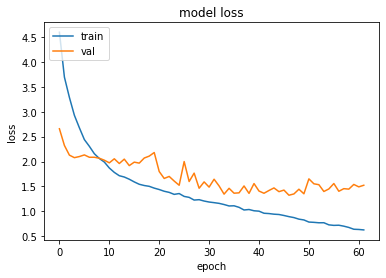

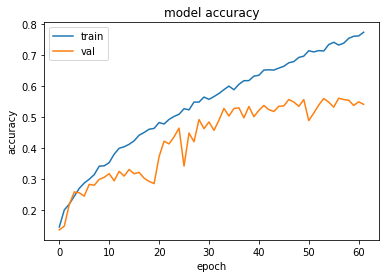

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  46 when  Val Loss was:  1.3245728015899658 , and Val Acc happened to be 0.5565999746322632
Additionally, the best val acc epoch happened to be  56 when val acc was:  0.5608000159263611 and Val Loss happened to be  1.404035210609436
TestLoss:  1.3076629638671875  TestAcc: 0.5594000220298767
frog 0.755
ship 0.685
automobile 0.675
truck 0.642
dog 0.599
horse 0.595
airplane 0.551
deer 0.462
bird 0.356
cat 0.274


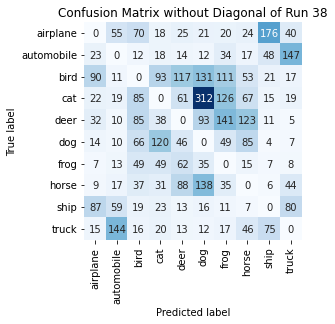

Summing down the rows, for Predictions of each Class that were wrong:  [299. 338. 439. 410. 439. 770. 544. 437. 363. 367.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  117.0 times
Summing across the columns, for total number of that True Class misidentified:  [449. 325. 644. 726. 538. 401. 245. 405. 315. 358.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  141.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

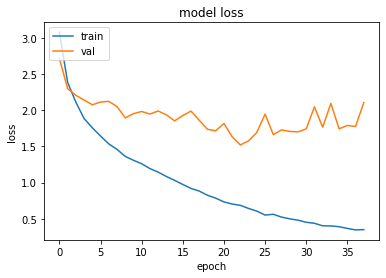

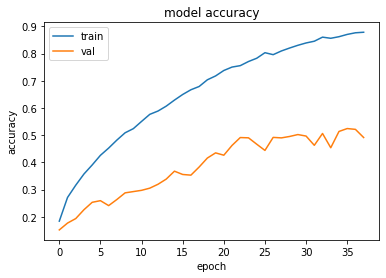

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5204517841339111 , and Val Acc happened to be 0.491100013256073
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5242000222206116 and Val Loss happened to be  1.7910056114196777
TestLoss:  1.4868906736373901  TestAcc: 0.4934999942779541
ship 0.803
frog 0.683
deer 0.622
truck 0.515
horse 0.456
automobile 0.448
dog 0.389
airplane 0.362
bird 0.362
cat 0.295


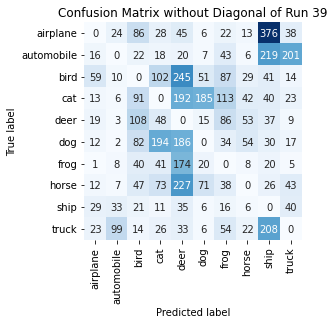

Summing down the rows, for Predictions of each Class that were wrong:  [ 184.  192.  511.  541. 1157.  367.  493.  233.  997.  390.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  245.0 times
Summing across the columns, for total number of that True Class misidentified:  [638. 552. 638. 705. 378. 611. 317. 544. 197. 485.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  108.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

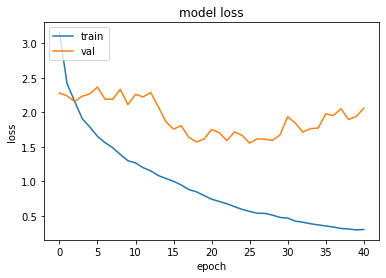

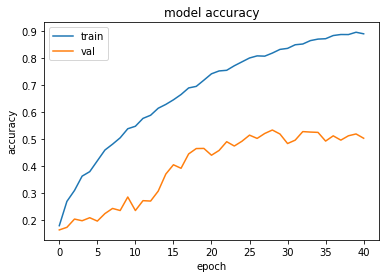

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5540097951889038 , and Val Acc happened to be 0.5152999758720398
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5343000292778015 and Val Loss happened to be  1.593781590461731
TestLoss:  1.5176340341567993  TestAcc: 0.5231000185012817
ship 0.761
frog 0.749
automobile 0.576
truck 0.543
horse 0.484
bird 0.474
airplane 0.437
cat 0.417
deer 0.411
dog 0.379


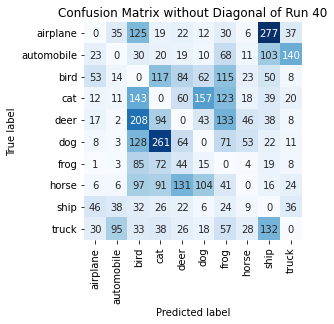

Summing down the rows, for Predictions of each Class that were wrong:  [196. 207. 881. 738. 472. 427. 662. 198. 696. 292.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  131.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 424. 526. 583. 589. 621. 251. 516. 239. 457.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  208.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


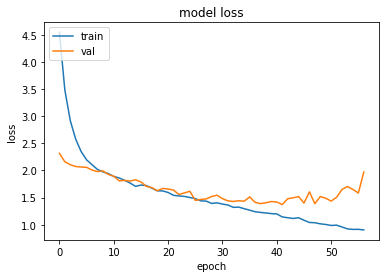

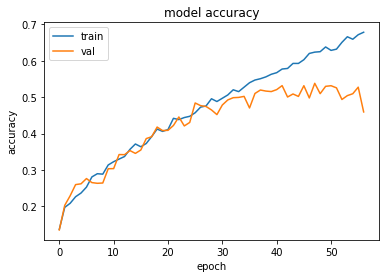

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.3719921112060547 , and Val Acc happened to be 0.5315999984741211
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5379999876022339 and Val Loss happened to be  1.386783242225647
TestLoss:  1.3395750522613525  TestAcc: 0.5332000255584717
frog 0.803
automobile 0.715
ship 0.662
dog 0.645
horse 0.582
truck 0.527
airplane 0.491
deer 0.448
bird 0.253
cat 0.206


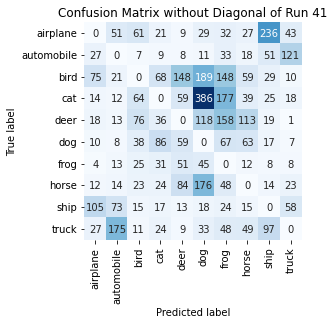

Summing down the rows, for Predictions of each Class that were wrong:  [ 292.  380.  320.  316.  440. 1005.  735.  395.  496.  289.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  148.0 times
Summing across the columns, for total number of that True Class misidentified:  [509. 285. 747. 794. 552. 355. 197. 418. 338. 473.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

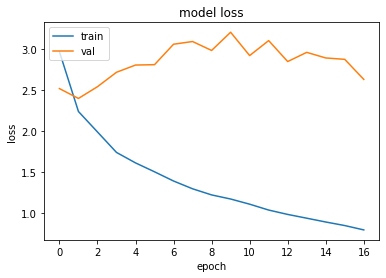

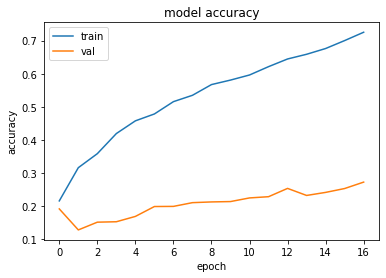

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  2.3976736068725586 , and Val Acc happened to be 0.12770000100135803
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.27219998836517334 and Val Loss happened to be  2.6287574768066406
TestLoss:  2.3954086303710938  TestAcc: 0.12680000066757202
cat 0.904
airplane 0.136
dog 0.117
truck 0.048
deer 0.041
ship 0.019
bird 0.002
frog 0.001
automobile 0.0
horse 0.0


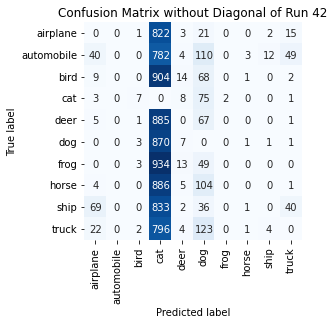

Summing down the rows, for Predictions of each Class that were wrong:  [1.520e+02 0.000e+00 1.700e+01 7.712e+03 6.000e+01 6.530e+02 2.000e+00
 7.000e+00 1.900e+01 1.100e+02]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  14.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 864. 1000.  998.   96.  959.  883.  999. 1000.  981.  952.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  885.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:   

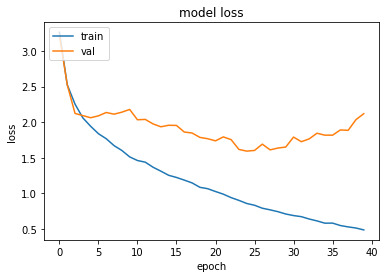

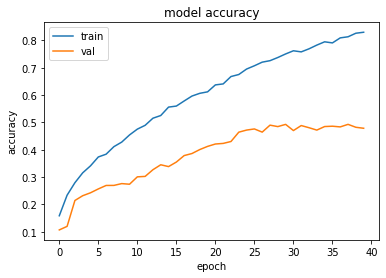

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5932649374008179 , and Val Acc happened to be 0.47200000286102295
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.492900013923645 and Val Loss happened to be  1.885536551475525
TestLoss:  1.583695411682129  TestAcc: 0.47679999470710754
ship 0.697
deer 0.619
dog 0.547
frog 0.521
automobile 0.515
horse 0.477
airplane 0.442
truck 0.424
bird 0.313
cat 0.213


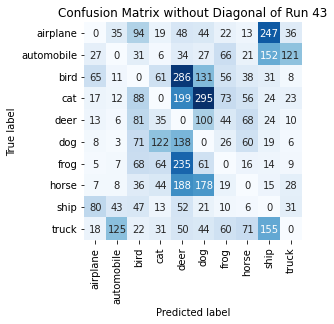

Summing down the rows, for Predictions of each Class that were wrong:  [ 240.  250.  538.  395. 1230.  901.  376.  349.  681.  272.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  286.0 times
Summing across the columns, for total number of that True Class misidentified:  [558. 485. 687. 787. 381. 453. 479. 523. 303. 576.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  100.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0

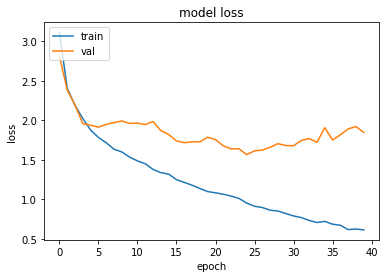

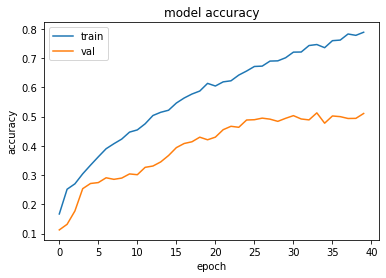

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.566758155822754 , and Val Acc happened to be 0.48820000886917114
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5126000046730042 and Val Loss happened to be  1.7213937044143677
TestLoss:  1.5494884252548218  TestAcc: 0.48980000615119934
frog 0.683
horse 0.64
ship 0.6
deer 0.586
automobile 0.55
truck 0.499
airplane 0.493
dog 0.39
cat 0.263
bird 0.194


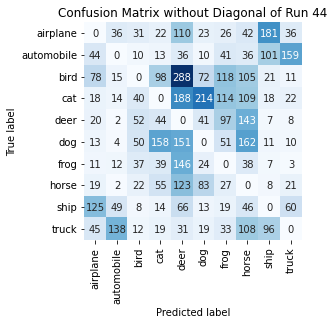

Summing down the rows, for Predictions of each Class that were wrong:  [ 373.  272.  262.  462. 1139.  499.  526.  789.  450.  330.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  288.0 times
Summing across the columns, for total number of that True Class misidentified:  [507. 450. 806. 737. 414. 610. 317. 360. 400. 501.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  143.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16

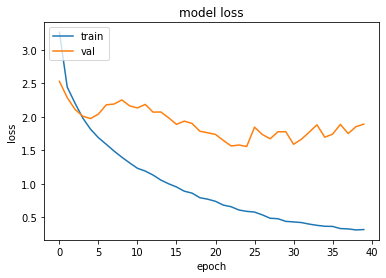

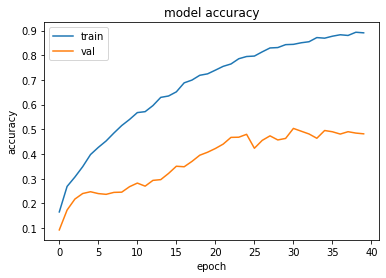

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5561195611953735 , and Val Acc happened to be 0.4799000024795532
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5037999749183655 and Val Loss happened to be  1.588774561882019
TestLoss:  1.5334514379501343  TestAcc: 0.4812000095844269
frog 0.758
truck 0.662
ship 0.645
automobile 0.505
deer 0.465
cat 0.424
horse 0.41
dog 0.368
airplane 0.303
bird 0.272


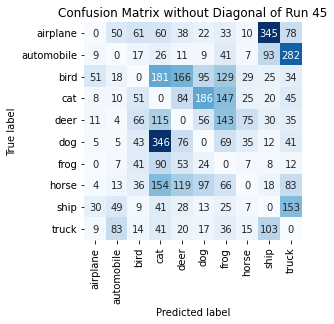

Summing down the rows, for Predictions of each Class that were wrong:  [ 127.  239.  338. 1054.  595.  519.  689.  210.  654.  763.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  166.0 times
Summing across the columns, for total number of that True Class misidentified:  [697. 495. 728. 576. 535. 632. 242. 590. 355. 338.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  143.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

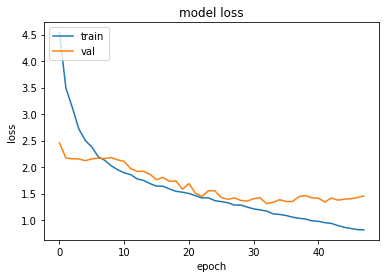

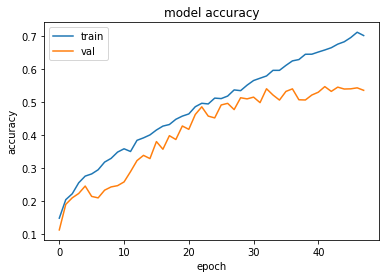

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3091734647750854 , and Val Acc happened to be 0.5394999980926514
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5460000038146973 and Val Loss happened to be  1.3408395051956177
TestLoss:  1.3012887239456177  TestAcc: 0.5322999954223633
automobile 0.769
frog 0.674
ship 0.608
horse 0.574
dog 0.563
airplane 0.535
truck 0.524
bird 0.418
deer 0.394
cat 0.264


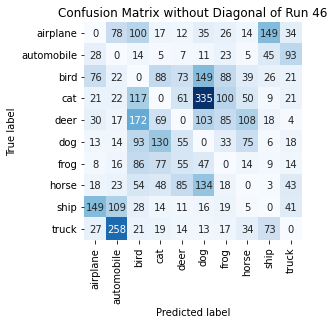

Summing down the rows, for Predictions of each Class that were wrong:  [370. 559. 685. 467. 373. 843. 409. 344. 338. 289.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  85.0 times
Summing across the columns, for total number of that True Class misidentified:  [465. 231. 582. 736. 606. 437. 326. 426. 392. 476.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  172.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0

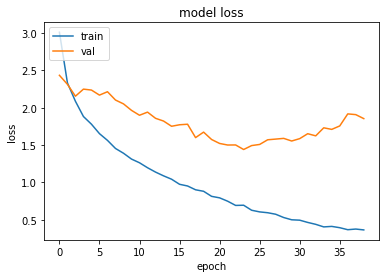

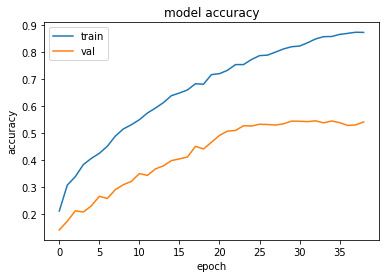

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.439997911453247 , and Val Acc happened to be 0.526199996471405
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5443999767303467 and Val Loss happened to be  1.622692584991455
TestLoss:  1.4133720397949219  TestAcc: 0.5383999943733215
ship 0.753
frog 0.642
automobile 0.627
dog 0.577
horse 0.565
airplane 0.527
deer 0.515
truck 0.475
bird 0.432
cat 0.271


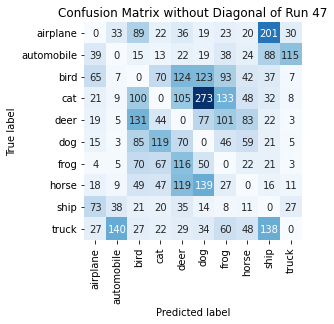

Summing down the rows, for Predictions of each Class that were wrong:  [281. 249. 587. 424. 656. 748. 529. 357. 576. 209.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  124.0 times
Summing across the columns, for total number of that True Class misidentified:  [473. 373. 568. 729. 485. 423. 358. 435. 247. 525.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  131.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


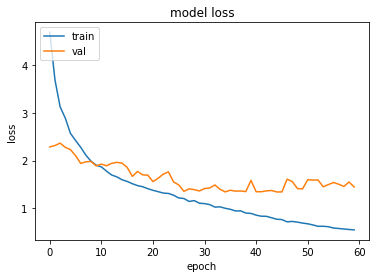

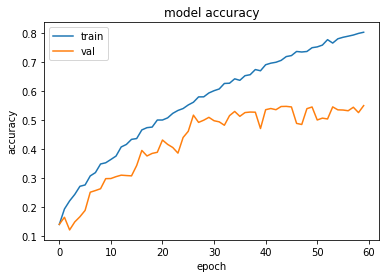

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  44 when  Val Loss was:  1.34299898147583 , and Val Acc happened to be 0.5472999811172485
Additionally, the best val acc epoch happened to be  59 when val acc was:  0.5498999953269958 and Val Loss happened to be  1.4477120637893677
TestLoss:  1.3197957277297974  TestAcc: 0.5471000075340271
frog 0.768
automobile 0.733
airplane 0.597
dog 0.586
horse 0.564
truck 0.546
ship 0.544
bird 0.406
deer 0.381
cat 0.346


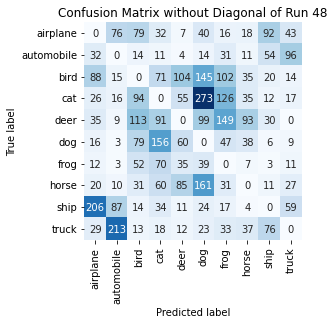

Summing down the rows, for Predictions of each Class that were wrong:  [464. 432. 489. 543. 373. 818. 552. 278. 304. 276.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [403. 267. 594. 654. 619. 414. 232. 436. 456. 454.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  149.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

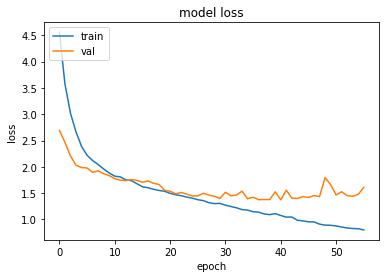

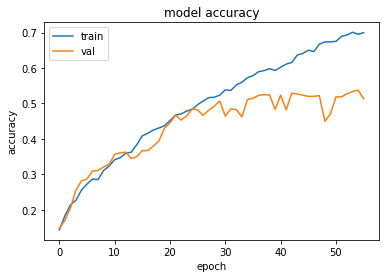

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3730169534683228 , and Val Acc happened to be 0.5234000086784363
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.5375999808311462 and Val Loss happened to be  1.477602481842041
TestLoss:  1.3543692827224731  TestAcc: 0.5170999765396118
frog 0.806
automobile 0.64
ship 0.615
airplane 0.585
truck 0.577
dog 0.543
horse 0.476
deer 0.408
cat 0.266
bird 0.255


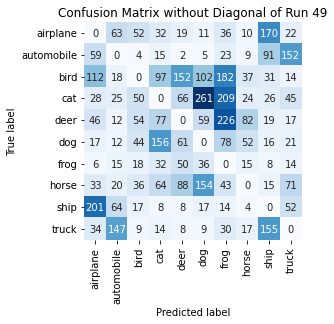

Summing down the rows, for Predictions of each Class that were wrong:  [536. 376. 284. 495. 454. 654. 841. 250. 531. 408.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  152.0 times
Summing across the columns, for total number of that True Class misidentified:  [415. 360. 745. 734. 592. 457. 194. 524. 385. 423.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  226.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

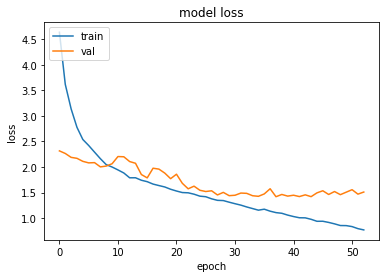

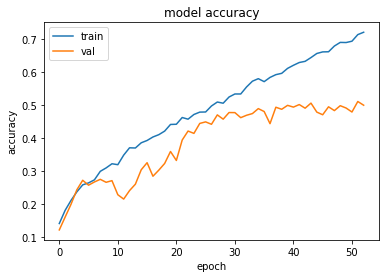

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.418036937713623 , and Val Acc happened to be 0.49459999799728394
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5120000243186951 and Val Loss happened to be  1.4682209491729736
TestLoss:  1.3999285697937012  TestAcc: 0.49810001254081726
dog 0.62
ship 0.589
truck 0.585
frog 0.583
automobile 0.561
horse 0.55
deer 0.521
airplane 0.491
cat 0.266
bird 0.215


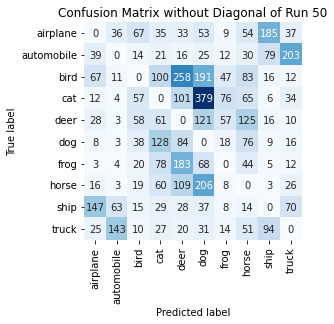

Summing down the rows, for Predictions of each Class that were wrong:  [ 345.  270.  298.  539.  832. 1111.  249.  542.  413.  420.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  258.0 times
Summing across the columns, for total number of that True Class misidentified:  [509. 439. 785. 734. 479. 380. 417. 450. 411. 415.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  125.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 11 November 2021 23:58:26  (subtract ~5-hours for local Hour), and file is called  runs_GroupG_final.pkl


In [ ]:
#@title Group G: 51 Run Results
run_through_runs(ds=make_unbatched(train_G),    ds_noalb=train_G_noalb, dstitle="G" , showpictures= False)

filename will be:  runs_GroupH .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


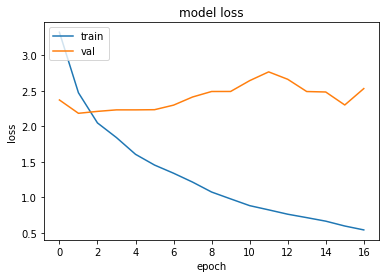

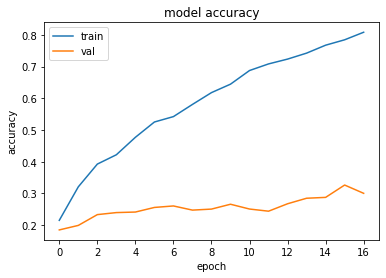

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  2.1823770999908447 , and Val Acc happened to be 0.19939999282360077
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.32659998536109924 and Val Loss happened to be  2.2992630004882812
TestLoss:  2.1780922412872314  TestAcc: 0.19830000400543213
airplane 0.833
cat 0.438
dog 0.252
horse 0.125
bird 0.094
ship 0.075
truck 0.062
frog 0.059
deer 0.043
automobile 0.002


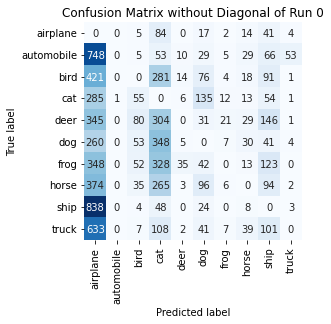

Summing down the rows, for Predictions of each Class that were wrong:  [4.252e+03 1.000e+00 2.960e+02 1.819e+03 7.500e+01 4.910e+02 6.400e+01
 1.930e+02 7.570e+02 6.900e+01]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  35.0 times
Summing across the columns, for total number of that True Class misidentified:  [167. 998. 906. 562. 957. 748. 941. 875. 925. 938.]
For example, the model misclassified true 4's (deer) as label   0 airplane  a total of  345.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0

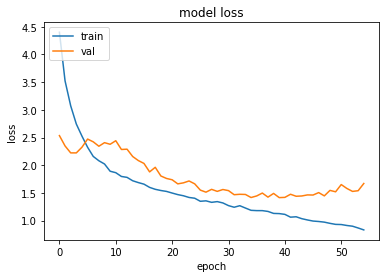

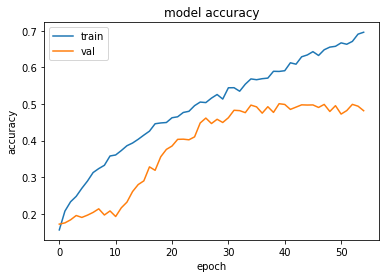

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.414109706878662 , and Val Acc happened to be 0.5006999969482422
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5006999969482422 and Val Loss happened to be  1.414109706878662
TestLoss:  1.3851639032363892  TestAcc: 0.5076000094413757
frog 0.743
ship 0.612
truck 0.602
airplane 0.556
horse 0.551
automobile 0.539
dog 0.491
deer 0.393
bird 0.364
cat 0.225


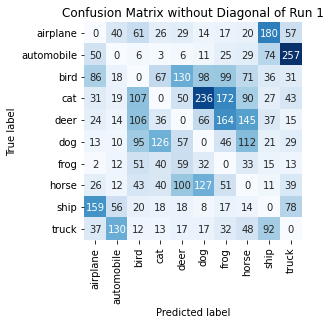

Summing down the rows, for Predictions of each Class that were wrong:  [428. 311. 501. 369. 466. 609. 623. 562. 493. 562.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  130.0 times
Summing across the columns, for total number of that True Class misidentified:  [444. 461. 636. 775. 607. 509. 257. 449. 388. 398.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  164.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0

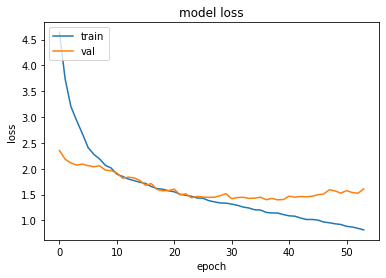

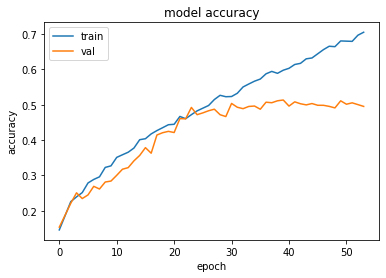

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3983275890350342 , and Val Acc happened to be 0.5113000273704529
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5134999752044678 and Val Loss happened to be  1.4050620794296265
TestLoss:  1.357496738433838  TestAcc: 0.5199999809265137
frog 0.757
ship 0.712
truck 0.655
automobile 0.537
airplane 0.516
horse 0.512
dog 0.474
deer 0.439
bird 0.376
cat 0.222


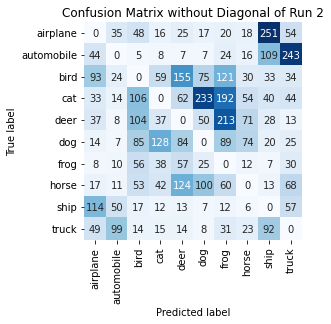

Summing down the rows, for Predictions of each Class that were wrong:  [409. 258. 488. 355. 541. 522. 762. 304. 593. 568.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [484. 463. 624. 778. 561. 526. 243. 488. 288. 345.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  213.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brigh

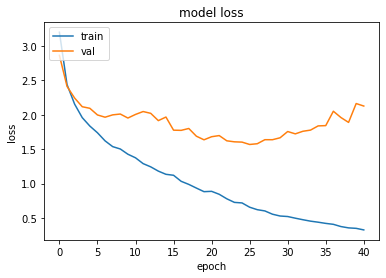

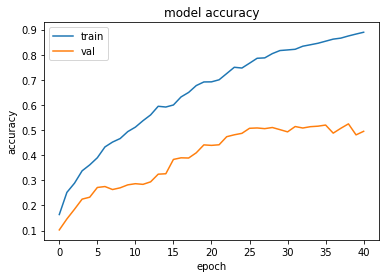

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5689148902893066 , and Val Acc happened to be 0.5072000026702881
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5248000025749207 and Val Loss happened to be  1.8900305032730103
TestLoss:  1.5220948457717896  TestAcc: 0.5127000212669373
frog 0.714
ship 0.688
truck 0.618
automobile 0.573
deer 0.525
dog 0.498
horse 0.473
airplane 0.385
cat 0.33
bird 0.323


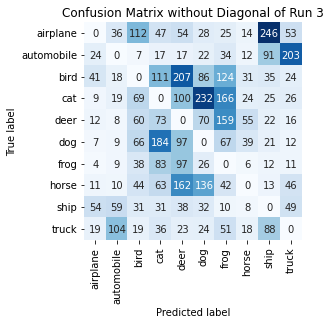

Summing down the rows, for Predictions of each Class that were wrong:  [181. 272. 446. 645. 795. 656. 678. 207. 553. 440.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  207.0 times
Summing across the columns, for total number of that True Class misidentified:  [615. 427. 677. 670. 475. 502. 286. 527. 312. 382.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1

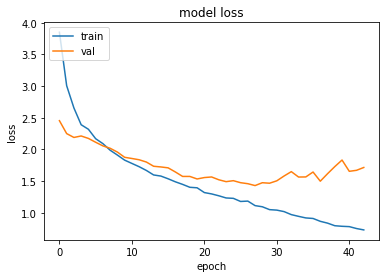

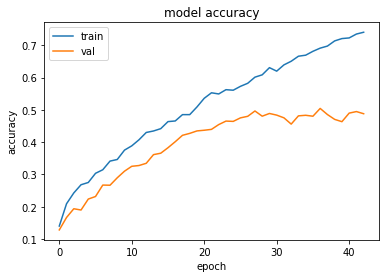

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.4281455278396606 , and Val Acc happened to be 0.4964999854564667
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5044000148773193 and Val Loss happened to be  1.4975014925003052
TestLoss:  1.4103658199310303  TestAcc: 0.5015000104904175
ship 0.729
frog 0.685
automobile 0.609
truck 0.53
dog 0.507
deer 0.505
horse 0.475
airplane 0.416
bird 0.34
cat 0.219


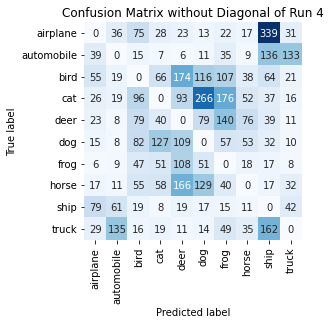

Summing down the rows, for Predictions of each Class that were wrong:  [289. 306. 484. 404. 709. 696. 641. 309. 843. 304.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  174.0 times
Summing across the columns, for total number of that True Class misidentified:  [584. 391. 660. 781. 495. 493. 315. 525. 271. 470.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  140.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

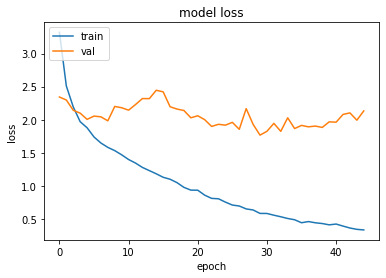

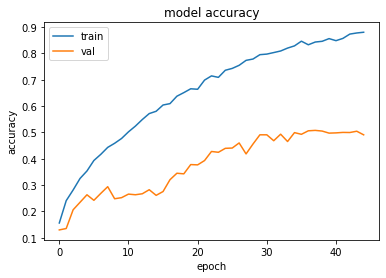

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.76851487159729 , and Val Acc happened to be 0.4909999966621399
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5077999830245972 and Val Loss happened to be  1.905038833618164
TestLoss:  1.7423266172409058  TestAcc: 0.49399998784065247
frog 0.845
ship 0.685
automobile 0.56
truck 0.514
airplane 0.495
deer 0.459
horse 0.424
cat 0.353
dog 0.332
bird 0.273


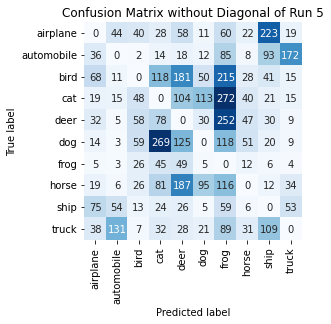

Summing down the rows, for Predictions of each Class that were wrong:  [ 306.  272.  279.  689.  776.  342. 1266.  245.  555.  330.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  187.0 times
Summing across the columns, for total number of that True Class misidentified:  [505. 440. 727. 647. 541. 668. 155. 576. 315. 486.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  252.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0

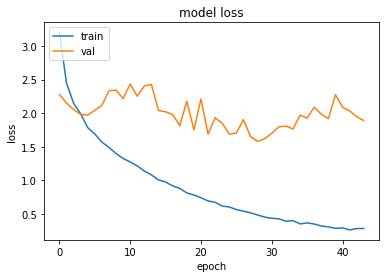

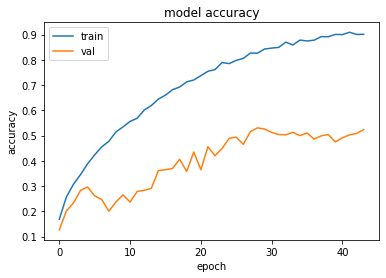

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.5797650814056396 , and Val Acc happened to be 0.5304999947547913
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5304999947547913 and Val Loss happened to be  1.5797650814056396
TestLoss:  1.5600336790084839  TestAcc: 0.5246000289916992
automobile 0.765
frog 0.733
ship 0.659
horse 0.6
truck 0.56
dog 0.54
deer 0.412
airplane 0.382
cat 0.34
bird 0.255


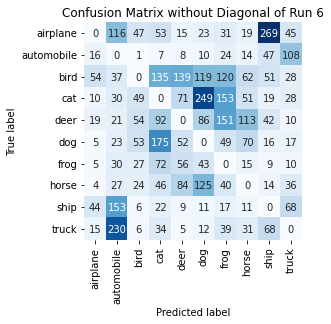

Summing down the rows, for Predictions of each Class that were wrong:  [172. 667. 267. 636. 439. 678. 624. 386. 535. 350.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [618. 235. 745. 660. 588. 460. 267. 400. 341. 440.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  151.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Bri

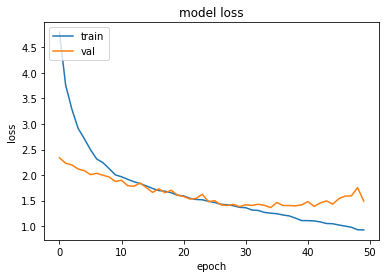

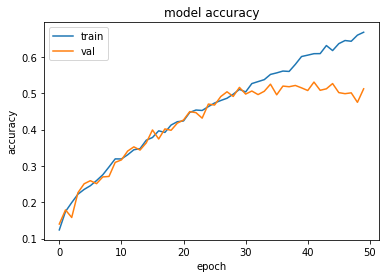

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.36293625831604 , and Val Acc happened to be 0.5246999859809875
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5304999947547913 and Val Loss happened to be  1.387306571006775
TestLoss:  1.341417670249939  TestAcc: 0.5218999981880188
frog 0.692
automobile 0.636
truck 0.63
ship 0.624
dog 0.603
horse 0.562
airplane 0.524
bird 0.367
deer 0.301
cat 0.28


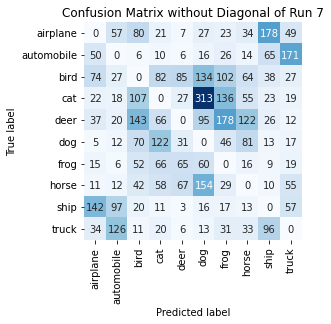

Summing down the rows, for Predictions of each Class that were wrong:  [390. 375. 531. 456. 297. 828. 588. 432. 458. 426.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  85.0 times
Summing across the columns, for total number of that True Class misidentified:  [476. 364. 633. 720. 699. 397. 308. 438. 376. 370.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  178.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.

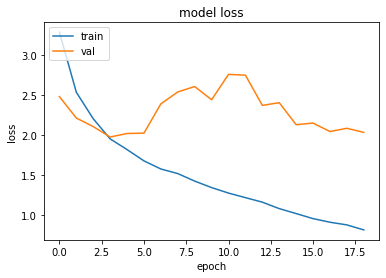

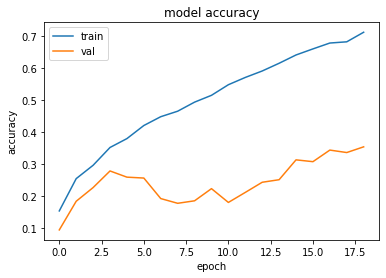

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.9803320169448853 , and Val Acc happened to be 0.2782000005245209
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.3537999987602234 and Val Loss happened to be  2.0382754802703857
TestLoss:  1.9621851444244385  TestAcc: 0.2838999927043915
frog 0.699
ship 0.652
dog 0.455
deer 0.341
cat 0.257
truck 0.218
airplane 0.163
bird 0.024
automobile 0.015
horse 0.015


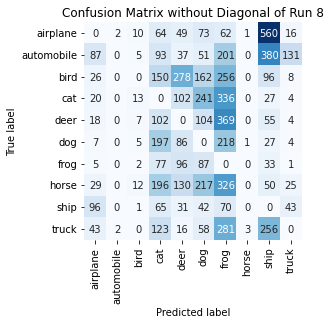

Summing down the rows, for Predictions of each Class that were wrong:  [ 331.    4.   55. 1067.  825. 1035. 2119.    5. 1484.  236.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  278.0 times
Summing across the columns, for total number of that True Class misidentified:  [837. 985. 976. 743. 659. 545. 301. 985. 348. 782.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  369.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

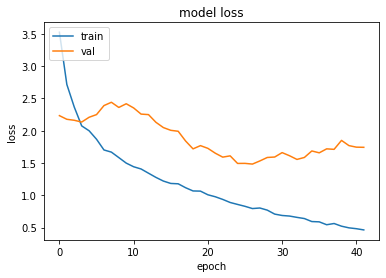

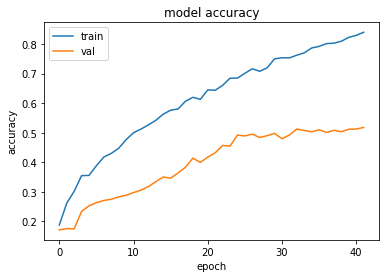

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.483415126800537 , and Val Acc happened to be 0.4952999949455261
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5180000066757202 and Val Loss happened to be  1.742950201034546
TestLoss:  1.4532911777496338  TestAcc: 0.5048999786376953
frog 0.738
ship 0.727
deer 0.572
truck 0.536
automobile 0.521
airplane 0.499
horse 0.444
cat 0.416
dog 0.371
bird 0.225


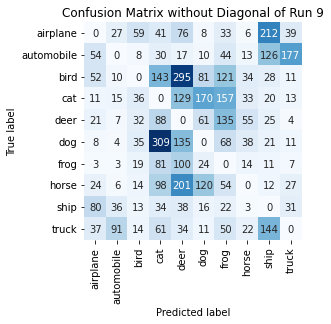

Summing down the rows, for Predictions of each Class that were wrong:  [ 290.  199.  230.  885. 1025.  501.  684.  218.  599.  320.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  295.0 times
Summing across the columns, for total number of that True Class misidentified:  [501. 479. 775. 584. 428. 629. 262. 556. 273. 464.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  135.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

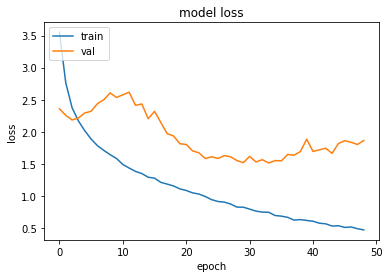

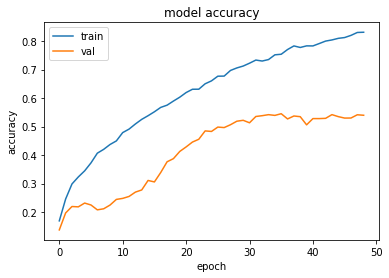

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.5138826370239258 , and Val Acc happened to be 0.5418999791145325
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.545199990272522 and Val Loss happened to be  1.5465799570083618
TestLoss:  1.5145083665847778  TestAcc: 0.5436000227928162
automobile 0.74
frog 0.714
ship 0.643
airplane 0.591
horse 0.544
truck 0.504
deer 0.5
dog 0.489
bird 0.376
cat 0.335


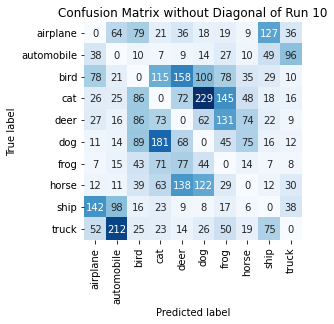

Summing down the rows, for Predictions of each Class that were wrong:  [393. 476. 473. 577. 581. 623. 541. 290. 355. 255.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  158.0 times
Summing across the columns, for total number of that True Class misidentified:  [409. 260. 624. 665. 500. 511. 286. 456. 357. 496.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  131.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

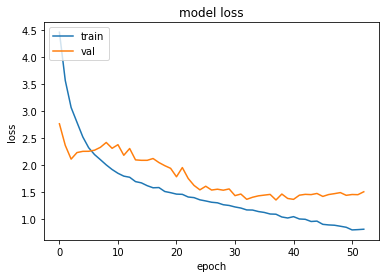

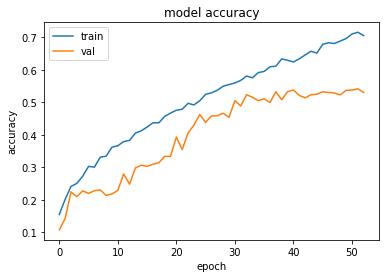

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3506574630737305 , and Val Acc happened to be 0.5322999954223633
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5414000153541565 and Val Loss happened to be  1.449346661567688
TestLoss:  1.3169715404510498  TestAcc: 0.5396000146865845
frog 0.754
automobile 0.74
ship 0.629
horse 0.621
dog 0.607
truck 0.587
airplane 0.51
deer 0.453
cat 0.255
bird 0.24


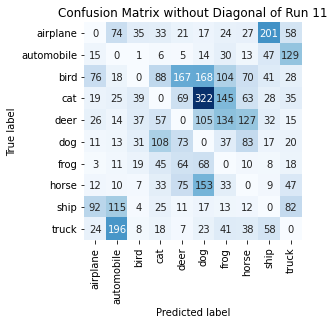

Summing down the rows, for Predictions of each Class that were wrong:  [278. 476. 181. 413. 492. 887. 561. 443. 441. 432.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  167.0 times
Summing across the columns, for total number of that True Class misidentified:  [490. 260. 760. 745. 547. 393. 246. 379. 371. 413.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  134.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16 

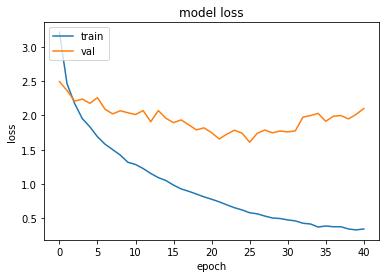

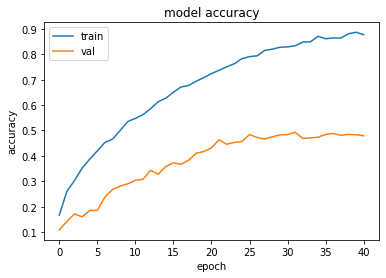

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6094425916671753 , and Val Acc happened to be 0.48410001397132874
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.4927000105381012 and Val Loss happened to be  1.7746309041976929
TestLoss:  1.5819636583328247  TestAcc: 0.48660001158714294
frog 0.697
ship 0.635
deer 0.632
truck 0.53
airplane 0.52
automobile 0.502
horse 0.486
dog 0.406
bird 0.248
cat 0.21


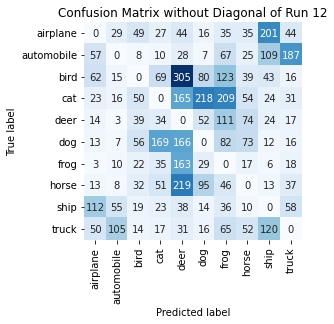

Summing down the rows, for Predictions of each Class that were wrong:  [ 347.  248.  289.  435. 1159.  527.  774.  379.  552.  424.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  305.0 times
Summing across the columns, for total number of that True Class misidentified:  [480. 498. 752. 790. 368. 594. 303. 514. 365. 470.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  111.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.

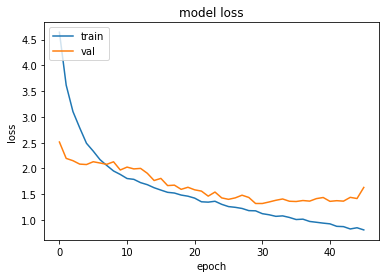

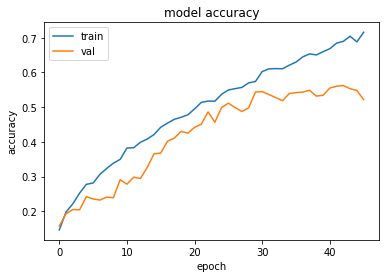

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.3211430311203003 , and Val Acc happened to be 0.5447999835014343
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5623000264167786 and Val Loss happened to be  1.366974115371704
TestLoss:  1.306544542312622  TestAcc: 0.5443000197410583
ship 0.757
frog 0.69
automobile 0.679
horse 0.652
truck 0.582
airplane 0.548
dog 0.53
deer 0.436
cat 0.287
bird 0.282


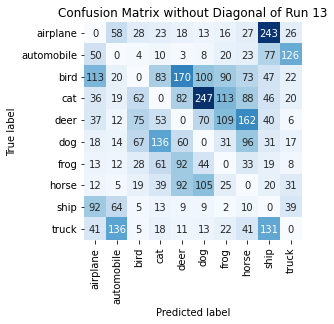

Summing down the rows, for Predictions of each Class that were wrong:  [412. 340. 293. 436. 537. 609. 428. 553. 654. 295.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [452. 321. 718. 713. 564. 470. 310. 348. 243. 418.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  162.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0

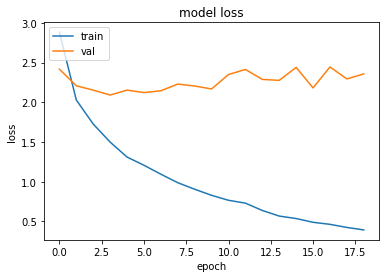

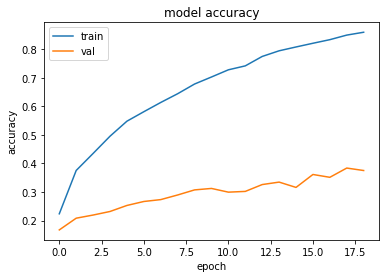

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.09118390083313 , and Val Acc happened to be 0.23170000314712524
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.3837999999523163 and Val Loss happened to be  2.2935068607330322
TestLoss:  2.0865490436553955  TestAcc: 0.23190000653266907
ship 0.932
deer 0.551
cat 0.3
airplane 0.157
bird 0.156
dog 0.1
frog 0.066
horse 0.047
truck 0.008
automobile 0.002


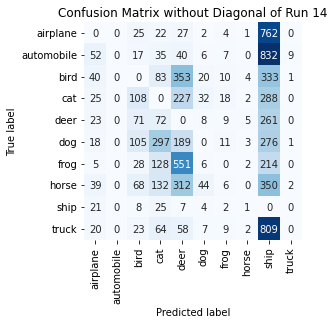

Summing down the rows, for Predictions of each Class that were wrong:  [ 243.    0.  453.  858. 1764.  129.   76.   20. 4125.   13.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  551.0 times
Summing across the columns, for total number of that True Class misidentified:  [843. 998. 844. 700. 449. 900. 934. 953.  68. 992.]
For example, the model misclassified true 4's (deer) as label   8 ship  a total of  261.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

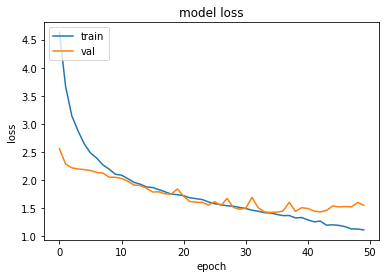

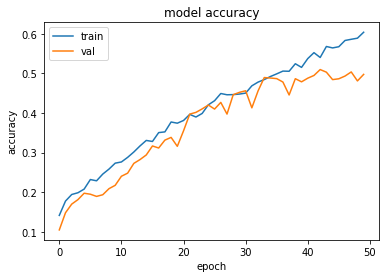

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4234604835510254 , and Val Acc happened to be 0.48829999566078186
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5097000002861023 and Val Loss happened to be  1.4317127466201782
TestLoss:  1.4044195413589478  TestAcc: 0.49549999833106995
truck 0.733
frog 0.691
ship 0.643
horse 0.597
automobile 0.539
dog 0.539
deer 0.423
airplane 0.349
cat 0.231
bird 0.21


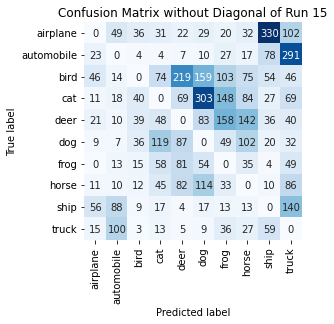

Summing down the rows, for Predictions of each Class that were wrong:  [192. 309. 194. 409. 576. 778. 587. 527. 618. 855.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  219.0 times
Summing across the columns, for total number of that True Class misidentified:  [651. 461. 790. 769. 577. 461. 309. 403. 357. 267.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


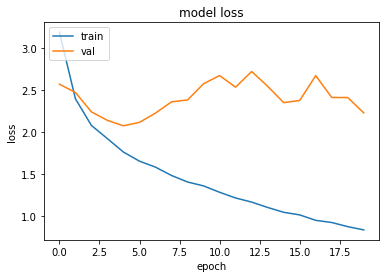

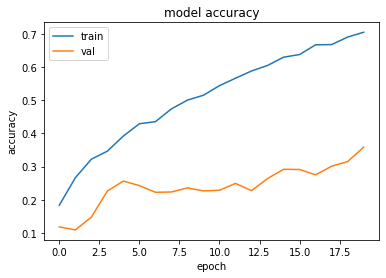

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  2.0734288692474365 , and Val Acc happened to be 0.2565000057220459
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.35850000381469727 and Val Loss happened to be  2.2266550064086914
TestLoss:  2.0626492500305176  TestAcc: 0.25130000710487366
cat 0.571
ship 0.565
airplane 0.401
dog 0.348
frog 0.329
deer 0.215
bird 0.035
automobile 0.017
horse 0.016
truck 0.016


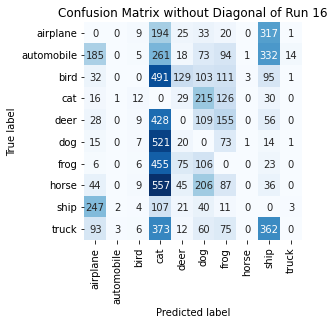

Summing down the rows, for Predictions of each Class that were wrong:  [ 666.    6.   67. 3387.  374.  945.  752.    5. 1265.   20.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  129.0 times
Summing across the columns, for total number of that True Class misidentified:  [599. 983. 965. 429. 785. 652. 671. 984. 435. 984.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  428.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

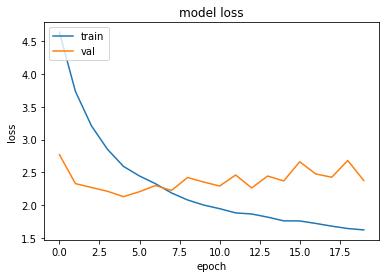

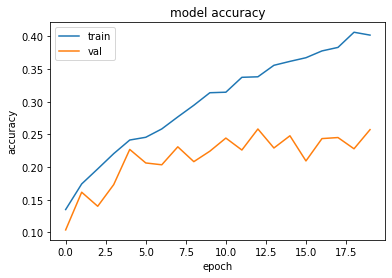

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  2.1288902759552 , and Val Acc happened to be 0.22699999809265137
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.2583000063896179 and Val Loss happened to be  2.2614450454711914
TestLoss:  2.118509292602539  TestAcc: 0.22660000622272491
dog 0.627
ship 0.442
frog 0.441
deer 0.268
cat 0.214
airplane 0.11
bird 0.106
horse 0.049
truck 0.007
automobile 0.002


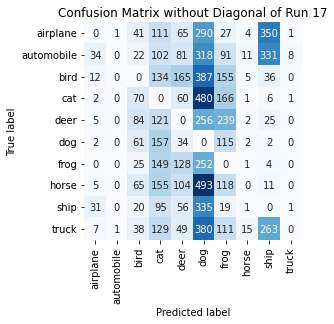

Summing down the rows, for Predictions of each Class that were wrong:  [9.800e+01 2.000e+00 4.260e+02 1.153e+03 7.420e+02 3.191e+03 1.041e+03
 4.200e+01 1.028e+03 1.100e+01]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  165.0 times
Summing across the columns, for total number of that True Class misidentified:  [890. 998. 894. 786. 732. 373. 559. 951. 558. 993.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  256.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  

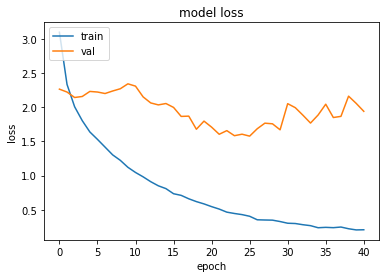

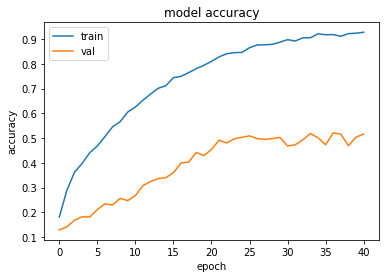

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.576661467552185 , and Val Acc happened to be 0.508899986743927
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5206999778747559 and Val Loss happened to be  1.8492710590362549
TestLoss:  1.5367684364318848  TestAcc: 0.5138000249862671
frog 0.761
ship 0.761
truck 0.528
dog 0.5
automobile 0.487
deer 0.477
horse 0.473
airplane 0.451
cat 0.375
bird 0.325


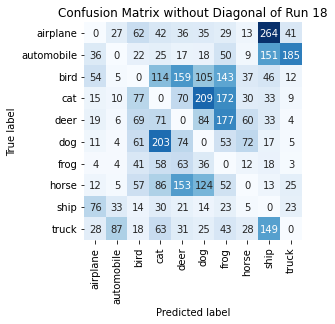

Summing down the rows, for Predictions of each Class that were wrong:  [255. 181. 421. 692. 624. 650. 742. 266. 724. 307.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  159.0 times
Summing across the columns, for total number of that True Class misidentified:  [549. 513. 675. 625. 523. 500. 239. 527. 239. 472.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  177.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

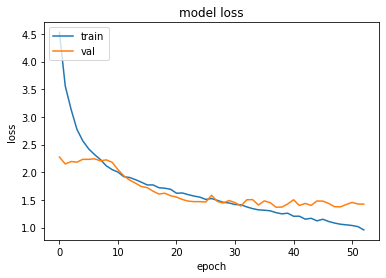

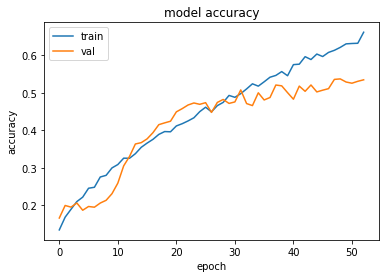

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3675302267074585 , and Val Acc happened to be 0.5206000208854675
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.536899983882904 and Val Loss happened to be  1.373628854751587
TestLoss:  1.3477303981781006  TestAcc: 0.529699981212616
automobile 0.752
frog 0.7
horse 0.662
ship 0.636
truck 0.633
airplane 0.495
deer 0.458
dog 0.387
bird 0.306
cat 0.268


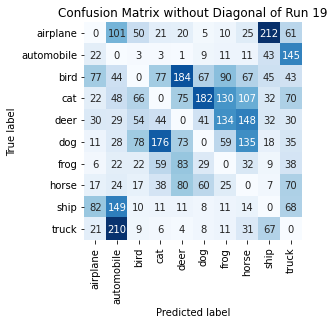

Summing down the rows, for Predictions of each Class that were wrong:  [288. 655. 309. 435. 531. 409. 481. 570. 465. 560.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [505. 248. 694. 732. 542. 613. 300. 338. 364. 367.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  148.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise

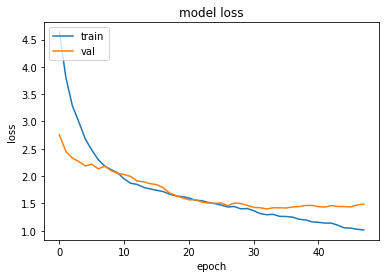

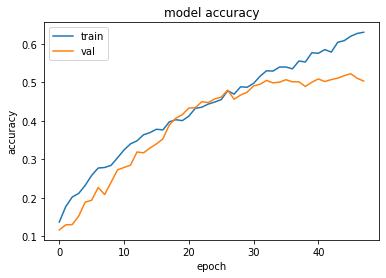

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3984801769256592 , and Val Acc happened to be 0.504800021648407
Additionally, the best val acc epoch happened to be  45 when val acc was:  0.5220999717712402 and Val Loss happened to be  1.4350581169128418
TestLoss:  1.387738823890686  TestAcc: 0.5059000253677368
ship 0.671
frog 0.642
truck 0.589
automobile 0.584
deer 0.53
horse 0.514
airplane 0.51
dog 0.451
bird 0.296
cat 0.272


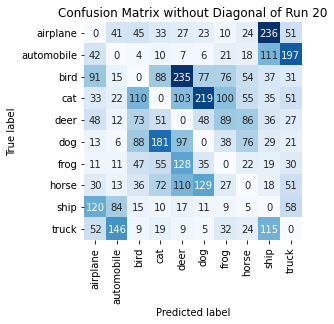

Summing down the rows, for Predictions of each Class that were wrong:  [440. 350. 427. 519. 733. 553. 402. 364. 636. 517.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  235.0 times
Summing across the columns, for total number of that True Class misidentified:  [490. 416. 704. 728. 470. 549. 358. 486. 329. 411.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  89.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 

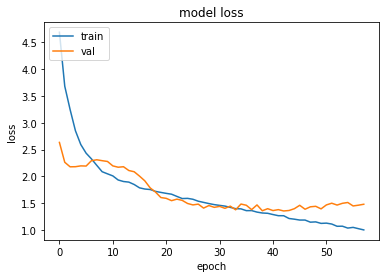

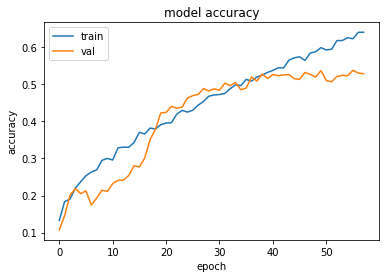

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  42 when  Val Loss was:  1.3523269891738892 , and Val Acc happened to be 0.5253000259399414
Additionally, the best val acc epoch happened to be  55 when val acc was:  0.5379999876022339 and Val Loss happened to be  1.4460532665252686
TestLoss:  1.3309998512268066  TestAcc: 0.5313000082969666
truck 0.711
frog 0.692
automobile 0.647
airplane 0.621
horse 0.606
dog 0.555
ship 0.516
bird 0.406
deer 0.362
cat 0.197


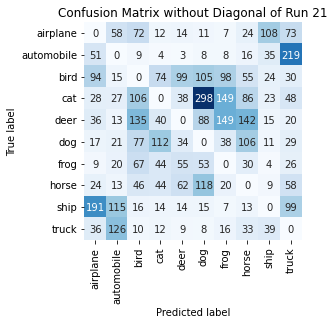

Summing down the rows, for Predictions of each Class that were wrong:  [486. 408. 538. 356. 328. 704. 492. 505. 268. 602.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [379. 353. 594. 803. 638. 445. 308. 394. 484. 289.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  149.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:   

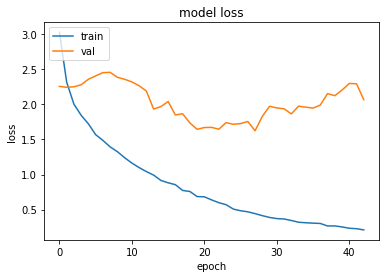

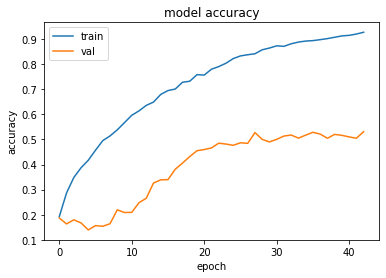

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.6239516735076904 , and Val Acc happened to be 0.5274999737739563
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5311999917030334 and Val Loss happened to be  2.0674750804901123
TestLoss:  1.5550509691238403  TestAcc: 0.5411999821662903
ship 0.716
frog 0.679
truck 0.654
dog 0.556
airplane 0.55
automobile 0.544
horse 0.54
deer 0.535
cat 0.34
bird 0.298


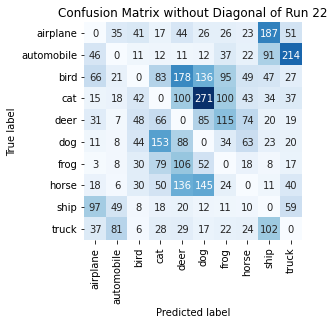

Summing down the rows, for Predictions of each Class that were wrong:  [324. 233. 260. 506. 712. 756. 464. 326. 523. 484.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  178.0 times
Summing across the columns, for total number of that True Class misidentified:  [450. 456. 702. 660. 465. 444. 321. 460. 284. 346.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  115.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 , 0.08 )


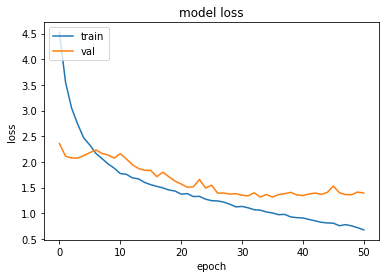

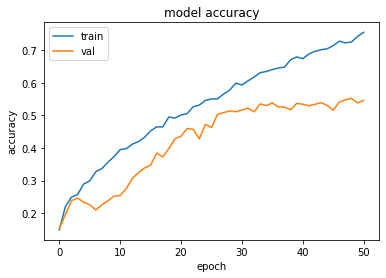

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3148139715194702 , and Val Acc happened to be 0.5378999710083008
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5519999861717224 and Val Loss happened to be  1.3610423803329468
TestLoss:  1.2833880186080933  TestAcc: 0.545199990272522
frog 0.758
automobile 0.718
ship 0.693
dog 0.642
truck 0.598
deer 0.546
horse 0.521
airplane 0.495
bird 0.255
cat 0.226


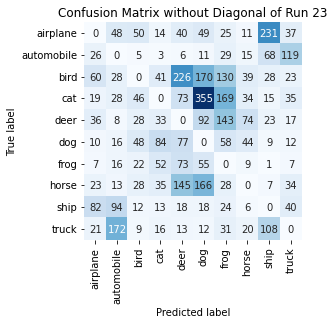

Summing down the rows, for Predictions of each Class that were wrong:  [284. 423. 248. 291. 671. 928. 637. 252. 490. 324.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  226.0 times
Summing across the columns, for total number of that True Class misidentified:  [505. 282. 745. 774. 454. 358. 242. 479. 307. 402.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  143.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

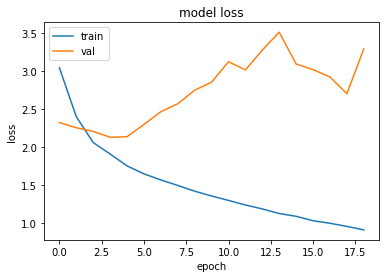

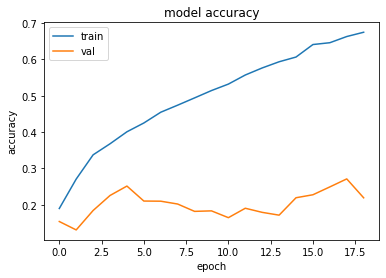

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.1318397521972656 , and Val Acc happened to be 0.225600004196167
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.2712000012397766 and Val Loss happened to be  2.7042112350463867
TestLoss:  2.1243581771850586  TestAcc: 0.22779999673366547
ship 0.863
frog 0.412
deer 0.352
cat 0.216
airplane 0.182
bird 0.148
dog 0.077
horse 0.024
automobile 0.004
truck 0.0


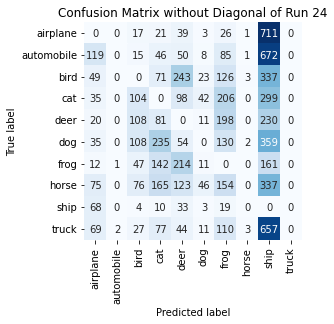

Summing down the rows, for Predictions of each Class that were wrong:  [4.820e+02 3.000e+00 5.060e+02 8.480e+02 8.980e+02 1.580e+02 1.054e+03
 1.000e+01 3.763e+03 0.000e+00]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  243.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 818.  996.  852.  784.  648.  923.  588.  976.  137. 1000.]
For example, the model misclassified true 4's (deer) as label   8 ship  a total of  230.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma: 

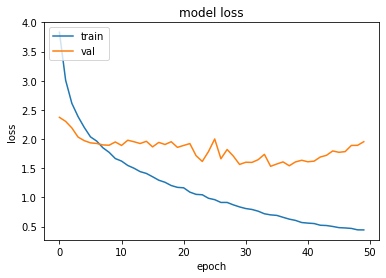

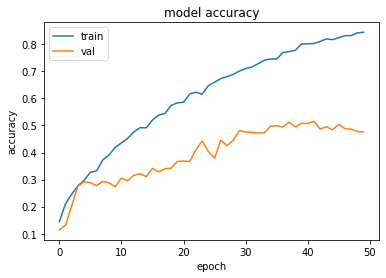

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.532971739768982 , and Val Acc happened to be 0.49720001220703125
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5153999924659729 and Val Loss happened to be  1.6215171813964844
TestLoss:  1.5063451528549194  TestAcc: 0.5040000081062317
frog 0.797
ship 0.698
truck 0.691
automobile 0.589
horse 0.547
dog 0.409
airplane 0.392
cat 0.37
deer 0.278
bird 0.269


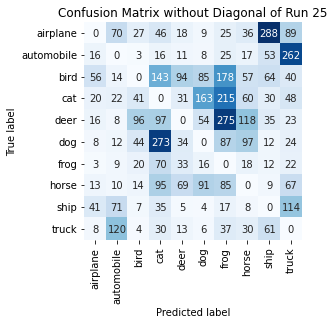

Summing down the rows, for Predictions of each Class that were wrong:  [181. 336. 256. 805. 308. 436. 944. 441. 564. 689.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  94.0 times
Summing across the columns, for total number of that True Class misidentified:  [608. 411. 731. 630. 722. 591. 203. 453. 302. 309.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  275.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 

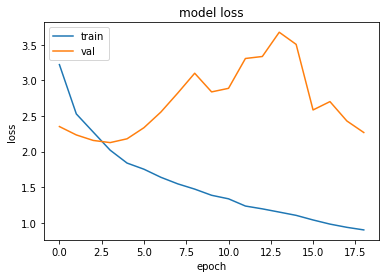

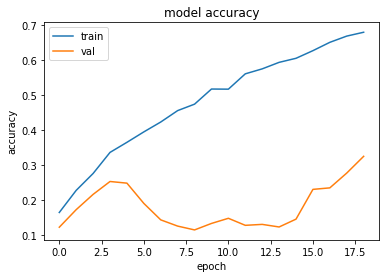

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.1260762214660645 , and Val Acc happened to be 0.2538999915122986
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.32580000162124634 and Val Loss happened to be  2.267965316772461
TestLoss:  2.116427183151245  TestAcc: 0.24889999628067017
frog 0.645
ship 0.519
dog 0.472
airplane 0.269
cat 0.244
bird 0.216
deer 0.107
horse 0.017
automobile 0.0
truck 0.0


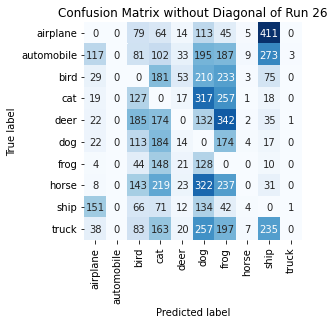

Summing down the rows, for Predictions of each Class that were wrong:  [ 410.    0.  921. 1306.  207. 1808. 1714.   35. 1105.    5.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  53.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 731. 1000.  784.  756.  893.  528.  355.  983.  481. 1000.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  342.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomI

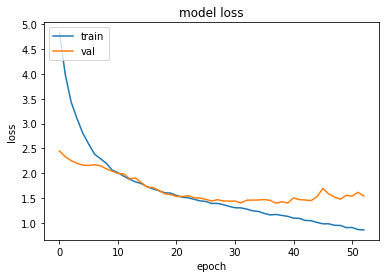

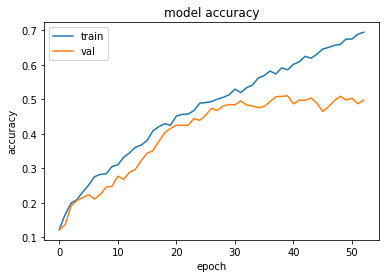

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3973650932312012 , and Val Acc happened to be 0.5073000192642212
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5099999904632568 and Val Loss happened to be  1.4024293422698975
TestLoss:  1.3853541612625122  TestAcc: 0.5073999762535095
frog 0.739
automobile 0.609
ship 0.592
airplane 0.557
truck 0.547
dog 0.531
horse 0.525
deer 0.459
bird 0.337
cat 0.178


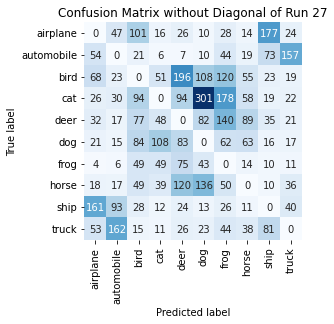

Summing down the rows, for Predictions of each Class that were wrong:  [437. 410. 518. 340. 651. 726. 692. 361. 444. 347.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  196.0 times
Summing across the columns, for total number of that True Class misidentified:  [443. 391. 663. 822. 541. 469. 261. 475. 408. 453.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  140.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

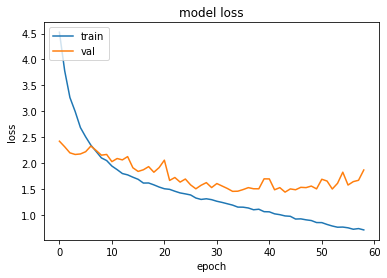

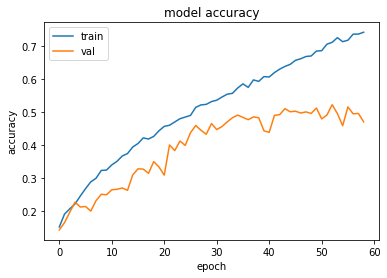

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.442456603050232 , and Val Acc happened to be 0.5097000002861023
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5217000246047974 and Val Loss happened to be  1.5025827884674072
TestLoss:  1.421272873878479  TestAcc: 0.5123999714851379
frog 0.767
truck 0.588
automobile 0.575
dog 0.573
horse 0.563
ship 0.561
airplane 0.492
bird 0.44
deer 0.366
cat 0.199


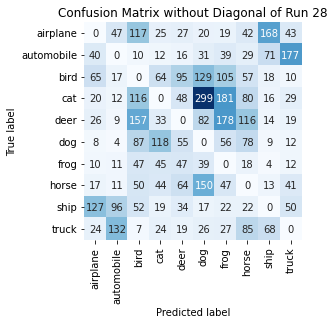

Summing down the rows, for Predictions of each Class that were wrong:  [337. 339. 643. 384. 405. 793. 674. 527. 381. 393.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [508. 425. 560. 801. 634. 427. 233. 437. 439. 412.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  178.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
N

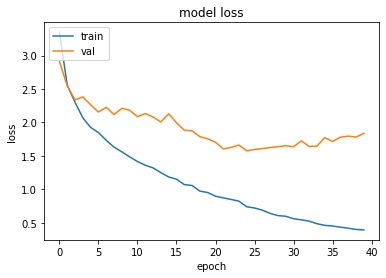

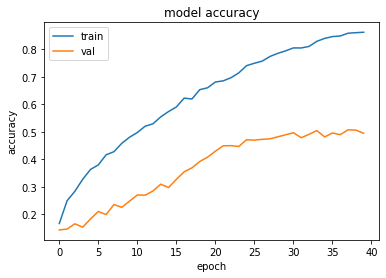

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5759596824645996 , and Val Acc happened to be 0.4708999991416931
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5069000124931335 and Val Loss happened to be  1.7959883213043213
TestLoss:  1.5783036947250366  TestAcc: 0.4715999960899353
ship 0.765
frog 0.709
truck 0.529
deer 0.47
dog 0.437
automobile 0.418
cat 0.377
airplane 0.347
horse 0.347
bird 0.317


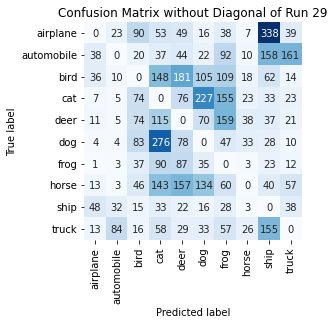

Summing down the rows, for Predictions of each Class that were wrong:  [171. 169. 455. 953. 723. 658. 745. 161. 874. 375.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  181.0 times
Summing across the columns, for total number of that True Class misidentified:  [653. 582. 683. 623. 530. 563. 291. 653. 235. 471.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

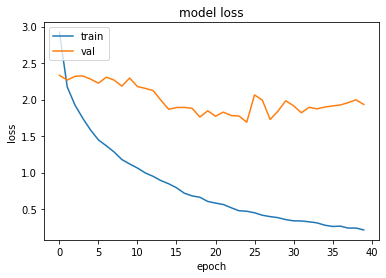

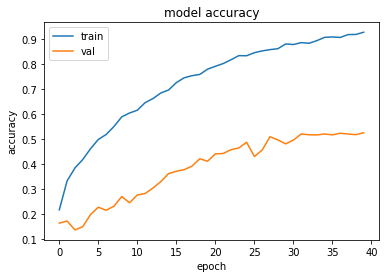

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.689895749092102 , and Val Acc happened to be 0.4867999851703644
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5245000123977661 and Val Loss happened to be  1.9329357147216797
TestLoss:  1.6778216361999512  TestAcc: 0.4934999942779541
frog 0.733
ship 0.726
dog 0.629
truck 0.56
airplane 0.437
horse 0.431
deer 0.411
automobile 0.37
cat 0.35
bird 0.288


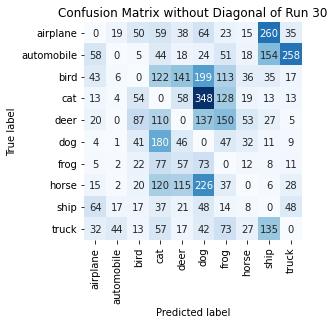

Summing down the rows, for Predictions of each Class that were wrong:  [ 254.   95.  309.  806.  511. 1161.  636.  220.  649.  424.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 630. 712. 650. 589. 371. 267. 569. 274. 440.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  150.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

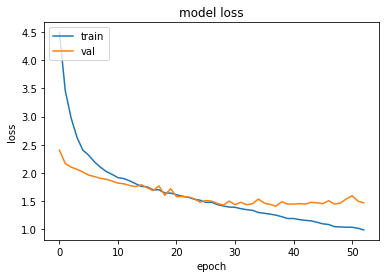

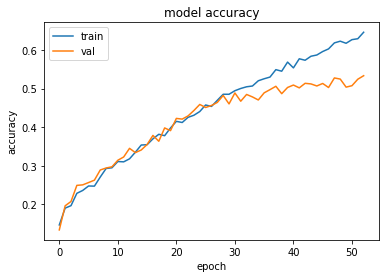

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.4078912734985352 , and Val Acc happened to be 0.5059000253677368
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.53329998254776 and Val Loss happened to be  1.4645768404006958
TestLoss:  1.38218092918396  TestAcc: 0.5059000253677368
frog 0.742
automobile 0.665
horse 0.647
ship 0.644
truck 0.561
dog 0.547
deer 0.431
airplane 0.384
bird 0.247
cat 0.191


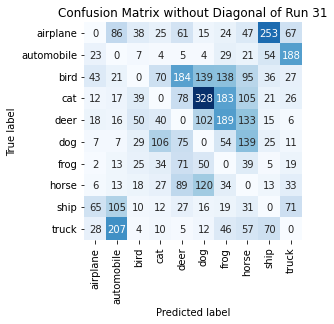

Summing down the rows, for Predictions of each Class that were wrong:  [204. 485. 220. 328. 595. 786. 716. 667. 492. 448.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [616. 335. 753. 809. 569. 453. 258. 353. 356. 439.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  189.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

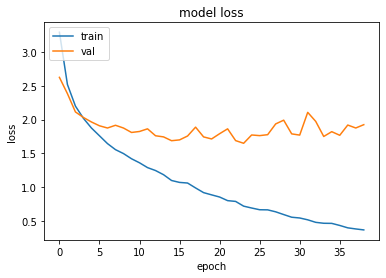

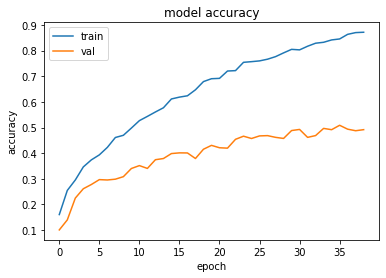

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.64909029006958 , and Val Acc happened to be 0.4661000072956085
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5087000131607056 and Val Loss happened to be  1.767216444015503
TestLoss:  1.6155140399932861  TestAcc: 0.47209998965263367
frog 0.762
ship 0.745
truck 0.683
deer 0.593
automobile 0.491
airplane 0.354
horse 0.327
cat 0.311
bird 0.231
dog 0.224


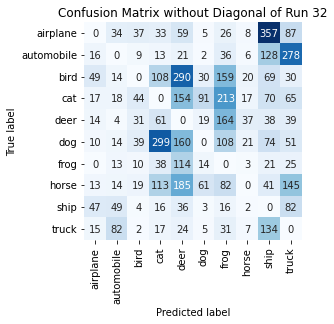

Summing down the rows, for Predictions of each Class that were wrong:  [ 181.  242.  195.  698. 1043.  230.  835.  121.  932.  802.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  290.0 times
Summing across the columns, for total number of that True Class misidentified:  [646. 509. 769. 689. 407. 776. 238. 673. 255. 317.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  164.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )


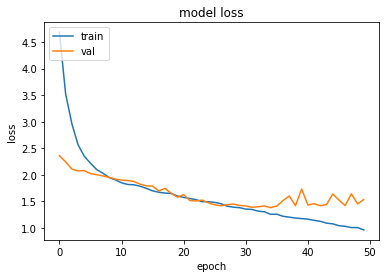

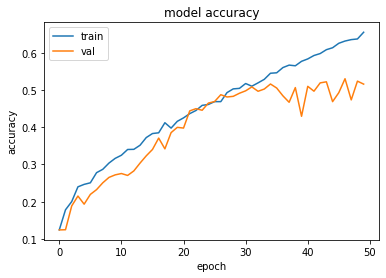

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3828541040420532 , and Val Acc happened to be 0.5159000158309937
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5300999879837036 and Val Loss happened to be  1.4218701124191284
TestLoss:  1.3633145093917847  TestAcc: 0.5196999907493591
ship 0.726
frog 0.68
truck 0.674
dog 0.637
automobile 0.51
horse 0.485
airplane 0.469
deer 0.397
cat 0.346
bird 0.273


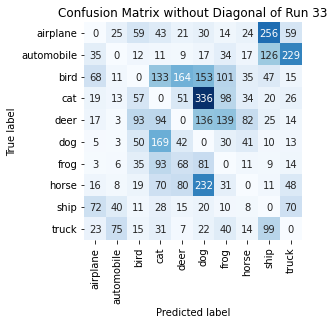

Summing down the rows, for Predictions of each Class that were wrong:  [ 258.  184.  351.  672.  457. 1027.  497.  266.  603.  488.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  164.0 times
Summing across the columns, for total number of that True Class misidentified:  [531. 490. 727. 654. 603. 363. 320. 515. 274. 326.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  139.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 

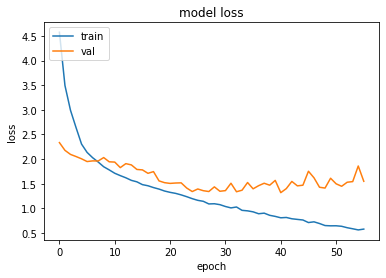

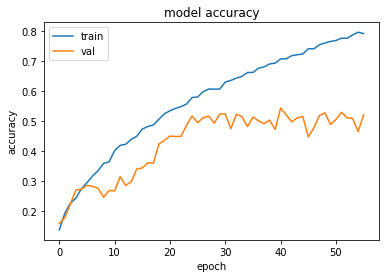

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3181910514831543 , and Val Acc happened to be 0.542900025844574
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.542900025844574 and Val Loss happened to be  1.3181910514831543
TestLoss:  1.2939954996109009  TestAcc: 0.54830002784729
frog 0.769
ship 0.693
automobile 0.666
truck 0.64
dog 0.604
airplane 0.525
horse 0.491
deer 0.433
cat 0.343
bird 0.319


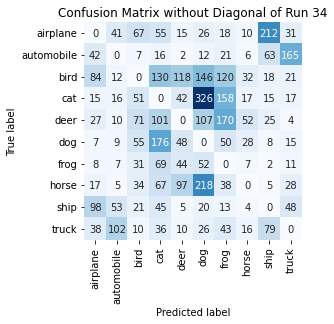

Summing down the rows, for Predictions of each Class that were wrong:  [336. 255. 347. 695. 381. 933. 631. 172. 427. 340.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  118.0 times
Summing across the columns, for total number of that True Class misidentified:  [475. 334. 681. 657. 567. 396. 231. 509. 307. 360.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  170.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

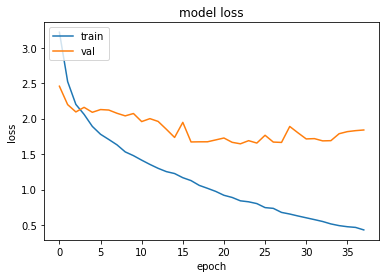

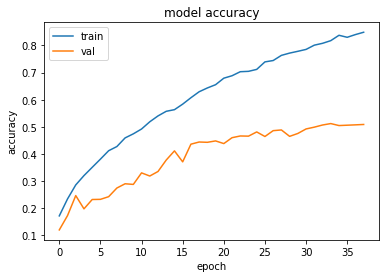

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.6447123289108276 , and Val Acc happened to be 0.46630001068115234
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5120000243186951 and Val Loss happened to be  1.688982367515564
TestLoss:  1.5971609354019165  TestAcc: 0.4837999939918518
frog 0.802
ship 0.78
automobile 0.534
truck 0.533
airplane 0.52
deer 0.503
horse 0.356
cat 0.34
dog 0.303
bird 0.167


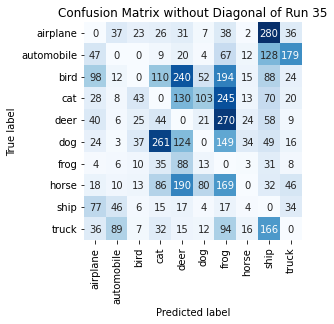

Summing down the rows, for Predictions of each Class that were wrong:  [ 372.  217.  164.  618.  855.  296. 1243.  123.  902.  372.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  240.0 times
Summing across the columns, for total number of that True Class misidentified:  [480. 466. 833. 660. 497. 697. 198. 644. 220. 467.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  270.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

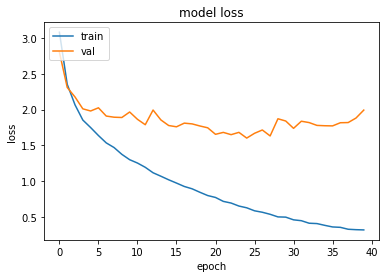

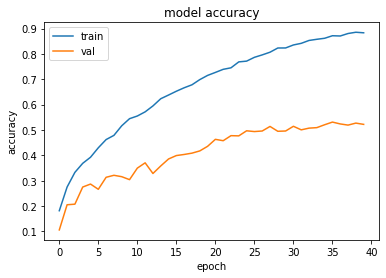

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6025874614715576 , and Val Acc happened to be 0.4968000054359436
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5311999917030334 and Val Loss happened to be  1.7725154161453247
TestLoss:  1.5719105005264282  TestAcc: 0.5049999952316284
frog 0.733
ship 0.651
deer 0.577
dog 0.559
airplane 0.526
truck 0.523
automobile 0.475
horse 0.456
cat 0.298
bird 0.252


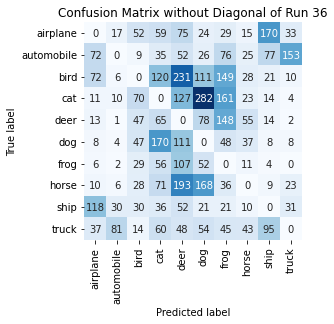

Summing down the rows, for Predictions of each Class that were wrong:  [347. 157. 326. 672. 996. 816. 713. 247. 412. 264.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  231.0 times
Summing across the columns, for total number of that True Class misidentified:  [474. 525. 748. 702. 423. 441. 267. 544. 349. 477.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  148.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 

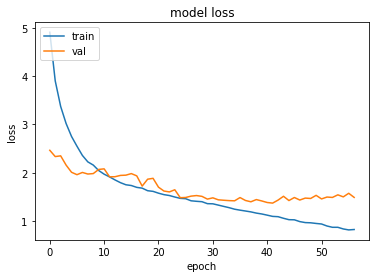

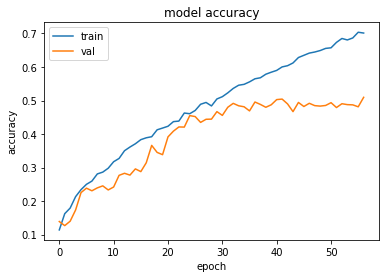

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.3720579147338867 , and Val Acc happened to be 0.5041999816894531
Additionally, the best val acc epoch happened to be  56 when val acc was:  0.5095000267028809 and Val Loss happened to be  1.4900728464126587
TestLoss:  1.354207158088684  TestAcc: 0.5033000111579895
truck 0.677
frog 0.649
ship 0.634
automobile 0.629
horse 0.574
dog 0.562
deer 0.454
airplane 0.319
cat 0.291
bird 0.244


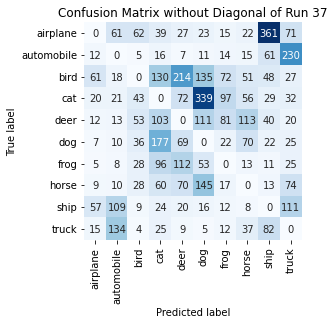

Summing down the rows, for Predictions of each Class that were wrong:  [198. 384. 268. 670. 600. 838. 342. 385. 667. 615.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  214.0 times
Summing across the columns, for total number of that True Class misidentified:  [681. 371. 756. 709. 546. 438. 351. 426. 366. 323.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  113.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

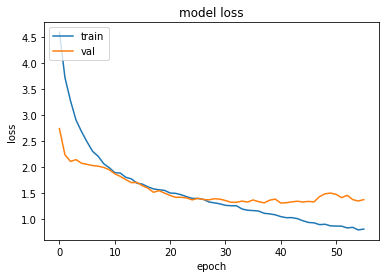

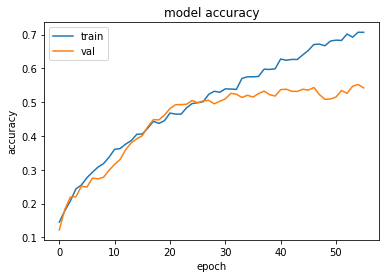

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3134580850601196 , and Val Acc happened to be 0.5370000004768372
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.5522000193595886 and Val Loss happened to be  1.3527119159698486
TestLoss:  1.2919843196868896  TestAcc: 0.5422000288963318
frog 0.747
automobile 0.713
ship 0.623
truck 0.569
horse 0.567
deer 0.527
airplane 0.508
dog 0.487
bird 0.433
cat 0.248


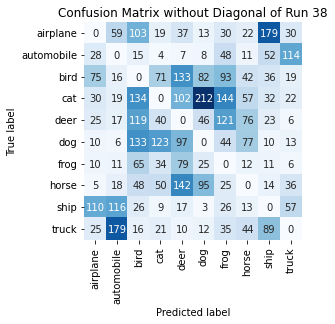

Summing down the rows, for Predictions of each Class that were wrong:  [318. 441. 659. 371. 624. 496. 566. 354. 446. 303.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  142.0 times
Summing across the columns, for total number of that True Class misidentified:  [492. 287. 567. 752. 473. 513. 253. 433. 377. 431.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  121.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

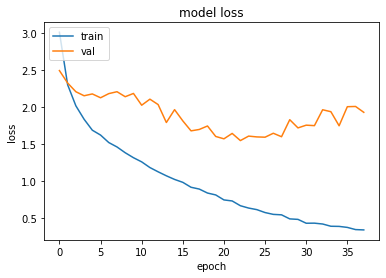

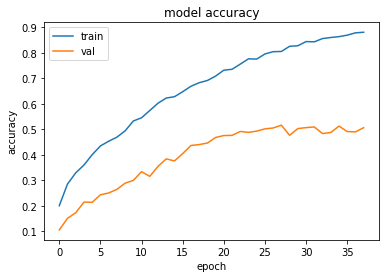

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5475702285766602 , and Val Acc happened to be 0.492000013589859
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5164999961853027 and Val Loss happened to be  1.5995869636535645
TestLoss:  1.5206115245819092  TestAcc: 0.49729999899864197
frog 0.823
airplane 0.674
automobile 0.659
ship 0.556
truck 0.533
deer 0.413
dog 0.375
bird 0.37
horse 0.299
cat 0.271


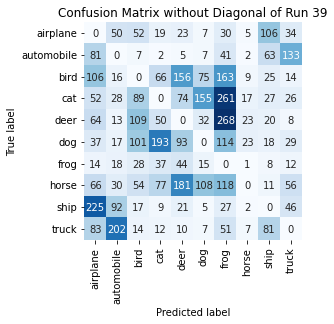

Summing down the rows, for Predictions of each Class that were wrong:  [ 728.  466.  471.  465.  607.  411. 1073.   89.  359.  358.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  181.0 times
Summing across the columns, for total number of that True Class misidentified:  [326. 341. 630. 729. 587. 625. 177. 701. 444. 467.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  268.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 

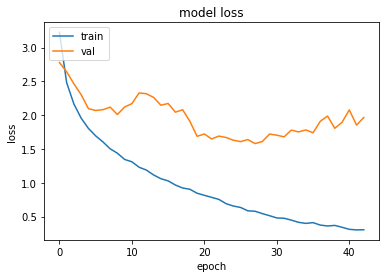

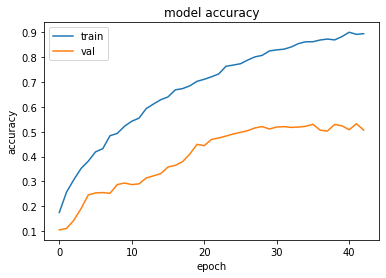

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.5793957710266113 , and Val Acc happened to be 0.5153999924659729
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5321999788284302 and Val Loss happened to be  1.8526800870895386
TestLoss:  1.5698615312576294  TestAcc: 0.51910001039505
frog 0.77
ship 0.736
automobile 0.67
deer 0.534
airplane 0.528
truck 0.503
horse 0.441
dog 0.385
cat 0.322
bird 0.302


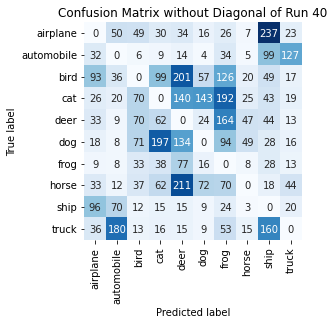

Summing down the rows, for Predictions of each Class that were wrong:  [376. 393. 361. 528. 841. 350. 783. 179. 706. 292.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  211.0 times
Summing across the columns, for total number of that True Class misidentified:  [472. 330. 698. 678. 466. 615. 230. 559. 264. 497.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  164.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


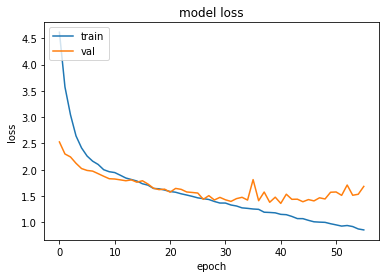

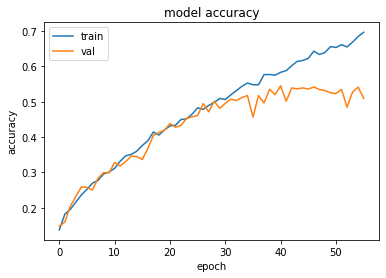

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3591746091842651 , and Val Acc happened to be 0.5450999736785889
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5450999736785889 and Val Loss happened to be  1.3591746091842651
TestLoss:  1.3258274793624878  TestAcc: 0.539900004863739
frog 0.681
automobile 0.678
dog 0.622
horse 0.617
truck 0.612
airplane 0.608
ship 0.572
bird 0.437
deer 0.385
cat 0.187


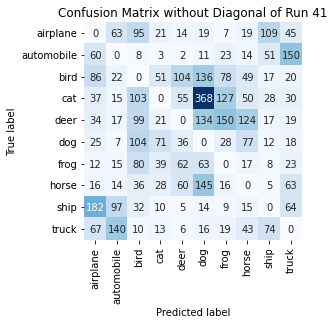

Summing down the rows, for Predictions of each Class that were wrong:  [519. 390. 567. 257. 344. 906. 457. 408. 321. 432.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [392. 322. 563. 813. 615. 378. 319. 383. 428. 388.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  150.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16

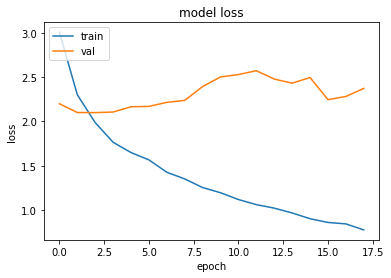

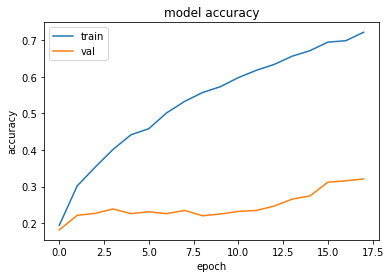

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.0998876094818115 , and Val Acc happened to be 0.22669999301433563
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.3208000063896179 and Val Loss happened to be  2.3725357055664062
TestLoss:  2.0934977531433105  TestAcc: 0.22179999947547913
ship 0.877
cat 0.524
deer 0.3
airplane 0.218
frog 0.147
dog 0.094
horse 0.046
truck 0.009
bird 0.003
automobile 0.0


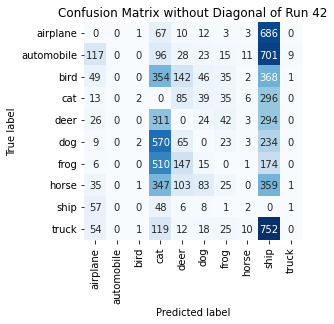

Summing down the rows, for Predictions of each Class that were wrong:  [ 366.    0.    7. 2422.  598.  268.  204.   41. 3864.   12.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [ 782. 1000.  997.  476.  700.  906.  853.  954.  123.  991.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  311.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )

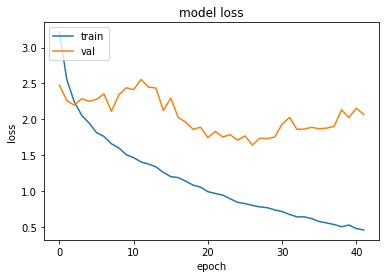

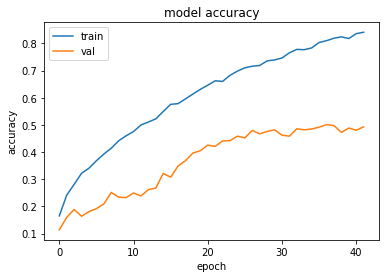

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.6410197019577026 , and Val Acc happened to be 0.4794999957084656
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5009999871253967 and Val Loss happened to be  1.8766988515853882
TestLoss:  1.6072503328323364  TestAcc: 0.48429998755455017
frog 0.737
ship 0.717
automobile 0.562
truck 0.561
deer 0.474
horse 0.414
bird 0.392
airplane 0.35
dog 0.348
cat 0.288


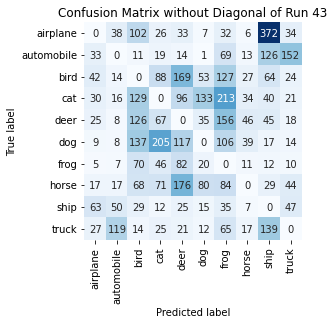

Summing down the rows, for Predictions of each Class that were wrong:  [251. 277. 686. 559. 733. 356. 887. 200. 844. 364.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [650. 438. 608. 712. 526. 652. 263. 586. 283. 439.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  156.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


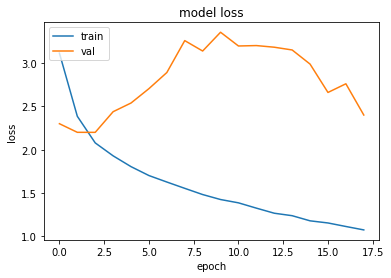

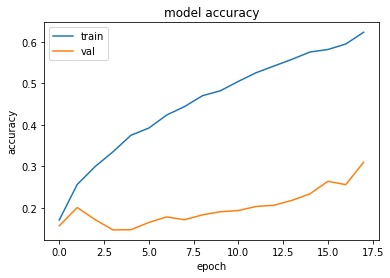

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.2000935077667236 , and Val Acc happened to be 0.17159999907016754
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.3098999857902527 and Val Loss happened to be  2.399902820587158
TestLoss:  2.190107822418213  TestAcc: 0.17159999907016754
dog 0.847
ship 0.415
deer 0.331
cat 0.084
frog 0.013
horse 0.012
airplane 0.006
automobile 0.004
bird 0.002
truck 0.002


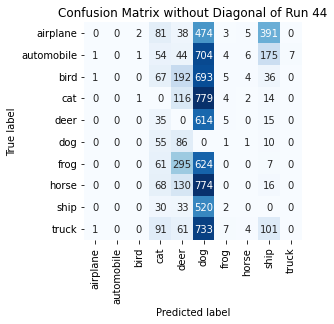

Summing down the rows, for Predictions of each Class that were wrong:  [3.000e+00 0.000e+00 4.000e+00 5.420e+02 9.950e+02 5.915e+03 3.100e+01
 2.200e+01 7.650e+02 7.000e+00]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  295.0 times
Summing across the columns, for total number of that True Class misidentified:  [994. 996. 998. 916. 669. 153. 987. 988. 585. 998.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  614.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  

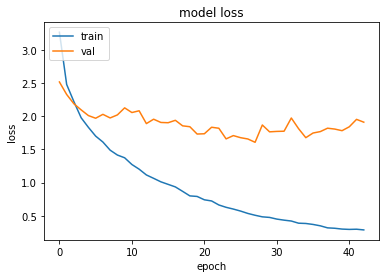

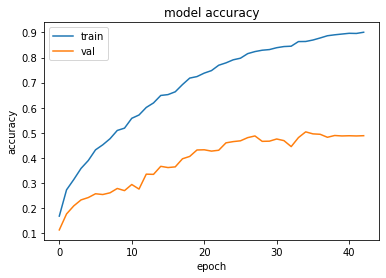

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.6058167219161987 , and Val Acc happened to be 0.4876999855041504
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5040000081062317 and Val Loss happened to be  1.6753257513046265
TestLoss:  1.570189118385315  TestAcc: 0.499099999666214
frog 0.729
truck 0.713
deer 0.609
ship 0.566
dog 0.533
automobile 0.51
airplane 0.508
horse 0.351
cat 0.242
bird 0.23


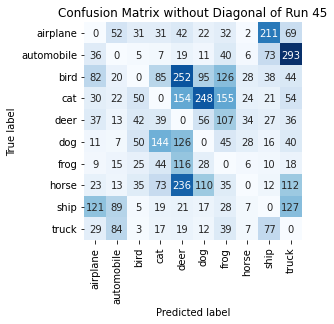

Summing down the rows, for Predictions of each Class that were wrong:  [378. 315. 246. 459. 985. 599. 607. 142. 485. 793.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  252.0 times
Summing across the columns, for total number of that True Class misidentified:  [492. 490. 770. 758. 391. 467. 271. 649. 434. 287.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  107.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

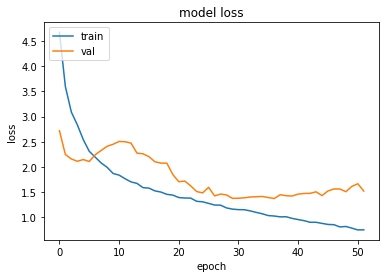

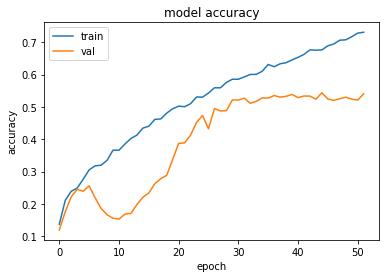

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3759452104568481 , and Val Acc happened to be 0.5351999998092651
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5436000227928162 and Val Loss happened to be  1.433683156967163
TestLoss:  1.3352118730545044  TestAcc: 0.5403000116348267
automobile 0.745
frog 0.705
horse 0.676
dog 0.637
truck 0.628
ship 0.603
airplane 0.585
deer 0.407
bird 0.233
cat 0.184


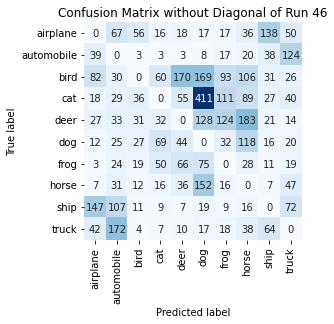

Summing down the rows, for Predictions of each Class that were wrong:  [377. 518. 199. 262. 409. 996. 437. 634. 353. 412.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [415. 255. 767. 816. 593. 363. 295. 324. 397. 372.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  183.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

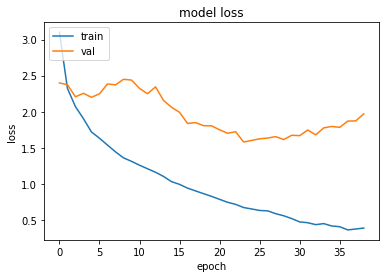

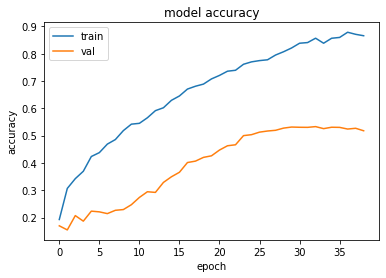

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5788259506225586 , and Val Acc happened to be 0.5
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5329999923706055 and Val Loss happened to be  1.6786798238754272
TestLoss:  1.5207585096359253  TestAcc: 0.5146999955177307
ship 0.73
frog 0.679
dog 0.632
truck 0.578
deer 0.557
airplane 0.534
automobile 0.483
horse 0.396
cat 0.298
bird 0.26


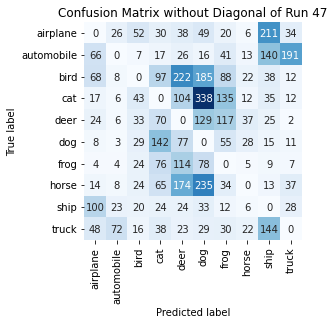

Summing down the rows, for Predictions of each Class that were wrong:  [ 349.  156.  248.  559.  802. 1092.  532.  151.  630.  334.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  222.0 times
Summing across the columns, for total number of that True Class misidentified:  [466. 517. 740. 702. 443. 368. 321. 604. 270. 422.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  129.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 

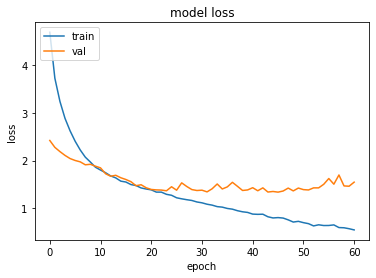

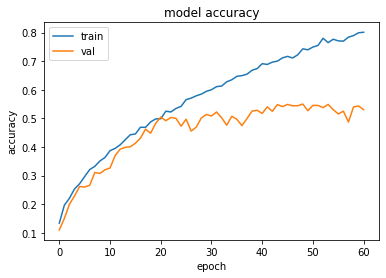

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  45 when  Val Loss was:  1.3369094133377075 , and Val Acc happened to be 0.5486000180244446
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5498999953269958 and Val Loss happened to be  1.362950325012207
TestLoss:  1.3209093809127808  TestAcc: 0.5476999878883362
frog 0.751
ship 0.666
automobile 0.641
deer 0.603
truck 0.579
horse 0.562
airplane 0.545
bird 0.45
dog 0.43
cat 0.25


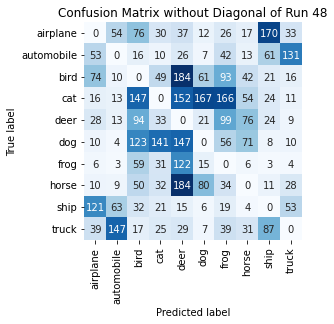

Summing down the rows, for Predictions of each Class that were wrong:  [357. 316. 614. 372. 896. 376. 574. 314. 409. 295.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [455. 359. 550. 750. 397. 570. 249. 438. 334. 421.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  99.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noi

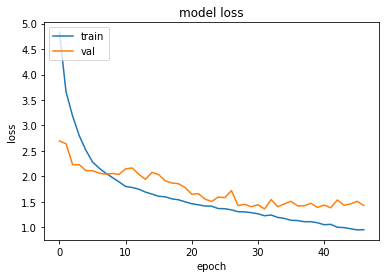

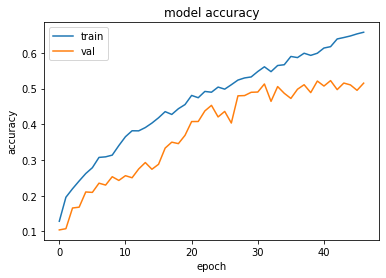

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.3599603176116943 , and Val Acc happened to be 0.5128999948501587
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5223000049591064 and Val Loss happened to be  1.3818669319152832
TestLoss:  1.3446769714355469  TestAcc: 0.5142999887466431
frog 0.801
ship 0.725
truck 0.61
automobile 0.595
dog 0.553
horse 0.532
deer 0.5
airplane 0.462
bird 0.24
cat 0.125


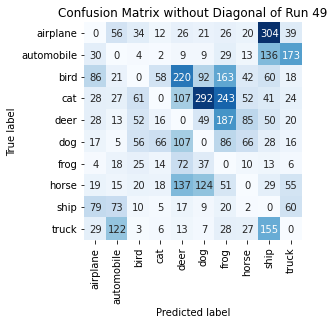

Summing down the rows, for Predictions of each Class that were wrong:  [320. 350. 265. 197. 708. 640. 833. 317. 816. 411.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  220.0 times
Summing across the columns, for total number of that True Class misidentified:  [538. 405. 760. 875. 500. 447. 199. 468. 275. 390.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  187.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

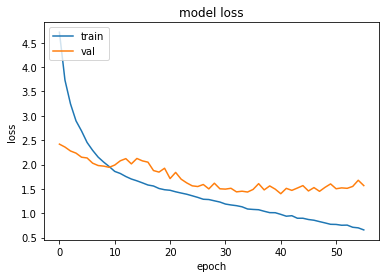

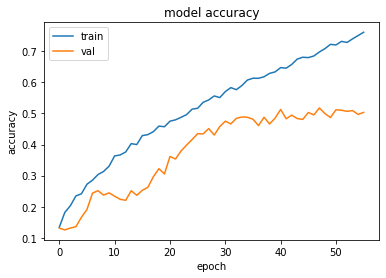

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.4006074666976929 , and Val Acc happened to be 0.5128999948501587
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.517799973487854 and Val Loss happened to be  1.4498603343963623
TestLoss:  1.3945438861846924  TestAcc: 0.5056999921798706
frog 0.774
ship 0.756
automobile 0.614
truck 0.564
horse 0.533
deer 0.462
dog 0.418
airplane 0.347
bird 0.323
cat 0.266


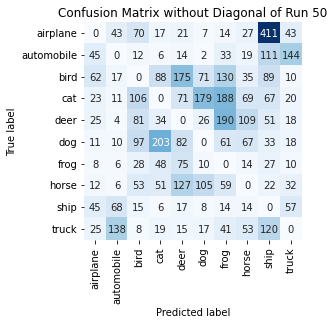

Summing down the rows, for Predictions of each Class that were wrong:  [256. 303. 470. 472. 597. 425. 730. 407. 931. 352.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  175.0 times
Summing across the columns, for total number of that True Class misidentified:  [653. 386. 677. 734. 538. 582. 226. 467. 244. 436.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  190.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Fri, 12 November 2021 00:55:32  (subtract ~5-hours for local Hour), and file is called  runs_GroupH_final.pkl


In [ ]:
#@title Group H: 51 Run Results
run_through_runs(ds=make_unbatched(train_H),   ds_noalb= train_H_noalb, dstitle="H" , showpictures= False)

filename will be:  runs_GroupI .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


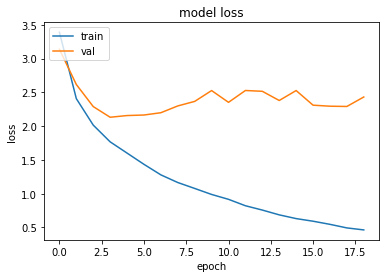

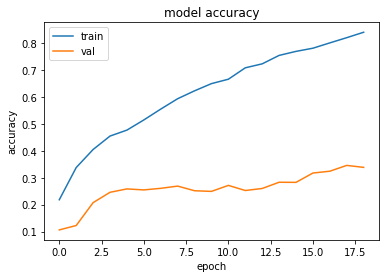

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.130981922149658 , and Val Acc happened to be 0.2459000051021576
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.34599998593330383 and Val Loss happened to be  2.2905092239379883
TestLoss:  2.1177878379821777  TestAcc: 0.24379999935626984
dog 0.697
airplane 0.499
ship 0.356
frog 0.302
deer 0.176
cat 0.158
bird 0.146
horse 0.065
truck 0.029
automobile 0.01


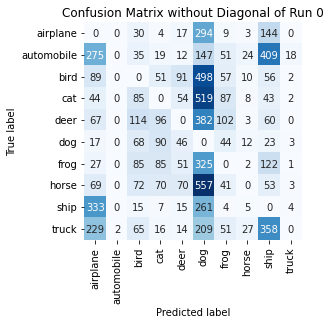

Summing down the rows, for Predictions of each Class that were wrong:  [1.150e+03 2.000e+00 5.690e+02 4.380e+02 3.700e+02 3.192e+03 4.460e+02
 9.400e+01 1.268e+03 3.300e+01]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  91.0 times
Summing across the columns, for total number of that True Class misidentified:  [501. 990. 854. 842. 824. 303. 698. 935. 644. 971.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  382.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 

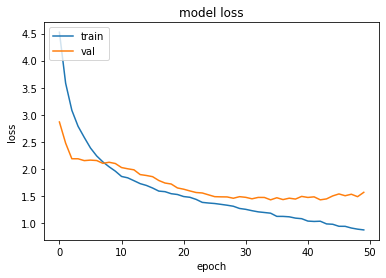

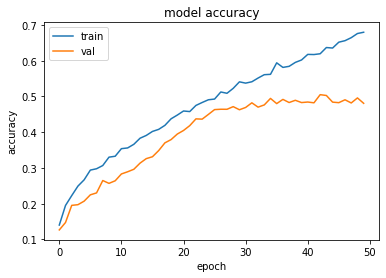

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4267922639846802 , and Val Acc happened to be 0.49459999799728394
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5051000118255615 and Val Loss happened to be  1.4268293380737305
TestLoss:  1.4101935625076294  TestAcc: 0.4894999861717224
frog 0.8
automobile 0.667
ship 0.615
airplane 0.545
horse 0.525
truck 0.515
deer 0.397
bird 0.378
dog 0.32
cat 0.133


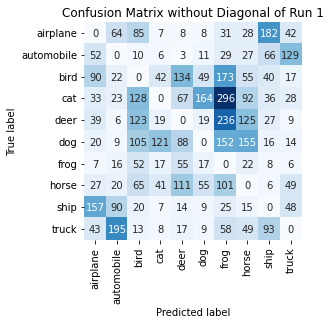

Summing down the rows, for Predictions of each Class that were wrong:  [ 468.  445.  601.  268.  497.  341. 1101.  568.  474.  342.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  134.0 times
Summing across the columns, for total number of that True Class misidentified:  [455. 333. 622. 867. 603. 680. 200. 475. 385. 485.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  236.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bri

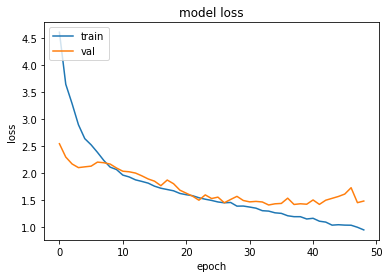

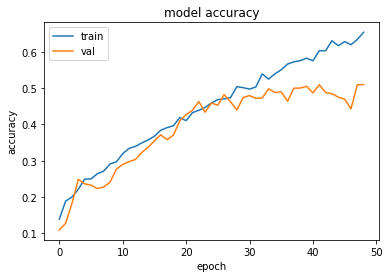

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.405484914779663 , and Val Acc happened to be 0.49810001254081726
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5098000168800354 and Val Loss happened to be  1.4786890745162964
TestLoss:  1.381728172302246  TestAcc: 0.5059999823570251
frog 0.74
truck 0.648
automobile 0.614
horse 0.603
ship 0.56
dog 0.503
deer 0.463
airplane 0.429
cat 0.264
bird 0.236


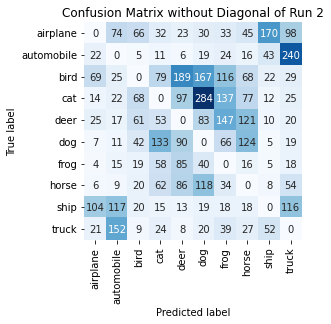

Summing down the rows, for Predictions of each Class that were wrong:  [272. 442. 310. 467. 597. 780. 614. 512. 327. 619.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [571. 386. 764. 736. 537. 497. 260. 397. 440. 352.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  147.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brigh

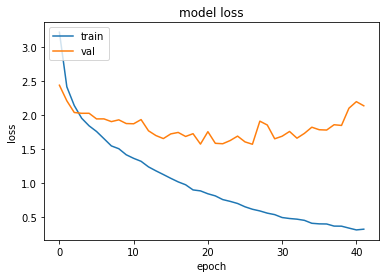

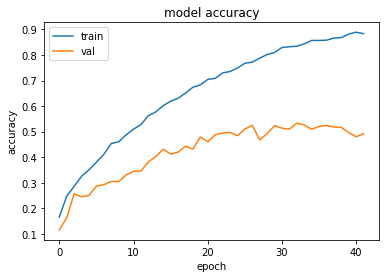

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.5705701112747192 , and Val Acc happened to be 0.5241000056266785
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5329999923706055 and Val Loss happened to be  1.6594862937927246
TestLoss:  1.5434670448303223  TestAcc: 0.5170999765396118
ship 0.748
frog 0.694
automobile 0.666
deer 0.604
truck 0.6
horse 0.495
airplane 0.452
dog 0.355
bird 0.282
cat 0.275


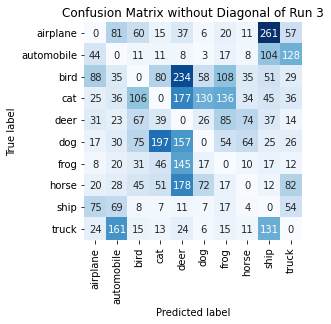

Summing down the rows, for Predictions of each Class that were wrong:  [332. 483. 418. 459. 971. 325. 469. 251. 683. 438.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  234.0 times
Summing across the columns, for total number of that True Class misidentified:  [548. 334. 718. 725. 396. 645. 306. 505. 252. 400.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  85.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contrast: ( 0.1 

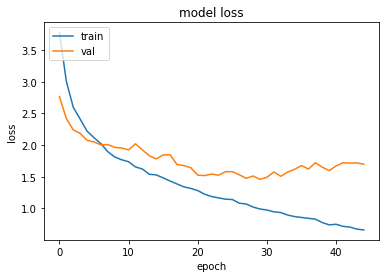

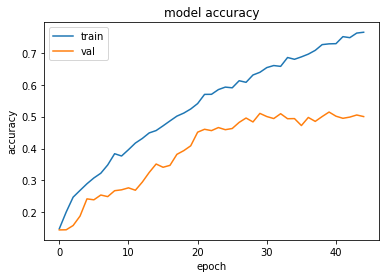

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.4571127891540527 , and Val Acc happened to be 0.510200023651123
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5144000053405762 and Val Loss happened to be  1.5962036848068237
TestLoss:  1.4502575397491455  TestAcc: 0.5109999775886536
frog 0.764
ship 0.68
automobile 0.639
horse 0.554
truck 0.547
deer 0.482
airplane 0.479
bird 0.346
dog 0.341
cat 0.278


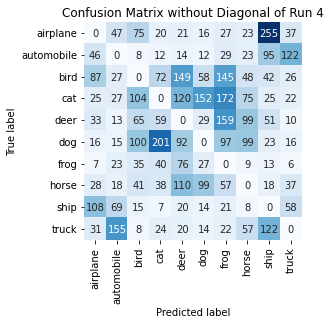

Summing down the rows, for Predictions of each Class that were wrong:  [381. 394. 451. 473. 622. 421. 729. 441. 644. 334.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  149.0 times
Summing across the columns, for total number of that True Class misidentified:  [521. 361. 654. 722. 518. 659. 236. 446. 320. 453.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

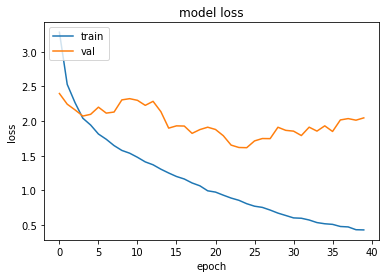

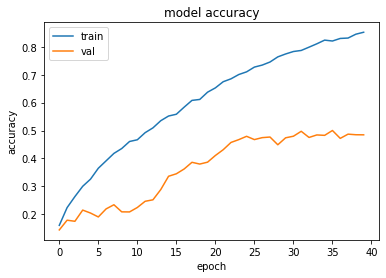

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6154719591140747 , and Val Acc happened to be 0.47940000891685486
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5001999735832214 and Val Loss happened to be  1.849817156791687
TestLoss:  1.6035823822021484  TestAcc: 0.4830999970436096
ship 0.796
frog 0.779
automobile 0.613
truck 0.508
horse 0.461
deer 0.41
bird 0.352
dog 0.333
airplane 0.292
cat 0.287


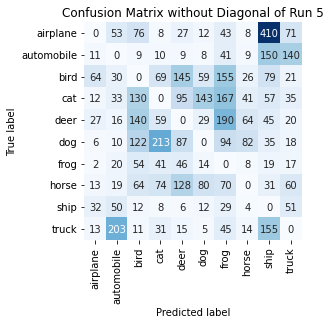

Summing down the rows, for Predictions of each Class that were wrong:  [180. 434. 618. 513. 558. 362. 834. 256. 981. 433.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  145.0 times
Summing across the columns, for total number of that True Class misidentified:  [708. 387. 648. 713. 590. 667. 221. 539. 204. 492.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  190.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Brigh

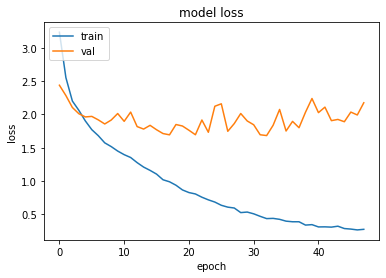

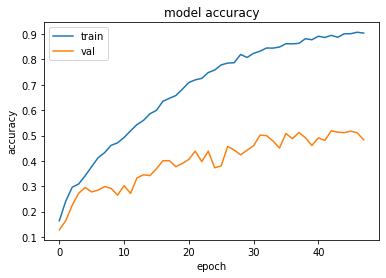

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.6831320524215698 , and Val Acc happened to be 0.49939998984336853
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5188000202178955 and Val Loss happened to be  1.9072951078414917
TestLoss:  1.6765987873077393  TestAcc: 0.4941999912261963
frog 0.757
truck 0.596
ship 0.544
horse 0.539
deer 0.488
airplane 0.452
bird 0.434
automobile 0.433
cat 0.356
dog 0.343


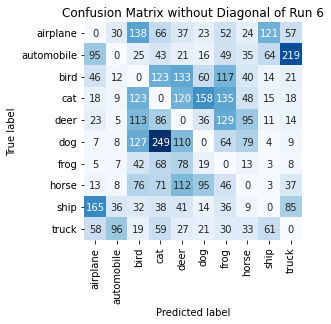

Summing down the rows, for Predictions of each Class that were wrong:  [430. 211. 695. 803. 679. 442. 658. 376. 296. 468.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  133.0 times
Summing across the columns, for total number of that True Class misidentified:  [548. 567. 566. 644. 512. 657. 243. 461. 456. 404.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  129.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0.0 )
Bri

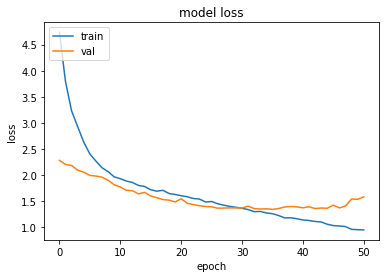

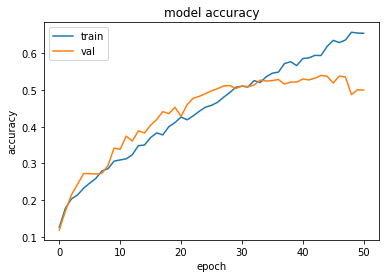

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3445497751235962 , and Val Acc happened to be 0.5250999927520752
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5392000079154968 and Val Loss happened to be  1.3717557191848755
TestLoss:  1.3262696266174316  TestAcc: 0.5281999707221985
ship 0.792
frog 0.696
truck 0.665
horse 0.598
dog 0.595
automobile 0.592
airplane 0.385
bird 0.36
deer 0.345
cat 0.254


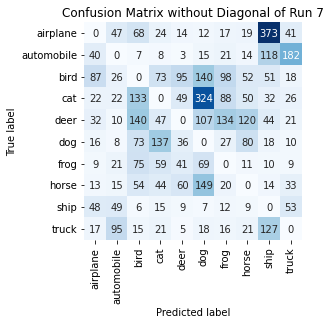

Summing down the rows, for Predictions of each Class that were wrong:  [284. 293. 571. 428. 312. 841. 433. 376. 787. 393.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [615. 408. 640. 746. 655. 405. 304. 402. 208. 335.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  140.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.

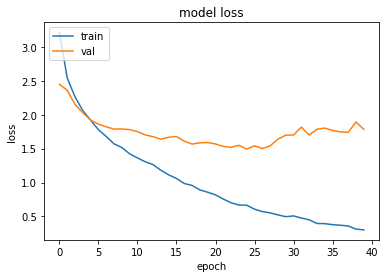

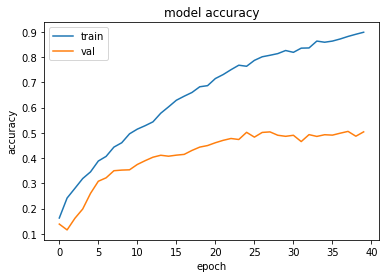

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.492862343788147 , and Val Acc happened to be 0.5019000172615051
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5055999755859375 and Val Loss happened to be  1.739822506904602
TestLoss:  1.4617786407470703  TestAcc: 0.5012000203132629
frog 0.717
ship 0.702
truck 0.602
deer 0.594
automobile 0.582
airplane 0.492
horse 0.458
dog 0.385
bird 0.254
cat 0.226


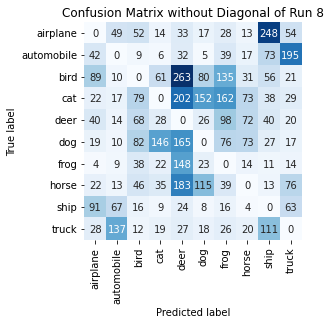

Summing down the rows, for Predictions of each Class that were wrong:  [ 357.  326.  402.  340. 1077.  444.  619.  317.  617.  489.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  263.0 times
Summing across the columns, for total number of that True Class misidentified:  [508. 418. 746. 774. 406. 615. 283. 542. 298. 398.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  98.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contra

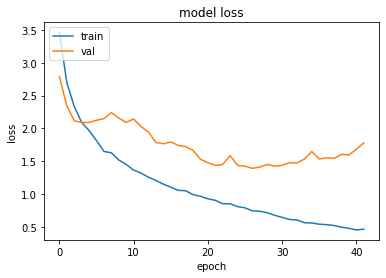

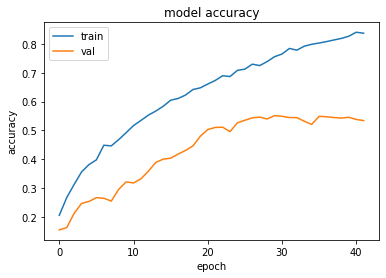

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.390197992324829 , and Val Acc happened to be 0.5435000061988831
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5511000156402588 and Val Loss happened to be  1.4227262735366821
TestLoss:  1.367685317993164  TestAcc: 0.5425000190734863
ship 0.71
frog 0.69
truck 0.642
horse 0.612
automobile 0.59
airplane 0.574
deer 0.539
dog 0.465
bird 0.315
cat 0.288


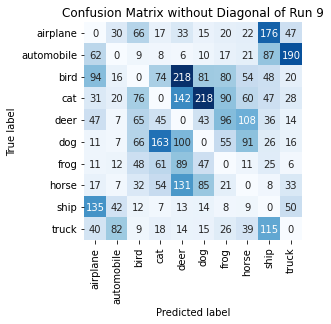

Summing down the rows, for Predictions of each Class that were wrong:  [448. 223. 383. 447. 746. 528. 413. 415. 568. 404.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  218.0 times
Summing across the columns, for total number of that True Class misidentified:  [426. 410. 685. 712. 461. 535. 310. 388. 290. 358.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  108.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise: 

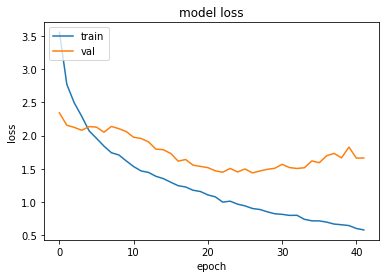

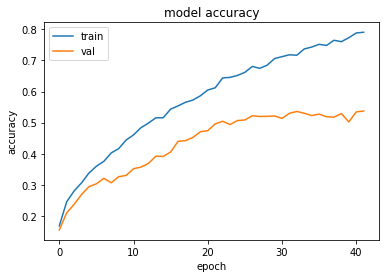

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.4370622634887695 , and Val Acc happened to be 0.5220999717712402
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5374000072479248 and Val Loss happened to be  1.6619861125946045
TestLoss:  1.4223510026931763  TestAcc: 0.5231999754905701
ship 0.817
frog 0.628
horse 0.584
deer 0.577
automobile 0.533
truck 0.53
airplane 0.521
dog 0.379
cat 0.35
bird 0.313


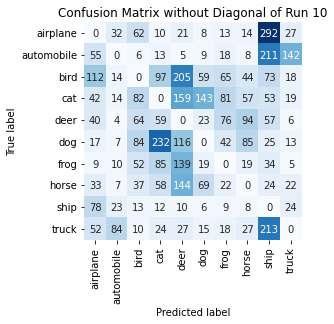

Summing down the rows, for Predictions of each Class that were wrong:  [438. 195. 410. 590. 826. 351. 344. 356. 982. 276.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  205.0 times
Summing across the columns, for total number of that True Class misidentified:  [479. 467. 687. 650. 423. 621. 372. 416. 183. 470.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  94.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

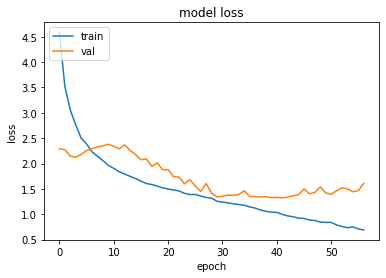

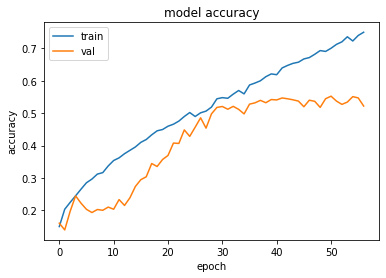

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.3245124816894531 , and Val Acc happened to be 0.546999990940094
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5525000095367432 and Val Loss happened to be  1.3949313163757324
TestLoss:  1.3163667917251587  TestAcc: 0.5407000184059143
ship 0.68
horse 0.678
automobile 0.645
frog 0.635
truck 0.629
airplane 0.547
dog 0.424
deer 0.413
cat 0.406
bird 0.35


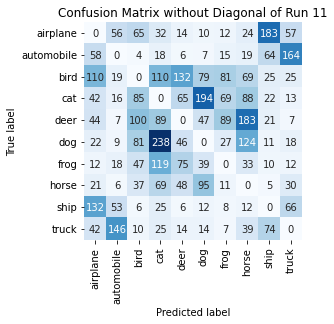

Summing down the rows, for Predictions of each Class that were wrong:  [483. 330. 435. 725. 406. 497. 319. 591. 415. 392.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  132.0 times
Summing across the columns, for total number of that True Class misidentified:  [453. 355. 650. 594. 587. 576. 365. 322. 320. 371.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  183.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16

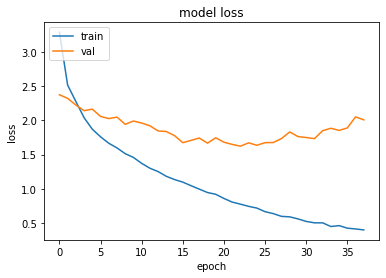

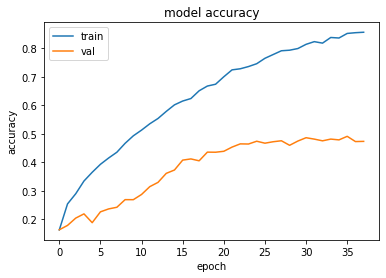

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.6228471994400024 , and Val Acc happened to be 0.4648999869823456
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.49140000343322754 and Val Loss happened to be  1.8897068500518799
TestLoss:  1.5967398881912231  TestAcc: 0.4738999903202057
frog 0.745
ship 0.727
truck 0.625
automobile 0.573
horse 0.462
airplane 0.43
deer 0.416
dog 0.359
bird 0.224
cat 0.178


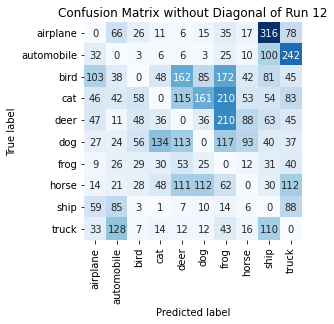

Summing down the rows, for Predictions of each Class that were wrong:  [370. 441. 258. 328. 585. 459. 888. 337. 825. 770.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  162.0 times
Summing across the columns, for total number of that True Class misidentified:  [570. 427. 776. 822. 584. 641. 255. 538. 273. 375.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  210.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.0 , 0.0 )


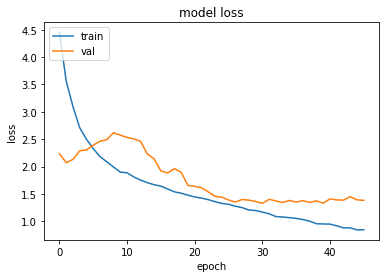

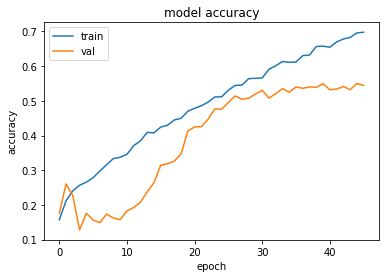

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.326791524887085 , and Val Acc happened to be 0.5302000045776367
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.550000011920929 and Val Loss happened to be  1.3902466297149658
TestLoss:  1.2951922416687012  TestAcc: 0.5324000120162964
ship 0.756
frog 0.698
horse 0.689
truck 0.606
automobile 0.599
deer 0.577
airplane 0.463
dog 0.449
bird 0.301
cat 0.186


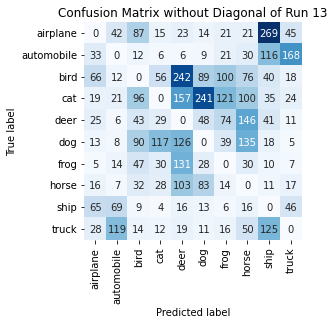

Summing down the rows, for Predictions of each Class that were wrong:  [270. 298. 430. 297. 823. 536. 412. 604. 665. 341.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  242.0 times
Summing across the columns, for total number of that True Class misidentified:  [537. 401. 699. 814. 423. 551. 302. 311. 244. 394.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  146.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0

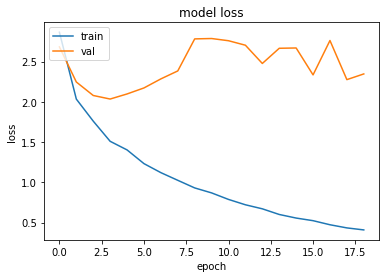

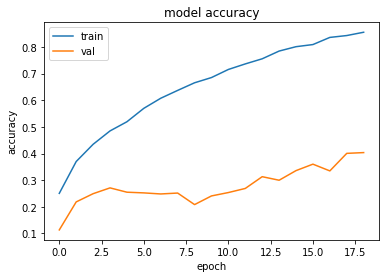

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  2.0340285301208496 , and Val Acc happened to be 0.2711000144481659
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.4034999907016754 and Val Loss happened to be  2.3458707332611084
TestLoss:  2.01996111869812  TestAcc: 0.2759000062942505
frog 0.803
dog 0.494
ship 0.449
automobile 0.354
airplane 0.342
cat 0.213
horse 0.057
deer 0.024
bird 0.013
truck 0.01


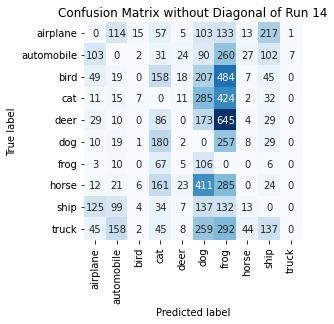

Summing down the rows, for Predictions of each Class that were wrong:  [ 387.  465.   37.  819.  103. 1771. 2912.  118.  621.    8.]
For example, the model predicted a  label 4 (deer) on a true   1  a total of  24.0 times
Summing across the columns, for total number of that True Class misidentified:  [658. 646. 987. 787. 976. 506. 197. 943. 551. 990.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  645.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

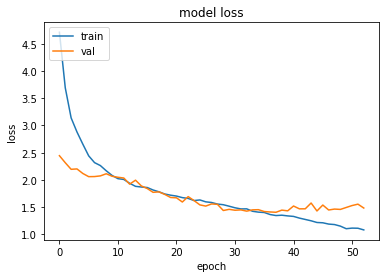

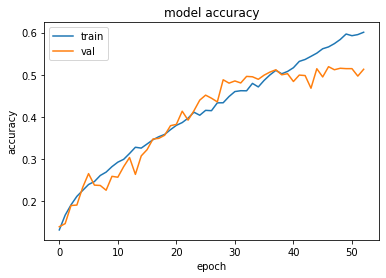

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.4057543277740479 , and Val Acc happened to be 0.5116999745368958
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.51910001039505 and Val Loss happened to be  1.4475269317626953
TestLoss:  1.3833065032958984  TestAcc: 0.5128999948501587
ship 0.672
horse 0.634
frog 0.627
automobile 0.608
truck 0.593
airplane 0.495
deer 0.433
dog 0.397
bird 0.365
cat 0.305


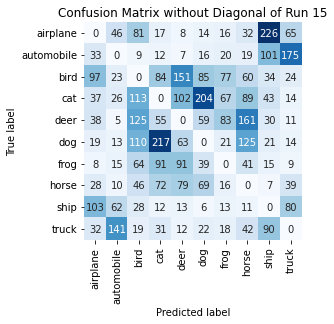

Summing down the rows, for Predictions of each Class that were wrong:  [395. 341. 595. 591. 526. 514. 331. 580. 567. 431.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  151.0 times
Summing across the columns, for total number of that True Class misidentified:  [505. 392. 635. 695. 567. 603. 373. 366. 328. 407.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  161.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )

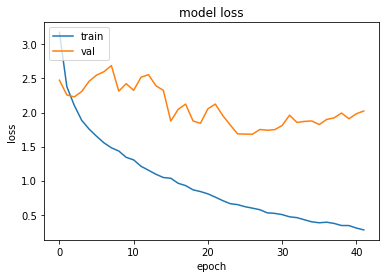

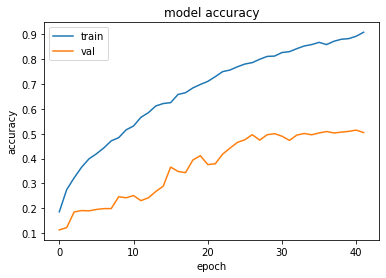

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.6811752319335938 , and Val Acc happened to be 0.4959999918937683
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5144000053405762 and Val Loss happened to be  1.9814937114715576
TestLoss:  1.6669732332229614  TestAcc: 0.4936999976634979
frog 0.755
ship 0.744
truck 0.649
deer 0.588
horse 0.506
automobile 0.502
airplane 0.437
dog 0.31
cat 0.296
bird 0.15


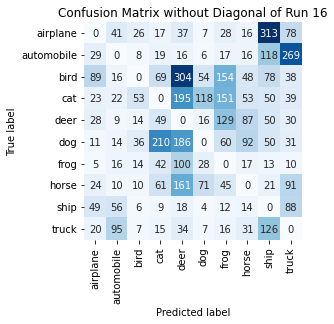

Summing down the rows, for Predictions of each Class that were wrong:  [ 278.  279.  174.  491. 1051.  311.  612.  374.  819.  674.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  304.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 498. 850. 704. 412. 690. 245. 494. 256. 351.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  129.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

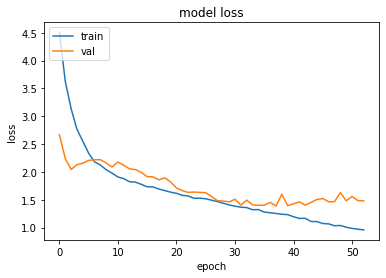

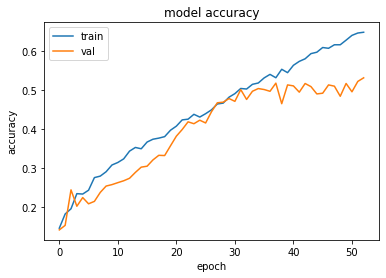

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3876134157180786 , and Val Acc happened to be 0.5174000263214111
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.531000018119812 and Val Loss happened to be  1.480002522468567
TestLoss:  1.3674508333206177  TestAcc: 0.5194000005722046
ship 0.754
frog 0.664
automobile 0.64
truck 0.567
deer 0.55
horse 0.54
dog 0.458
airplane 0.438
cat 0.3
bird 0.283


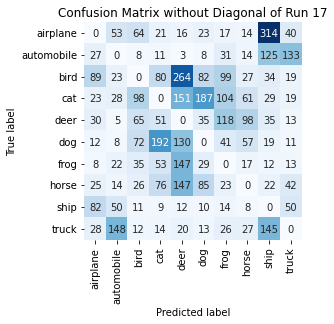

Summing down the rows, for Predictions of each Class that were wrong:  [324. 351. 391. 507. 890. 472. 473. 323. 735. 340.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  264.0 times
Summing across the columns, for total number of that True Class misidentified:  [562. 360. 717. 700. 450. 542. 336. 460. 246. 433.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  118.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

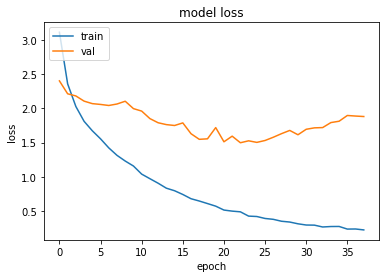

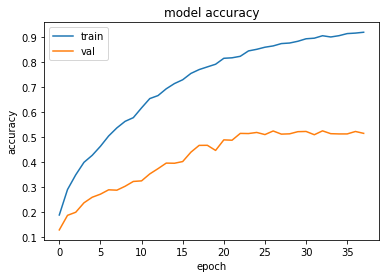

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4982225894927979 , and Val Acc happened to be 0.5151000022888184
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5253000259399414 and Val Loss happened to be  1.719590187072754
TestLoss:  1.4686331748962402  TestAcc: 0.5180000066757202
frog 0.803
ship 0.695
truck 0.625
horse 0.552
airplane 0.527
automobile 0.507
dog 0.448
bird 0.39
deer 0.365
cat 0.268


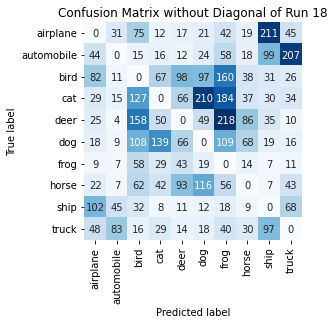

Summing down the rows, for Predictions of each Class that were wrong:  [379. 212. 651. 392. 420. 566. 885. 319. 536. 460.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  98.0 times
Summing across the columns, for total number of that True Class misidentified:  [473. 493. 610. 732. 635. 552. 197. 448. 305. 375.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  218.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

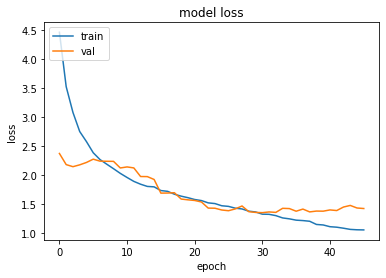

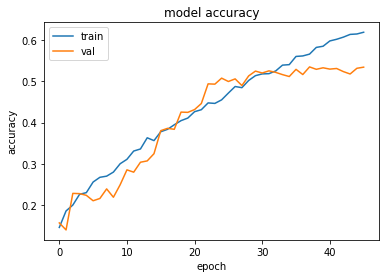

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.3511674404144287 , and Val Acc happened to be 0.519599974155426
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5343000292778015 and Val Loss happened to be  1.3642746210098267
TestLoss:  1.3451212644577026  TestAcc: 0.524399995803833
ship 0.674
truck 0.659
frog 0.646
horse 0.624
automobile 0.613
dog 0.527
deer 0.504
airplane 0.496
bird 0.264
cat 0.237


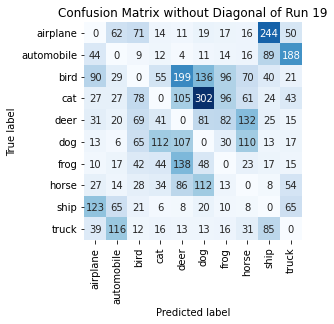

Summing down the rows, for Predictions of each Class that were wrong:  [404. 356. 395. 334. 671. 742. 374. 467. 545. 468.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  199.0 times
Summing across the columns, for total number of that True Class misidentified:  [504. 387. 736. 763. 496. 473. 354. 376. 326. 341.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  132.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise

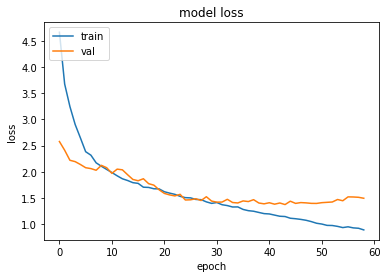

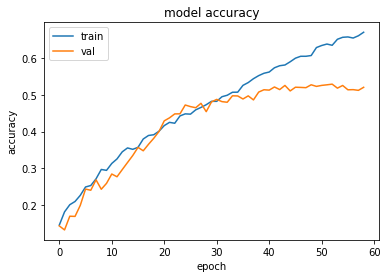

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  43 when  Val Loss was:  1.3741345405578613 , and Val Acc happened to be 0.5260000228881836
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5295000076293945 and Val Loss happened to be  1.4230210781097412
TestLoss:  1.3579870462417603  TestAcc: 0.5210000276565552
ship 0.702
automobile 0.663
frog 0.653
truck 0.568
horse 0.54
dog 0.499
airplane 0.479
deer 0.458
bird 0.351
cat 0.297


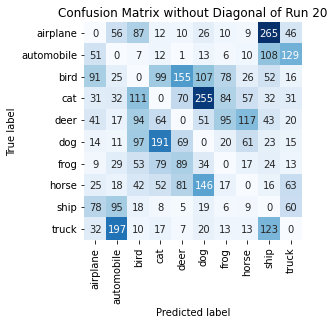

Summing down the rows, for Predictions of each Class that were wrong:  [372. 480. 519. 534. 487. 671. 329. 319. 686. 393.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [521. 337. 649. 703. 542. 501. 347. 460. 298. 432.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  117.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 

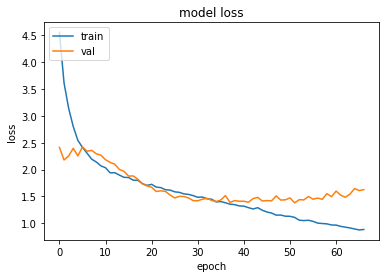

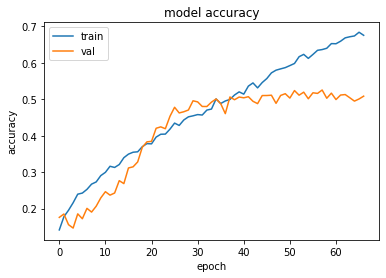

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  51 when  Val Loss was:  1.380964756011963 , and Val Acc happened to be 0.5239999890327454
Additionally, the best val acc epoch happened to be  57 when val acc was:  0.5254999995231628 and Val Loss happened to be  1.4467015266418457
TestLoss:  1.357909917831421  TestAcc: 0.5263000130653381
frog 0.711
horse 0.651
ship 0.616
automobile 0.605
airplane 0.581
truck 0.553
deer 0.483
dog 0.483
bird 0.358
cat 0.222


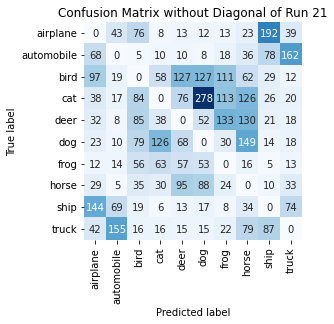

Summing down the rows, for Predictions of each Class that were wrong:  [485. 340. 455. 355. 474. 650. 472. 655. 462. 389.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  127.0 times
Summing across the columns, for total number of that True Class misidentified:  [419. 395. 642. 778. 517. 517. 289. 349. 384. 447.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  133.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

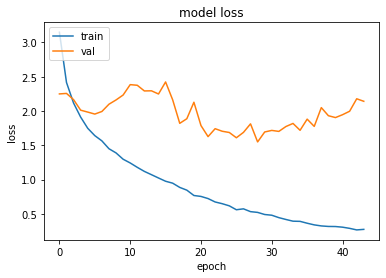

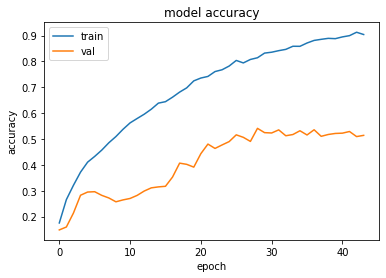

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.548259973526001 , and Val Acc happened to be 0.5412999987602234
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5412999987602234 and Val Loss happened to be  1.548259973526001
TestLoss:  1.5434314012527466  TestAcc: 0.5388000011444092
frog 0.734
ship 0.73
automobile 0.644
truck 0.576
horse 0.541
airplane 0.54
deer 0.514
cat 0.406
dog 0.373
bird 0.33


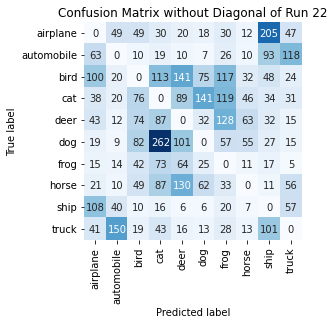

Summing down the rows, for Predictions of each Class that were wrong:  [448. 324. 411. 730. 577. 379. 558. 249. 568. 368.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [460. 356. 670. 594. 486. 627. 266. 459. 270. 424.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  128.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 , 0.08 )


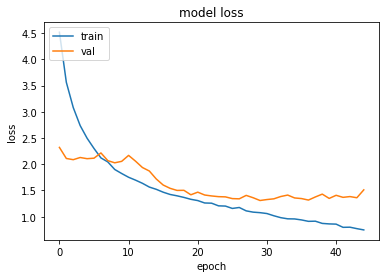

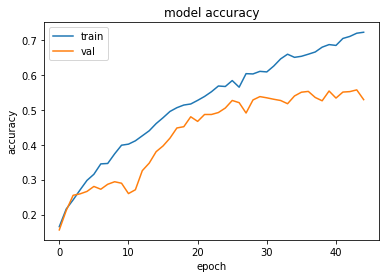

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.3088507652282715 , and Val Acc happened to be 0.5382000207901001
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5575000047683716 and Val Loss happened to be  1.3615158796310425
TestLoss:  1.2799075841903687  TestAcc: 0.5408999919891357
truck 0.775
ship 0.72
frog 0.691
horse 0.602
airplane 0.593
dog 0.567
deer 0.539
automobile 0.481
bird 0.235
cat 0.206


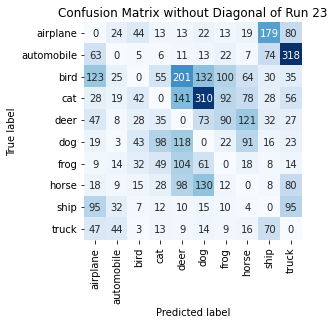

Summing down the rows, for Predictions of each Class that were wrong:  [449. 178. 219. 309. 705. 770. 370. 418. 445. 728.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  201.0 times
Summing across the columns, for total number of that True Class misidentified:  [407. 519. 765. 794. 461. 433. 309. 398. 280. 225.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  121.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

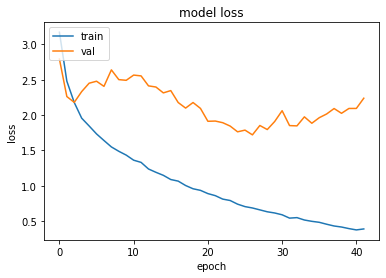

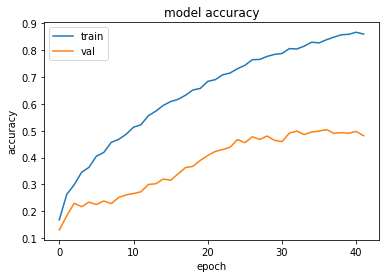

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.7197084426879883 , and Val Acc happened to be 0.47749999165534973
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5041999816894531 and Val Loss happened to be  2.015275001525879
TestLoss:  1.6923896074295044  TestAcc: 0.4819999933242798
ship 0.741
frog 0.655
deer 0.634
horse 0.578
truck 0.531
airplane 0.48
automobile 0.459
dog 0.311
bird 0.281
cat 0.15


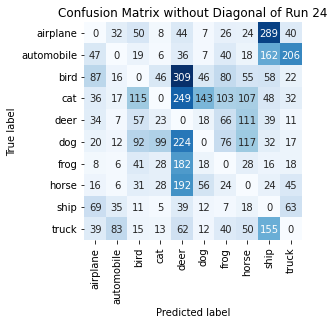

Summing down the rows, for Predictions of each Class that were wrong:  [ 356.  214.  431.  256. 1337.  319.  462.  528.  823.  454.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  309.0 times
Summing across the columns, for total number of that True Class misidentified:  [520. 541. 719. 850. 366. 689. 345. 422. 259. 469.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  111.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomI

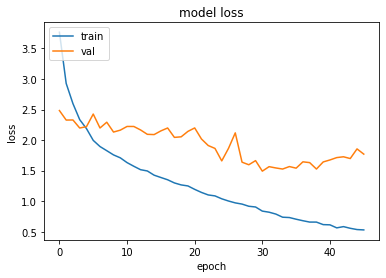

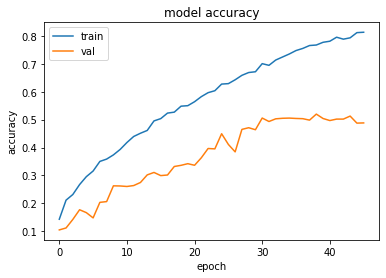

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.4916073083877563 , and Val Acc happened to be 0.5056999921798706
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5198000073432922 and Val Loss happened to be  1.5261902809143066
TestLoss:  1.4728766679763794  TestAcc: 0.5016000270843506
frog 0.848
ship 0.771
automobile 0.577
truck 0.558
horse 0.501
dog 0.492
deer 0.444
airplane 0.374
cat 0.238
bird 0.213


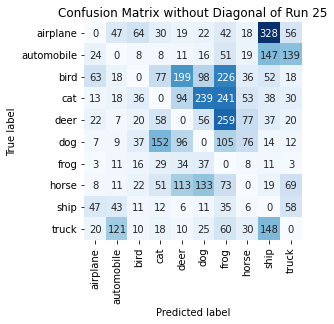

Summing down the rows, for Predictions of each Class that were wrong:  [ 207.  285.  224.  435.  582.  637. 1092.  323.  794.  405.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  199.0 times
Summing across the columns, for total number of that True Class misidentified:  [626. 423. 787. 762. 556. 508. 152. 499. 229. 442.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  259.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

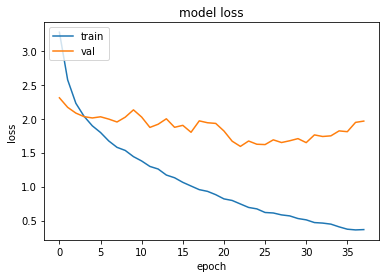

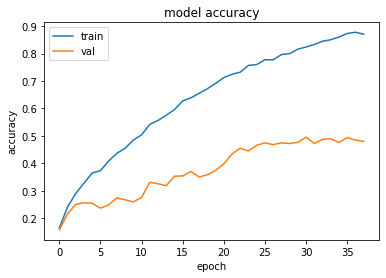

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5917978286743164 , and Val Acc happened to be 0.4546999931335449
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.4952000081539154 and Val Loss happened to be  1.6471517086029053
TestLoss:  1.5700972080230713  TestAcc: 0.45509999990463257
frog 0.89
ship 0.622
automobile 0.58
truck 0.533
airplane 0.467
dog 0.401
horse 0.313
cat 0.29
deer 0.231
bird 0.224


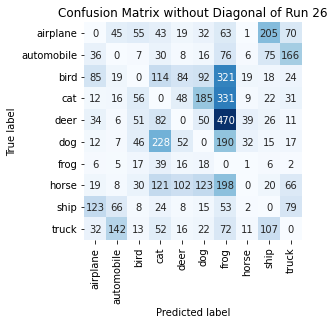

Summing down the rows, for Predictions of each Class that were wrong:  [ 359.  314.  283.  733.  353.  553. 1774.  120.  494.  466.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [533. 420. 776. 710. 769. 599. 110. 687. 378. 467.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  470.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

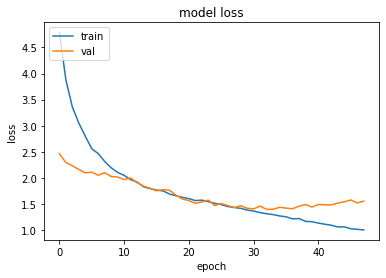

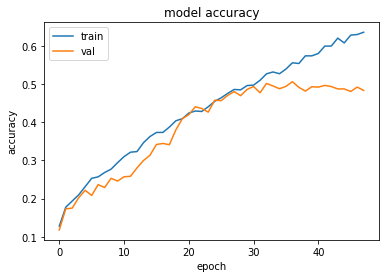

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3992265462875366 , and Val Acc happened to be 0.5016000270843506
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5060999989509583 and Val Loss happened to be  1.4112014770507812
TestLoss:  1.3915419578552246  TestAcc: 0.5004000067710876
ship 0.714
truck 0.658
frog 0.64
horse 0.605
automobile 0.521
dog 0.519
airplane 0.445
deer 0.395
bird 0.258
cat 0.249


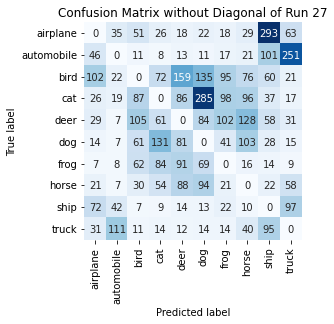

Summing down the rows, for Predictions of each Class that were wrong:  [348. 258. 425. 459. 562. 727. 428. 519. 708. 562.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  159.0 times
Summing across the columns, for total number of that True Class misidentified:  [555. 479. 742. 751. 605. 481. 360. 395. 286. 342.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  128.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

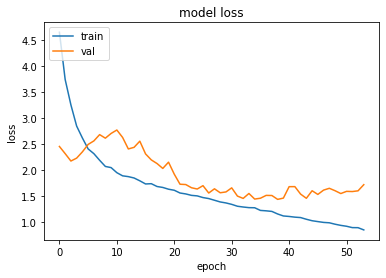

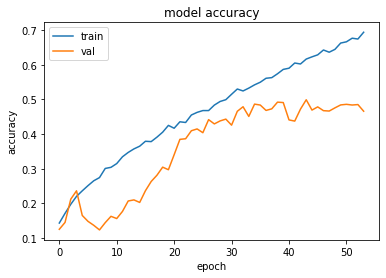

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.4333730936050415 , and Val Acc happened to be 0.49230000376701355
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.4991999864578247 and Val Loss happened to be  1.454209804534912
TestLoss:  1.4174525737762451  TestAcc: 0.49129998683929443
frog 0.722
airplane 0.596
ship 0.56
horse 0.555
automobile 0.535
truck 0.489
dog 0.456
deer 0.36
bird 0.352
cat 0.288


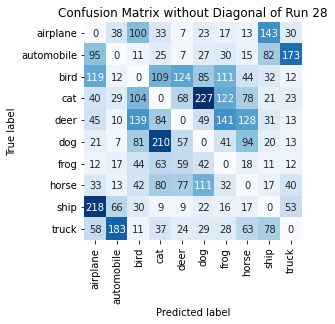

Summing down the rows, for Predictions of each Class that were wrong:  [641. 375. 562. 650. 432. 615. 538. 470. 435. 369.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  124.0 times
Summing across the columns, for total number of that True Class misidentified:  [404. 465. 648. 712. 640. 544. 278. 445. 440. 511.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  141.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


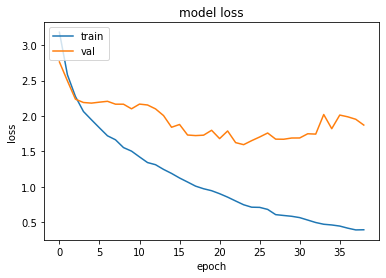

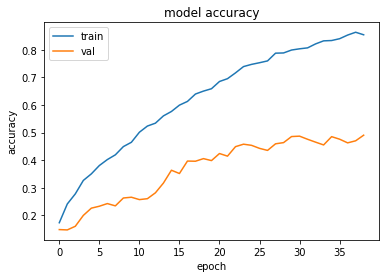

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5953176021575928 , and Val Acc happened to be 0.4577000141143799
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.4902999997138977 and Val Loss happened to be  1.8718314170837402
TestLoss:  1.5622167587280273  TestAcc: 0.45969998836517334
frog 0.625
ship 0.603
deer 0.568
truck 0.524
airplane 0.501
automobile 0.48
dog 0.458
horse 0.329
bird 0.321
cat 0.188


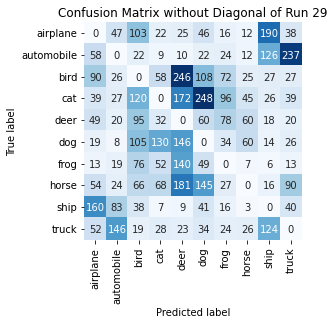

Summing down the rows, for Predictions of each Class that were wrong:  [534. 400. 644. 406. 952. 753. 387. 250. 547. 530.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  246.0 times
Summing across the columns, for total number of that True Class misidentified:  [499. 520. 679. 812. 432. 542. 375. 671. 397. 476.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  95.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise: 

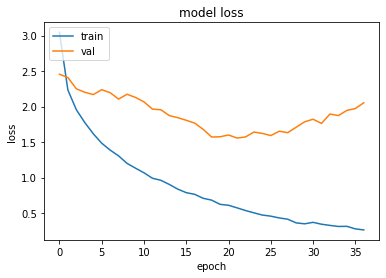

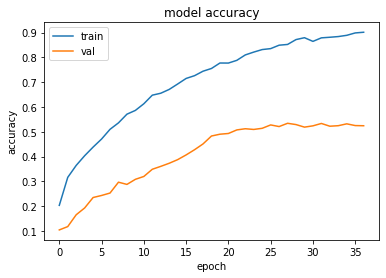

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5574381351470947 , and Val Acc happened to be 0.5076000094413757
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5343000292778015 and Val Loss happened to be  1.632877230644226
TestLoss:  1.5262763500213623  TestAcc: 0.510200023651123
frog 0.83
ship 0.71
automobile 0.617
horse 0.56
airplane 0.521
deer 0.519
dog 0.473
truck 0.444
bird 0.228
cat 0.2


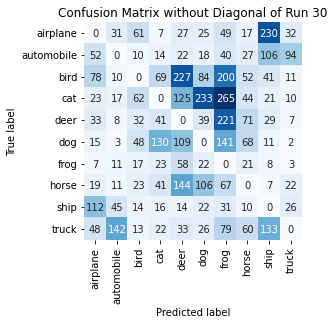

Summing down the rows, for Predictions of each Class that were wrong:  [ 387.  278.  280.  363.  759.  575. 1093.  370.  586.  207.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  227.0 times
Summing across the columns, for total number of that True Class misidentified:  [479. 383. 772. 800. 481. 527. 170. 440. 290. 556.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  221.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

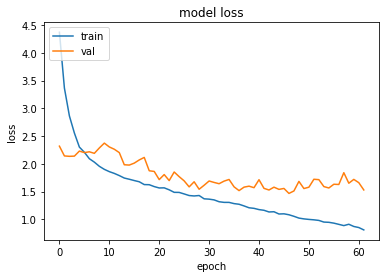

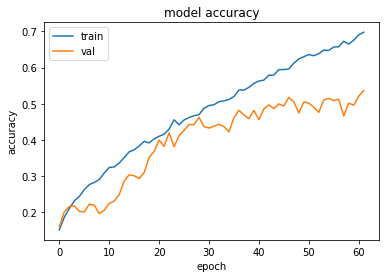

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  46 when  Val Loss was:  1.4680410623550415 , and Val Acc happened to be 0.5177000164985657
Additionally, the best val acc epoch happened to be  61 when val acc was:  0.536300003528595 and Val Loss happened to be  1.5307472944259644
TestLoss:  1.4316433668136597  TestAcc: 0.5160999894142151
frog 0.827
ship 0.689
horse 0.564
truck 0.548
automobile 0.538
airplane 0.493
dog 0.484
bird 0.438
deer 0.357
cat 0.223


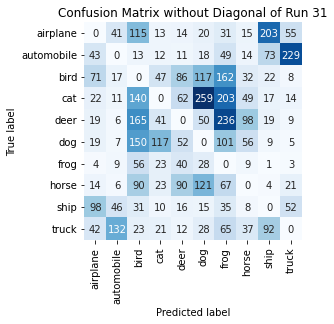

Summing down the rows, for Predictions of each Class that were wrong:  [332. 275. 783. 307. 383. 656. 949. 318. 440. 396.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  90.0 times
Summing across the columns, for total number of that True Class misidentified:  [507. 462. 562. 777. 643. 516. 173. 436. 311. 452.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  236.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

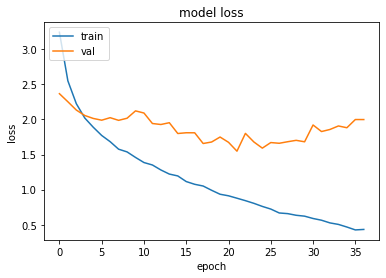

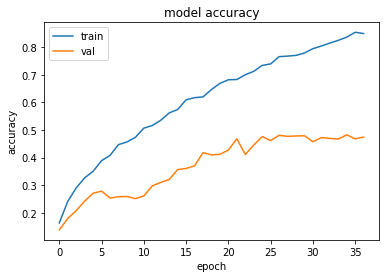

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5478907823562622 , and Val Acc happened to be 0.46810001134872437
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.48249998688697815 and Val Loss happened to be  1.8817983865737915
TestLoss:  1.5209614038467407  TestAcc: 0.4738999903202057
deer 0.702
frog 0.668
ship 0.628
truck 0.572
automobile 0.546
airplane 0.439
horse 0.437
dog 0.379
cat 0.203
bird 0.165


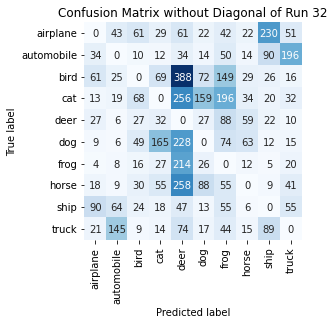

Summing down the rows, for Predictions of each Class that were wrong:  [ 277.  325.  294.  421. 1560.  438.  753.  254.  503.  436.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  388.0 times
Summing across the columns, for total number of that True Class misidentified:  [561. 454. 835. 797. 298. 621. 332. 563. 372. 428.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  88.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

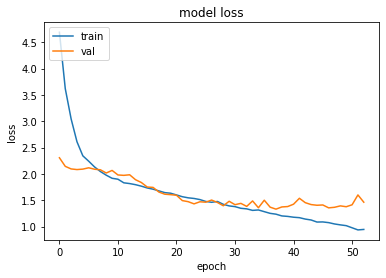

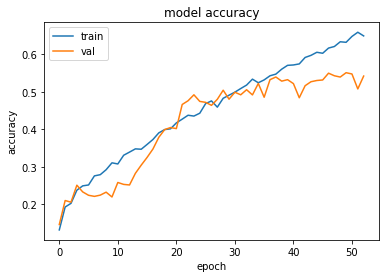

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.3301604986190796 , and Val Acc happened to be 0.5396999716758728
Additionally, the best val acc epoch happened to be  49 when val acc was:  0.5511999726295471 and Val Loss happened to be  1.3759958744049072
TestLoss:  1.3172523975372314  TestAcc: 0.5350000262260437
frog 0.672
truck 0.669
automobile 0.662
ship 0.642
horse 0.634
dog 0.581
deer 0.477
airplane 0.394
cat 0.323
bird 0.296


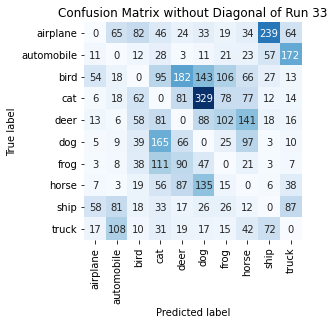

Summing down the rows, for Predictions of each Class that were wrong:  [174. 316. 338. 646. 569. 829. 407. 513. 437. 421.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [606. 338. 704. 677. 523. 419. 328. 366. 358. 331.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  141.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

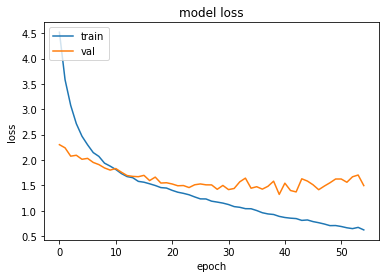

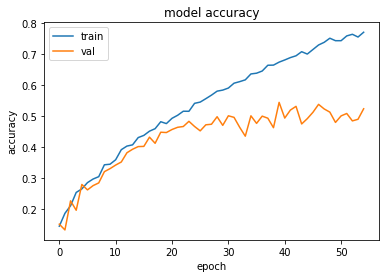

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.321151852607727 , and Val Acc happened to be 0.5440999865531921
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.5440999865531921 and Val Loss happened to be  1.321151852607727
TestLoss:  1.3015867471694946  TestAcc: 0.5404999852180481
ship 0.719
truck 0.715
horse 0.683
frog 0.668
automobile 0.631
dog 0.533
airplane 0.47
deer 0.429
cat 0.404
bird 0.153


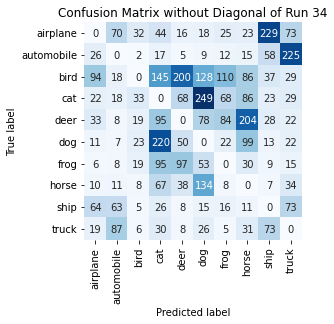

Summing down the rows, for Predictions of each Class that were wrong:  [285. 290. 147. 739. 490. 710. 350. 585. 477. 522.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  200.0 times
Summing across the columns, for total number of that True Class misidentified:  [530. 369. 847. 596. 571. 467. 332. 317. 281. 285.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  204.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

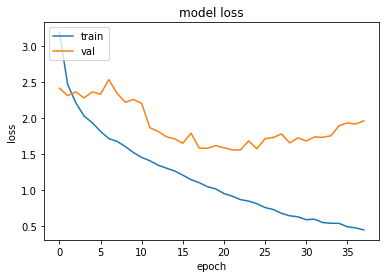

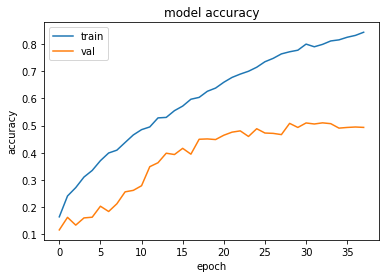

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5551390647888184 , and Val Acc happened to be 0.4805000126361847
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5099999904632568 and Val Loss happened to be  1.7313835620880127
TestLoss:  1.523072600364685  TestAcc: 0.48669999837875366
frog 0.757
ship 0.642
airplane 0.55
dog 0.518
automobile 0.448
deer 0.439
truck 0.435
horse 0.423
cat 0.335
bird 0.32


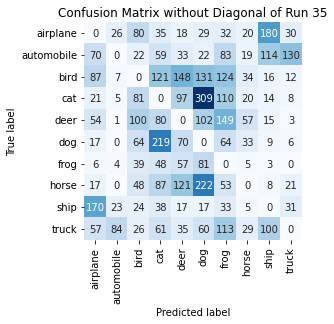

Summing down the rows, for Predictions of each Class that were wrong:  [499. 150. 484. 748. 596. 973. 761. 222. 459. 241.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  148.0 times
Summing across the columns, for total number of that True Class misidentified:  [450. 552. 680. 665. 561. 482. 243. 577. 358. 565.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  149.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

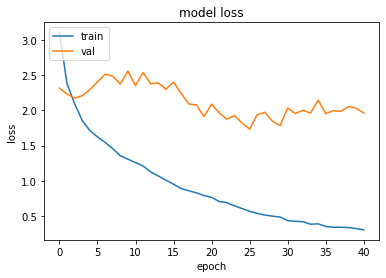

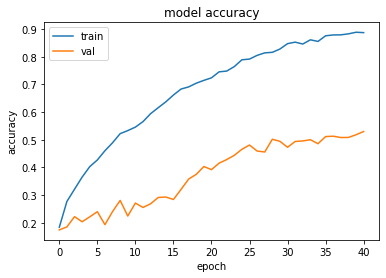

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.7324978113174438 , and Val Acc happened to be 0.48100000619888306
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5299000144004822 and Val Loss happened to be  1.9613288640975952
TestLoss:  1.7035003900527954  TestAcc: 0.4830999970436096
ship 0.818
frog 0.787
automobile 0.607
bird 0.492
airplane 0.459
truck 0.403
horse 0.386
cat 0.311
deer 0.289
dog 0.279


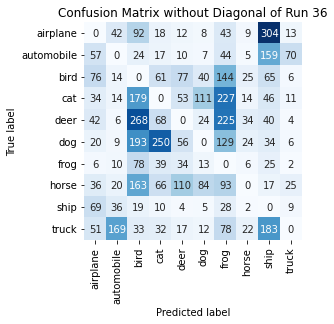

Summing down the rows, for Predictions of each Class that were wrong:  [ 391.  320. 1049.  561.  373.  304. 1011.  141.  873.  146.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  110.0 times
Summing across the columns, for total number of that True Class misidentified:  [541. 393. 508. 689. 711. 721. 213. 614. 182. 597.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  268.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

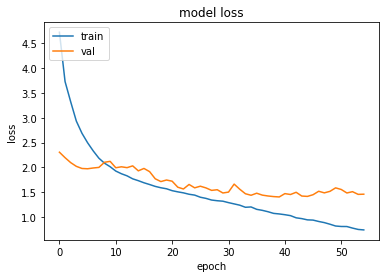

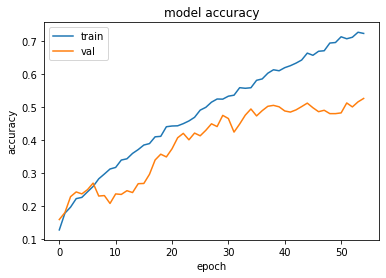

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.4065062999725342 , and Val Acc happened to be 0.5011000037193298
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.5264999866485596 and Val Loss happened to be  1.4618862867355347
TestLoss:  1.3916661739349365  TestAcc: 0.5019000172615051
frog 0.759
automobile 0.68
ship 0.641
dog 0.565
truck 0.53
airplane 0.511
bird 0.5
horse 0.405
cat 0.28
deer 0.148


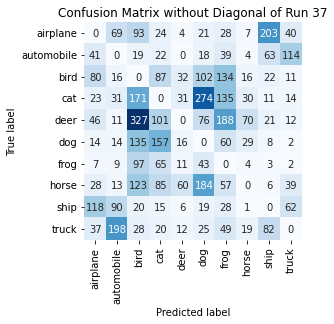

Summing down the rows, for Predictions of each Class that were wrong:  [ 394.  451. 1013.  576.  172.  762.  718.  180.  419.  296.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  60.0 times
Summing across the columns, for total number of that True Class misidentified:  [489. 320. 500. 720. 852. 435. 241. 595. 359. 470.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  327.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 ,

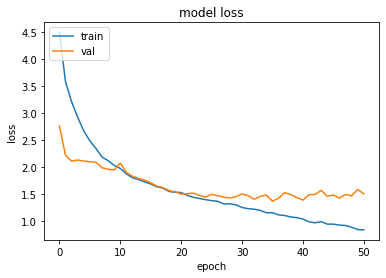

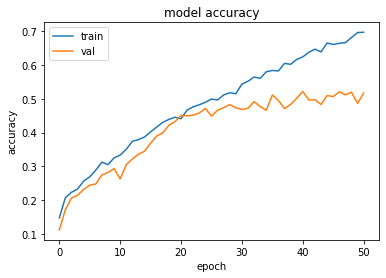

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.3670239448547363 , and Val Acc happened to be 0.5116000175476074
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5218999981880188 and Val Loss happened to be  1.3886022567749023
TestLoss:  1.3308415412902832  TestAcc: 0.5198000073432922
horse 0.75
frog 0.693
ship 0.662
truck 0.661
automobile 0.606
deer 0.494
dog 0.448
airplane 0.432
bird 0.284
cat 0.168


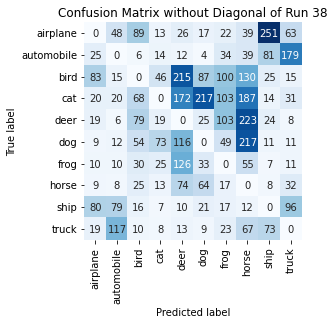

Summing down the rows, for Predictions of each Class that were wrong:  [274. 315. 377. 218. 764. 477. 468. 969. 494. 446.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  215.0 times
Summing across the columns, for total number of that True Class misidentified:  [568. 394. 716. 832. 506. 552. 307. 250. 338. 339.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  223.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
N

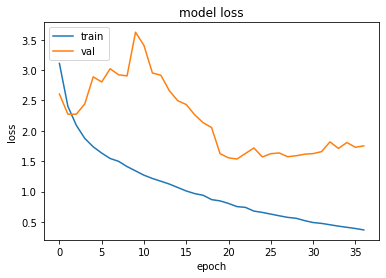

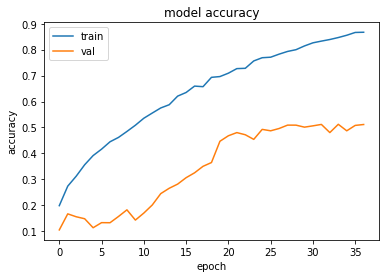

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.534859299659729 , and Val Acc happened to be 0.48019999265670776
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5121999979019165 and Val Loss happened to be  1.7097822427749634
TestLoss:  1.5028342008590698  TestAcc: 0.486299991607666
ship 0.786
frog 0.764
automobile 0.562
truck 0.547
bird 0.46
airplane 0.391
horse 0.384
deer 0.369
dog 0.356
cat 0.244


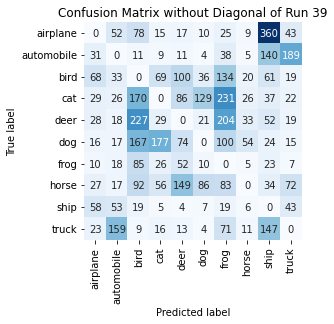

Summing down the rows, for Predictions of each Class that were wrong:  [290. 393. 858. 402. 506. 307. 905. 169. 878. 429.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  149.0 times
Summing across the columns, for total number of that True Class misidentified:  [609. 438. 540. 756. 631. 644. 236. 616. 214. 453.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  227.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

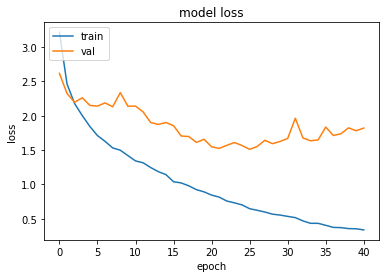

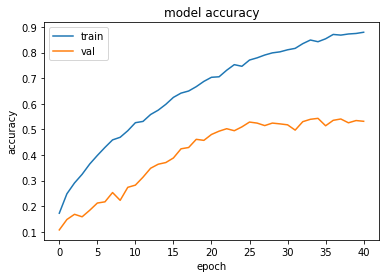

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5101946592330933 , and Val Acc happened to be 0.5285000205039978
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5429999828338623 and Val Loss happened to be  1.6476398706436157
TestLoss:  1.4815926551818848  TestAcc: 0.5346999764442444
ship 0.748
frog 0.72
automobile 0.68
truck 0.622
airplane 0.519
deer 0.488
horse 0.465
cat 0.401
dog 0.368
bird 0.336


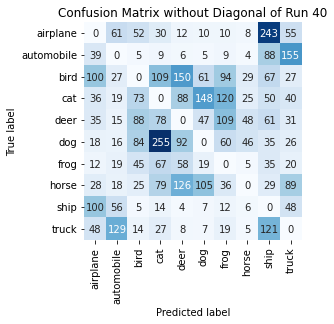

Summing down the rows, for Predictions of each Class that were wrong:  [416. 360. 391. 668. 544. 409. 469. 176. 729. 491.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  150.0 times
Summing across the columns, for total number of that True Class misidentified:  [481. 320. 664. 599. 512. 632. 280. 535. 252. 378.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  109.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )


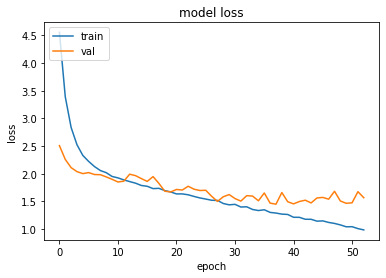

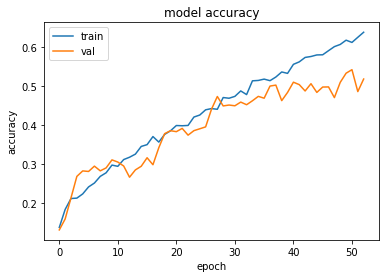

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  37 when  Val Loss was:  1.4503239393234253 , and Val Acc happened to be 0.5026000142097473
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5422999858856201 and Val Loss happened to be  1.4752627611160278
TestLoss:  1.432255744934082  TestAcc: 0.49799999594688416
frog 0.837
ship 0.781
automobile 0.614
horse 0.593
truck 0.497
deer 0.489
airplane 0.438
dog 0.345
cat 0.2
bird 0.186


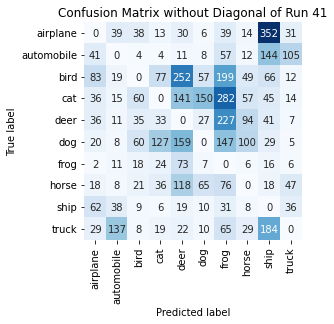

Summing down the rows, for Predictions of each Class that were wrong:  [ 327.  286.  253.  339.  825.  340. 1123.  369.  895.  263.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  252.0 times
Summing across the columns, for total number of that True Class misidentified:  [562. 386. 814. 800. 511. 655. 163. 407. 219. 503.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  227.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

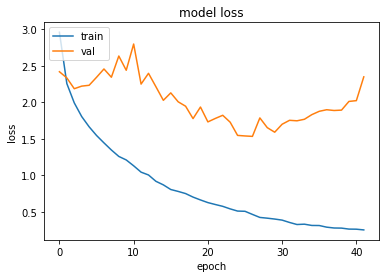

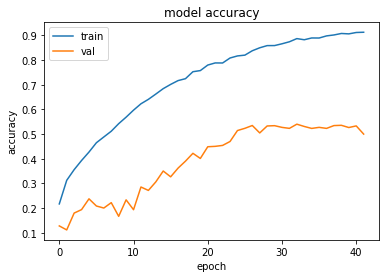

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.5318893194198608 , and Val Acc happened to be 0.5347999930381775
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5401999950408936 and Val Loss happened to be  1.745217204093933
TestLoss:  1.5260674953460693  TestAcc: 0.5318999886512756
ship 0.734
frog 0.713
automobile 0.602
truck 0.526
airplane 0.518
dog 0.509
horse 0.496
deer 0.491
cat 0.366
bird 0.364


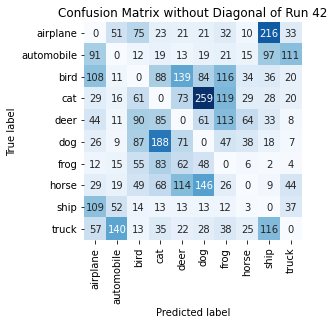

Summing down the rows, for Predictions of each Class that were wrong:  [505. 324. 456. 602. 528. 679. 524. 224. 555. 284.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [482. 398. 636. 634. 509. 491. 287. 504. 266. 474.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  113.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

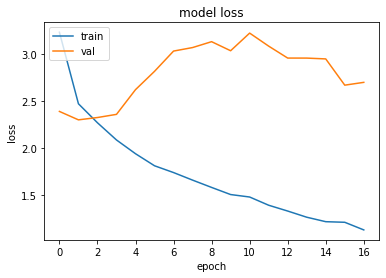

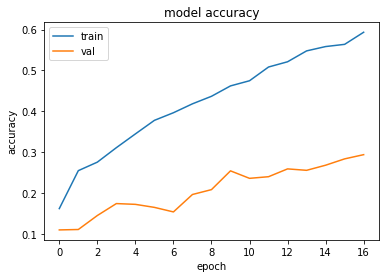

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  2.2971253395080566 , and Val Acc happened to be 0.11110000312328339
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.29409998655319214 and Val Loss happened to be  2.6963791847229004
TestLoss:  2.294499397277832  TestAcc: 0.11219999939203262
airplane 0.95
ship 0.069
frog 0.044
bird 0.029
dog 0.018
deer 0.007
automobile 0.004
cat 0.001
horse 0.0
truck 0.0


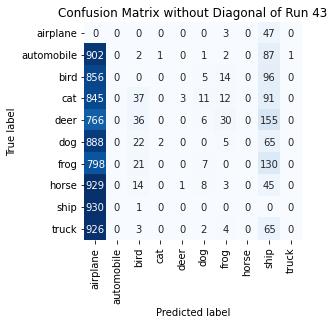

Summing down the rows, for Predictions of each Class that were wrong:  [7.84e+03 0.00e+00 1.36e+02 3.00e+00 4.00e+00 4.00e+01 7.30e+01 0.00e+00
 7.81e+02 1.00e+00]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  3.0 times
Summing across the columns, for total number of that True Class misidentified:  [  50.  996.  971.  999.  993.  982.  956. 1000.  931. 1000.]
For example, the model misclassified true 4's (deer) as label   0 airplane  a total of  766.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )

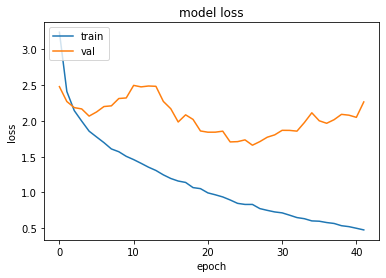

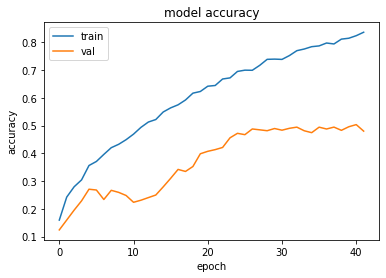

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.660280466079712 , and Val Acc happened to be 0.4875999987125397
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5033000111579895 and Val Loss happened to be  2.0494370460510254
TestLoss:  1.6298996210098267  TestAcc: 0.48899999260902405
ship 0.731
frog 0.699
truck 0.605
dog 0.554
automobile 0.536
horse 0.433
airplane 0.382
deer 0.379
cat 0.287
bird 0.284


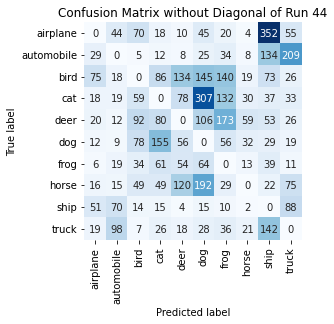

Summing down the rows, for Predictions of each Class that were wrong:  [246. 304. 408. 502. 482. 927. 630. 188. 881. 542.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  134.0 times
Summing across the columns, for total number of that True Class misidentified:  [618. 464. 716. 713. 621. 446. 301. 567. 269. 395.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  173.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

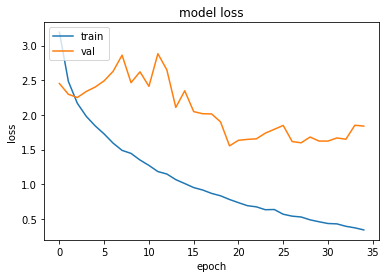

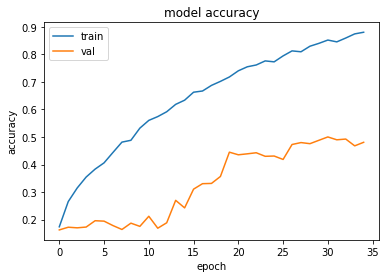

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.5530544519424438 , and Val Acc happened to be 0.4447999894618988
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5001999735832214 and Val Loss happened to be  1.6219120025634766
TestLoss:  1.5251799821853638  TestAcc: 0.45010000467300415
frog 0.87
ship 0.727
truck 0.531
automobile 0.432
deer 0.388
cat 0.359
airplane 0.355
horse 0.342
dog 0.296
bird 0.201


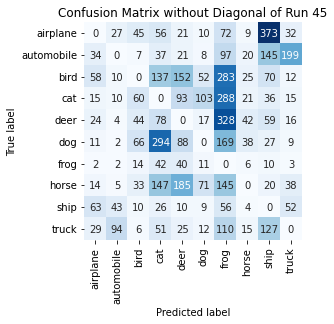

Summing down the rows, for Predictions of each Class that were wrong:  [ 250.  197.  285.  868.  635.  293. 1548.  180.  867.  376.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  185.0 times
Summing across the columns, for total number of that True Class misidentified:  [645. 568. 799. 641. 612. 704. 130. 658. 273. 469.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  328.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

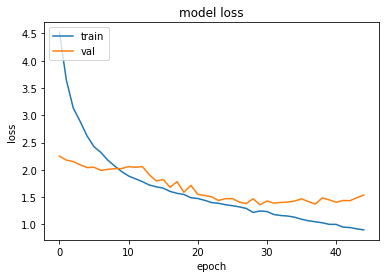

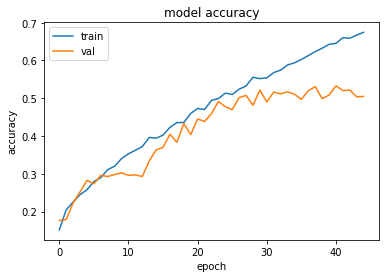

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.3584941625595093 , and Val Acc happened to be 0.5217000246047974
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5329999923706055 and Val Loss happened to be  1.4051376581192017
TestLoss:  1.3284711837768555  TestAcc: 0.5220999717712402
frog 0.727
ship 0.726
truck 0.639
automobile 0.591
horse 0.554
dog 0.486
airplane 0.446
deer 0.374
bird 0.353
cat 0.325


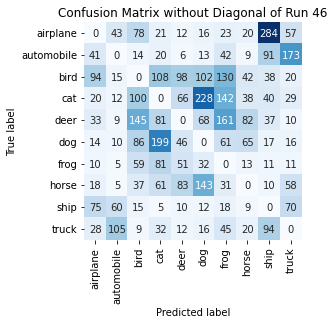

Summing down the rows, for Predictions of each Class that were wrong:  [333. 264. 543. 608. 384. 630. 653. 298. 622. 444.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  98.0 times
Summing across the columns, for total number of that True Class misidentified:  [554. 409. 647. 675. 626. 514. 273. 446. 274. 361.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  161.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0

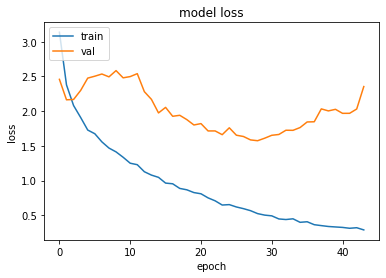

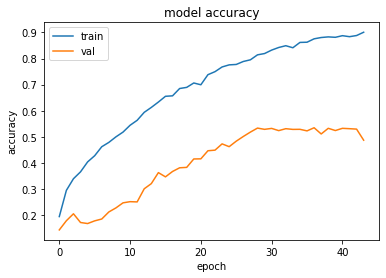

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.5739885568618774 , and Val Acc happened to be 0.5333999991416931
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5346999764442444 and Val Loss happened to be  1.847000241279602
TestLoss:  1.5440913438796997  TestAcc: 0.538100004196167
ship 0.729
frog 0.686
automobile 0.653
dog 0.634
truck 0.632
horse 0.539
airplane 0.51
deer 0.459
bird 0.36
cat 0.179


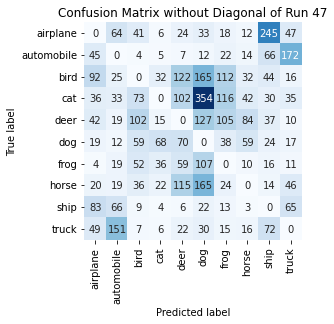

Summing down the rows, for Predictions of each Class that were wrong:  [ 390.  408.  383.  194.  527. 1015.  463.  272.  548.  419.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  122.0 times
Summing across the columns, for total number of that True Class misidentified:  [490. 347. 640. 821. 541. 366. 314. 461. 271. 368.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  127.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 

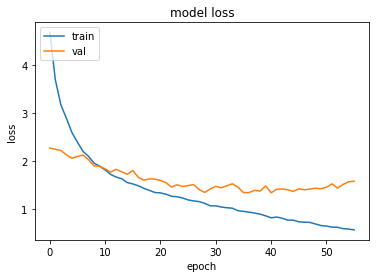

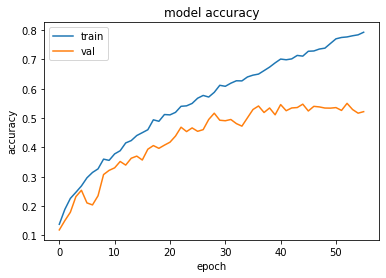

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3447803258895874 , and Val Acc happened to be 0.5461000204086304
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5503000020980835 and Val Loss happened to be  1.4439623355865479
TestLoss:  1.32676362991333  TestAcc: 0.5440999865531921
frog 0.789
ship 0.748
truck 0.726
horse 0.626
automobile 0.528
dog 0.489
airplane 0.431
deer 0.426
cat 0.391
bird 0.287


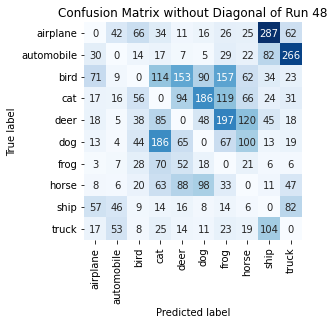

Summing down the rows, for Predictions of each Class that were wrong:  [234. 188. 283. 608. 500. 480. 665. 441. 606. 554.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  153.0 times
Summing across the columns, for total number of that True Class misidentified:  [569. 472. 713. 609. 574. 511. 211. 374. 252. 274.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  197.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

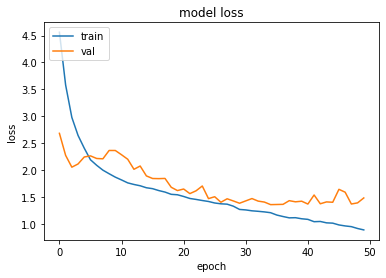

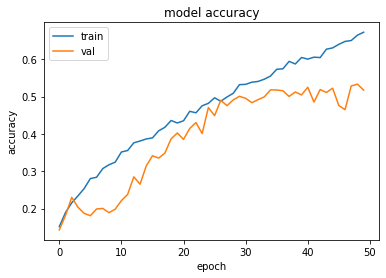

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3607326745986938 , and Val Acc happened to be 0.5181000232696533
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5333999991416931 and Val Loss happened to be  1.393289566040039
TestLoss:  1.3343969583511353  TestAcc: 0.5235000252723694
frog 0.75
truck 0.663
automobile 0.631
ship 0.618
horse 0.544
dog 0.539
airplane 0.505
deer 0.452
cat 0.276
bird 0.257


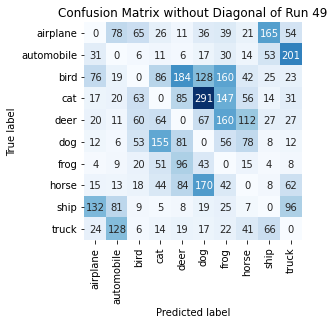

Summing down the rows, for Predictions of each Class that were wrong:  [331. 365. 300. 456. 574. 788. 681. 386. 370. 514.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [495. 369. 743. 724. 548. 461. 250. 456. 382. 337.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  160.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

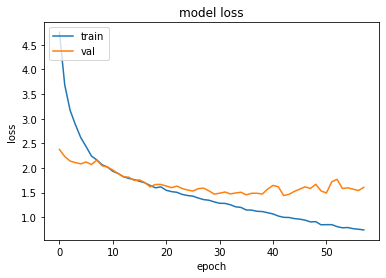

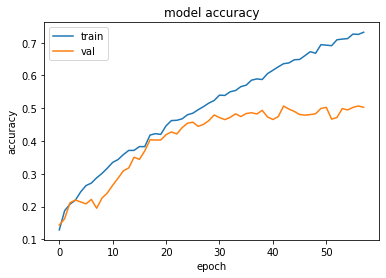

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  42 when  Val Loss was:  1.4409810304641724 , and Val Acc happened to be 0.5065000057220459
Additionally, the best val acc epoch happened to be  56 when val acc was:  0.5069000124931335 and Val Loss happened to be  1.5422618389129639
TestLoss:  1.439261794090271  TestAcc: 0.503600001335144
ship 0.693
frog 0.69
airplane 0.581
automobile 0.578
horse 0.553
truck 0.464
deer 0.443
dog 0.413
bird 0.367
cat 0.254


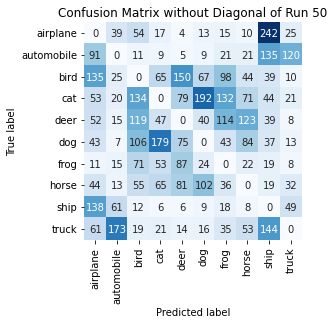

Summing down the rows, for Predictions of each Class that were wrong:  [628. 368. 581. 462. 501. 472. 512. 436. 718. 286.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  150.0 times
Summing across the columns, for total number of that True Class misidentified:  [419. 422. 633. 746. 557. 587. 310. 447. 307. 536.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  123.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Fri, 12 November 2021 01:55:25  (subtract ~5-hours for local Hour), and file is called  runs_GroupI_final.pkl


In [ ]:
#@title Group I: 51 Run Results
run_through_runs(ds=make_unbatched(train_I),   ds_noalb=train_I_noalb,   dstitle="I" , showpictures= False)

filename will be:  runs_GroupJ .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


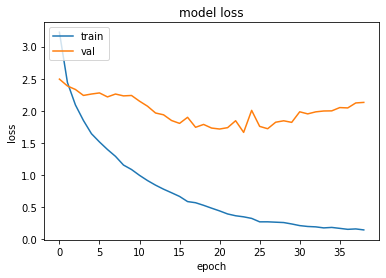

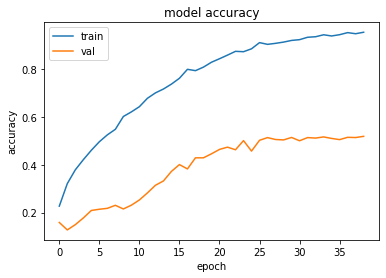

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6615327596664429 , and Val Acc happened to be 0.5008999705314636
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5188000202178955 and Val Loss happened to be  2.129521131515503
TestLoss:  1.637627124786377  TestAcc: 0.4959000051021576
frog 0.754
ship 0.752
automobile 0.588
truck 0.526
horse 0.519
airplane 0.51
deer 0.404
cat 0.382
dog 0.27
bird 0.254


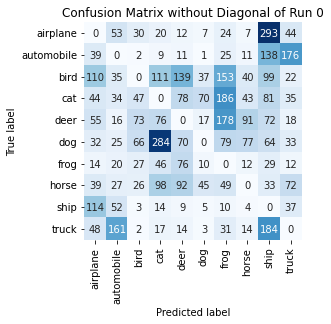

Summing down the rows, for Predictions of each Class that were wrong:  [495. 423. 276. 675. 501. 195. 735. 299. 993. 449.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [490. 412. 746. 618. 596. 730. 246. 481. 248. 474.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  178.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0

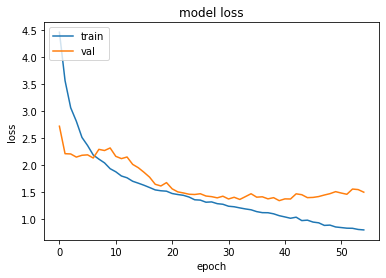

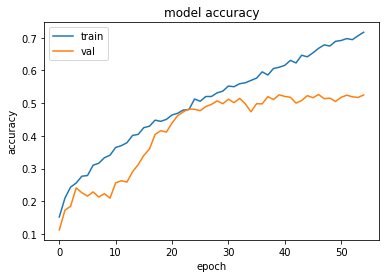

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.3367128372192383 , and Val Acc happened to be 0.5253999829292297
Additionally, the best val acc epoch happened to be  46 when val acc was:  0.5264000296592712 and Val Loss happened to be  1.4125882387161255
TestLoss:  1.3150297403335571  TestAcc: 0.5268999934196472
frog 0.683
automobile 0.64
truck 0.612
airplane 0.586
ship 0.586
horse 0.513
bird 0.474
dog 0.466
deer 0.454
cat 0.255


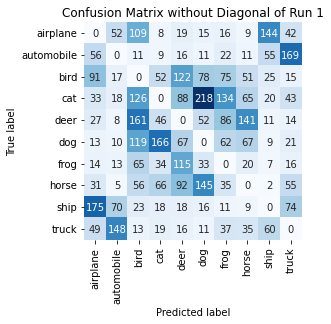

Summing down the rows, for Predictions of each Class that were wrong:  [489. 341. 683. 418. 553. 579. 478. 408. 333. 449.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  122.0 times
Summing across the columns, for total number of that True Class misidentified:  [414. 360. 526. 745. 546. 534. 317. 487. 414. 388.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  161.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0

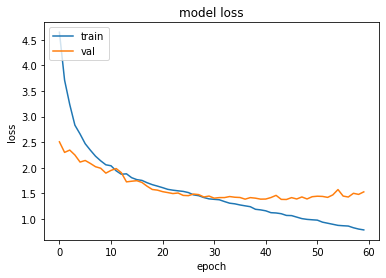

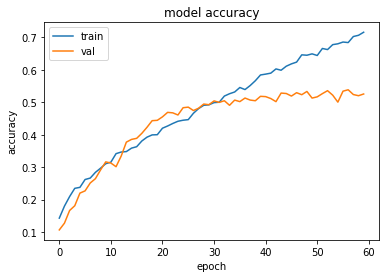

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  44 when  Val Loss was:  1.3830304145812988 , and Val Acc happened to be 0.5268999934196472
Additionally, the best val acc epoch happened to be  56 when val acc was:  0.5383999943733215 and Val Loss happened to be  1.4312397241592407
TestLoss:  1.3427186012268066  TestAcc: 0.5249000191688538
ship 0.693
automobile 0.666
horse 0.608
frog 0.605
truck 0.538
dog 0.532
airplane 0.513
deer 0.386
cat 0.379
bird 0.329


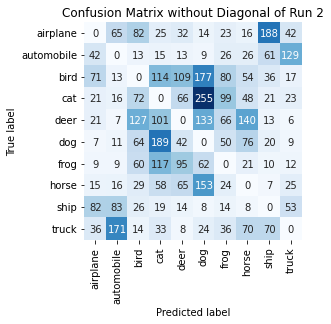

Summing down the rows, for Predictions of each Class that were wrong:  [304. 391. 487. 671. 444. 835. 418. 459. 426. 316.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [487. 334. 671. 621. 614. 468. 395. 392. 307. 462.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  140.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Brig

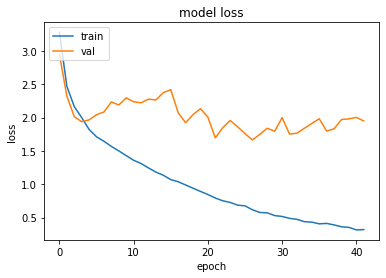

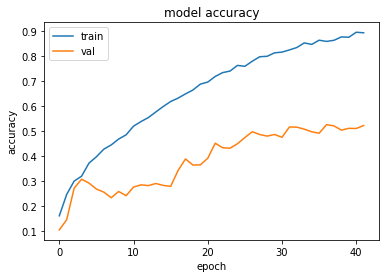

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.664466381072998 , and Val Acc happened to be 0.4973999857902527
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.525600016117096 and Val Loss happened to be  1.796723484992981
TestLoss:  1.6383225917816162  TestAcc: 0.5023999810218811
frog 0.749
deer 0.662
truck 0.646
ship 0.579
automobile 0.557
horse 0.547
airplane 0.459
dog 0.309
cat 0.266
bird 0.25


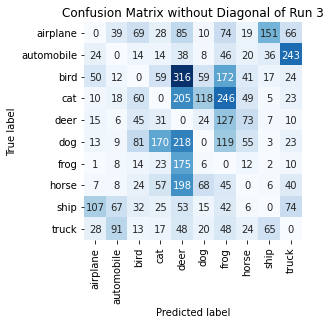

Summing down the rows, for Predictions of each Class that were wrong:  [ 255.  258.  352.  424. 1336.  328.  919.  299.  292.  513.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  316.0 times
Summing across the columns, for total number of that True Class misidentified:  [541. 443. 750. 734. 338. 691. 251. 453. 421. 354.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  127.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

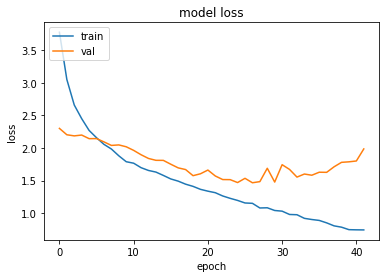

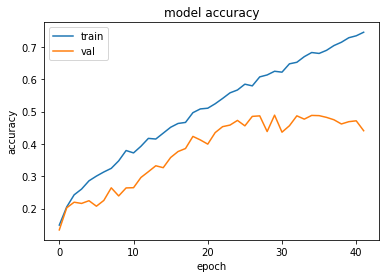

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.4661387205123901 , and Val Acc happened to be 0.4853000044822693
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.48910000920295715 and Val Loss happened to be  1.4769296646118164
TestLoss:  1.4615025520324707  TestAcc: 0.4812999963760376
frog 0.713
ship 0.711
truck 0.558
bird 0.473
airplane 0.461
automobile 0.431
horse 0.427
deer 0.365
dog 0.354
cat 0.32


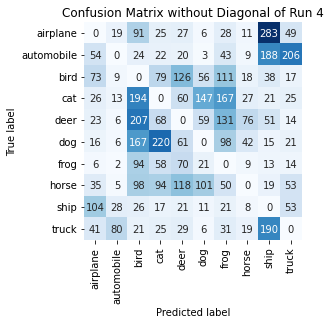

Summing down the rows, for Predictions of each Class that were wrong:  [378. 168. 922. 608. 532. 410. 680. 219. 818. 452.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  126.0 times
Summing across the columns, for total number of that True Class misidentified:  [539. 569. 527. 680. 635. 646. 287. 573. 289. 442.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  207.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   (

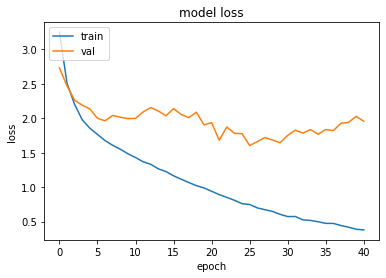

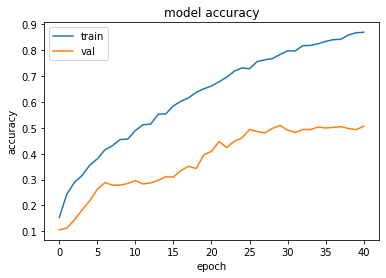

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6049572229385376 , and Val Acc happened to be 0.49399998784065247
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5095000267028809 and Val Loss happened to be  1.6449782848358154
TestLoss:  1.583929181098938  TestAcc: 0.490200012922287
frog 0.733
ship 0.666
deer 0.643
automobile 0.611
truck 0.477
airplane 0.474
cat 0.397
horse 0.376
dog 0.279
bird 0.246


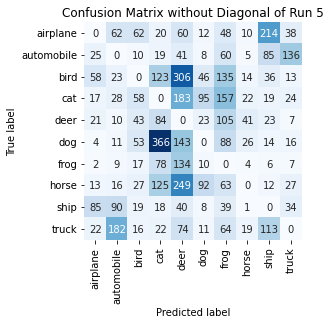

Summing down the rows, for Predictions of each Class that were wrong:  [ 247.  431.  305.  855. 1230.  305.  759.  142.  522.  302.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  306.0 times
Summing across the columns, for total number of that True Class misidentified:  [526. 389. 754. 603. 357. 721. 267. 624. 334. 523.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  105.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 0

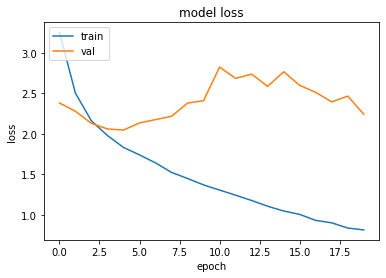

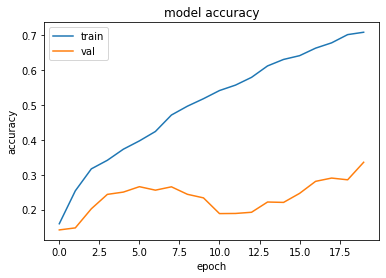

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  2.047365665435791 , and Val Acc happened to be 0.25040000677108765
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.3359000086784363 and Val Loss happened to be  2.243473529815674
TestLoss:  2.0375900268554688  TestAcc: 0.25780001282691956
ship 0.802
deer 0.645
cat 0.368
frog 0.235
airplane 0.222
bird 0.115
dog 0.078
horse 0.058
truck 0.037
automobile 0.018


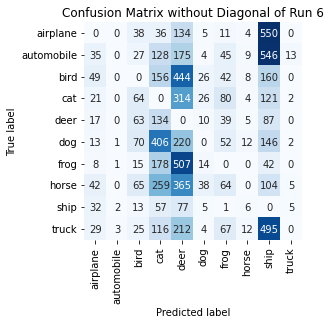

Summing down the rows, for Predictions of each Class that were wrong:  [ 246.    7.  380. 1470. 2448.  132.  401.   60. 2251.   27.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  507.0 times
Summing across the columns, for total number of that True Class misidentified:  [778. 982. 885. 632. 355. 922. 765. 942. 198. 963.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  134.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.0 , 

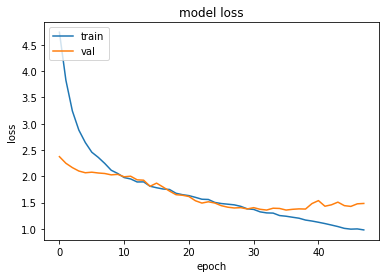

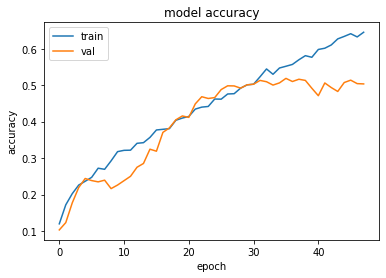

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.3585994243621826 , and Val Acc happened to be 0.5094000101089478
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5185999870300293 and Val Loss happened to be  1.3586491346359253
TestLoss:  1.337396264076233  TestAcc: 0.5123000144958496
frog 0.74
ship 0.692
automobile 0.628
truck 0.622
horse 0.606
dog 0.49
deer 0.445
airplane 0.351
cat 0.303
bird 0.246


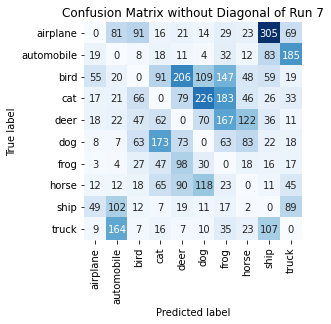

Summing down the rows, for Predictions of each Class that were wrong:  [190. 433. 339. 495. 604. 592. 696. 377. 665. 486.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  206.0 times
Summing across the columns, for total number of that True Class misidentified:  [649. 372. 754. 697. 555. 510. 260. 394. 308. 378.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  167.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0

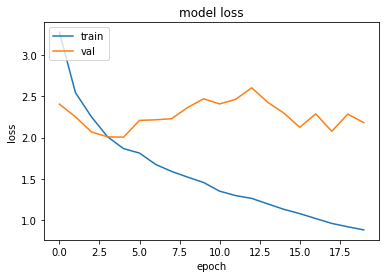

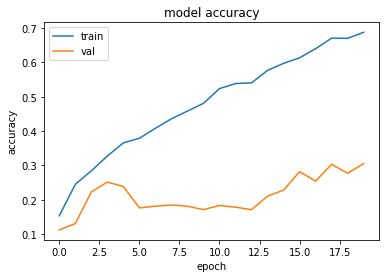

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  2.004918336868286 , and Val Acc happened to be 0.23849999904632568
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.305400013923645 and Val Loss happened to be  2.181168794631958
TestLoss:  1.9925323724746704  TestAcc: 0.23669999837875366
frog 0.91
ship 0.546
deer 0.174
cat 0.172
airplane 0.16
truck 0.139
dog 0.136
bird 0.058
horse 0.044
automobile 0.028


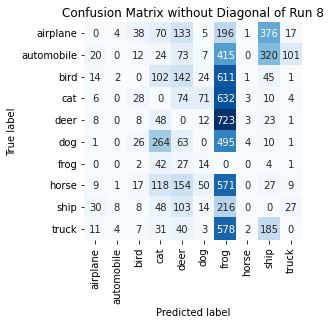

Summing down the rows, for Predictions of each Class that were wrong:  [  99.   19.  146.  747.  809.  200. 4437.   14. 1000.  162.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  154.0 times
Summing across the columns, for total number of that True Class misidentified:  [840. 972. 942. 828. 826. 864.  90. 956. 454. 861.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  723.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Contr

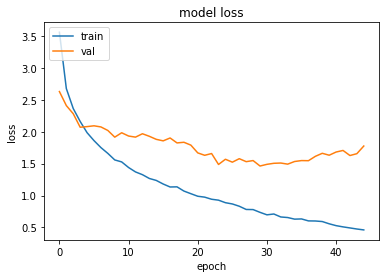

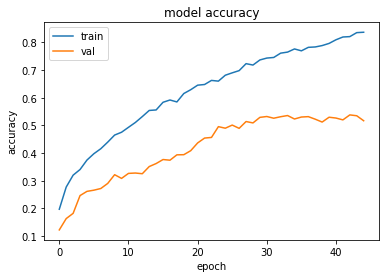

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.4624842405319214 , and Val Acc happened to be 0.5289999842643738
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5378999710083008 and Val Loss happened to be  1.6268799304962158
TestLoss:  1.4403462409973145  TestAcc: 0.5217000246047974
ship 0.739
frog 0.735
automobile 0.617
truck 0.544
airplane 0.53
deer 0.525
horse 0.513
dog 0.388
bird 0.328
cat 0.298


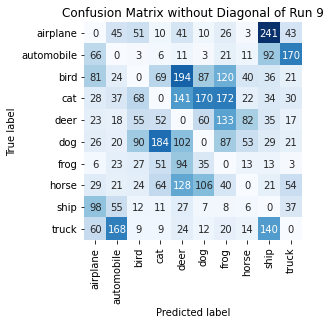

Summing down the rows, for Predictions of each Class that were wrong:  [417. 411. 339. 456. 762. 490. 627. 244. 641. 396.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  194.0 times
Summing across the columns, for total number of that True Class misidentified:  [470. 383. 672. 702. 475. 612. 265. 487. 261. 456.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  133.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

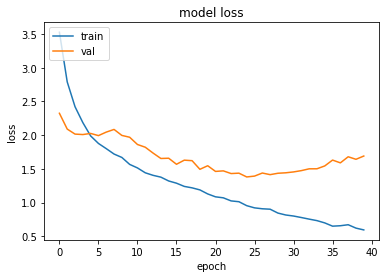

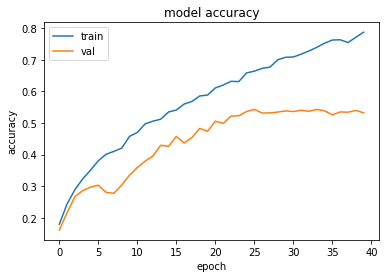

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.3801573514938354 , and Val Acc happened to be 0.5364000201225281
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.542900025844574 and Val Loss happened to be  1.3927525281906128
TestLoss:  1.3401589393615723  TestAcc: 0.5410000085830688
ship 0.768
frog 0.668
automobile 0.632
horse 0.588
truck 0.579
bird 0.478
dog 0.474
airplane 0.466
deer 0.448
cat 0.309


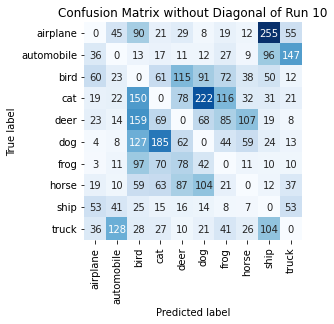

Summing down the rows, for Predictions of each Class that were wrong:  [253. 302. 748. 528. 486. 582. 433. 301. 601. 356.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  115.0 times
Summing across the columns, for total number of that True Class misidentified:  [534. 368. 522. 691. 552. 526. 332. 412. 232. 421.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  159.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

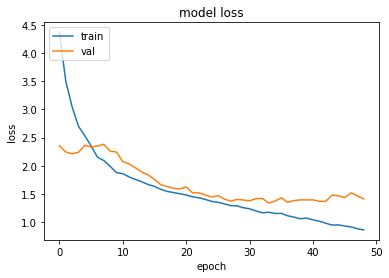

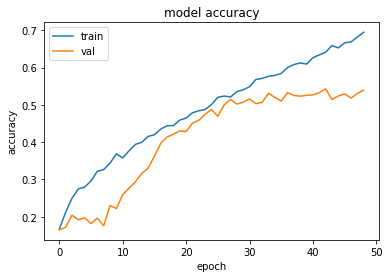

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3425852060317993 , and Val Acc happened to be 0.5310999751091003
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.542900025844574 and Val Loss happened to be  1.371593952178955
TestLoss:  1.2993189096450806  TestAcc: 0.5393999814987183
frog 0.779
automobile 0.676
airplane 0.645
horse 0.627
truck 0.596
dog 0.55
ship 0.544
deer 0.417
bird 0.303
cat 0.257


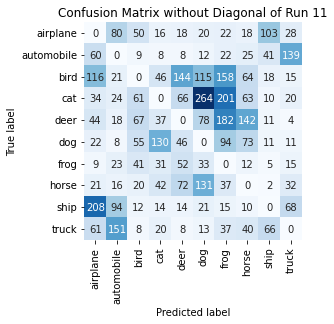

Summing down the rows, for Predictions of each Class that were wrong:  [575. 435. 323. 344. 428. 687. 768. 447. 267. 332.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  144.0 times
Summing across the columns, for total number of that True Class misidentified:  [355. 324. 697. 743. 583. 450. 221. 373. 456. 404.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  182.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.16 , 0.16 

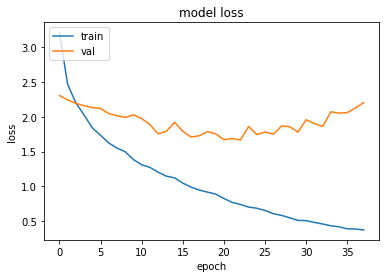

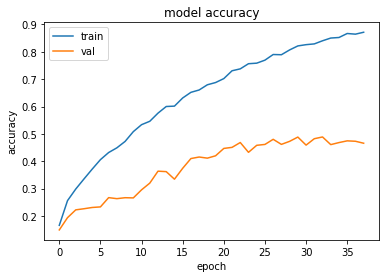

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.6673814058303833 , and Val Acc happened to be 0.46860000491142273
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.48890000581741333 and Val Loss happened to be  1.8628648519515991
TestLoss:  1.6274194717407227  TestAcc: 0.47350001335144043
frog 0.801
ship 0.758
deer 0.552
automobile 0.488
truck 0.485
airplane 0.426
horse 0.341
dog 0.305
cat 0.29
bird 0.289


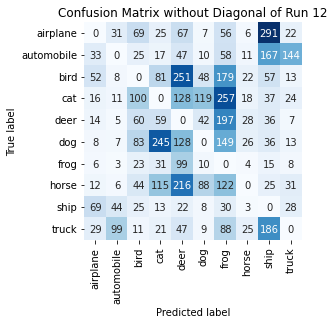

Summing down the rows, for Predictions of each Class that were wrong:  [ 239.  214.  440.  607. 1005.  341. 1136.  143.  850.  290.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  251.0 times
Summing across the columns, for total number of that True Class misidentified:  [574. 512. 711. 710. 448. 695. 199. 659. 242. 515.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  197.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.

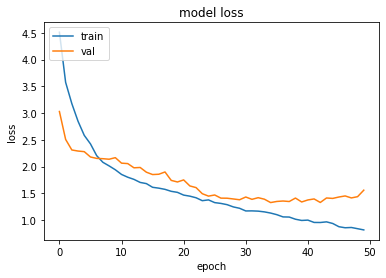

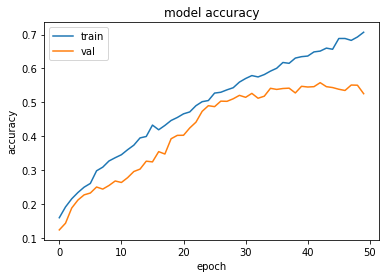

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.3261300325393677 , and Val Acc happened to be 0.5414999723434448
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5580999851226807 and Val Loss happened to be  1.3280118703842163
TestLoss:  1.3134498596191406  TestAcc: 0.5393999814987183
frog 0.771
truck 0.633
ship 0.628
automobile 0.596
horse 0.576
dog 0.521
airplane 0.506
deer 0.484
bird 0.372
cat 0.307


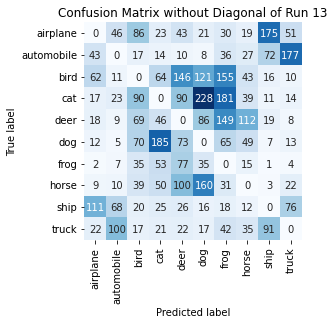

Summing down the rows, for Predictions of each Class that were wrong:  [296. 279. 443. 481. 587. 692. 707. 351. 395. 375.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  146.0 times
Summing across the columns, for total number of that True Class misidentified:  [494. 404. 628. 693. 516. 479. 229. 424. 372. 367.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  149.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 

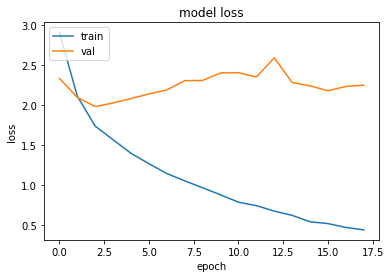

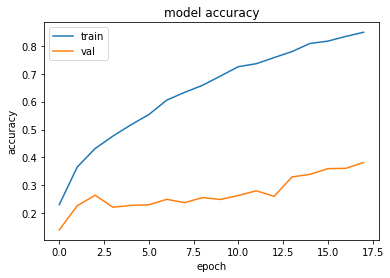

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.9785128831863403 , and Val Acc happened to be 0.2644999921321869
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.38190001249313354 and Val Loss happened to be  2.2457683086395264
TestLoss:  1.9681317806243896  TestAcc: 0.26600000262260437
ship 0.88
frog 0.635
cat 0.41
airplane 0.254
horse 0.173
deer 0.154
truck 0.083
dog 0.028
automobile 0.025
bird 0.018


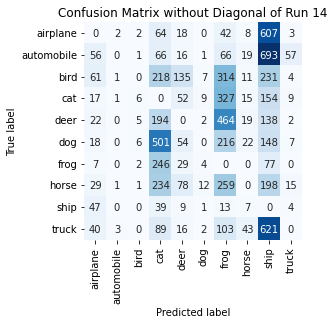

Summing down the rows, for Predictions of each Class that were wrong:  [ 297.    8.   23. 1651.  407.   38. 1804.  144. 2867.  101.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  135.0 times
Summing across the columns, for total number of that True Class misidentified:  [746. 975. 982. 590. 846. 972. 365. 827. 120. 917.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  464.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

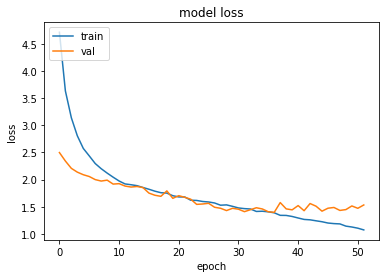

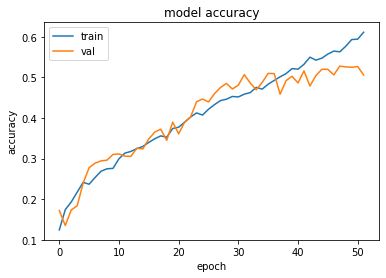

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.397406816482544 , and Val Acc happened to be 0.5094000101089478
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5278000235557556 and Val Loss happened to be  1.432401180267334
TestLoss:  1.3761160373687744  TestAcc: 0.5095000267028809
frog 0.806
truck 0.666
ship 0.658
horse 0.575
automobile 0.561
dog 0.434
airplane 0.408
deer 0.346
bird 0.327
cat 0.314


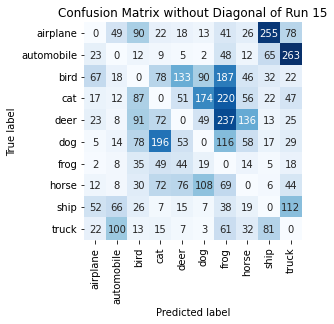

Summing down the rows, for Predictions of each Class that were wrong:  [ 223.  283.  462.  520.  402.  465. 1017.  399.  496.  638.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  133.0 times
Summing across the columns, for total number of that True Class misidentified:  [592. 439. 673. 686. 654. 566. 194. 425. 342. 334.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  237.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

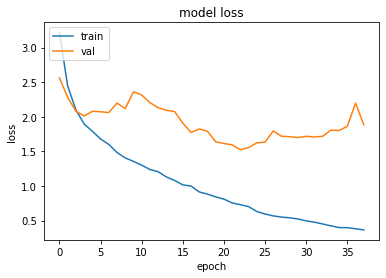

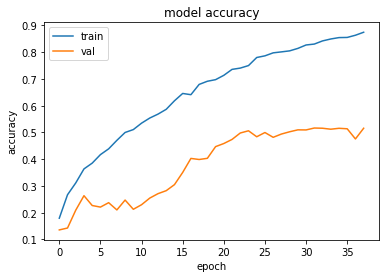

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.523240089416504 , and Val Acc happened to be 0.49779999256134033
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5163999795913696 and Val Loss happened to be  1.707019567489624
TestLoss:  1.4965189695358276  TestAcc: 0.4997999966144562
frog 0.829
automobile 0.674
ship 0.659
truck 0.553
horse 0.432
deer 0.417
airplane 0.414
cat 0.393
dog 0.32
bird 0.307


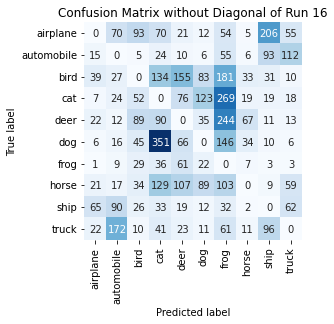

Summing down the rows, for Predictions of each Class that were wrong:  [ 198.  437.  383.  908.  538.  393. 1145.  184.  478.  338.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [586. 326. 693. 607. 583. 680. 171. 568. 341. 447.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  244.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

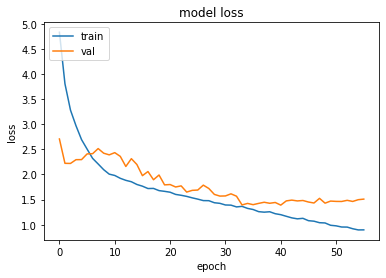

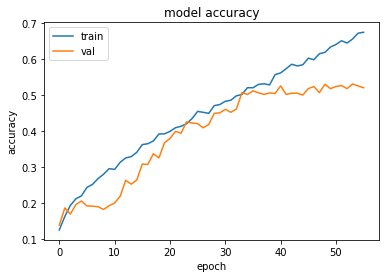

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3898799419403076 , and Val Acc happened to be 0.5267000198364258
Additionally, the best val acc epoch happened to be  53 when val acc was:  0.5320000052452087 and Val Loss happened to be  1.4629638195037842
TestLoss:  1.3625707626342773  TestAcc: 0.5310999751091003
frog 0.761
ship 0.674
automobile 0.607
truck 0.576
airplane 0.542
horse 0.541
deer 0.497
dog 0.491
cat 0.313
bird 0.309


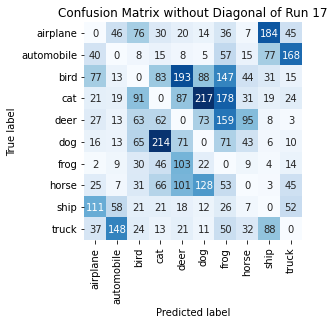

Summing down the rows, for Predictions of each Class that were wrong:  [356. 326. 409. 550. 622. 570. 777. 283. 420. 376.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  193.0 times
Summing across the columns, for total number of that True Class misidentified:  [458. 393. 691. 687. 503. 509. 239. 459. 326. 424.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

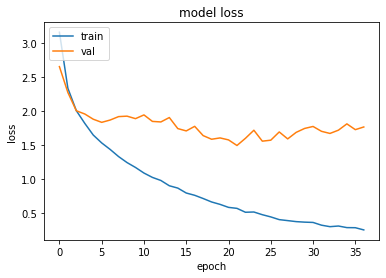

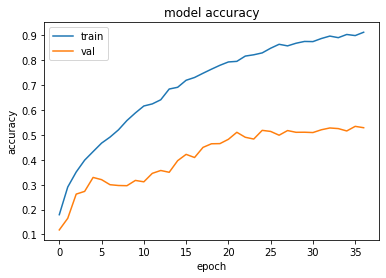

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4951131343841553 , and Val Acc happened to be 0.510699987411499
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.534600019454956 and Val Loss happened to be  1.7284694910049438
TestLoss:  1.4698100090026855  TestAcc: 0.5084999799728394
frog 0.794
ship 0.692
horse 0.591
truck 0.553
automobile 0.539
airplane 0.483
deer 0.477
cat 0.432
dog 0.291
bird 0.233


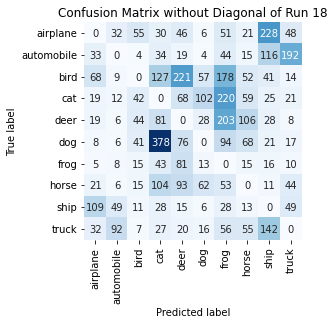

Summing down the rows, for Predictions of each Class that were wrong:  [314. 220. 234. 852. 639. 294. 927. 404. 628. 403.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  221.0 times
Summing across the columns, for total number of that True Class misidentified:  [517. 461. 767. 568. 523. 709. 206. 409. 308. 447.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  203.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

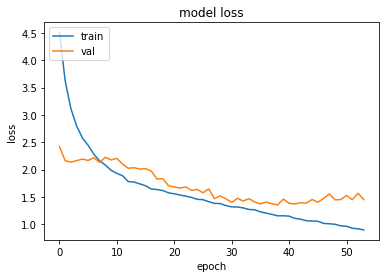

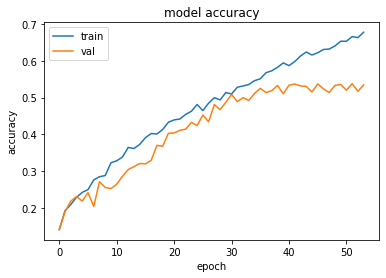

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3504153490066528 , and Val Acc happened to be 0.5328999757766724
Additionally, the best val acc epoch happened to be  51 when val acc was:  0.5375000238418579 and Val Loss happened to be  1.447003960609436
TestLoss:  1.3154202699661255  TestAcc: 0.5425000190734863
frog 0.76
automobile 0.671
ship 0.661
truck 0.652
horse 0.64
dog 0.542
airplane 0.504
deer 0.384
bird 0.372
cat 0.239


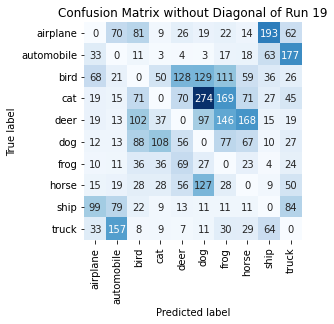

Summing down the rows, for Predictions of each Class that were wrong:  [308. 398. 447. 289. 429. 698. 611. 460. 421. 514.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [496. 329. 628. 761. 616. 458. 240. 360. 339. 348.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  168.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise

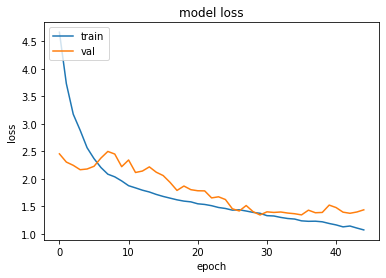

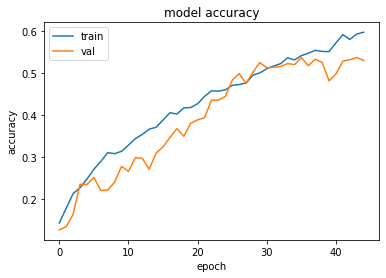

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.345557451248169 , and Val Acc happened to be 0.5260000228881836
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5378999710083008 and Val Loss happened to be  1.3993273973464966
TestLoss:  1.3327562808990479  TestAcc: 0.5270000100135803
frog 0.726
ship 0.715
automobile 0.622
horse 0.573
dog 0.51
truck 0.508
deer 0.499
airplane 0.49
bird 0.341
cat 0.286


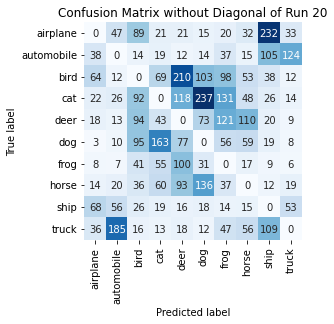

Summing down the rows, for Predictions of each Class that were wrong:  [271. 376. 503. 462. 665. 639. 561. 405. 570. 278.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  210.0 times
Summing across the columns, for total number of that True Class misidentified:  [510. 378. 659. 714. 501. 490. 274. 427. 285. 492.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  121.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

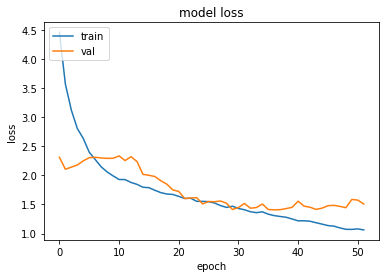

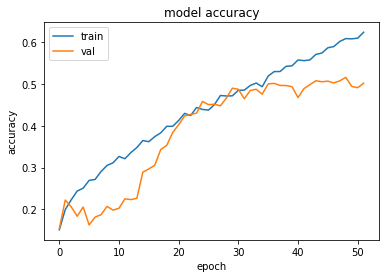

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.4075372219085693 , and Val Acc happened to be 0.5013999938964844
Additionally, the best val acc epoch happened to be  48 when val acc was:  0.5159000158309937 and Val Loss happened to be  1.4443057775497437
TestLoss:  1.4025882482528687  TestAcc: 0.5001999735832214
frog 0.794
automobile 0.773
ship 0.68
horse 0.507
truck 0.496
airplane 0.449
dog 0.435
deer 0.399
cat 0.271
bird 0.198


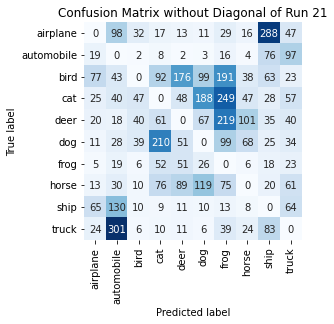

Summing down the rows, for Predictions of each Class that were wrong:  [259. 707. 192. 535. 452. 529. 930. 312. 636. 446.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [551. 227. 802. 729. 601. 565. 206. 493. 320. 504.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  219.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:  

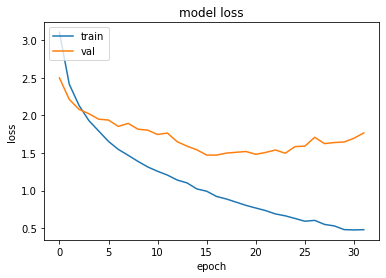

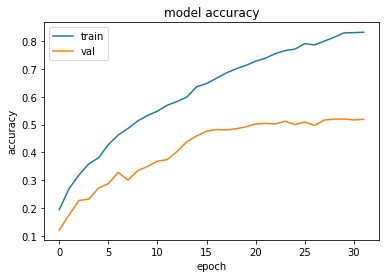

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.4718751907348633 , and Val Acc happened to be 0.48240000009536743
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5202999711036682 and Val Loss happened to be  1.6464124917984009
TestLoss:  1.4497638940811157  TestAcc: 0.4812000095844269
ship 0.788
frog 0.651
deer 0.594
truck 0.557
horse 0.506
airplane 0.46
automobile 0.396
cat 0.31
dog 0.299
bird 0.251


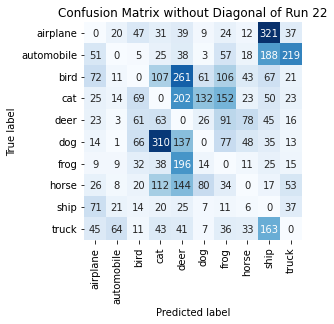

Summing down the rows, for Predictions of each Class that were wrong:  [ 336.  151.  325.  749. 1083.  339.  588.  272.  911.  434.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  261.0 times
Summing across the columns, for total number of that True Class misidentified:  [540. 604. 749. 690. 406. 701. 349. 494. 212. 443.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  91.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.08 

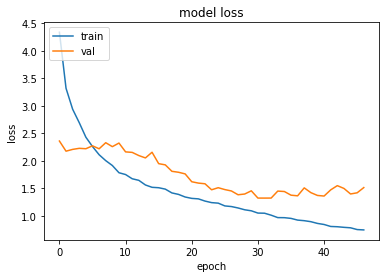

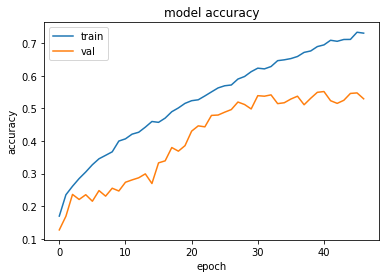

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.3215612173080444 , and Val Acc happened to be 0.5375999808311462
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5519000291824341 and Val Loss happened to be  1.3587777614593506
TestLoss:  1.3012162446975708  TestAcc: 0.5430999994277954
frog 0.75
truck 0.732
ship 0.672
horse 0.615
dog 0.514
airplane 0.503
automobile 0.479
deer 0.467
cat 0.351
bird 0.348


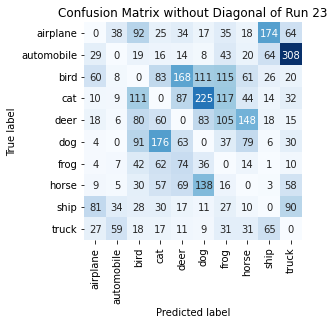

Summing down the rows, for Predictions of each Class that were wrong:  [242. 166. 511. 526. 537. 638. 526. 425. 371. 627.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  168.0 times
Summing across the columns, for total number of that True Class misidentified:  [497. 521. 652. 649. 533. 486. 250. 385. 328. 268.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  148.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise: 

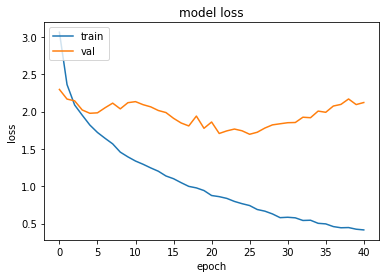

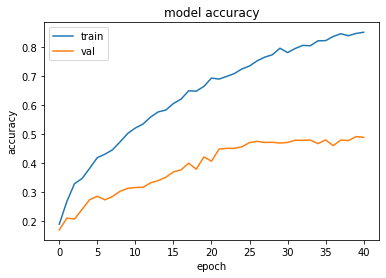

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.6963337659835815 , and Val Acc happened to be 0.47110000252723694
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.49160000681877136 and Val Loss happened to be  2.0942771434783936
TestLoss:  1.657433032989502  TestAcc: 0.46709999442100525
frog 0.768
ship 0.673
automobile 0.572
airplane 0.485
horse 0.442
bird 0.387
dog 0.382
truck 0.359
deer 0.348
cat 0.255


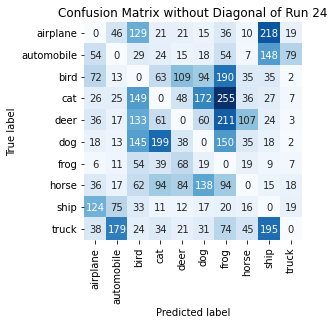

Summing down the rows, for Predictions of each Class that were wrong:  [ 410.  396.  758.  546.  416.  564. 1084.  310.  689.  156.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [515. 428. 613. 745. 652. 618. 232. 558. 327. 641.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  211.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

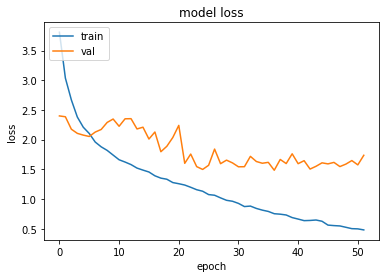

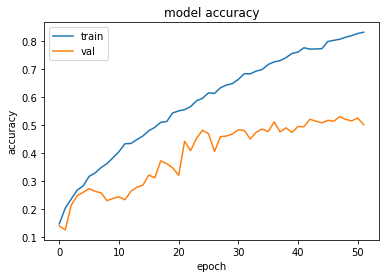

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.4846259355545044 , and Val Acc happened to be 0.5102999806404114
Additionally, the best val acc epoch happened to be  47 when val acc was:  0.5291000008583069 and Val Loss happened to be  1.546395182609558
TestLoss:  1.4651222229003906  TestAcc: 0.507099986076355
frog 0.739
ship 0.655
automobile 0.589
truck 0.589
horse 0.538
dog 0.503
deer 0.428
cat 0.377
airplane 0.328
bird 0.325


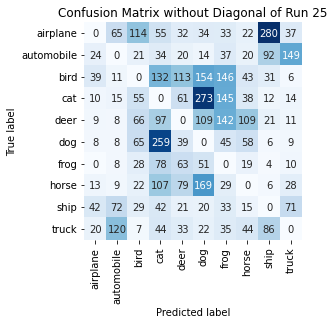

Summing down the rows, for Predictions of each Class that were wrong:  [165. 316. 407. 848. 461. 846. 645. 368. 538. 335.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  113.0 times
Summing across the columns, for total number of that True Class misidentified:  [672. 411. 675. 623. 572. 497. 261. 462. 345. 411.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  142.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

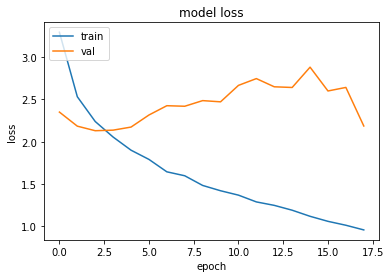

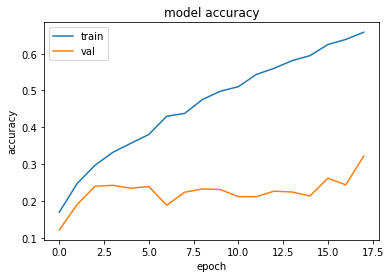

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.1311051845550537 , and Val Acc happened to be 0.23999999463558197
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.321399986743927 and Val Loss happened to be  2.1869757175445557
TestLoss:  2.127216339111328  TestAcc: 0.23899999260902405
airplane 0.734
dog 0.715
deer 0.375
frog 0.216
ship 0.208
cat 0.116
horse 0.011
bird 0.008
truck 0.005
automobile 0.002


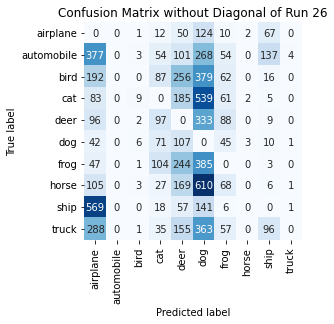

Summing down the rows, for Predictions of each Class that were wrong:  [1799.    0.   26.  505. 1324. 3142.  451.    7.  349.    7.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  256.0 times
Summing across the columns, for total number of that True Class misidentified:  [266. 998. 992. 884. 625. 285. 784. 989. 792. 995.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  333.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.1

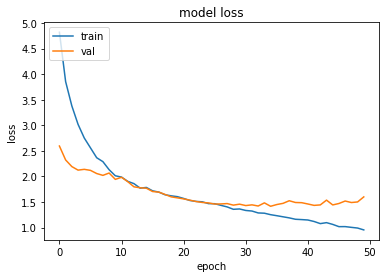

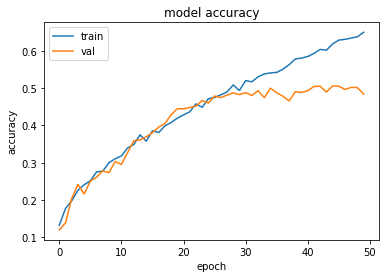

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  34 when  Val Loss was:  1.4165732860565186 , and Val Acc happened to be 0.4997999966144562
Additionally, the best val acc epoch happened to be  44 when val acc was:  0.5056999921798706 and Val Loss happened to be  1.4429081678390503
TestLoss:  1.3933329582214355  TestAcc: 0.5069000124931335
frog 0.724
ship 0.642
automobile 0.591
truck 0.582
horse 0.535
airplane 0.501
deer 0.457
bird 0.438
dog 0.367
cat 0.232


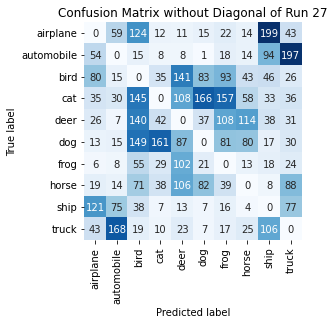

Summing down the rows, for Predictions of each Class that were wrong:  [397. 391. 756. 342. 599. 419. 551. 365. 559. 552.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [499. 409. 562. 768. 543. 633. 276. 465. 358. 418.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  140.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 

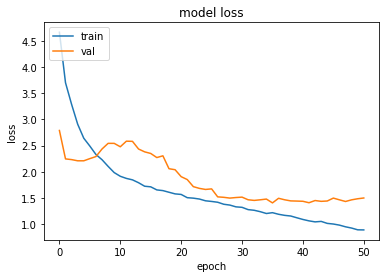

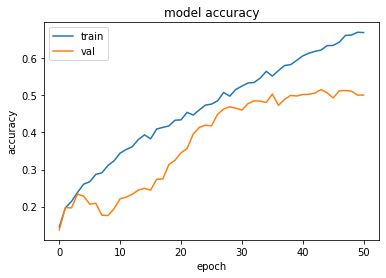

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  35 when  Val Loss was:  1.4058014154434204 , and Val Acc happened to be 0.503600001335144
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5156999826431274 and Val Loss happened to be  1.4354287385940552
TestLoss:  1.3835707902908325  TestAcc: 0.5019000172615051
frog 0.757
ship 0.676
truck 0.611
horse 0.53
airplane 0.529
dog 0.487
deer 0.476
automobile 0.463
bird 0.26
cat 0.23


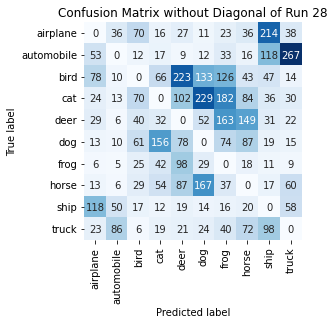

Summing down the rows, for Predictions of each Class that were wrong:  [357. 222. 330. 414. 664. 671. 694. 525. 591. 513.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  223.0 times
Summing across the columns, for total number of that True Class misidentified:  [471. 537. 740. 770. 524. 513. 243. 470. 324. 389.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  163.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


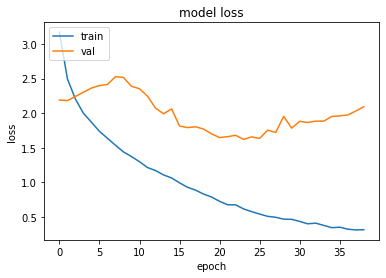

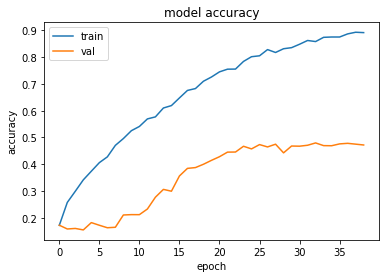

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.6219334602355957 , and Val Acc happened to be 0.46720001101493835
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.4796999990940094 and Val Loss happened to be  1.8854107856750488
TestLoss:  1.6152275800704956  TestAcc: 0.45980000495910645
frog 0.729
ship 0.678
airplane 0.541
truck 0.491
deer 0.441
horse 0.439
automobile 0.382
dog 0.36
cat 0.309
bird 0.228


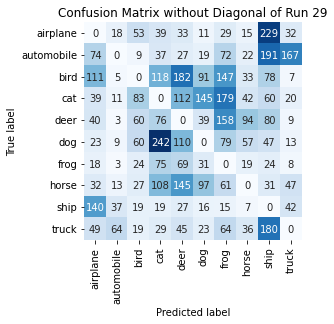

Summing down the rows, for Predictions of each Class that were wrong:  [526. 163. 354. 743. 750. 472. 804. 325. 920. 345.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [459. 618. 772. 691. 559. 640. 271. 561. 322. 509.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:

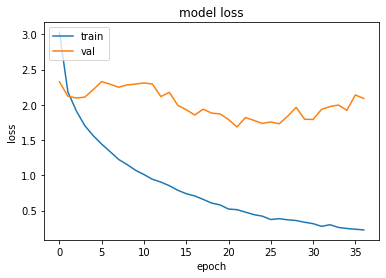

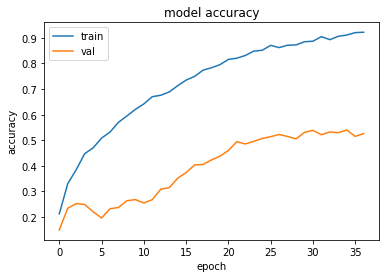

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.6851561069488525 , and Val Acc happened to be 0.49459999799728394
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5401999950408936 and Val Loss happened to be  1.921230435371399
TestLoss:  1.6702951192855835  TestAcc: 0.4964999854564667
ship 0.803
frog 0.73
deer 0.662
automobile 0.558
horse 0.52
truck 0.516
airplane 0.394
dog 0.321
bird 0.261
cat 0.2


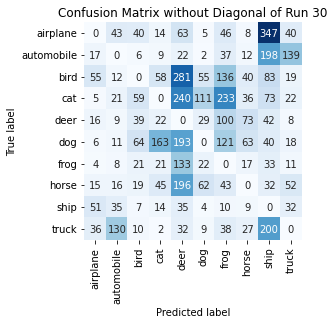

Summing down the rows, for Predictions of each Class that were wrong:  [ 205.  285.  265.  348. 1195.  299.  764.  285. 1048.  341.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  281.0 times
Summing across the columns, for total number of that True Class misidentified:  [606. 442. 739. 800. 338. 679. 270. 480. 197. 484.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  100.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

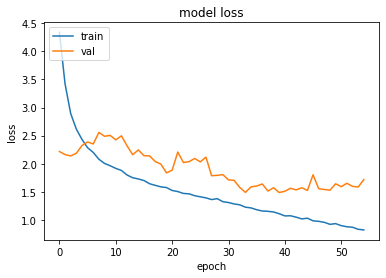

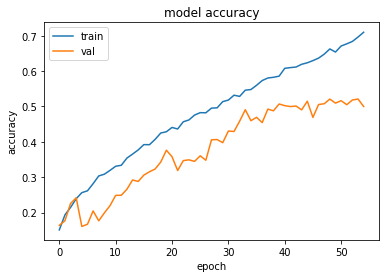

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  39 when  Val Loss was:  1.4863957166671753 , and Val Acc happened to be 0.5069000124931335
Additionally, the best val acc epoch happened to be  53 when val acc was:  0.5209000110626221 and Val Loss happened to be  1.584246039390564
TestLoss:  1.4406609535217285  TestAcc: 0.5148000121116638
frog 0.826
automobile 0.77
ship 0.694
truck 0.485
horse 0.474
dog 0.404
airplane 0.387
cat 0.375
bird 0.37
deer 0.363


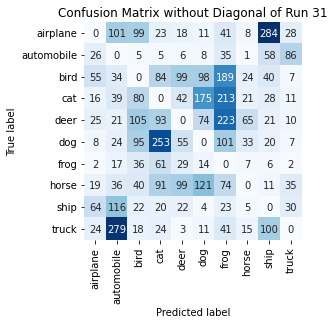

Summing down the rows, for Predictions of each Class that were wrong:  [239. 667. 500. 654. 373. 516. 940. 179. 568. 216.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [613. 230. 630. 625. 637. 596. 174. 526. 306. 515.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  223.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16 )

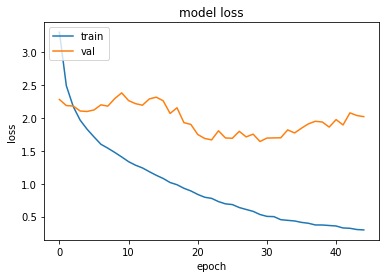

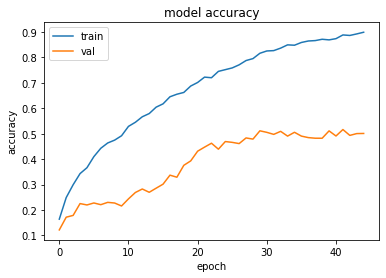

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.6422661542892456 , and Val Acc happened to be 0.5113999843597412
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5163999795913696 and Val Loss happened to be  1.8938347101211548
TestLoss:  1.6320029497146606  TestAcc: 0.5055000185966492
frog 0.7
automobile 0.634
ship 0.634
truck 0.571
airplane 0.548
horse 0.527
deer 0.475
cat 0.396
dog 0.353
bird 0.217


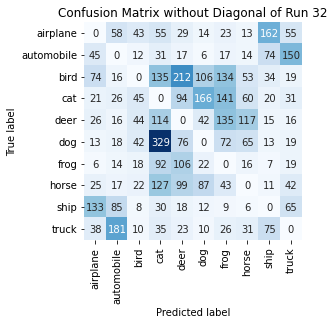

Summing down the rows, for Predictions of each Class that were wrong:  [381. 431. 244. 948. 674. 465. 600. 375. 411. 416.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  212.0 times
Summing across the columns, for total number of that True Class misidentified:  [452. 366. 783. 604. 525. 647. 300. 473. 366. 429.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  135.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    

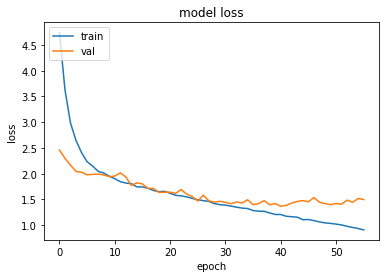

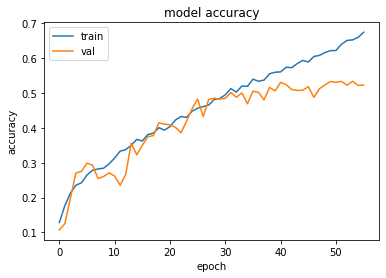

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  40 when  Val Loss was:  1.3664882183074951 , and Val Acc happened to be 0.5306000113487244
Additionally, the best val acc epoch happened to be  53 when val acc was:  0.5336999893188477 and Val Loss happened to be  1.444244146347046
TestLoss:  1.3449769020080566  TestAcc: 0.5336999893188477
frog 0.788
truck 0.646
ship 0.635
automobile 0.591
horse 0.582
airplane 0.548
dog 0.511
deer 0.405
bird 0.329
cat 0.302


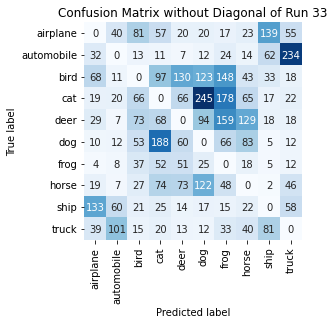

Summing down the rows, for Predictions of each Class that were wrong:  [353. 266. 386. 592. 434. 670. 688. 437. 362. 475.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  130.0 times
Summing across the columns, for total number of that True Class misidentified:  [452. 409. 671. 698. 595. 489. 212. 418. 365. 354.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:  

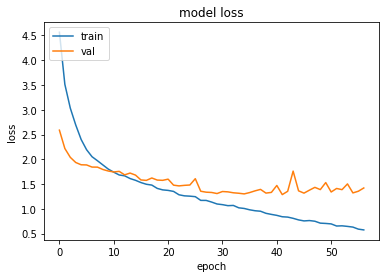

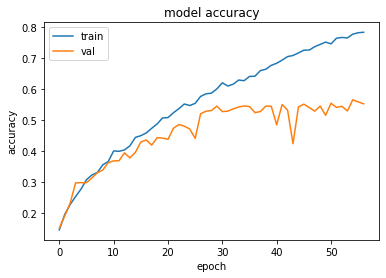

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.2869113683700562 , and Val Acc happened to be 0.5501000285148621
Additionally, the best val acc epoch happened to be  54 when val acc was:  0.5652999877929688 and Val Loss happened to be  1.3210009336471558
TestLoss:  1.2662603855133057  TestAcc: 0.5493000149726868
frog 0.793
ship 0.745
automobile 0.702
truck 0.653
horse 0.605
deer 0.455
dog 0.438
cat 0.436
airplane 0.404
bird 0.262


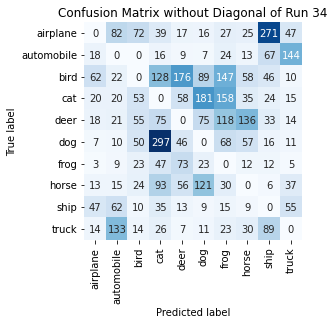

Summing down the rows, for Predictions of each Class that were wrong:  [202. 374. 301. 756. 455. 532. 610. 375. 564. 338.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [596. 298. 738. 564. 545. 562. 207. 395. 255. 347.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  136.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0.16

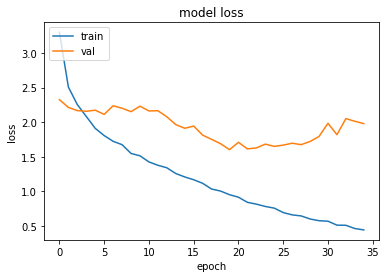

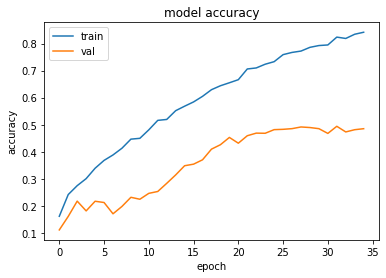

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.6042789220809937 , and Val Acc happened to be 0.4528999924659729
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.49410000443458557 and Val Loss happened to be  1.8204009532928467
TestLoss:  1.595468282699585  TestAcc: 0.45399999618530273
ship 0.753
automobile 0.7
deer 0.678
frog 0.446
horse 0.444
truck 0.413
airplane 0.409
bird 0.295
dog 0.262
cat 0.14


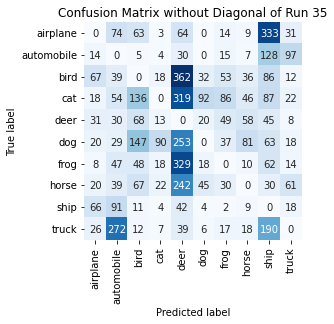

Summing down the rows, for Predictions of each Class that were wrong:  [ 270.  675.  557.  179. 1680.  217.  303.  274. 1024.  281.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  362.0 times
Summing across the columns, for total number of that True Class misidentified:  [591. 300. 705. 860. 322. 738. 554. 556. 247. 587.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  68.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 ,

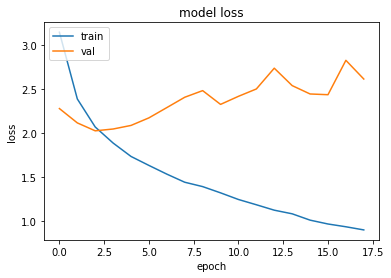

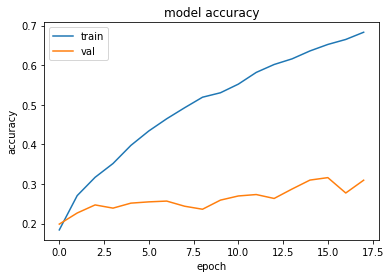

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  2.0246095657348633 , and Val Acc happened to be 0.24709999561309814
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.3160000145435333 and Val Loss happened to be  2.4342825412750244
TestLoss:  2.019505262374878  TestAcc: 0.25189998745918274
ship 0.863
deer 0.648
airplane 0.249
cat 0.209
truck 0.196
frog 0.117
horse 0.111
bird 0.072
dog 0.028
automobile 0.026


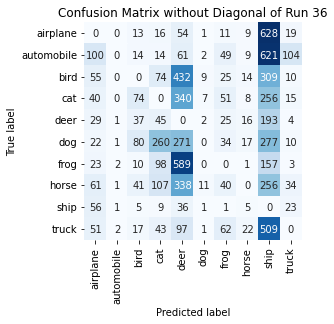

Summing down the rows, for Predictions of each Class that were wrong:  [ 437.    8.  291.  666. 2218.   34.  298.  101. 3206.  222.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  589.0 times
Summing across the columns, for total number of that True Class misidentified:  [751. 974. 928. 791. 352. 972. 883. 889. 137. 804.]
For example, the model misclassified true 4's (deer) as label   8 ship  a total of  193.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

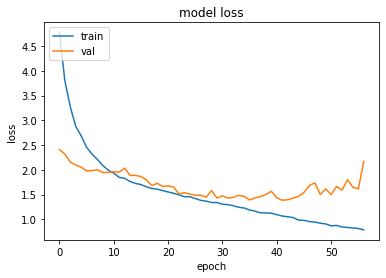

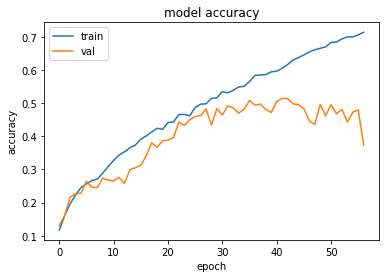

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  41 when  Val Loss was:  1.3853144645690918 , and Val Acc happened to be 0.5139999985694885
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5139999985694885 and Val Loss happened to be  1.3853144645690918
TestLoss:  1.3684031963348389  TestAcc: 0.5126000046730042
frog 0.778
ship 0.714
truck 0.704
automobile 0.648
horse 0.538
deer 0.435
dog 0.384
airplane 0.379
cat 0.362
bird 0.184


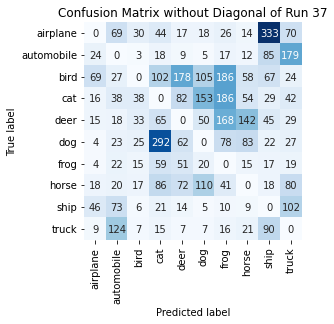

Summing down the rows, for Predictions of each Class that were wrong:  [205. 414. 174. 702. 492. 473. 728. 408. 706. 572.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  178.0 times
Summing across the columns, for total number of that True Class misidentified:  [621. 352. 816. 638. 565. 616. 222. 462. 286. 296.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  168.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

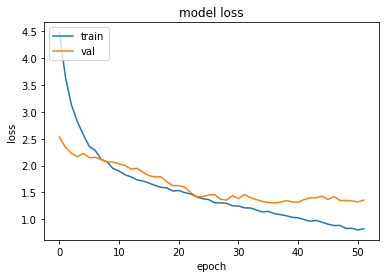

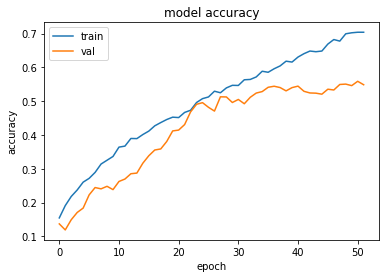

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3068593740463257 , and Val Acc happened to be 0.5440999865531921
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5587000250816345 and Val Loss happened to be  1.324312686920166
TestLoss:  1.286299467086792  TestAcc: 0.5446000099182129
frog 0.814
automobile 0.65
truck 0.625
ship 0.62
horse 0.574
dog 0.572
airplane 0.561
deer 0.43
cat 0.311
bird 0.289


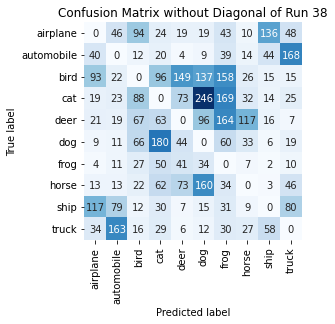

Summing down the rows, for Predictions of each Class that were wrong:  [350. 387. 404. 554. 416. 728. 728. 275. 294. 418.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  149.0 times
Summing across the columns, for total number of that True Class misidentified:  [439. 350. 711. 689. 570. 428. 186. 426. 380. 375.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  164.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

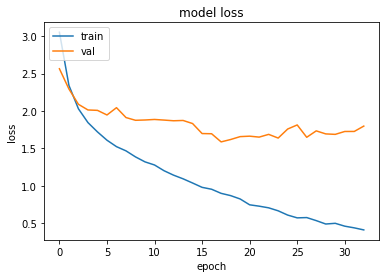

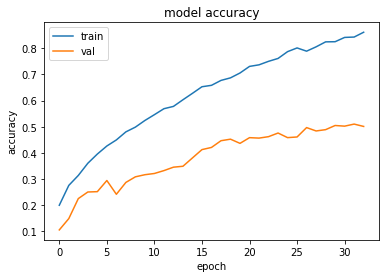

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.5862164497375488 , and Val Acc happened to be 0.4465999901294708
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.510200023651123 and Val Loss happened to be  1.7259925603866577
TestLoss:  1.561864972114563  TestAcc: 0.4465999901294708
cat 0.693
ship 0.691
frog 0.566
automobile 0.461
deer 0.449
airplane 0.434
truck 0.429
horse 0.398
bird 0.207
dog 0.138


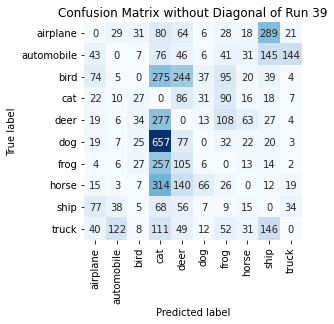

Summing down the rows, for Predictions of each Class that were wrong:  [ 313.  226.  171. 2115.  867.  184.  481.  229.  710.  238.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  244.0 times
Summing across the columns, for total number of that True Class misidentified:  [566. 539. 793. 307. 551. 862. 434. 602. 309. 571.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  277.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 ,

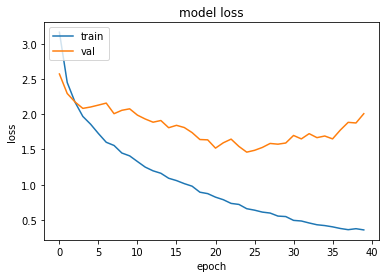

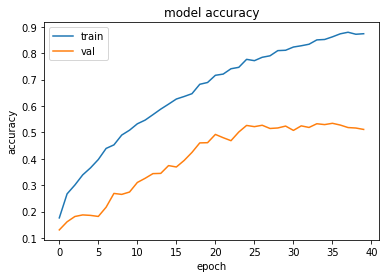

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.4617973566055298 , and Val Acc happened to be 0.526199996471405
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5343000292778015 and Val Loss happened to be  1.649954915046692
TestLoss:  1.4342412948608398  TestAcc: 0.5275999903678894
frog 0.773
automobile 0.68
ship 0.581
truck 0.569
horse 0.555
cat 0.481
airplane 0.477
bird 0.448
dog 0.385
deer 0.327


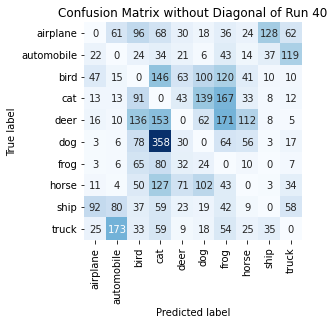

Summing down the rows, for Predictions of each Class that were wrong:  [ 232.  368.  610. 1084.  322.  488.  740.  324.  232.  324.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  71.0 times
Summing across the columns, for total number of that True Class misidentified:  [523. 320. 552. 519. 673. 615. 227. 445. 419. 431.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0

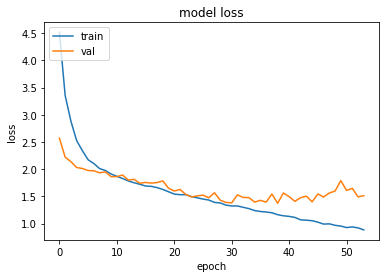

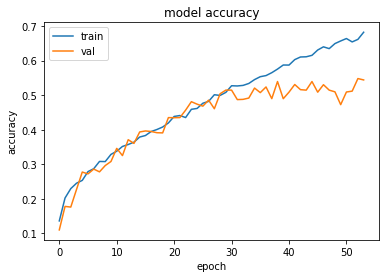

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.3736553192138672 , and Val Acc happened to be 0.5396000146865845
Additionally, the best val acc epoch happened to be  52 when val acc was:  0.5482000112533569 and Val Loss happened to be  1.4916322231292725
TestLoss:  1.3251537084579468  TestAcc: 0.5407000184059143
frog 0.689
automobile 0.67
truck 0.664
horse 0.626
ship 0.571
dog 0.562
airplane 0.517
deer 0.393
bird 0.384
cat 0.331


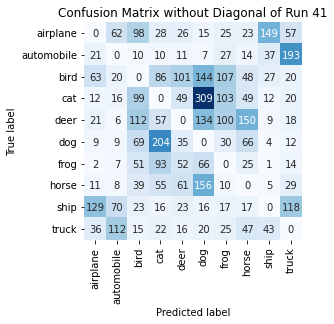

Summing down the rows, for Predictions of each Class that were wrong:  [304. 310. 516. 571. 374. 867. 444. 439. 287. 481.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [483. 330. 616. 669. 607. 438. 311. 374. 429. 336.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  150.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.1

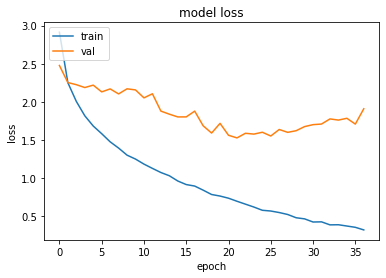

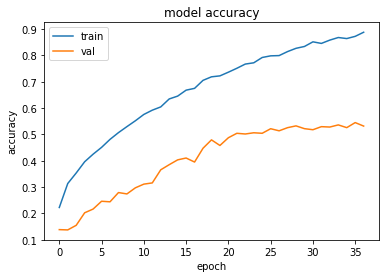

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.527193307876587 , and Val Acc happened to be 0.5041999816894531
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5449000000953674 and Val Loss happened to be  1.708327293395996
TestLoss:  1.4745736122131348  TestAcc: 0.5113000273704529
ship 0.725
frog 0.713
airplane 0.588
automobile 0.552
bird 0.509
horse 0.466
deer 0.426
truck 0.404
cat 0.384
dog 0.346


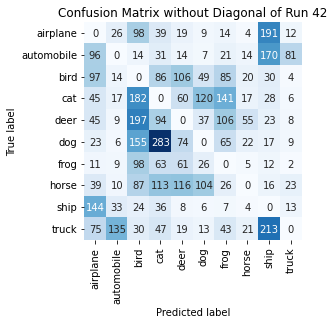

Summing down the rows, for Predictions of each Class that were wrong:  [575. 259. 885. 792. 477. 371. 508. 162. 700. 158.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  116.0 times
Summing across the columns, for total number of that True Class misidentified:  [412. 448. 491. 616. 574. 654. 287. 534. 275. 596.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  197.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 ,

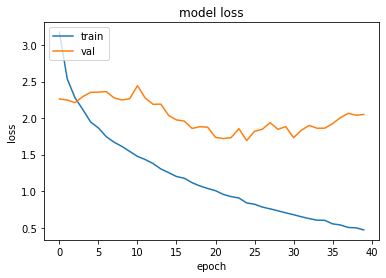

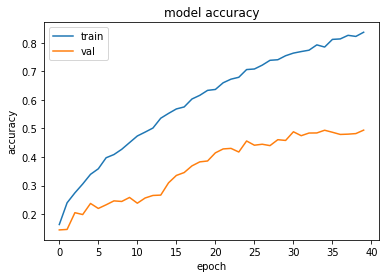

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.6921849250793457 , and Val Acc happened to be 0.4562999904155731
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.4943000078201294 and Val Loss happened to be  2.0493483543395996
TestLoss:  1.6589722633361816  TestAcc: 0.4733000099658966
frog 0.747
ship 0.641
deer 0.589
truck 0.52
airplane 0.511
automobile 0.453
horse 0.391
bird 0.341
dog 0.307
cat 0.233


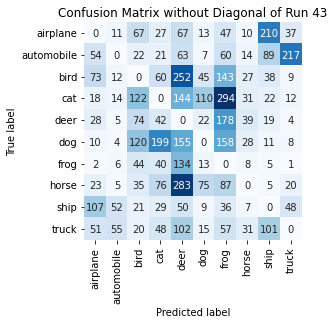

Summing down the rows, for Predictions of each Class that were wrong:  [ 366.  164.  525.  542. 1250.  309. 1060.  195.  500.  356.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  283.0 times
Summing across the columns, for total number of that True Class misidentified:  [489. 547. 659. 767. 411. 693. 253. 609. 359. 480.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  178.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

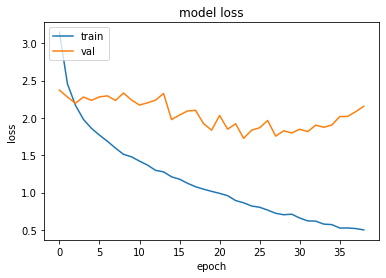

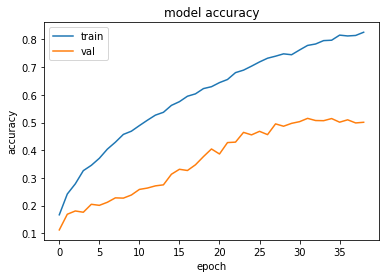

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.7269641160964966 , and Val Acc happened to be 0.4645000100135803
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5151000022888184 and Val Loss happened to be  1.8170747756958008
TestLoss:  1.7042028903961182  TestAcc: 0.4690999984741211
ship 0.769
frog 0.722
deer 0.684
truck 0.582
automobile 0.503
horse 0.423
dog 0.384
airplane 0.31
bird 0.16
cat 0.154


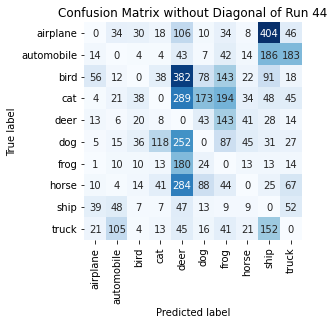

Summing down the rows, for Predictions of each Class that were wrong:  [ 163.  255.  163.  260. 1628.  452.  737.  207.  978.  466.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  382.0 times
Summing across the columns, for total number of that True Class misidentified:  [690. 497. 840. 846. 316. 616. 278. 577. 231. 418.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  143.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 

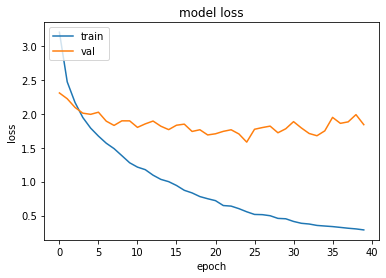

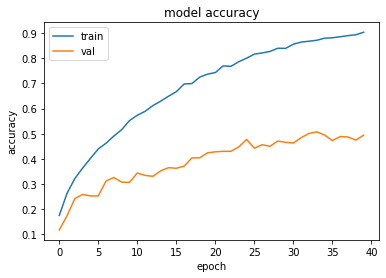

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.5820283889770508 , and Val Acc happened to be 0.477400004863739
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5073999762535095 and Val Loss happened to be  1.675779938697815
TestLoss:  1.559401512145996  TestAcc: 0.4738999903202057
frog 0.821
ship 0.701
truck 0.636
deer 0.584
horse 0.465
automobile 0.415
airplane 0.325
dog 0.317
cat 0.246
bird 0.229


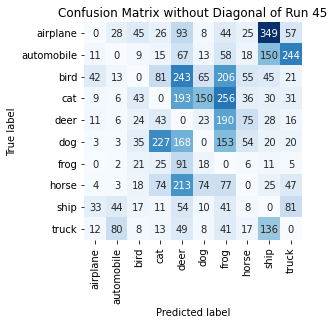

Summing down the rows, for Predictions of each Class that were wrong:  [ 125.  185.  220.  515. 1171.  369. 1066.  294.  794.  522.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  243.0 times
Summing across the columns, for total number of that True Class misidentified:  [675. 585. 771. 754. 416. 683. 179. 535. 299. 364.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  190.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.

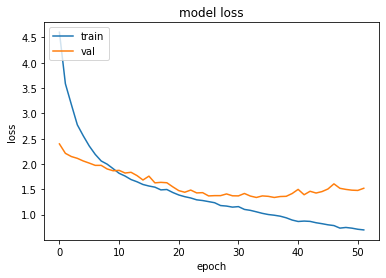

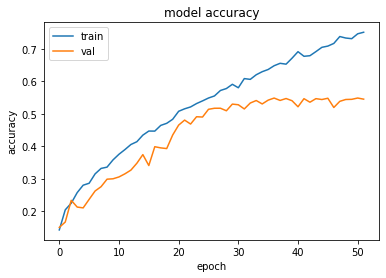

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.3394790887832642 , and Val Acc happened to be 0.5485000014305115
Additionally, the best val acc epoch happened to be  50 when val acc was:  0.5486000180244446 and Val Loss happened to be  1.4785248041152954
TestLoss:  1.3068288564682007  TestAcc: 0.5473999977111816
frog 0.738
ship 0.732
truck 0.667
horse 0.656
automobile 0.626
airplane 0.501
deer 0.489
dog 0.439
bird 0.396
cat 0.23


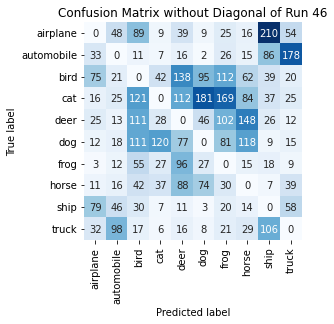

Summing down the rows, for Predictions of each Class that were wrong:  [286. 297. 587. 283. 593. 445. 586. 501. 538. 410.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  138.0 times
Summing across the columns, for total number of that True Class misidentified:  [499. 374. 604. 770. 511. 561. 262. 344. 268. 333.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  148.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

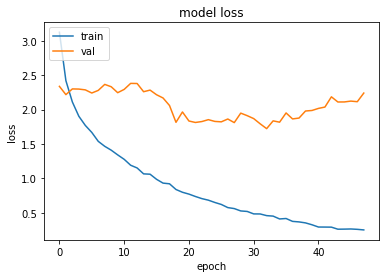

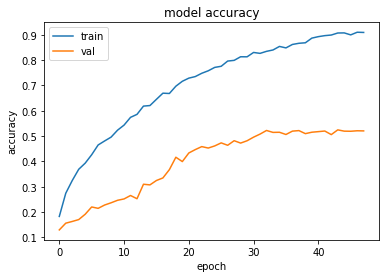

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  32 when  Val Loss was:  1.7232252359390259 , and Val Acc happened to be 0.5224000215530396
Additionally, the best val acc epoch happened to be  43 when val acc was:  0.5248000025749207 and Val Loss happened to be  2.1102845668792725
TestLoss:  1.7149239778518677  TestAcc: 0.5254999995231628
frog 0.741
ship 0.668
airplane 0.613
automobile 0.574
deer 0.558
horse 0.553
truck 0.544
dog 0.381
cat 0.342
bird 0.281


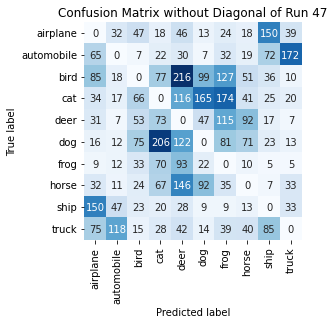

Summing down the rows, for Predictions of each Class that were wrong:  [497. 274. 343. 581. 839. 468. 636. 355. 420. 332.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  216.0 times
Summing across the columns, for total number of that True Class misidentified:  [387. 426. 719. 658. 442. 619. 259. 447. 332. 456.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  115.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )


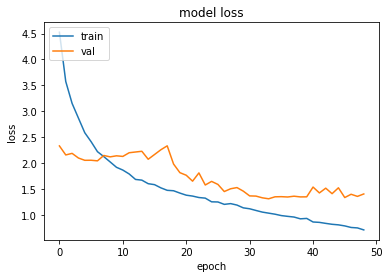

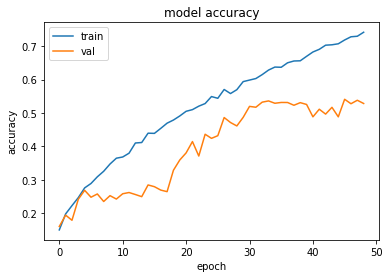

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3135405778884888 , and Val Acc happened to be 0.5360999703407288
Additionally, the best val acc epoch happened to be  45 when val acc was:  0.5410000085830688 and Val Loss happened to be  1.3375284671783447
TestLoss:  1.296598196029663  TestAcc: 0.5388000011444092
frog 0.809
ship 0.738
truck 0.641
horse 0.567
automobile 0.565
deer 0.531
airplane 0.457
dog 0.447
cat 0.341
bird 0.292


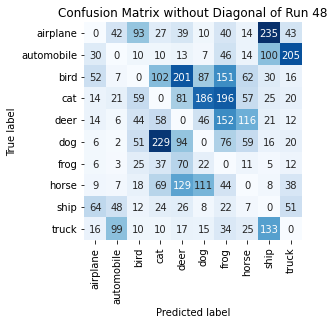

Summing down the rows, for Predictions of each Class that were wrong:  [211. 235. 322. 566. 670. 492. 761. 365. 573. 417.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  201.0 times
Summing across the columns, for total number of that True Class misidentified:  [543. 435. 708. 659. 469. 553. 191. 433. 262. 359.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  152.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
No

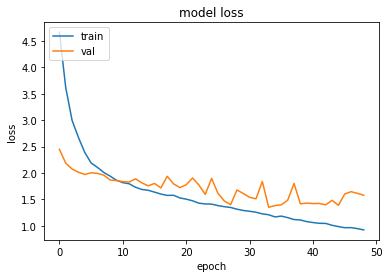

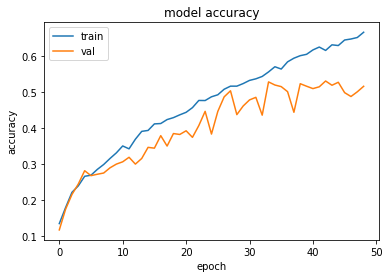

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  33 when  Val Loss was:  1.3499460220336914 , and Val Acc happened to be 0.52920001745224
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5317000150680542 and Val Loss happened to be  1.3963559865951538
TestLoss:  1.3308147192001343  TestAcc: 0.5299999713897705
frog 0.778
automobile 0.719
ship 0.675
truck 0.551
airplane 0.523
dog 0.502
horse 0.498
cat 0.358
bird 0.355
deer 0.341


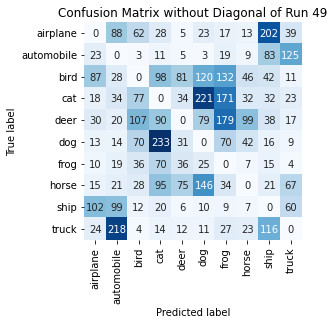

Summing down the rows, for Predictions of each Class that were wrong:  [322. 541. 399. 659. 285. 638. 658. 278. 565. 355.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [477. 281. 645. 642. 659. 498. 222. 502. 325. 449.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  179.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )

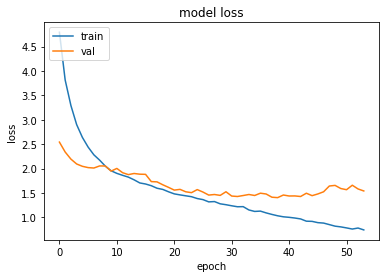

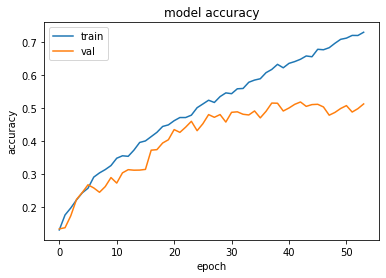

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  38 when  Val Loss was:  1.4032089710235596 , and Val Acc happened to be 0.5146999955177307
Additionally, the best val acc epoch happened to be  42 when val acc was:  0.5184999704360962 and Val Loss happened to be  1.4265003204345703
TestLoss:  1.375174641609192  TestAcc: 0.5206999778747559
frog 0.804
ship 0.708
truck 0.625
dog 0.551
automobile 0.539
horse 0.469
airplane 0.451
deer 0.401
bird 0.385
cat 0.274


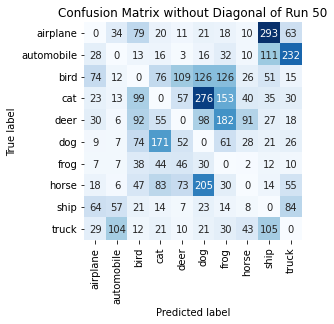

Summing down the rows, for Predictions of each Class that were wrong:  [282. 246. 475. 500. 368. 816. 646. 258. 669. 533.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [549. 461. 615. 726. 599. 449. 196. 531. 292. 375.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  182.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Fri, 12 November 2021 02:56:52  (subtract ~5-hours for local Hour), and file is called  runs_GroupJ_final.pkl


In [ ]:
#@title Group J: 51 Run Results
run_through_runs(ds=make_unbatched(train_J),  ds_noalb= train_J_noalb, dstitle="J" , showpictures= False)

## Time Required: 10 hours



In [ ]:
stop_testing = time.time()
print((stop_testing - tic) , "secs to  run everything start to end, or... ")
print((stop_testing - tic)/60, "minutes ... or ")
print((stop_testing - tic)/3600, "hours ")

31537.616800308228 secs to  run everything start to end, or... 
525.6269466718038 minutes ... or 
8.76044911119673 hours 


as of 11/11/21 its  ** ~9 hours** to run all 9 Groups with 51 Runs, at about 45 epochs each.  If I ran it again with GroupA (10th GRoup) it would probably be about 10.5 hours total to this point.  Also note that is just training and capturing results, not diplaying any images thru augmentations.

# Post-Test: Process Results

After the 50 runs above have run, its time to load the results into JMP to Fit the Definitive Screening Design and find which Main Effects have the most compeling effect.  This is my second time running the results of Training_Group_A.  The first time I created two for loops to go through the first 25 runs and save, and then the second 25 runs and save.  When I went through my results, the second 25 runs on average were slightly less test accuracy (diff of 0.03 according to block effect), and you could clearly see that each run of view_images(data) resulted in the exact same images.  So my belief is that for some reason, maybe due to a coding issue, or maybe just an artifact of calling up the dataset-augmentations "twice", the second 25 runs in the original "[Test1](https://github.com/RachelRamirez/CIFAR-10/blob/main/CollectionofTests/Test1GroupA.ipynb)" resulted in a visible block effect.  It was funny because I had made a block variable and then accidentally caused a significant blocking effect.. ANYWHO...  


In [169]:
import pickle
import numpy as np
import csv
# what does a flattened confuion matrix look like 


#define a list of the pickle files
list_of_pickle_file_names = ['runs_GroupB_final.pkl', 
                             'runs_GroupC_final.pkl', 
                             'runs_GroupD_final.pkl', 
                             'runs_GroupE_final.pkl', 
                             'runs_GroupF_final.pkl', 
                             'runs_GroupG_final.pkl', 
                             'runs_GroupH_final.pkl', 
                             'runs_GroupI_final.pkl', 
                             'runs_GroupJ_final.pkl']

list_of_group_names = ["B", "C", "D", "E", "F", "G", "H", "I", "J"]

# runsA, runsB, runsC, runsD, runsE, runsF, runsG, runsH, runsI, runsJ = {}, {} , {}, {}, {}, {}, {}, {}, {}, {} #is there a better way to define these many variables? 
# polease notice i left out runsA because I don't have the pickle file from the day B-G were run

runsA = runsB =  runsC = runsD = runsE = runsF =  runsG =  runsH =  runsI =  runsJ = []

# list_of_unpickled_names = [runsB, runsC, runsD, runsE, runsF, runsG, runsH, runsI, runsJ]
# Later? Create a dictionary by zipping together two lists itno tuples
# fields = ["Seed", "Group", "Run", "TestAcc", "TestLoss", "ConfusionMatrix"]
# values = [42, "Z", 999, 0.0, 0.0, [range(100)]]
# a_dict = dict(zip(fields, values))
# a_dict
 
ds = {}

#for enumerate () zip the 9 pickle files:
for Z, pkl, in zip(list_of_group_names, list_of_pickle_file_names): #list_of_unpickled_names):
  
  with open(pkl, 'rb') as fid:
     ds[Z] = pickle.load(fid)
  print("dataset", Z, " loaded from", pkl)

#To reference a Group say ds["Letter"][RunInt]["Metric"]
 
#can i just replace it Group , and each run, with this function? It'd be ice if i could map it.. versus a for loop of doomr
rows = []
for i in (list_of_group_names):
  for run in range(0,10):             #<!!---------------------------------------------------------------------------------- change back to 51
    cm_flat = (ds[i][run]["CM"]).flatten(order="C")
    # cm_norm_flat = (ds[i][run]["CM_norm"]).flatten(order="C")
    print(cm_flat)
    cm_flat_new = cm_flat.flatten()
    # print("new", cm_flat_new)
    # row = [i, run, ds[i][run]["CM"], ds[i][run]["CM_norm"] ]
    # rows.append(row)


print(rows)

#Check ds["B"][23]["CM_norm"] #yup
 
# -------------------------------------------------------------------------------------- 
# How to put information in a CSV file?
# Try this: https://www.tutorialspoint.com/How-to-save-a-Python-Dictionary-to-CSV-file
#
# --------------------------------------------------------------------------------------

counter = 0
import csv
# my dictionary is ds
with open('allgroups_allruns_seed42.csv', 'w') as f:
  for key in ds.keys():
    for key2 in ds[key].keys():
      (key3, key4, key5, key6)  = ds[key][key2].keys()
      


      # Working Code don't tinker wth!
      cm_flat = np.array(ds[key][key2][key5]).flatten()
      cm_norm_flat = np.array(ds[key][key2][key6]).flatten()
      csvwriter=csv.writer(f, delimiter="," )
      # the prob with below is it doesnt give each item in the cm its own column 
      # so i refere to SO and found this https://stackoverflow.com/questions/67125762/convert-an-array-column-into-multiple-columns-python
      csvwriter.writerow([key, key2, ds[key][key2][key3], ds[key][key2][key4],  cm_flat, cm_norm_flat   ])

# https://stackoverflow.com/questions/67125762/convert-an-array-column-into-multiple-columns-python


#to save space i need key3 to all print on one line, otherwise excel csv file will be 10*51*4*10*10 rows = ~20,000 rows? bc flatten hasnt yet worked on cm and cm_norm

# Create Data frame?

# import pandas as pd
# df_B = pd.DataFrame( data=ds['B'],   )
 
break



# new_dictionary = {'Group':                 
#                   {'Run': 
#                    {
#                   'TestAcc': 'Value',
#                   'TestLoss': 'Value',
#                   'CM': [],
#                   'CM_norm': []}}}

# new_dictionary['Group']
# new_dictionary_list_of_metrics = 'TestAcc', 'TestLoss', 'CM', 'CM_norm'
# ds["B"][3]




# my dictionary is ds
with open('allgroups_allruns_seed42.csv', 'w') as f:


counter = 0
new_dataframe = []

for key1_group in ds.keys():
    for key2_run in ds[key1_group].keys():
      for key3_metrics, newdict_metric in zip(ds[key1_group][key2_run].keys(), new_dictionary_list_of_metrics):
        # new_dictionary[key1_group][key2_run][newdict_metric] = ds[key1_group][key2_run][key3_metrics]
        counter +=1
        #ok now i realize i did things correctly after all because this is an exact replicate of what I already have... arrrrrrrrrggggggg
    print(counter)





#the first key of "key3" is TestAccuracy


# from collections import defaultdict
# d = defaultdict(list)
# for k, v in ds['B'].items():
#     d[v].append(k)
# printdict(d))

break

files.download("allgroups_allruns_seed42.csv")
# Desire the following format 1-SeedCol, 2-GroupCol, 3-RunCol, 4-TestAcc-Col, 5-TestLossCol, (6,105)100 Columns CM, (106, 205) 100 Columns CM_norm 
#[Seed#] [Group_Letter {A-J}] [Run#] [TestAccuracy] [TestLoss] [Flatten 10X10 Confusion Matrix into 1x100]
 
 #lets see how close... oh good lord that's ugly... 





  #this file originally saved 11-5-2021 from 1 each testset

# lastruns_groupA_loaded

# string_of_cm = " "
# y = {}

# # test
# # string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[0]["CM"][0][0]) + " "
# print("Run ,", "Test Accuracy ,", "Test Loss,", "Confusion Matrix Diagonals," "Normalized Confusion Matrix" )
 
# CM_digit = []

# for i in range(0,ENDRUNS):
#   for x in range(0,10):
#     #string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[i]["CM"][x][x]) + ", "
#     CM_digit = lastruns_groupA_loaded[i]["CM"][x][x] + CM_digit
#   y[i] = lastruns_groupA_loaded[i]['TestAccuracy'], lastruns_groupA_loaded[i]["TestLoss"], CM_digit 
#   print(y[i])
#   CM_digit = [] #clear?

# lastruns_groupA_loaded[1]["TestAccuracy"]
# lastruns_groupA_loaded[1]["CM"][:,0].sum()  #666 Predicted Class 0?
# lastruns_groupA_loaded[1]["CM"][0,:].sum()  #1000 True Class 0?
# lastruns_groupA_loaded[1]["CM"][1,:].sum()  #1000 True Class 1?

# sum_of_cm_diagonals = 0
# for i in range(10):
#   sum_of_cm_diagonals = sum_of_cm_diagonals + lastruns_groupA_loaded[1]["CM"][i,i]    

# print("Sum of Diagonals on Confusion Matrix of Run 1: ", sum_of_cm_diagonals) #checks with TestAccuracy


# #I want to find the area of greatest confusion

# #create a new matrix to not ruin previious CM
# confusion_matrix_wo_diagonal = lastruns_groupA_loaded[1]["CM"].copy()
 
# for i in range(10):
#   confusion_matrix_wo_diagonal[i,i] = 0 # set the diagonal equal to zero
# print(confusion_matrix_wo_diagonal)
# # for i in range(10):
# #   print(i, "is most often miscategorized as ", np.argmax(confusion_matrix_wo_diagonal[:,i]), " ", max(confusion_matrix_wo_diagonal[:,i]), " times")

# for i in range(10):
#   print("The algorithm predicted a ", np.argmax(confusion_matrix_wo_diagonal[i,:]),"instead of a ",  i, " ", max(confusion_matrix_wo_diagonal[i,:]), "times")



# print("Summing down the rows, for COLUMN total: ", confusion_matrix_wo_diagonal.sum(axis=0))
# print("Summing across the columns, for ROW total: ", confusion_matrix_wo_diagonal.sum(axis=1))

In [104]:
# https://www.tutorialspoint.com/python-convert-list-of-nested-dictionary-into-pandas-dataframe
# Example
import pandas as pd


#print(list)
rows = []

# appending rows
for key in dictionary_fruit.keys():
   data_row = dictionary_fruit[key]
   n = data['Name']

   for row in data_row:
      row['Name'] = n
      rows.append(row)

   # using data frame
df = pd.DataFrame(rows)

df = df.pivot_table(index='Name', columns=['Quality'],
               values=['Price']).reset_index()
print(df)


[]

something weird about the above code.  My confusion matrix looks like its lost the diagonals. I think copying to confusion_matrix_wo_diagonal didn't do a separate copy, it is just linked, so when I cleared the diagonal of confusion_matrix_wo_diagonal, it also cleared it from lastruns_groupsA_loaded[1]["CM"]


In [ ]:
lastruns_groupA_loaded[0]["CM"]

In [ ]:
confusion_matrix_wo_diagonal.sum() + sum_of_cm_diagonals

In [ ]:
# string_of_cm = ""

# for i in range(1,2):  # goes through first n runs with CMs
#   for x in range(10): # goes through the n items in diagonal of each run.CM
#     string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[i]["CM"][x][x]) + ","
#     y[i] = lastruns_groupA_loaded[i]['TestAccuracy'], lastruns_groupA_loaded[i]["TestLoss"], string_of_cm 
#   print(y[i])
  

# lastruns_groupA_loaded[1]["TestAccuracy"]
# lastruns_groupA_loaded[1]["CM"][:,0].sum()  #666 Predicted Class 0
# lastruns_groupA_loaded[1]["CM"][0,:].sum()  #1000 True Class 0
# lastruns_groupA_loaded[1]["CM"][1,:].sum()  #1000 True Class 1

# sum_of_cm_diagonals = 0
# for i in range(10):
#   sum_of_cm_diagonals = sum_of_cm_diagonals + lastruns_groupA_loaded[1]["CM"][i,i]    

# print("Sum of Diagonals on Confusion Matrix of Run 1: ", sum_of_cm_diagonals) #checks with TestAccuracy


# #I want to find the area of greatest confusion

# #create a new matrix to not ruin previious CM
# confusion_matrix_wo_diagonal = lastruns_groupA_loaded[1]["CM"].copy()
 
# for i in range(10):
#   confusion_matrix_wo_diagonal[i,i] = 0 # set the diagonal equal to zero
# print(confusion_matrix_wo_diagonal)
# # for i in range(10):
# #   print(i, "is most often miscategorized as ", np.argmax(confusion_matrix_wo_diagonal[:,i]), " ", max(confusion_matrix_wo_diagonal[:,i]), " times")

# for i in range(10):
#   print("The algorithm predicted a ", np.argmax(confusion_matrix_wo_diagonal[i,:]),"instead of a ",  i, " ", max(confusion_matrix_wo_diagonal[i,:]), "times")



# print("Summing down the rows, for COLUMN total: ", confusion_matrix_wo_diagonal.sum(axis=0))
# print("Summing across the columns, for ROW total: ", confusion_matrix_wo_diagonal.sum(axis=1))